In this notebook we forecast river flow for every month in years 2020-2021, based on precipitation scenarios and expected deforestation trend


https://machinelearningmastery.com/multivariate-time-series-forecasting-lstms-keras/

In [1]:
from math import sqrt
import numpy as np
from numpy import concatenate
from matplotlib import pyplot
from pandas import read_csv
from datetime import datetime
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
import matplotlib.pyplot as plt
from tensorflow.keras.metrics import RootMeanSquaredError
from keras.callbacks import EarlyStopping 

## Read data for model training


In [3]:
macrodata = pd.read_csv('../../DS4All_2020_Team28_Project/data/matrix/matrix_consol_v2.zip')
data = macrodata.iloc[:, 3:7]

mcs = data['mc'].unique()
mcs.sort()


### Read data for forecast 2020-2021


In [4]:
#data for predictions:
df_2020_2021 = pd.read_csv('../data/matrix/Esc_Predicciones.csv', parse_dates=True, index_col='Date', dayfirst=True)
df_2020_2021['Date'] = df_2020_2021.index
df_2020_2021['month_year'] = pd.to_datetime(df_2020_2021['Date']).dt.to_period('M')
df_2020_2021.head(13)

,MC,P_A1,P_A2,P_B1,P_B2,Def_25%,Def_50%,Def_75%,Def_100%,Date,month_year
Date,,,,,,,,,,,
2020-01-01,1,210.44,202.07,222.87,202.16,0.07693,0.07702,0.07710,0.07718,2020-01-01,2020-01
2020-02-01,1,135.49,130.10,143.49,130.16,0.07702,0.07718,0.07735,0.07751,2020-02-01,2020-02
2020-03-01,1,259.40,249.08,274.72,249.19,0.07710,0.07735,0.07759,0.07784,2020-03-01,2020-03
2020-04-01,1,61.71,59.25,65.35,59.28,0.07718,0.07751,0.07784,0.07817,2020-04-01,2020-04
2020-05-01,1,202.86,194.79,214.84,194.88,0.07726,0.07768,0.07809,0.07850,2020-05-01,2020-05
2020-06-01,1,137.33,131.87,145.44,131.93,0.07735,0.07784,0.07834,0.07883,2020-06-01,2020-06
2020-07-01,1,14.20,13.64,15.04,13.64,0.07743,0.07801,0.07858,0.07916,2020-07-01,2020-07
2020-08-01,1,20.29,19.48,21.49,19.49,0.07751,0.07817,0.07883,0.07949,2020-08-01,2020-08
2020-09-01,1,3.46,3.32,3.66,3.32,0.07759,0.07834,0.07908,0.07982,2020-09-01,2020-09


### Read model results to get the VAR order (p)

In [6]:
df_models = pd.read_csv('LSTM_results_2years.csv')
df_models.head()

,basin,RMSE,MAPE,sMAPE,epochs,batch_size
0,1,0.430648,13.898154,6.510948,79,24
1,2,12.606451,49.572768,26.304385,37,12
2,3,49.692316,21.460559,11.491825,39,12
3,4,1.999200,30.313124,18.839158,44,12
4,5,15.601605,22.317389,12.290797,52,12


In [7]:
int(df_models[df_models['basin']==1]['epochs'])

79

# All basins

In [8]:
from math import sqrt
import numpy as np
from numpy import concatenate
from matplotlib import pyplot
from pandas import read_csv
from datetime import datetime
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
import matplotlib.pyplot as plt
from tensorflow.keras.metrics import RootMeanSquaredError
from keras.callbacks import EarlyStopping 

def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
	n_vars = 1 if type(data) is list else data.shape[1]
	df = pd.DataFrame(data)
	cols, names = list(), list()
	# input sequence (t-n, ... t-1)
	for i in range(n_in, 0, -1):
		cols.append(df.shift(i))
		names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
	# forecast sequence (t, t+1, ... t+n)
	for i in range(0, n_out):
		cols.append(df.shift(-i))
		if i == 0:
			names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
		else:
			names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
	# put it all together
	agg = pd.concat(cols, axis=1)
	agg.columns = names
	# drop rows with NaN values
	if dropnan:
		agg.dropna(inplace=True)
	return agg


Def_25%
P_A1

 ################ Basin 1 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


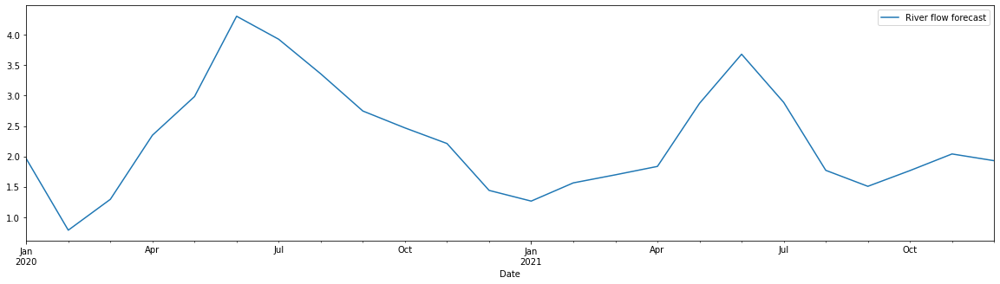


 ################ Basin 2 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


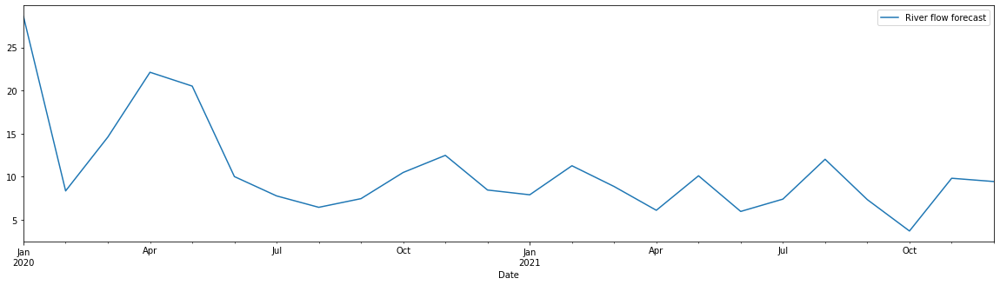


 ################ Basin 3 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


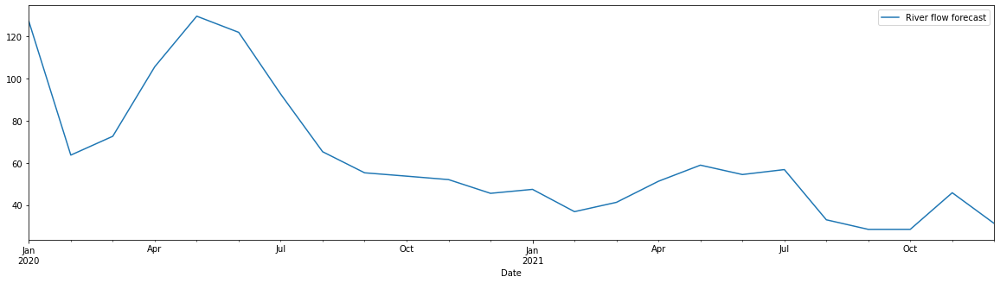


 ################ Basin 4 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


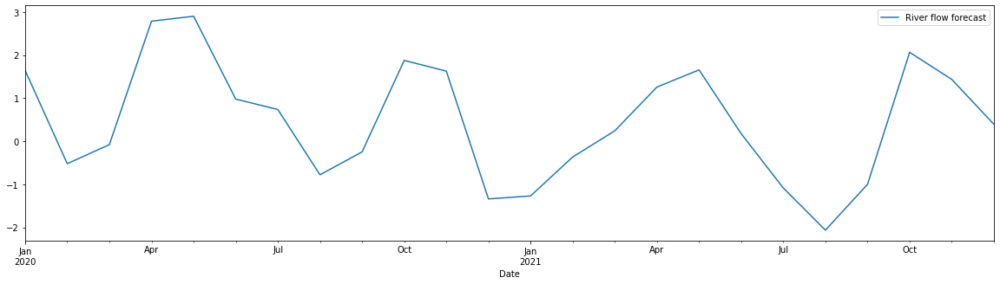


 ################ Basin 5 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


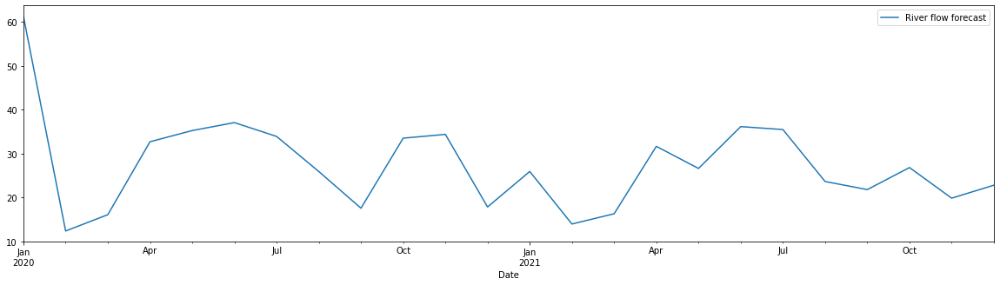


 ################ Basin 6 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


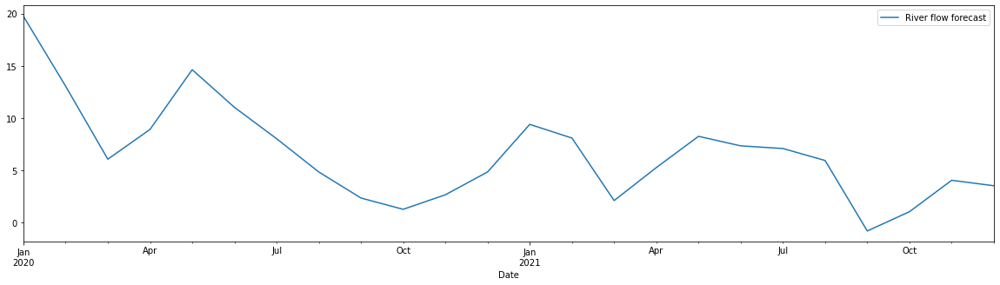


 ################ Basin 7 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


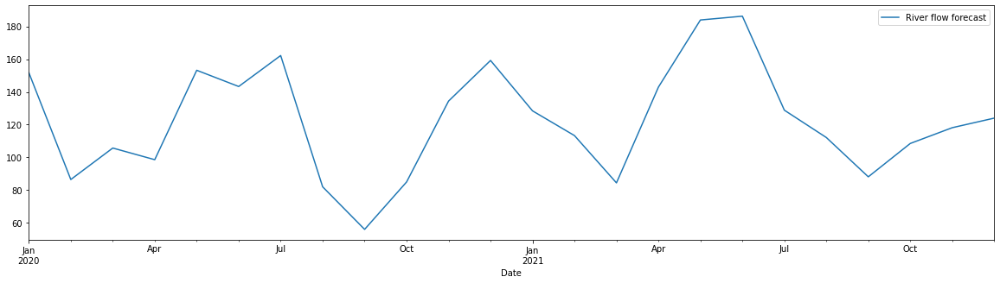


 ################ Basin 8 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


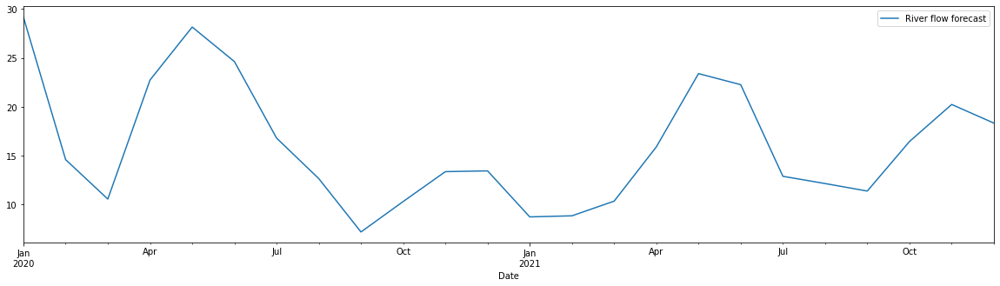


 ################ Basin 9 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


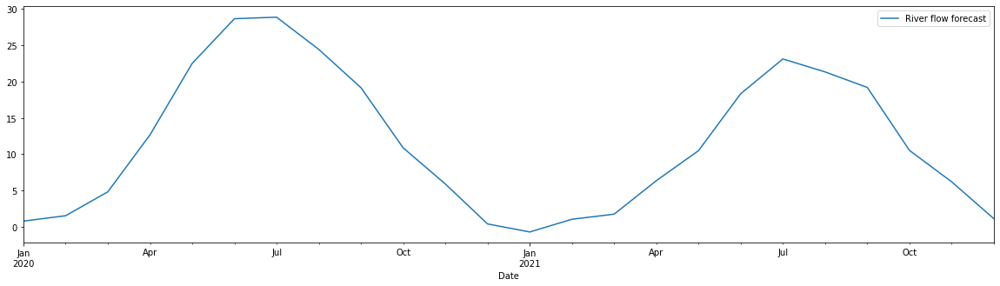


 ################ Basin 10 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


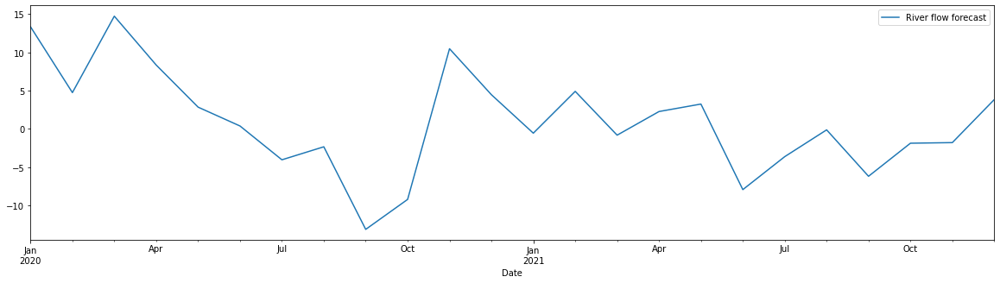


 ################ Basin 11 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


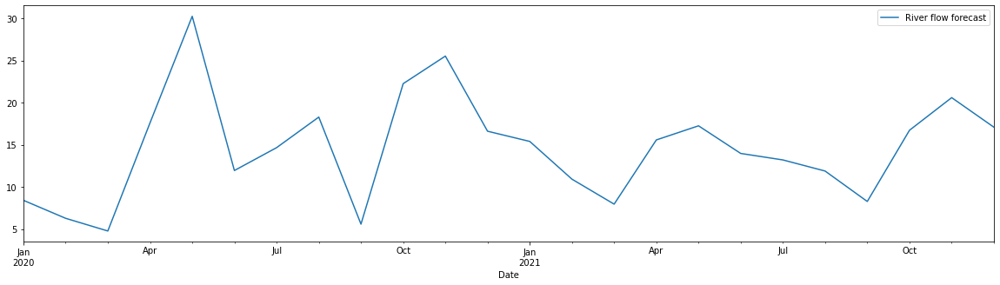


 ################ Basin 12 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


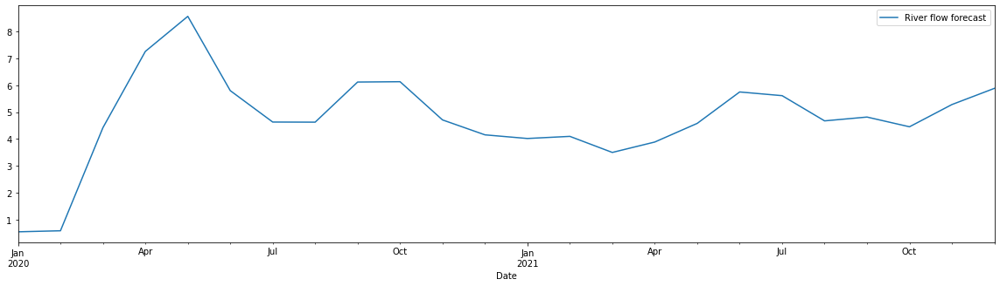


 ################ Basin 13 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


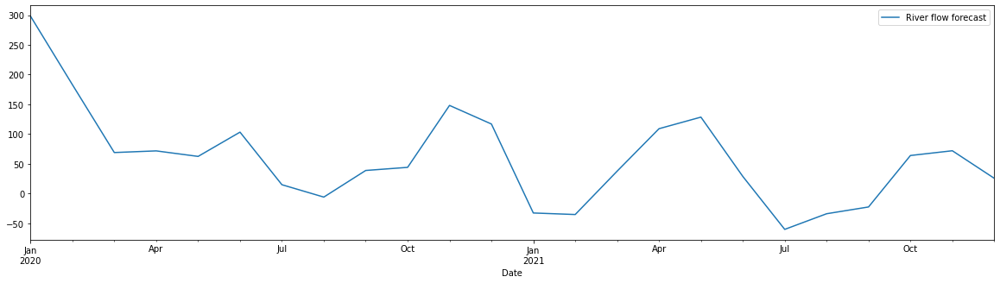


 ################ Basin 14 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


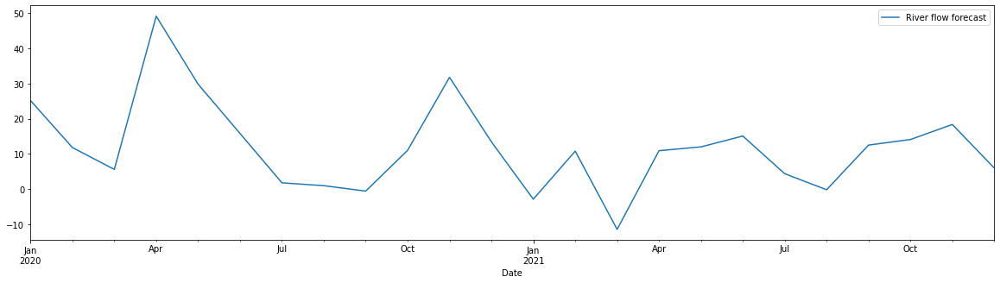


 ################ Basin 15 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


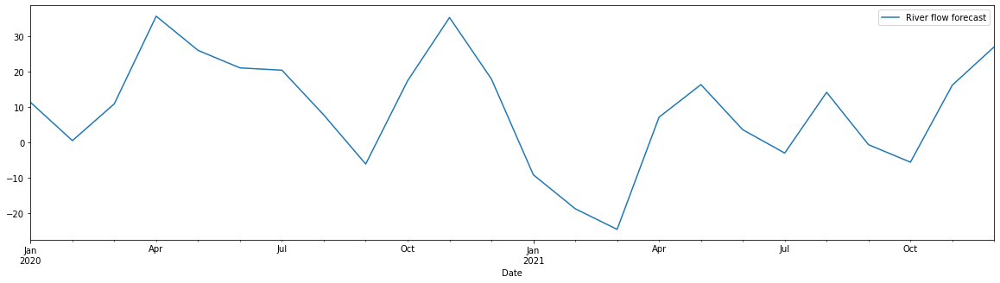


 ################ Basin 16 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


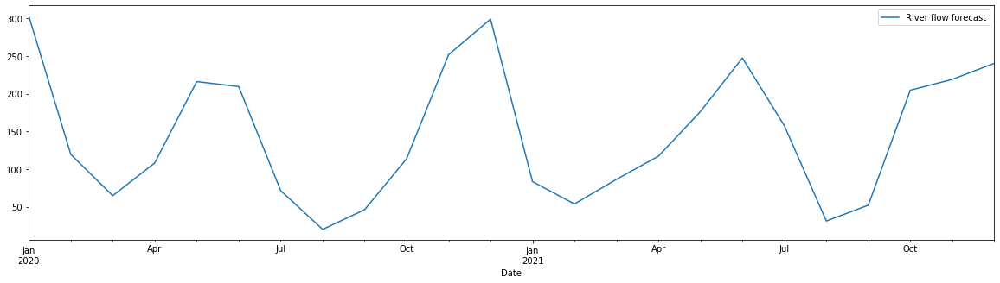


 ################ Basin 17 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


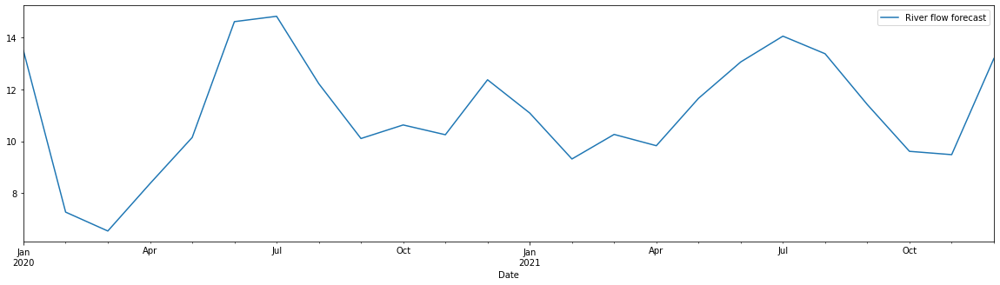


 ################ Basin 18 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


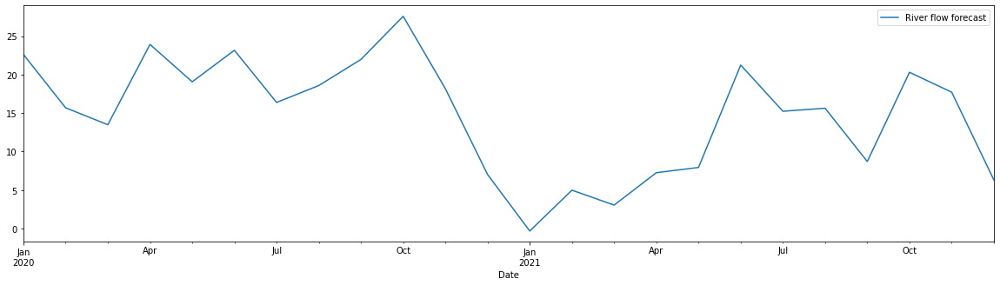


 ################ Basin 19 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


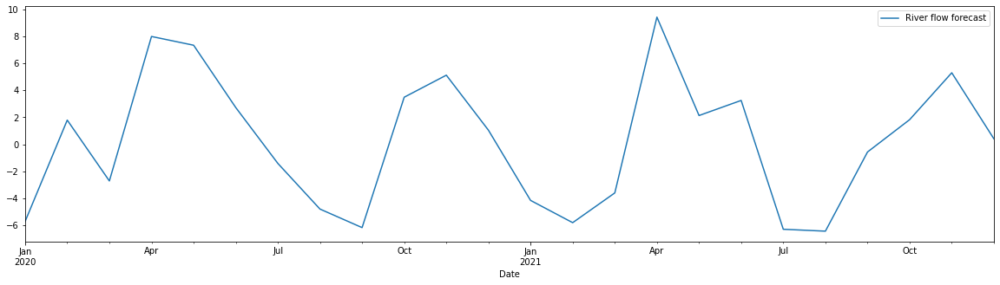


 ################ Basin 20 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


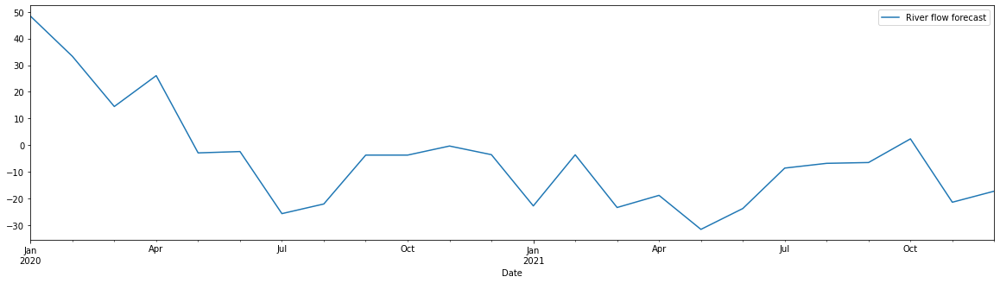


 ################ Basin 21 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


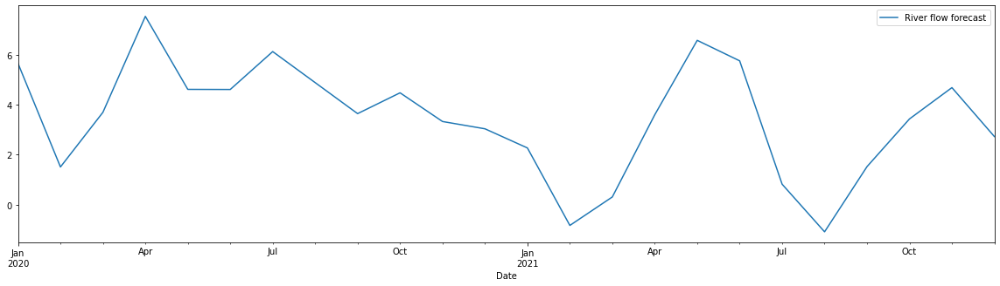


 ################ Basin 22 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


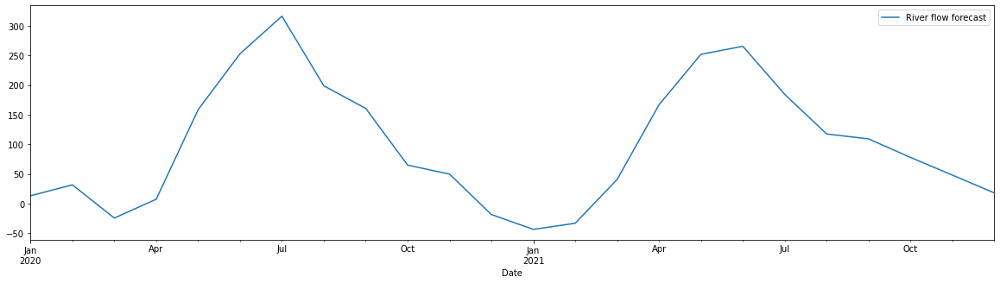


 ################ Basin 23 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


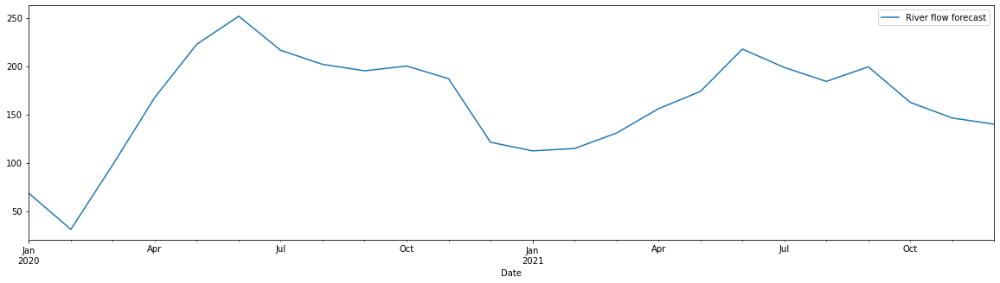


 ################ Basin 24 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


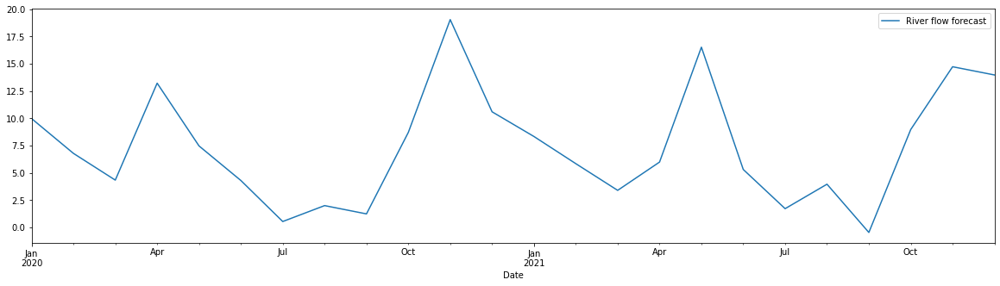


 ################ Basin 25 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


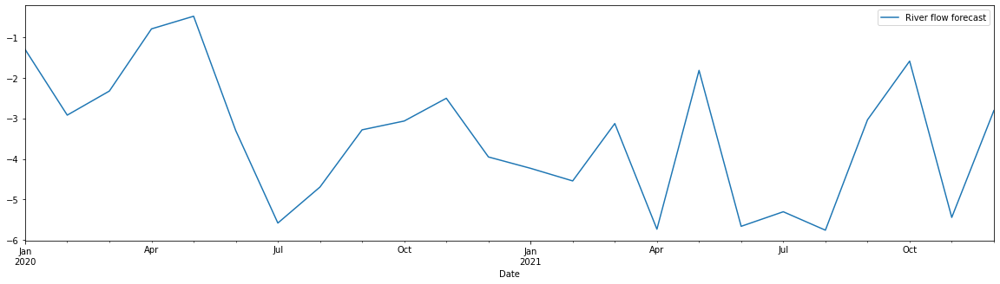


 ################ Basin 26 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


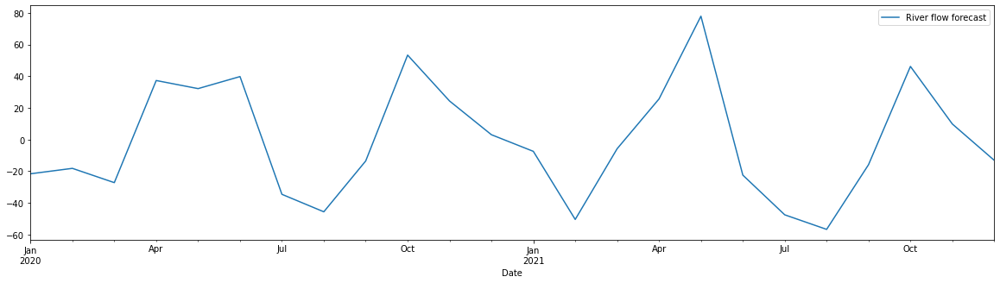


 ################ Basin 27 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


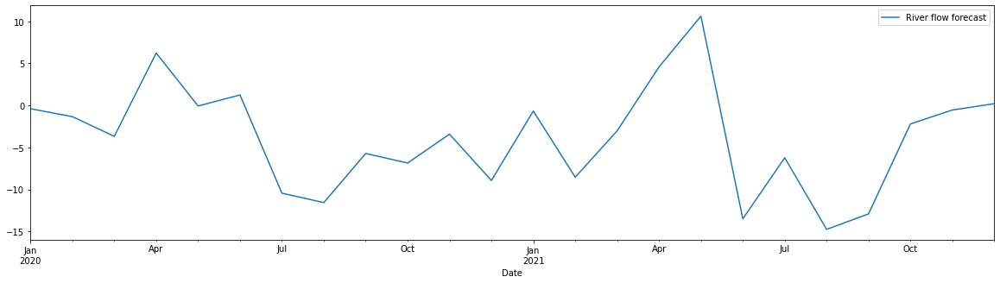


 ################ Basin 28 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


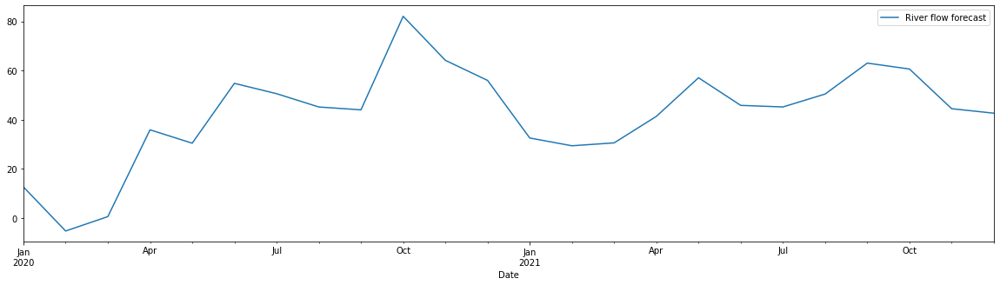


 ################ Basin 29 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


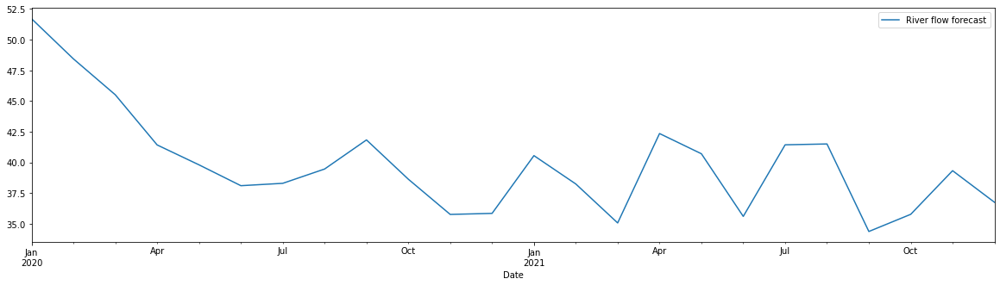


 ################ Basin 30 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


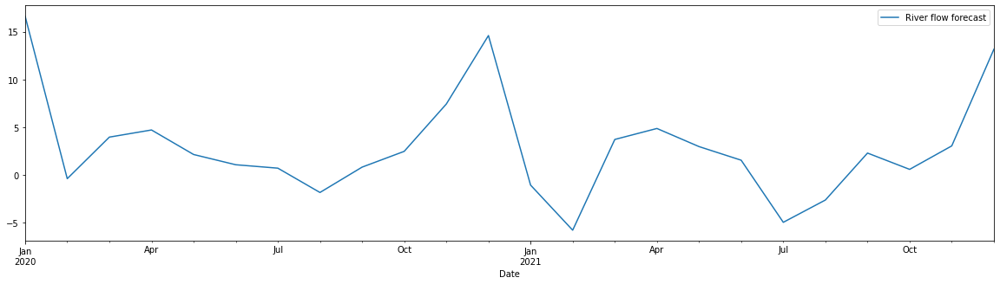


 ################ Basin 31 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


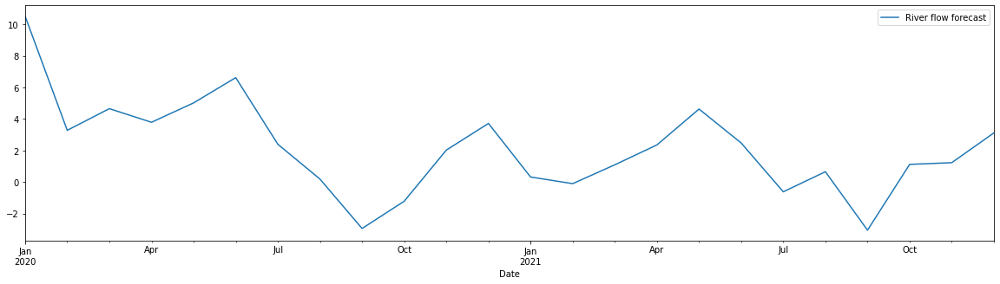


 ################ Basin 32 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


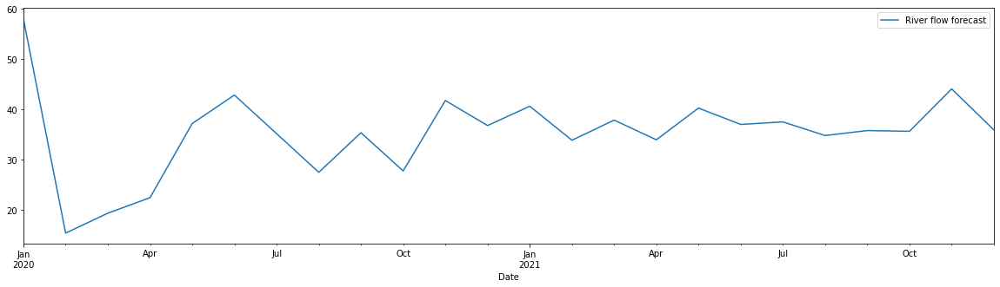


 ################ Basin 33 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


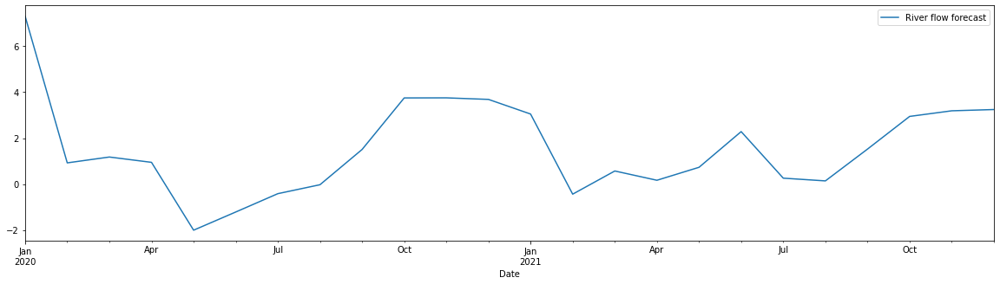


 ################ Basin 34 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


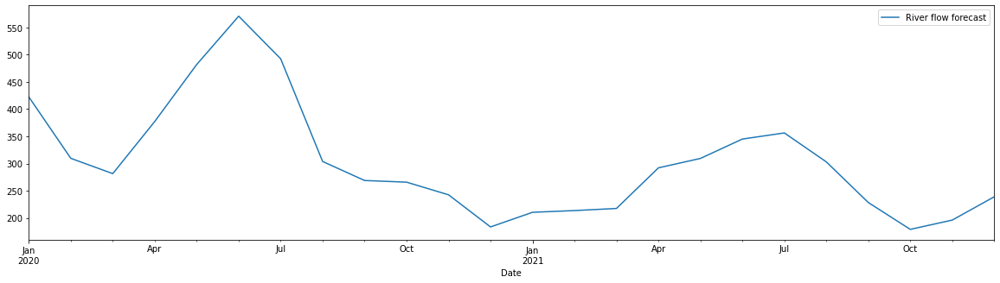


 ################ Basin 35 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


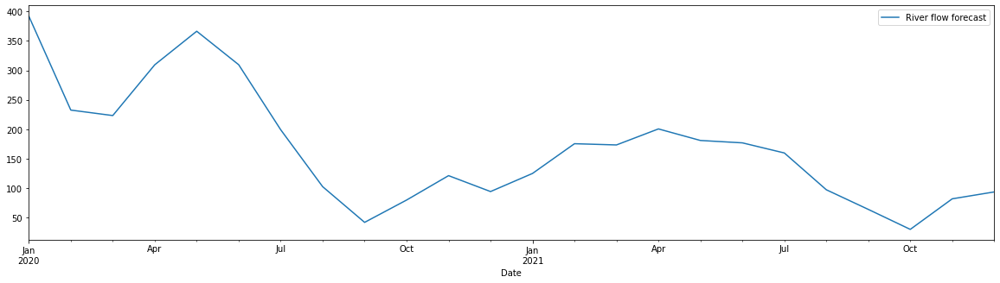


 ################ Basin 36 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


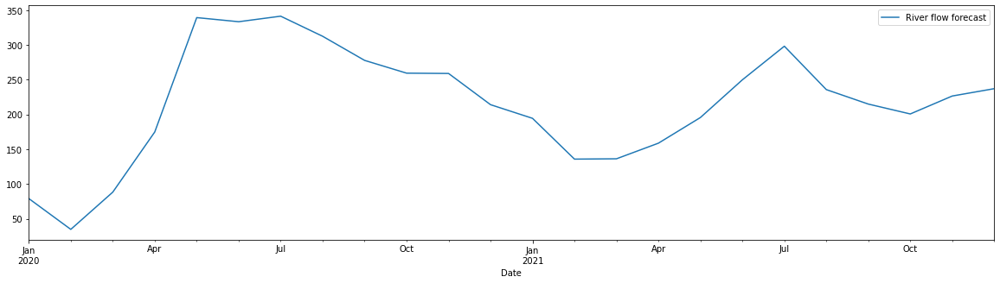


 ################ Basin 37 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


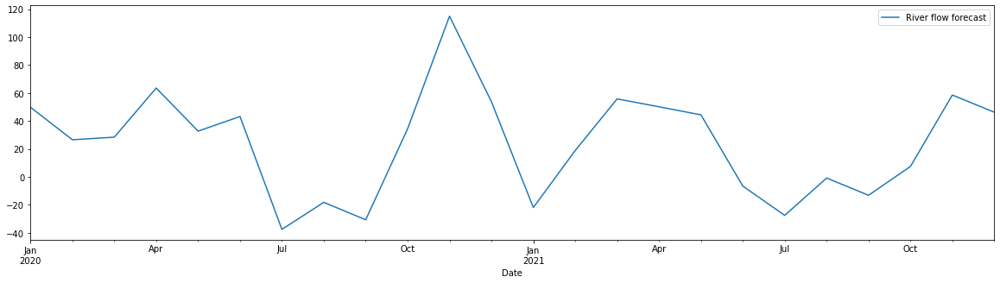


 ################ Basin 38 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


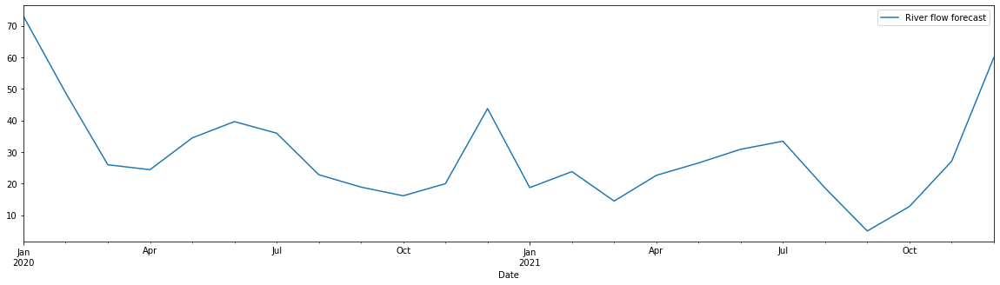


 ################ Basin 39 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


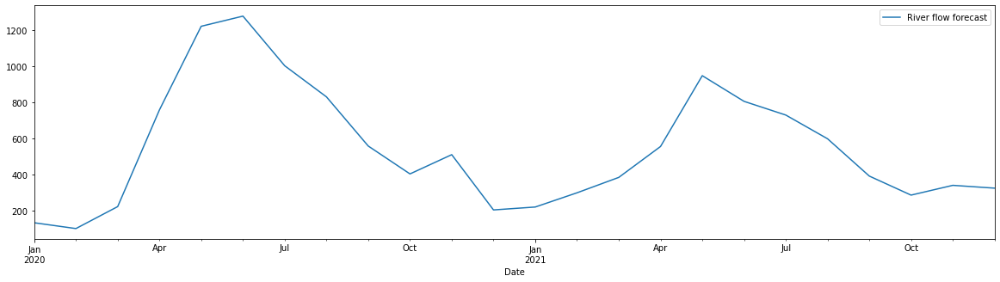


 ################ Basin 40 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


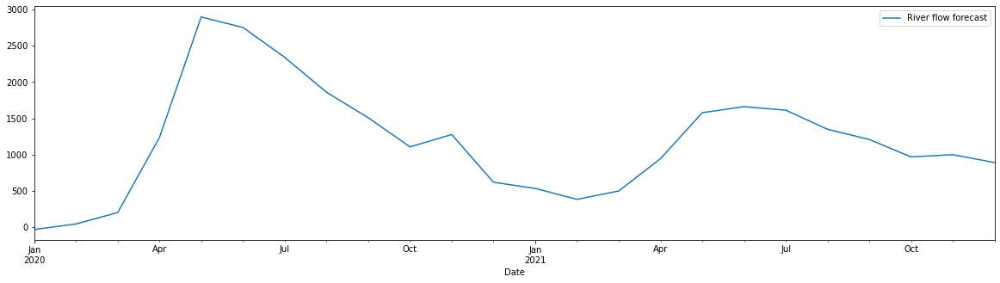


 ################ Basin 41 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


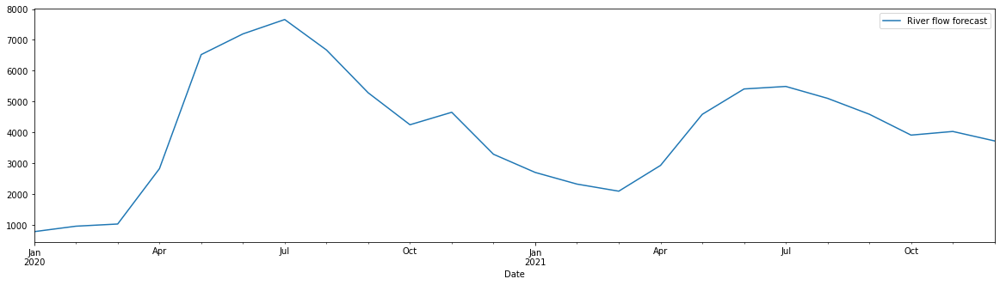


 ################ Basin 42 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


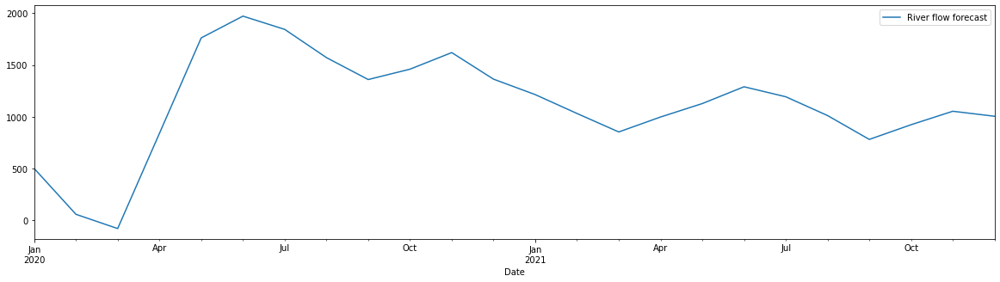


 ################ Basin 43 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


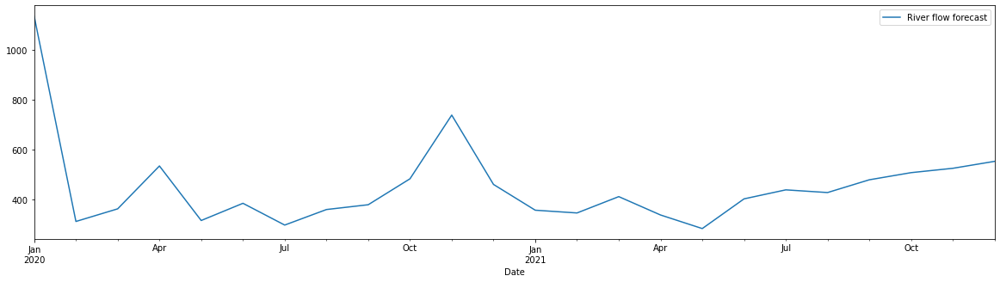


 ################ Basin 44 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


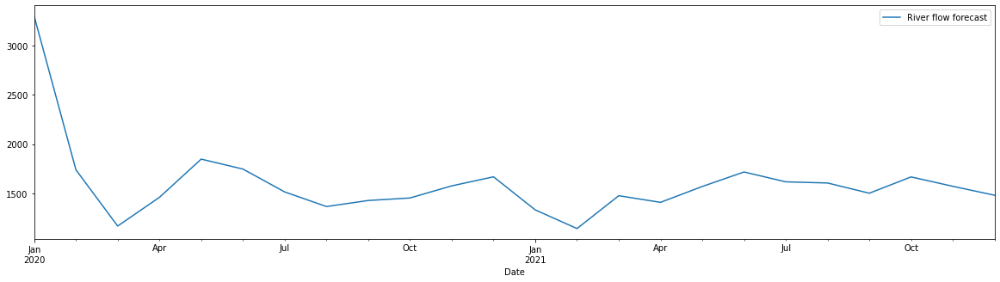


 ################ Basin 45 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


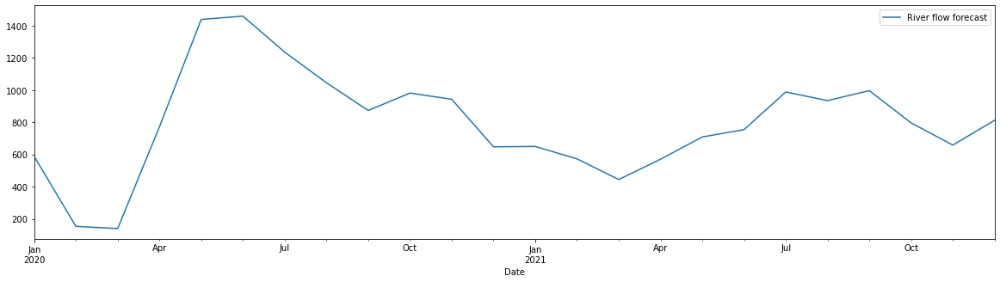


 ################ Basin 46 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


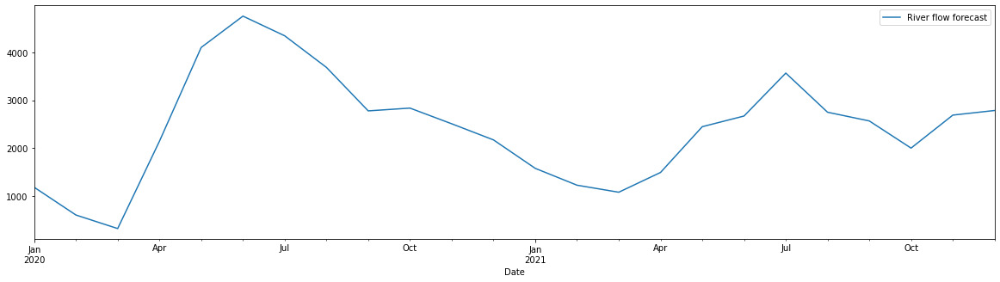


 ################ Basin 47 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


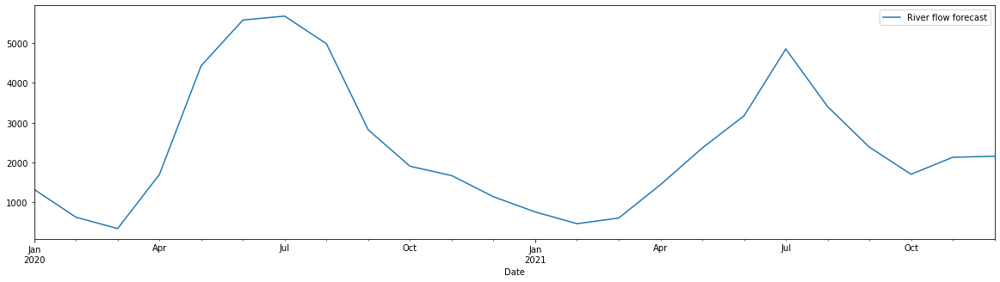


 ################ Basin 48 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


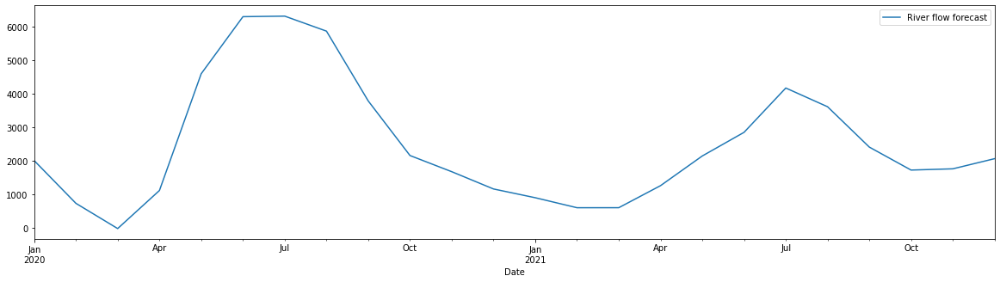

Def_25%
P_A2

 ################ Basin 1 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


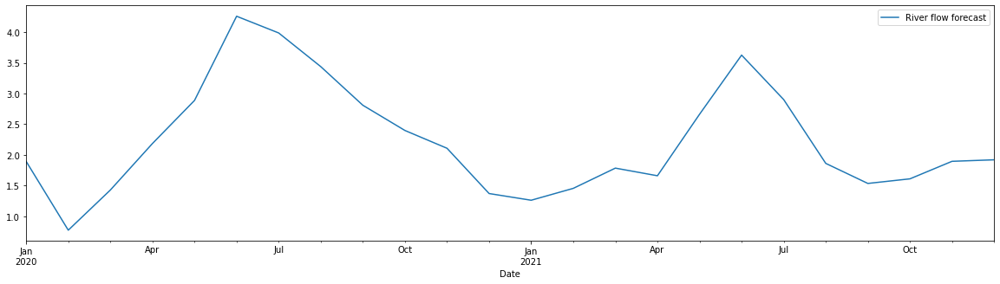


 ################ Basin 2 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


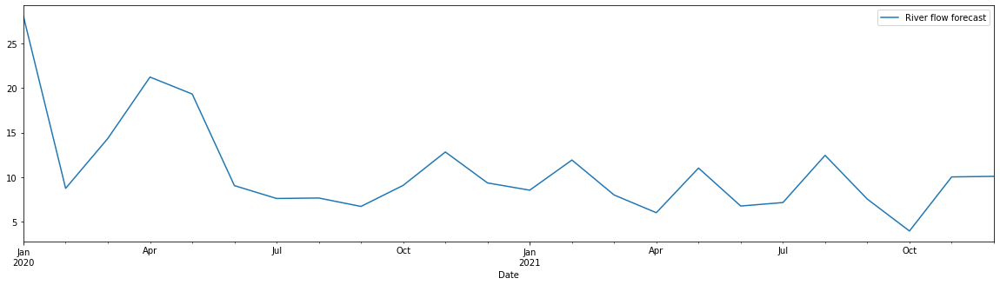


 ################ Basin 3 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


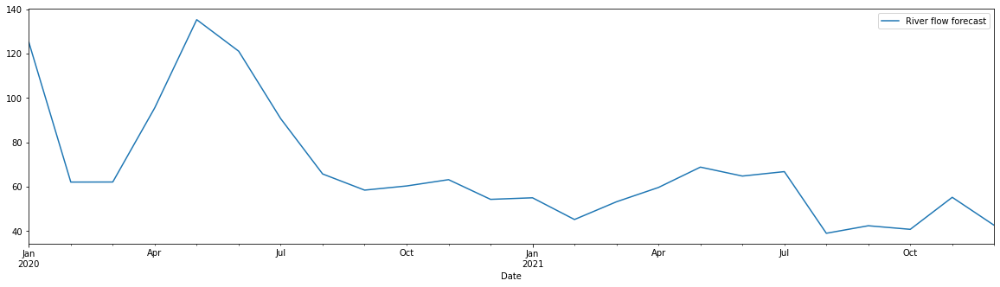


 ################ Basin 4 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


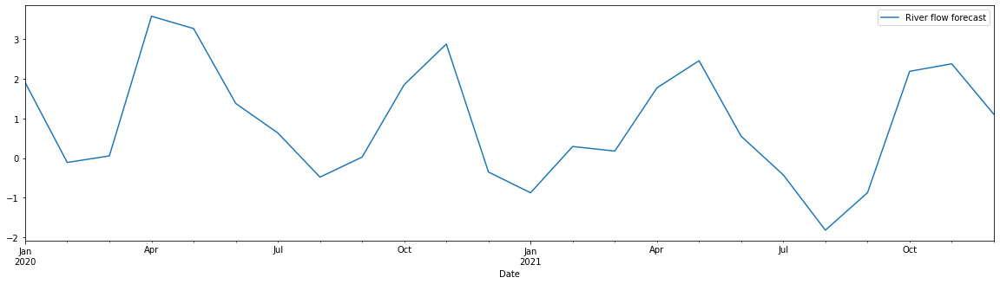


 ################ Basin 5 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


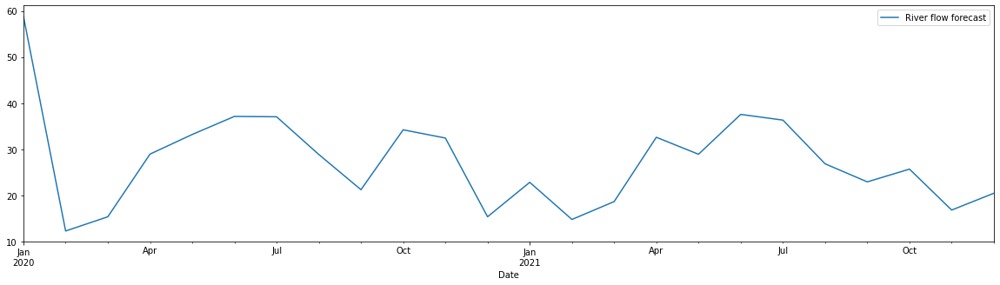


 ################ Basin 6 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


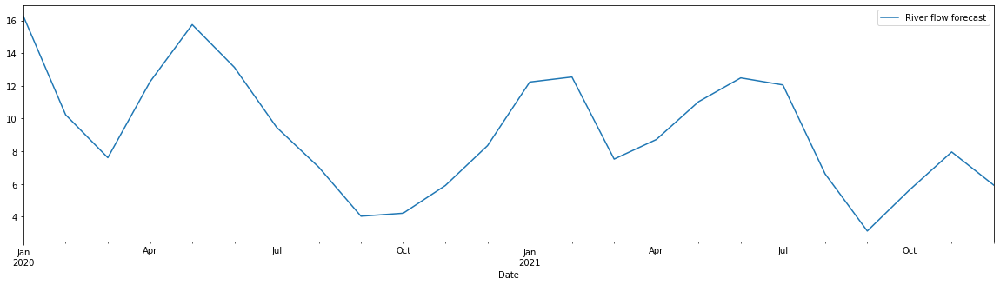


 ################ Basin 7 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


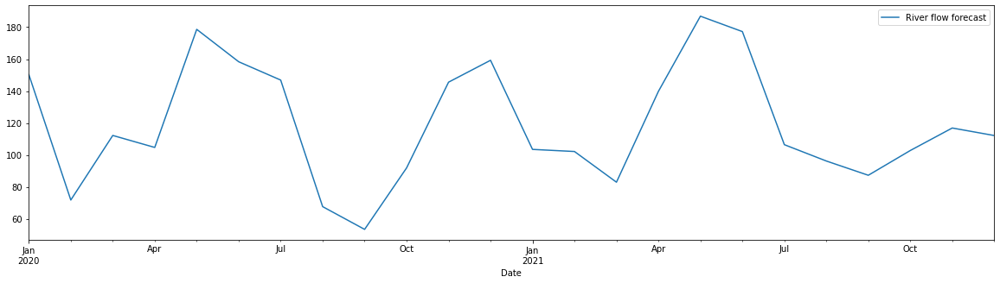


 ################ Basin 8 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


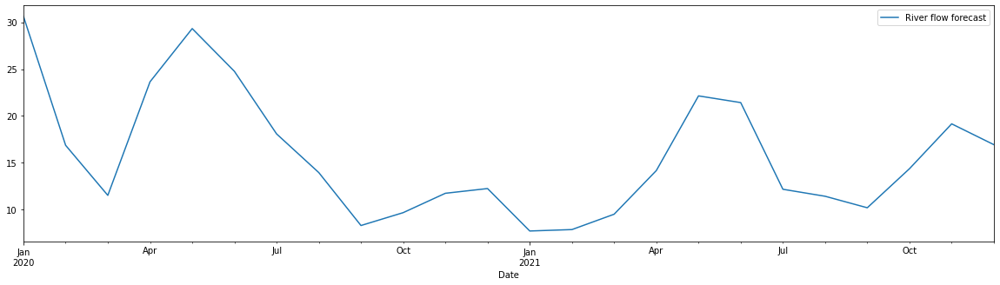


 ################ Basin 9 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


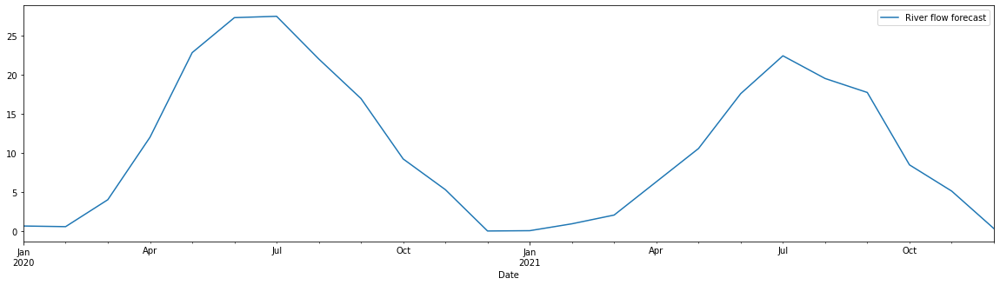


 ################ Basin 10 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


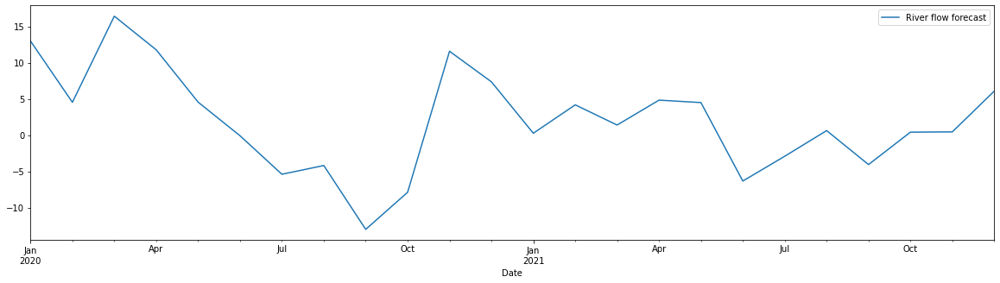


 ################ Basin 11 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


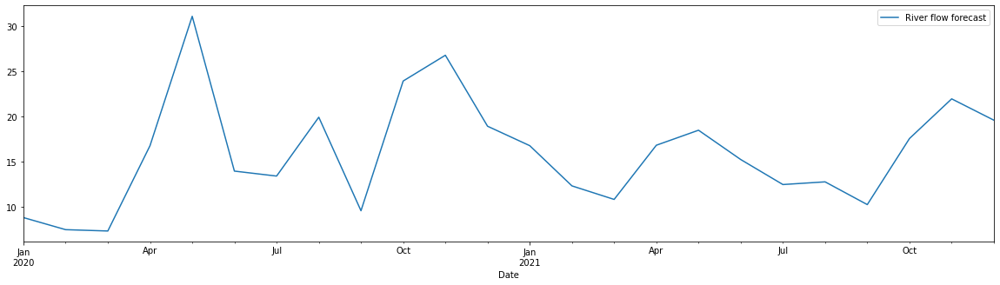


 ################ Basin 12 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


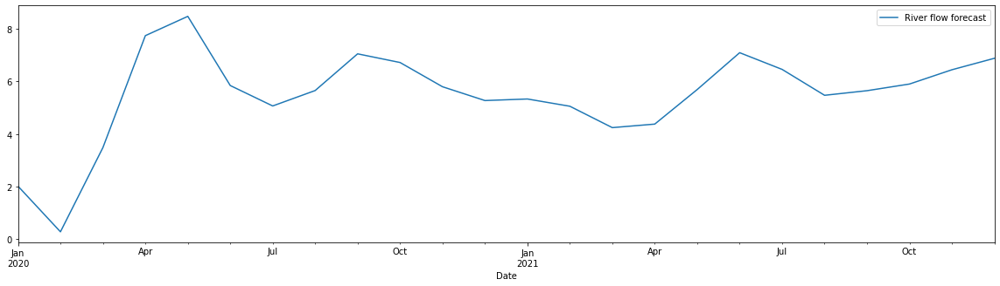


 ################ Basin 13 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


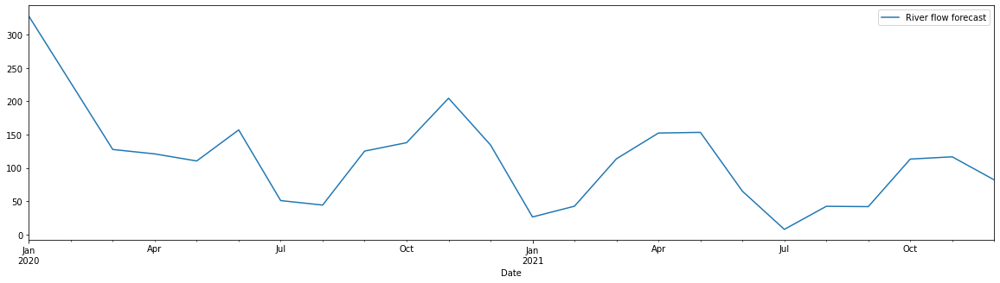


 ################ Basin 14 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


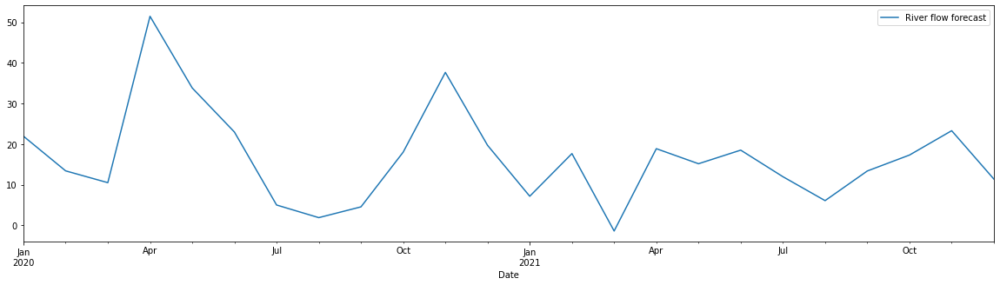


 ################ Basin 15 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


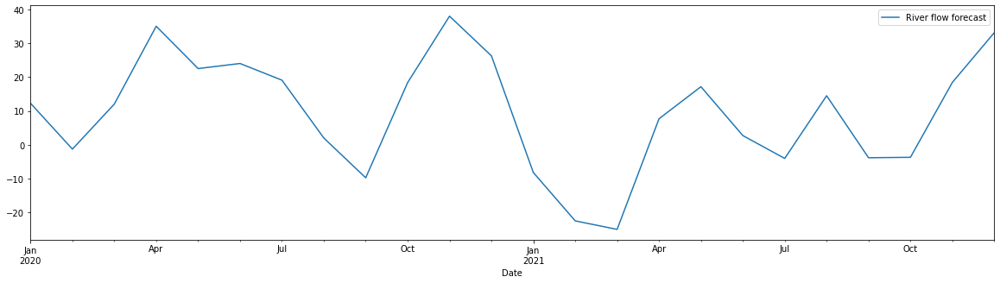


 ################ Basin 16 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


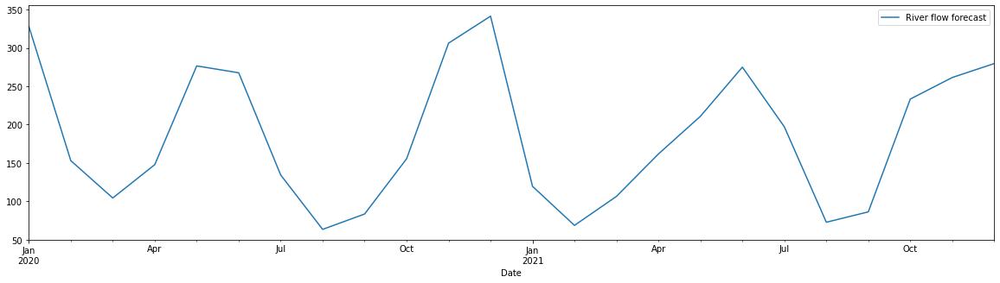


 ################ Basin 17 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


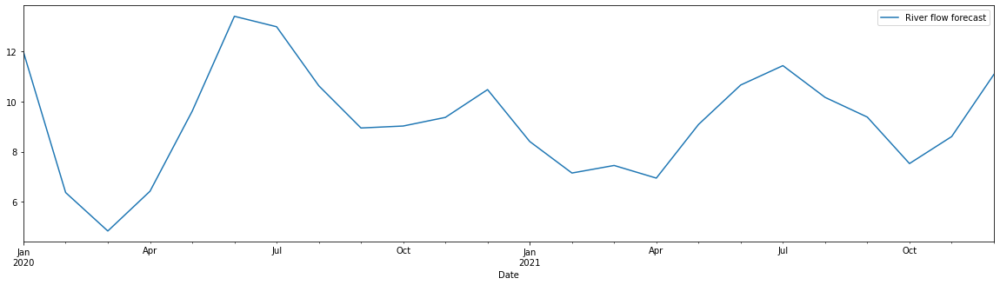


 ################ Basin 18 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


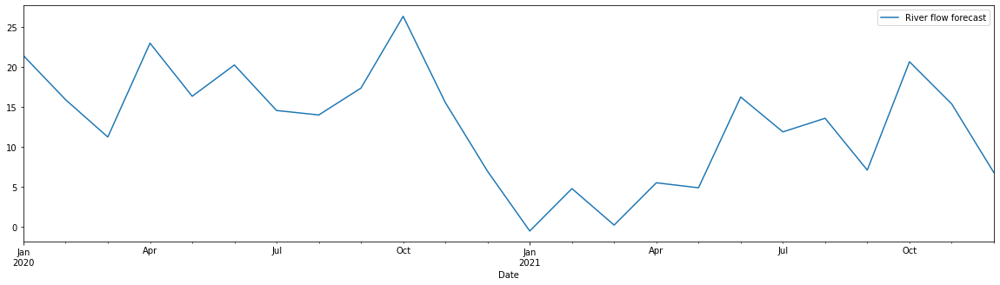


 ################ Basin 19 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


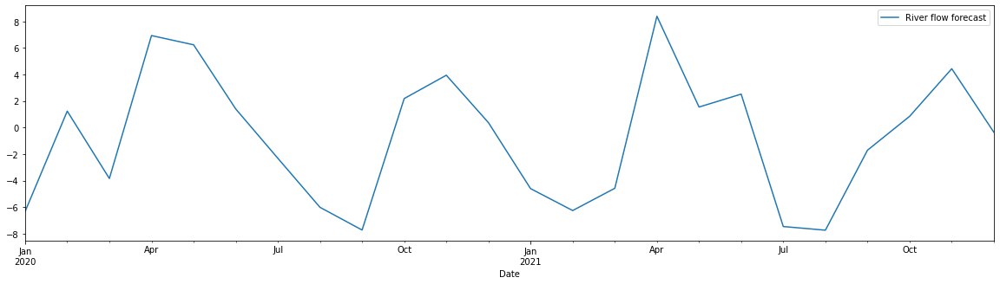


 ################ Basin 20 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


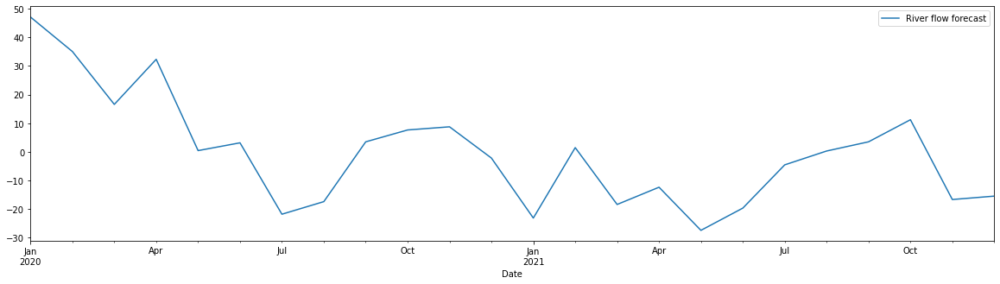


 ################ Basin 21 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


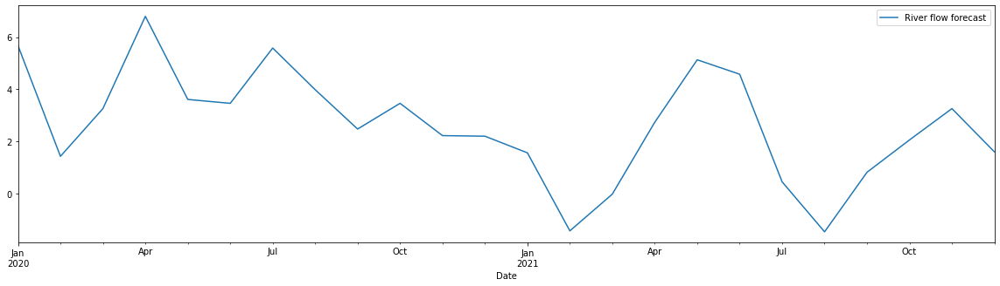


 ################ Basin 22 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


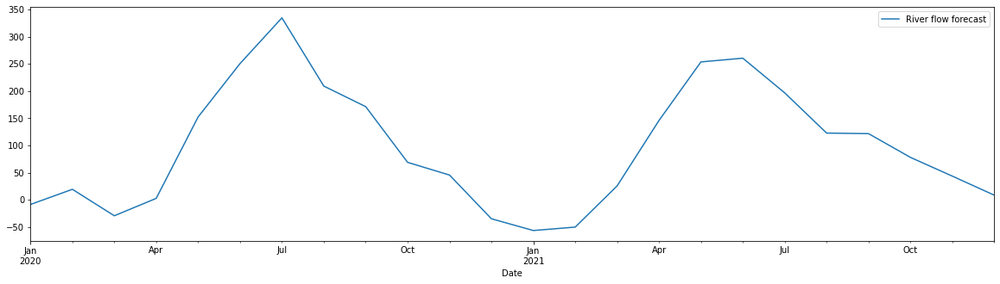


 ################ Basin 23 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


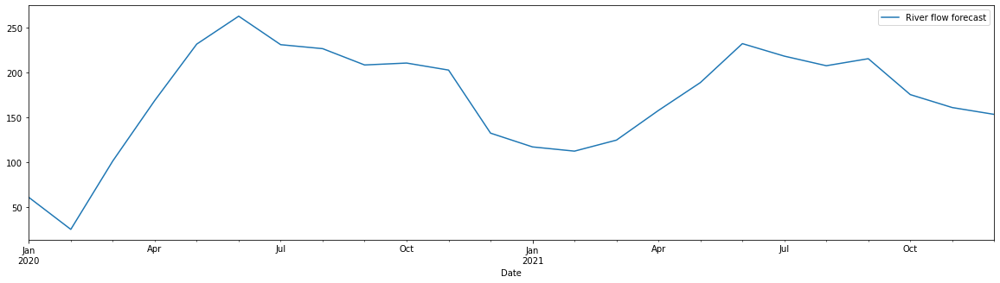


 ################ Basin 24 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


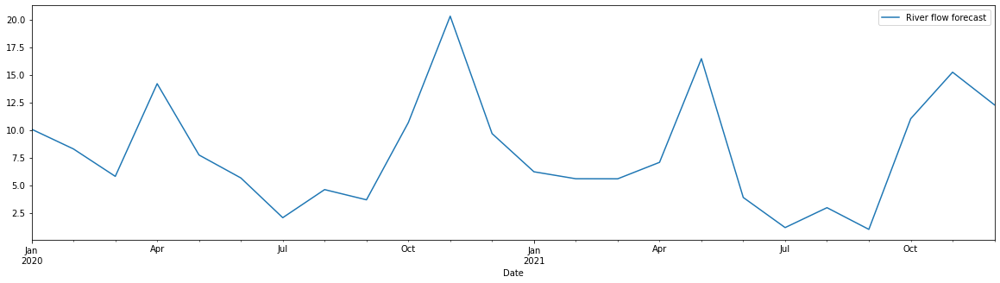


 ################ Basin 25 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


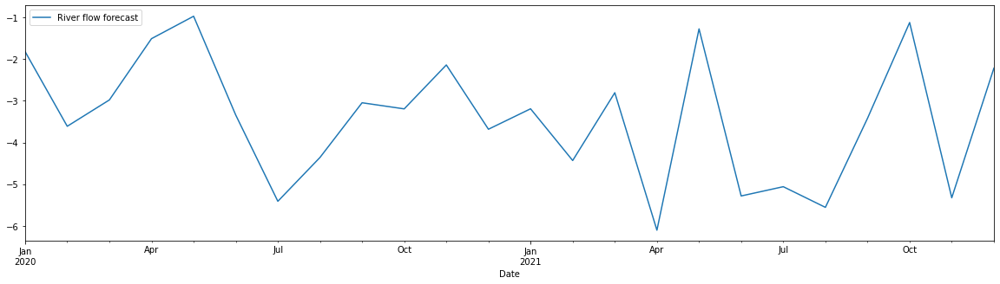


 ################ Basin 26 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


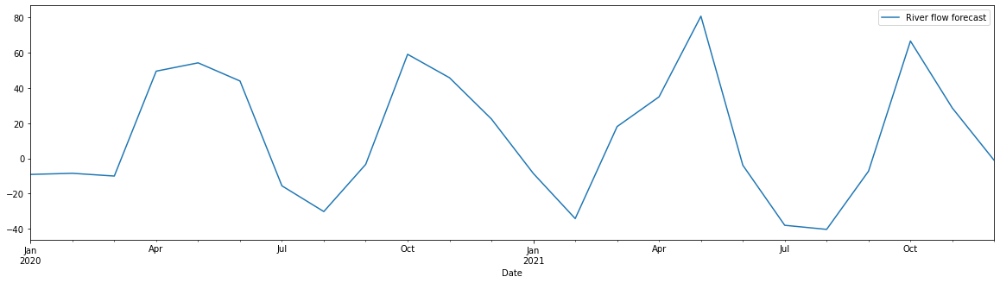


 ################ Basin 27 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


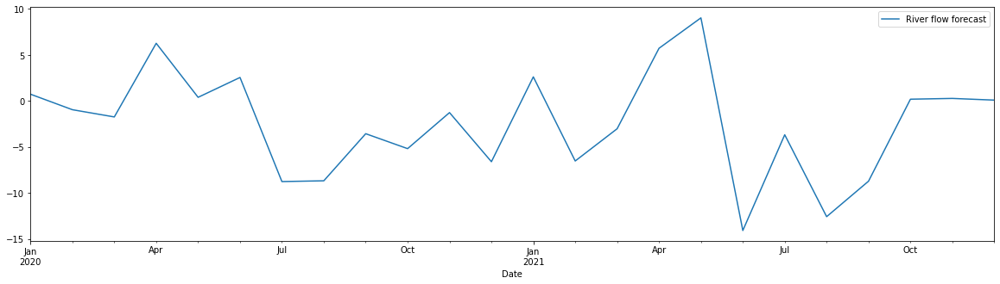


 ################ Basin 28 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


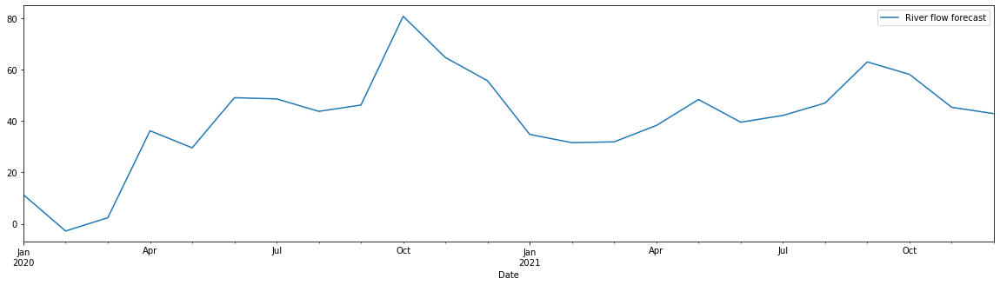


 ################ Basin 29 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


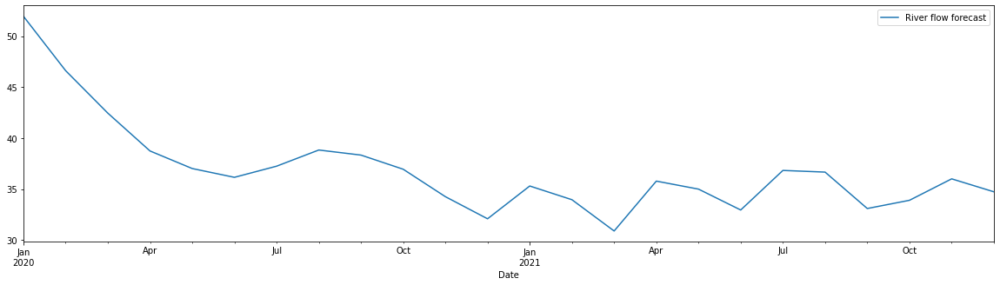


 ################ Basin 30 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


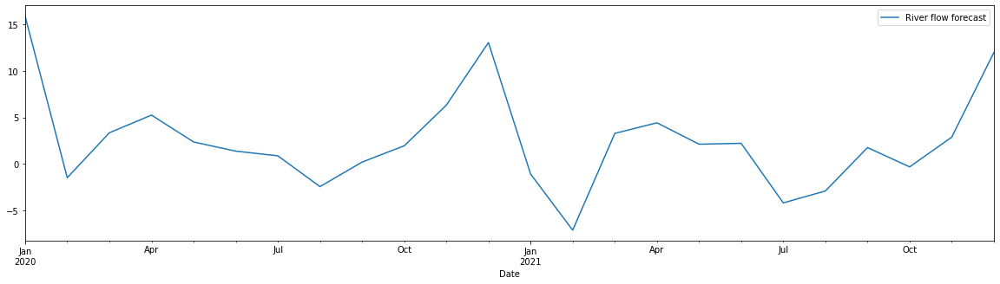


 ################ Basin 31 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


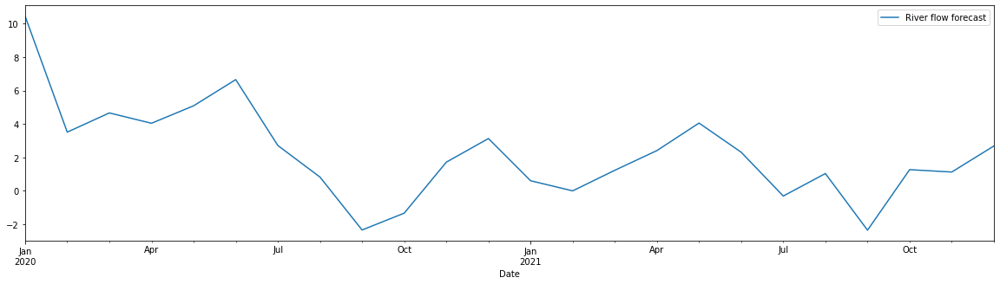


 ################ Basin 32 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


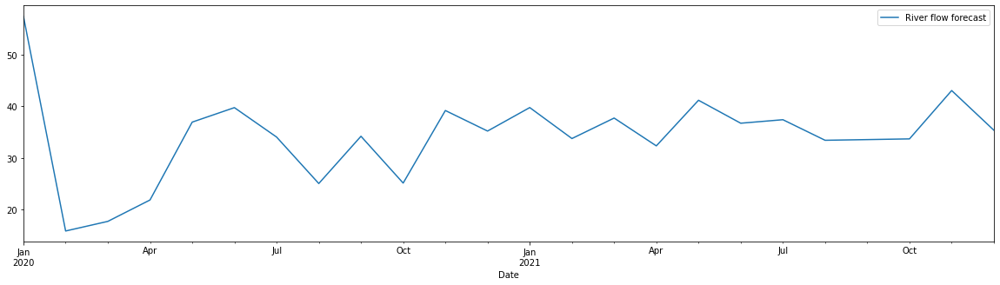


 ################ Basin 33 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


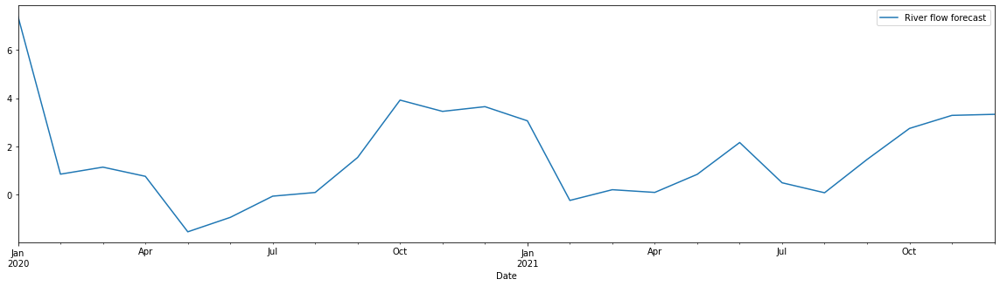


 ################ Basin 34 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


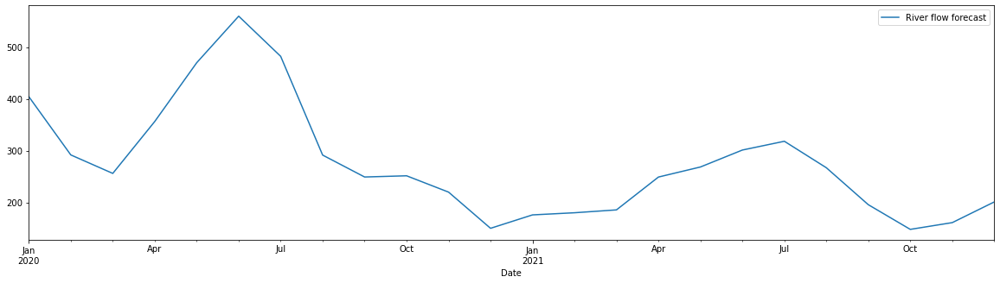


 ################ Basin 35 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


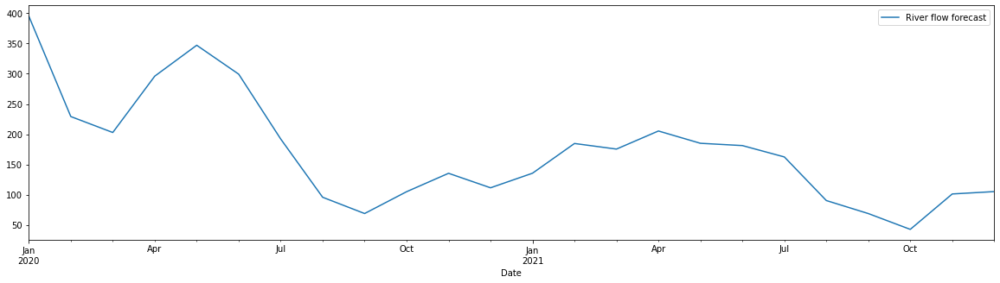


 ################ Basin 36 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


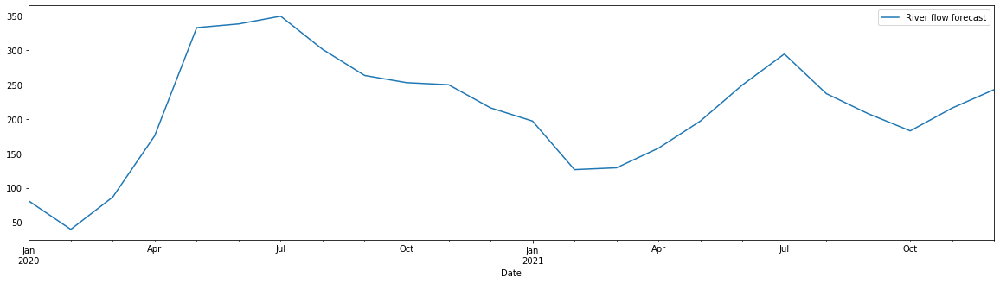


 ################ Basin 37 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


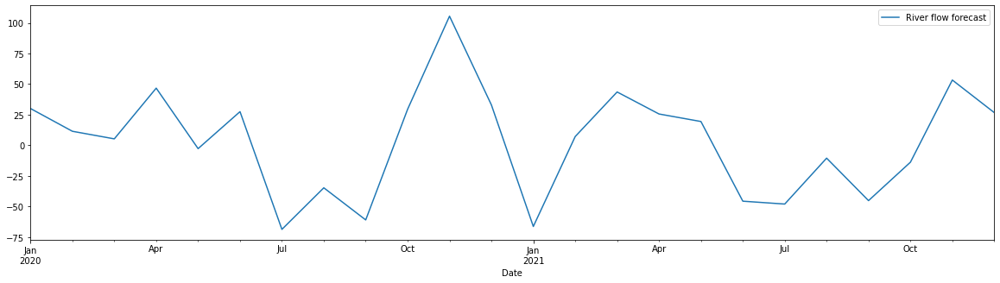


 ################ Basin 38 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


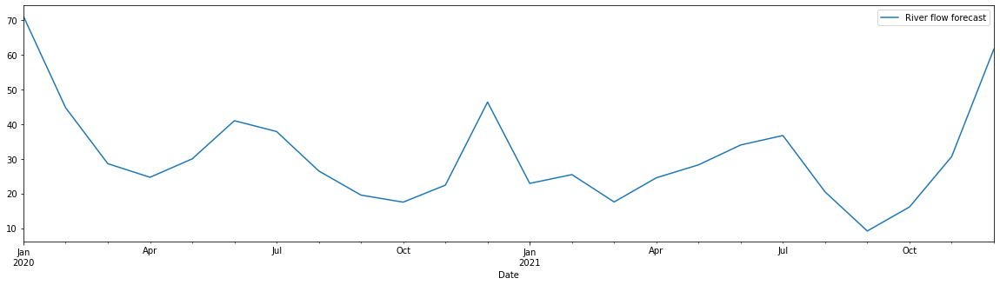


 ################ Basin 39 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


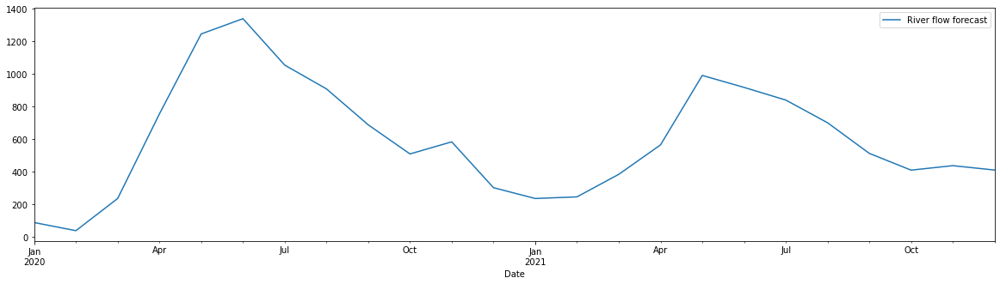


 ################ Basin 40 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


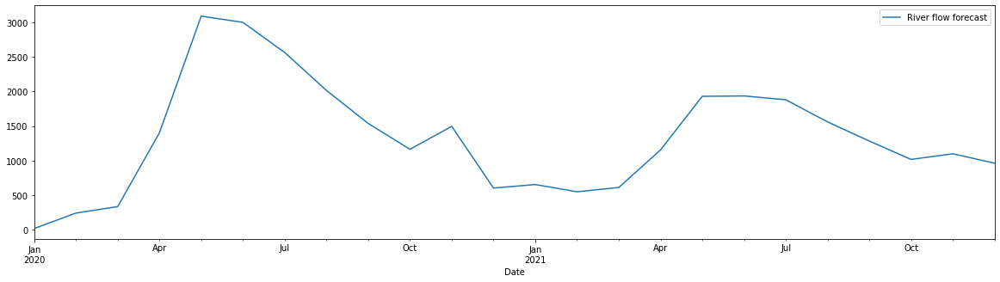


 ################ Basin 41 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


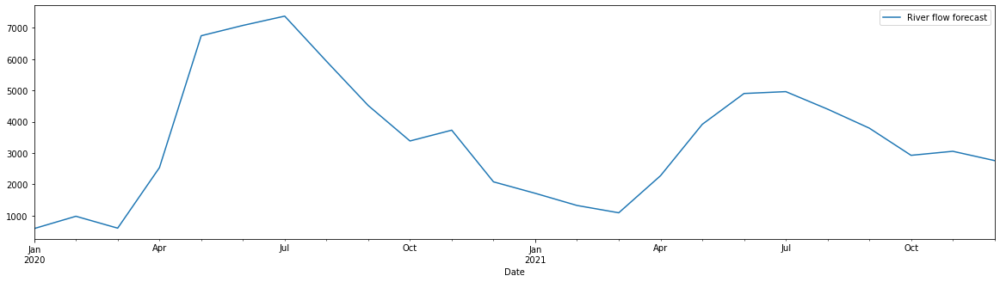


 ################ Basin 42 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


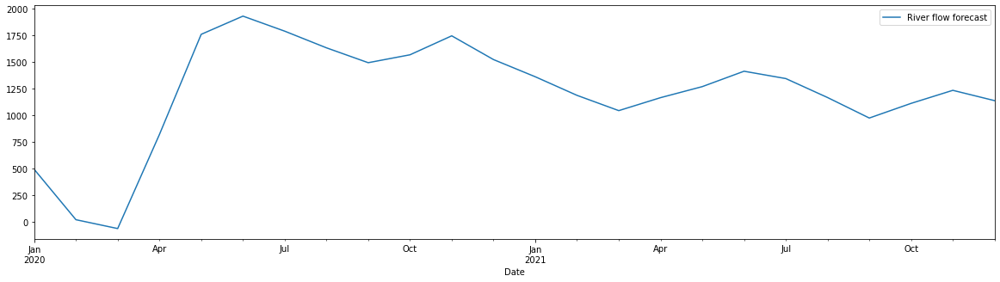


 ################ Basin 43 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


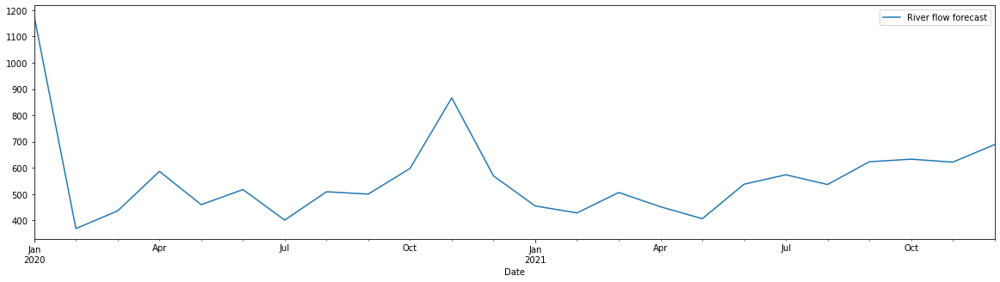


 ################ Basin 44 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


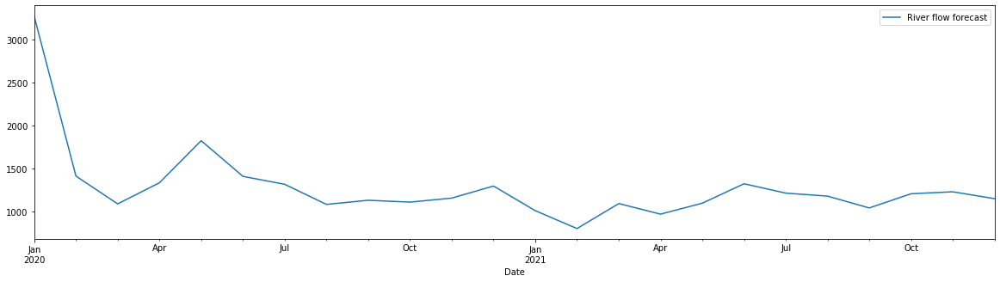


 ################ Basin 45 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


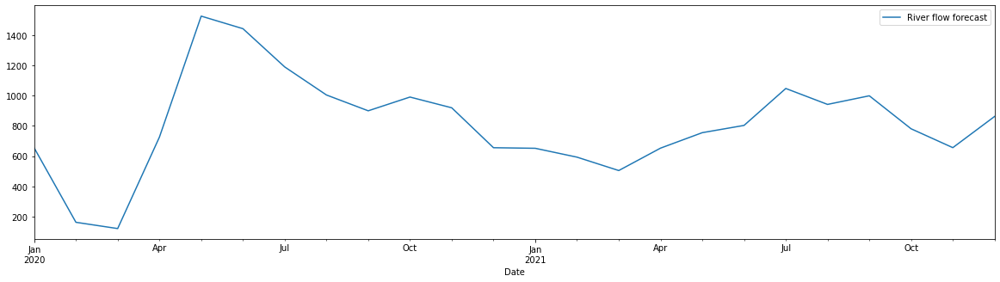


 ################ Basin 46 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


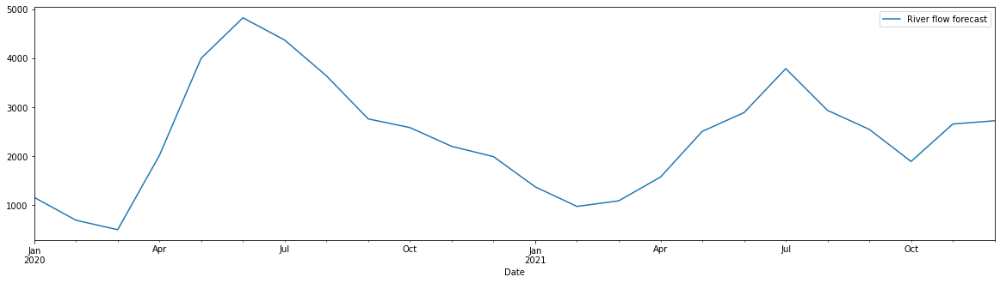


 ################ Basin 47 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


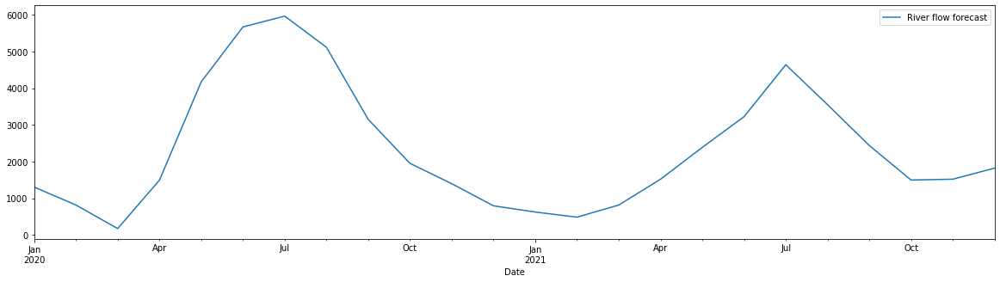


 ################ Basin 48 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


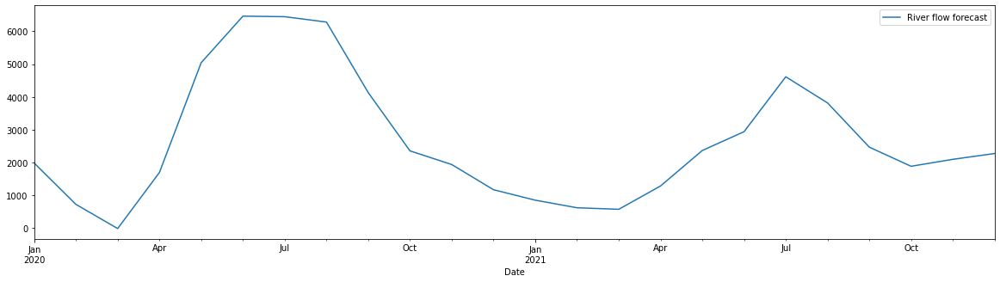

Def_25%
P_B1

 ################ Basin 1 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


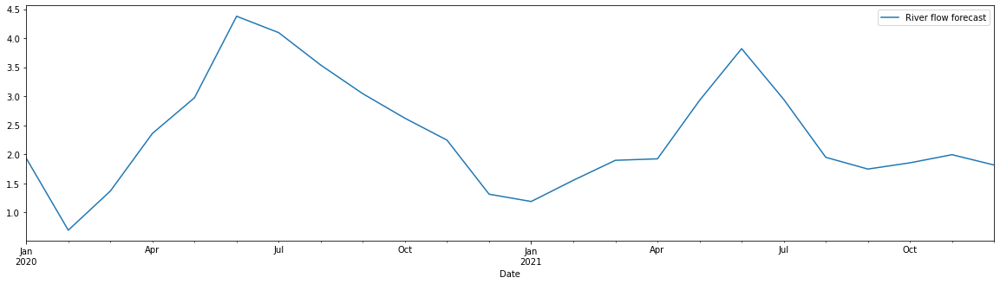


 ################ Basin 2 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


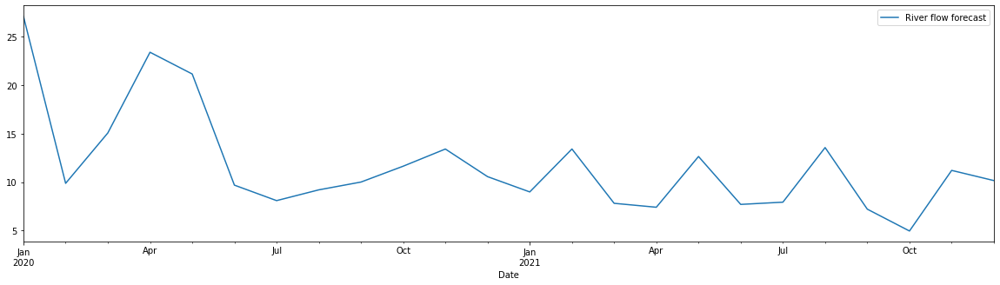


 ################ Basin 3 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


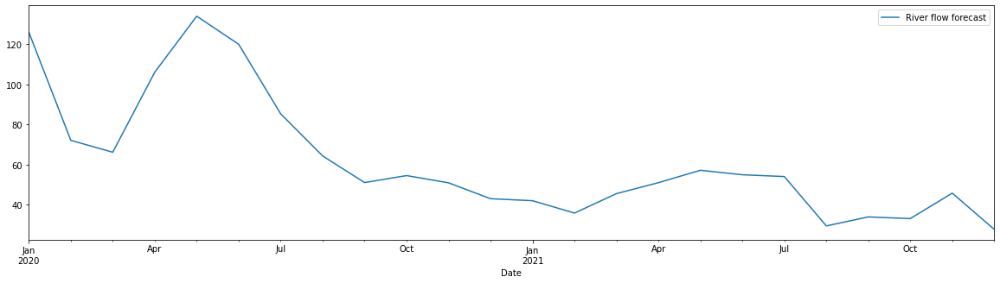


 ################ Basin 4 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


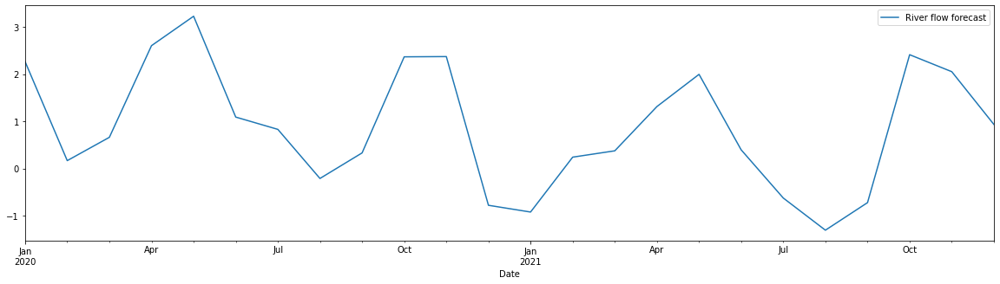


 ################ Basin 5 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


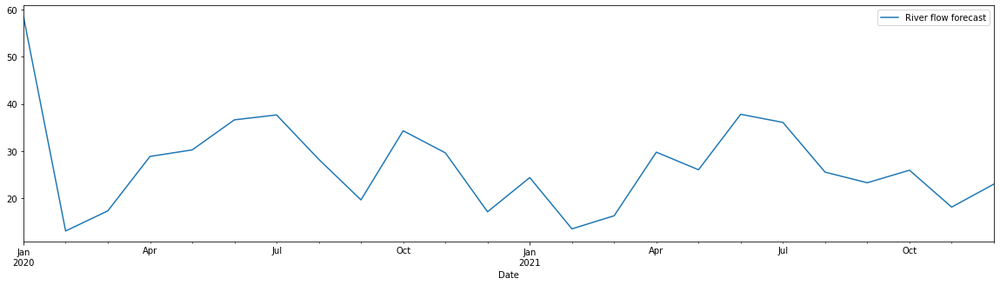


 ################ Basin 6 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


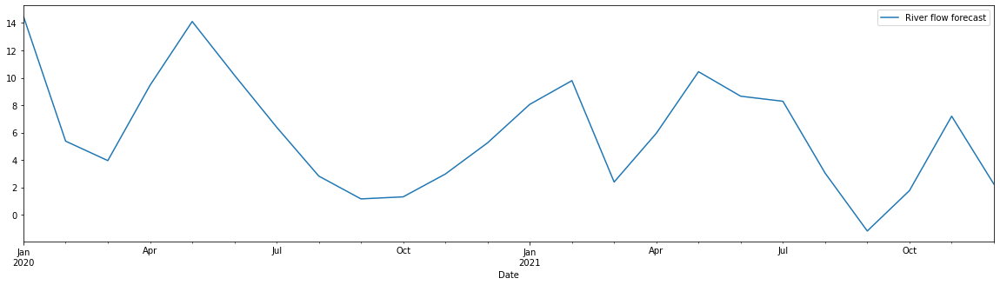


 ################ Basin 7 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


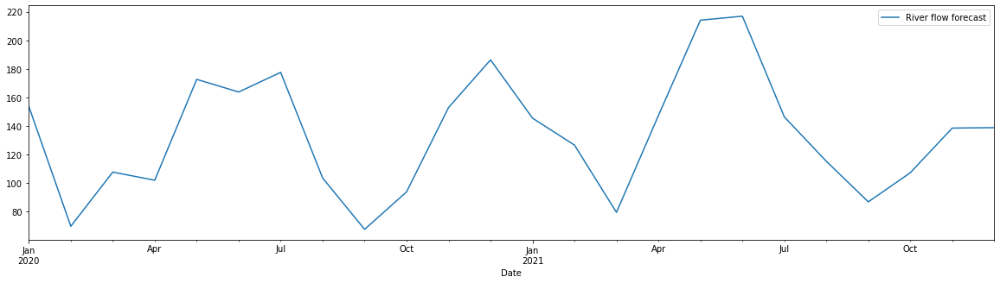


 ################ Basin 8 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


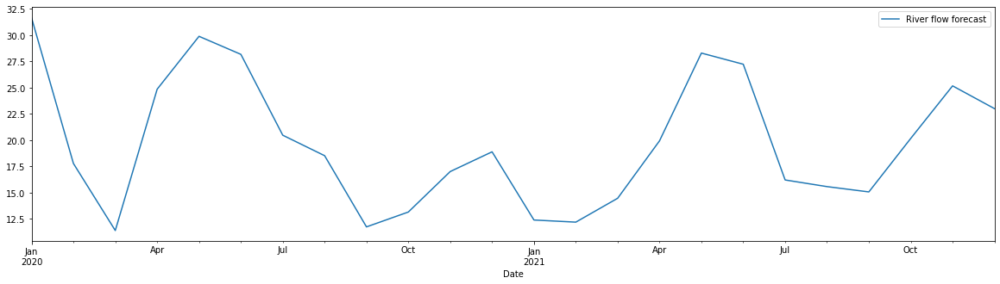


 ################ Basin 9 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


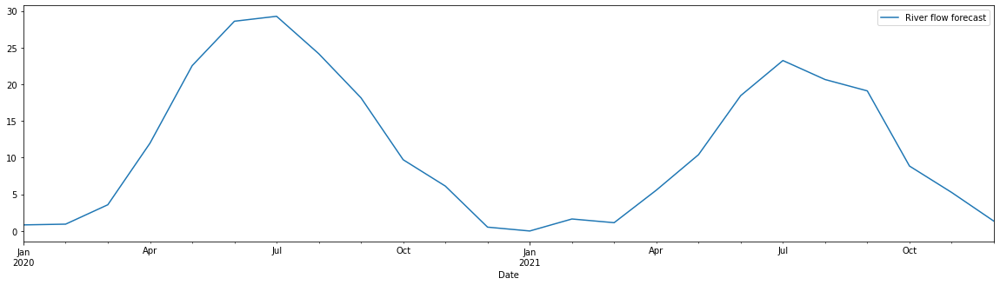


 ################ Basin 10 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


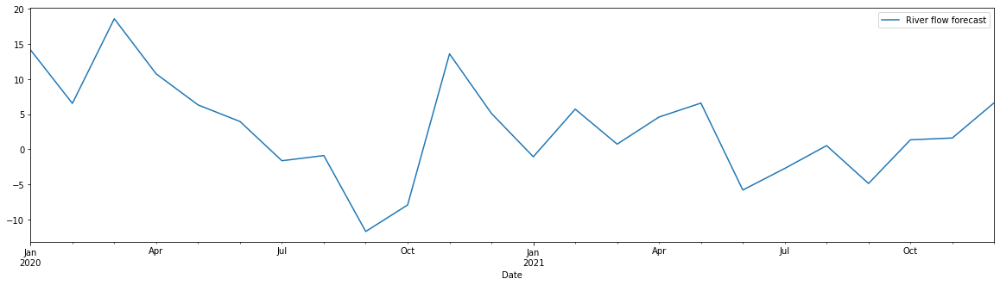


 ################ Basin 11 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


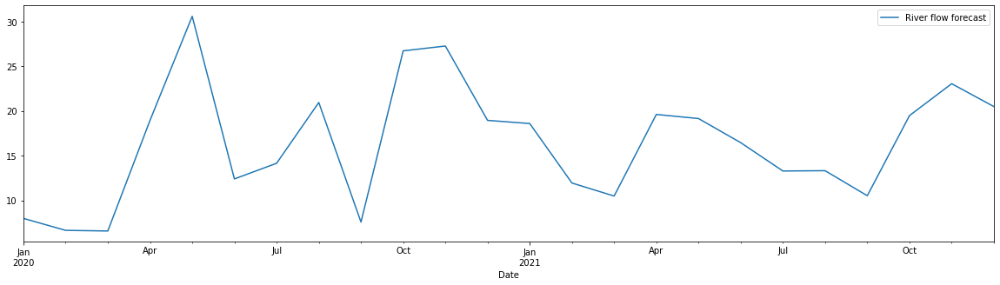


 ################ Basin 12 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


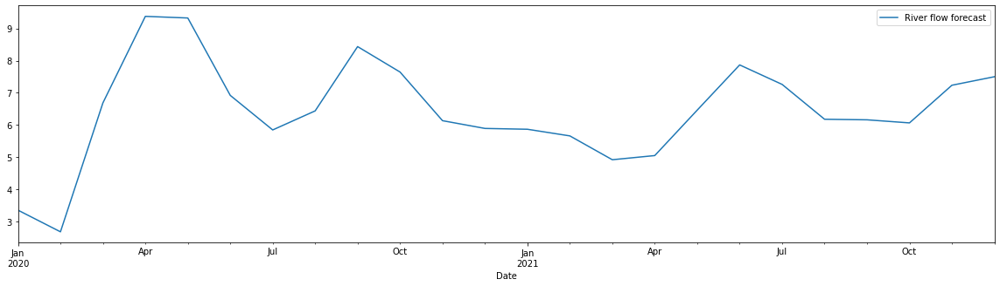


 ################ Basin 13 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


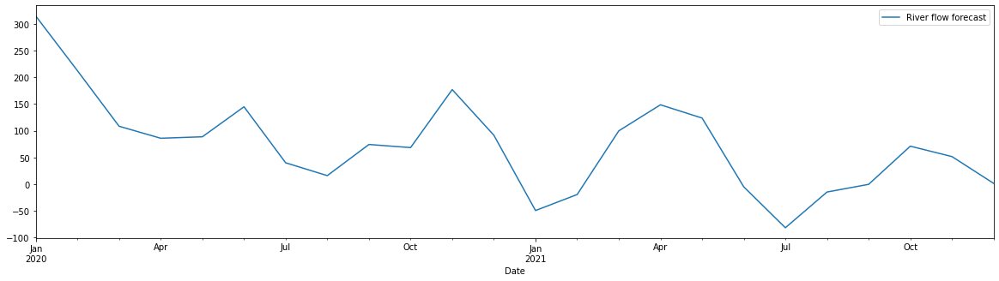


 ################ Basin 14 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


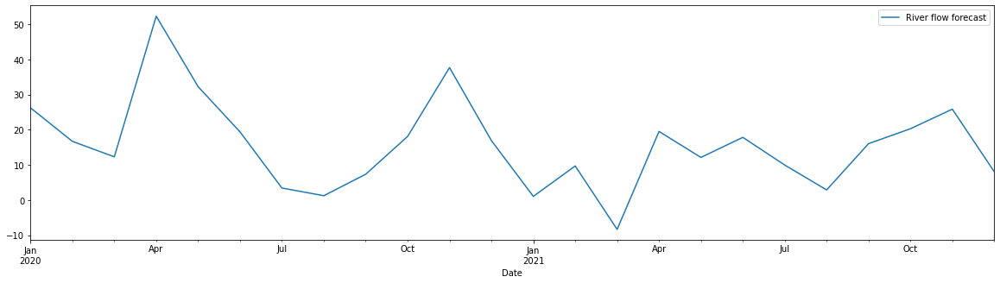


 ################ Basin 15 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


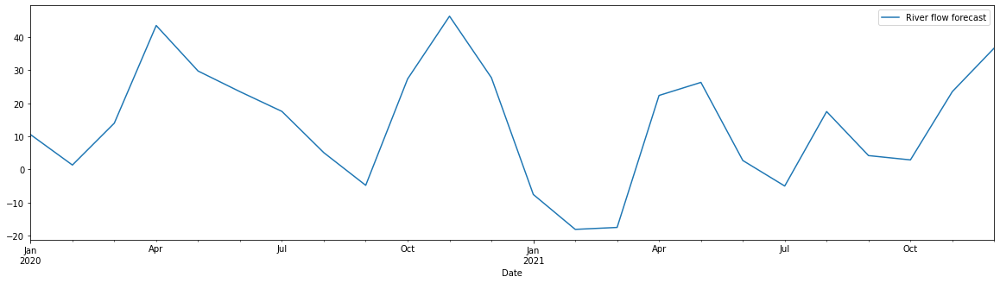


 ################ Basin 16 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


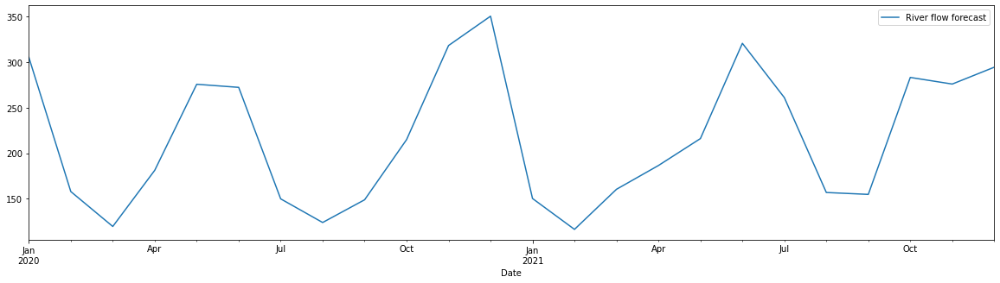


 ################ Basin 17 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


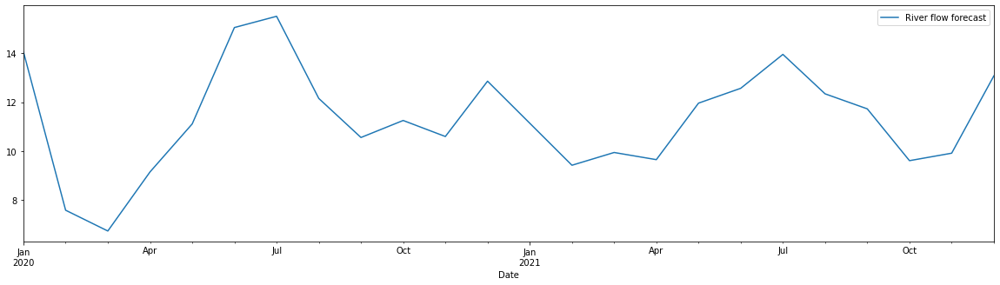


 ################ Basin 18 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


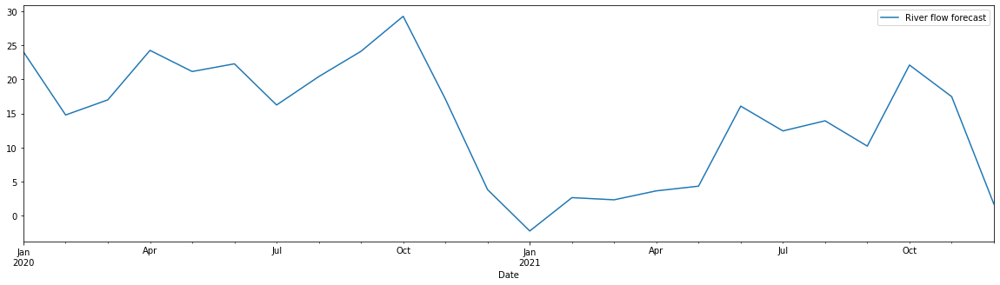


 ################ Basin 19 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


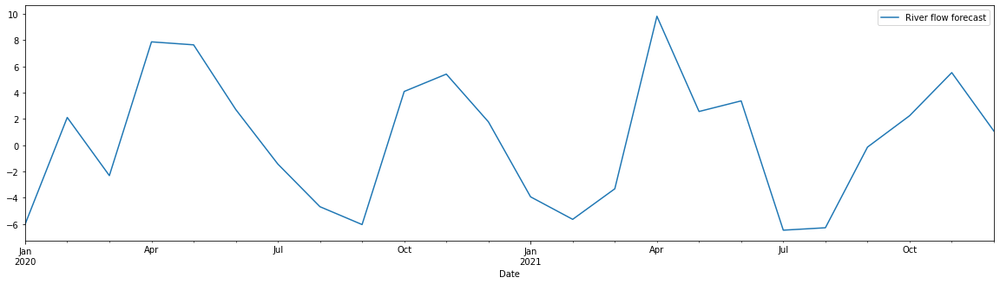


 ################ Basin 20 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


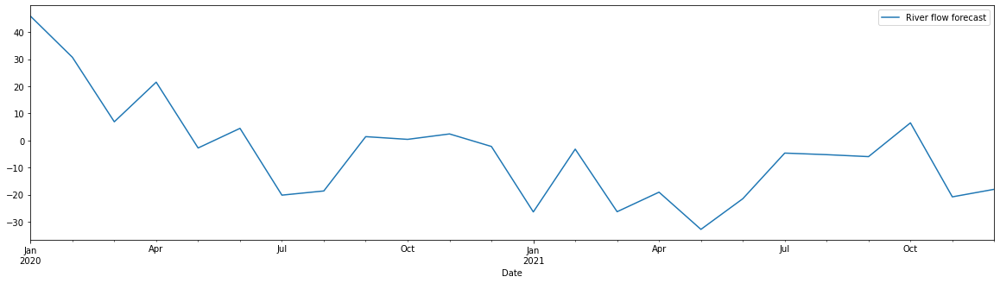


 ################ Basin 21 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


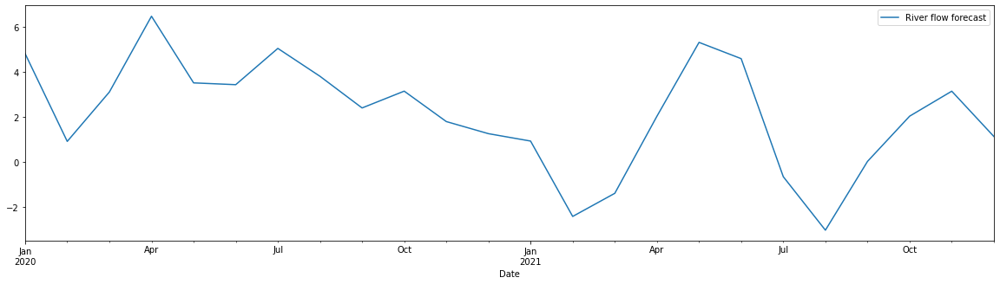


 ################ Basin 22 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


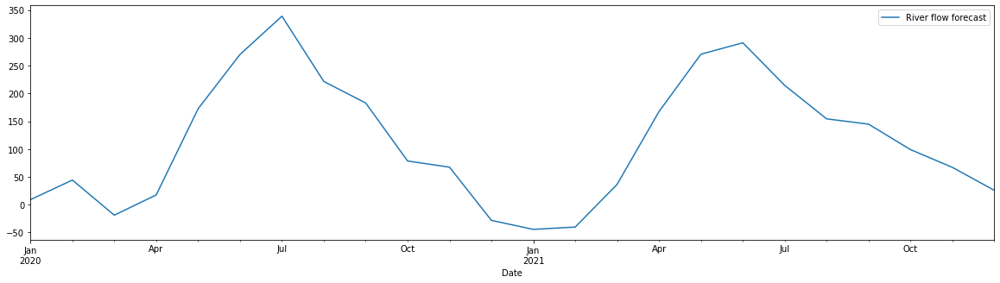


 ################ Basin 23 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


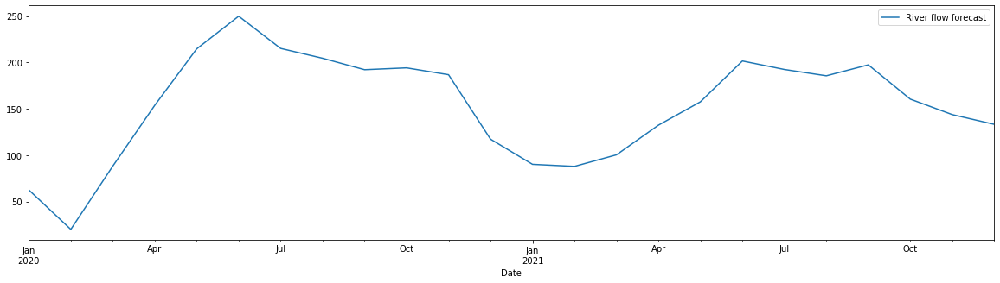


 ################ Basin 24 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


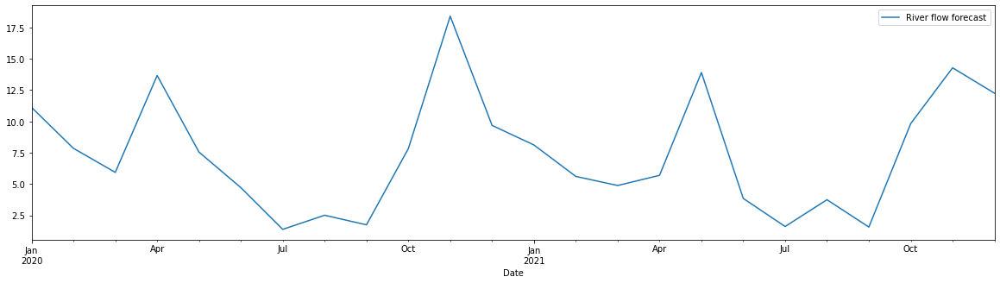


 ################ Basin 25 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


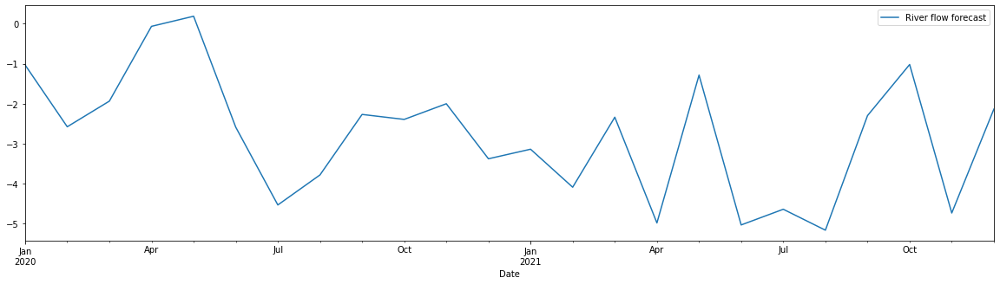


 ################ Basin 26 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


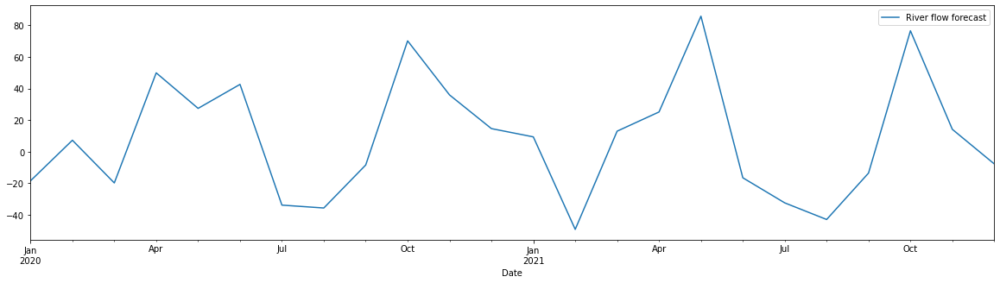


 ################ Basin 27 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


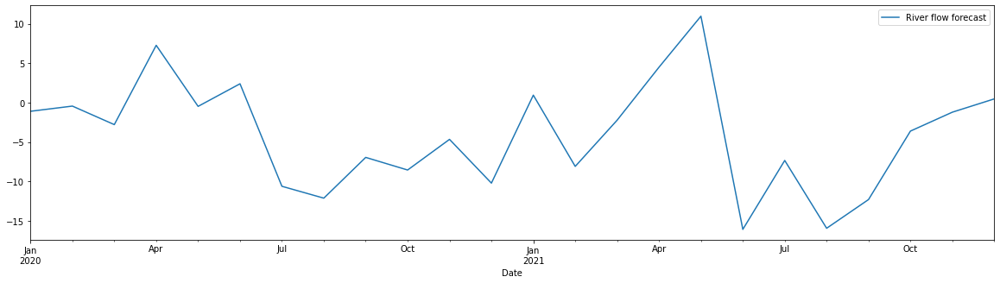


 ################ Basin 28 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


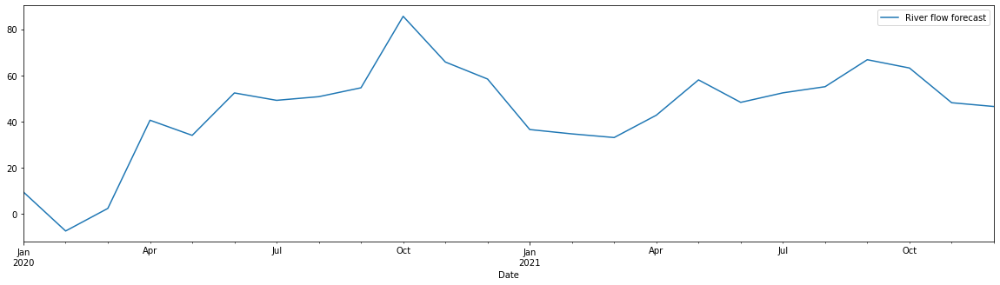


 ################ Basin 29 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


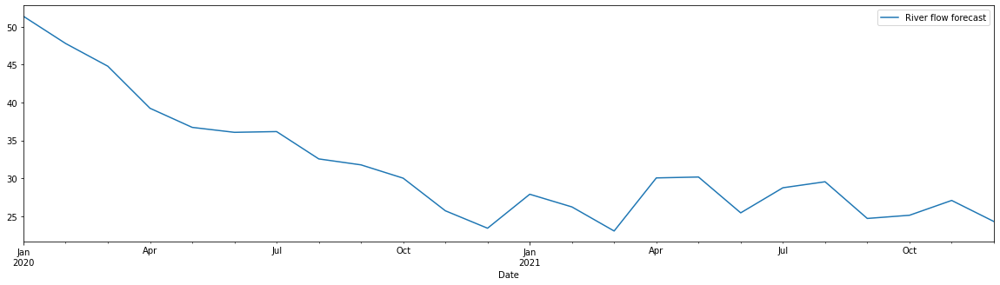


 ################ Basin 30 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


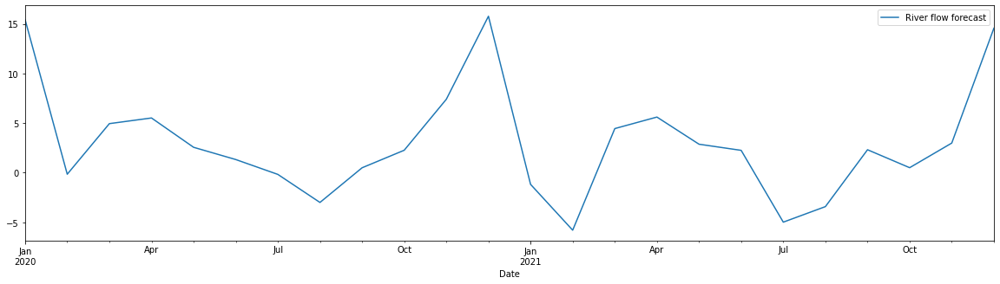


 ################ Basin 31 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


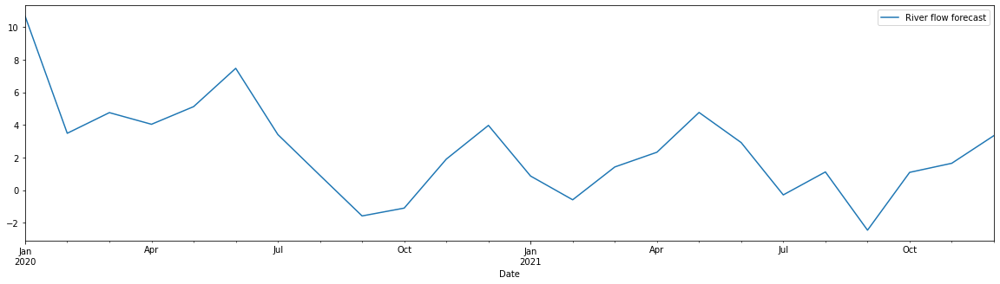


 ################ Basin 32 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


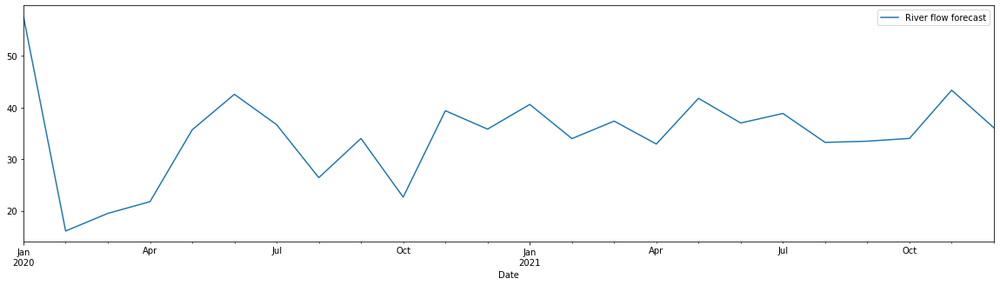


 ################ Basin 33 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


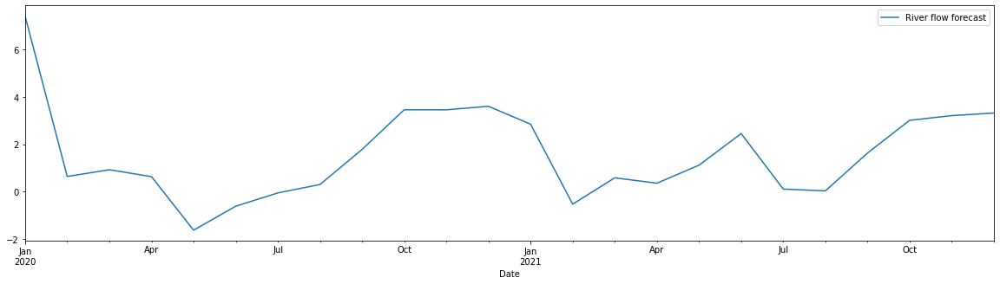


 ################ Basin 34 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


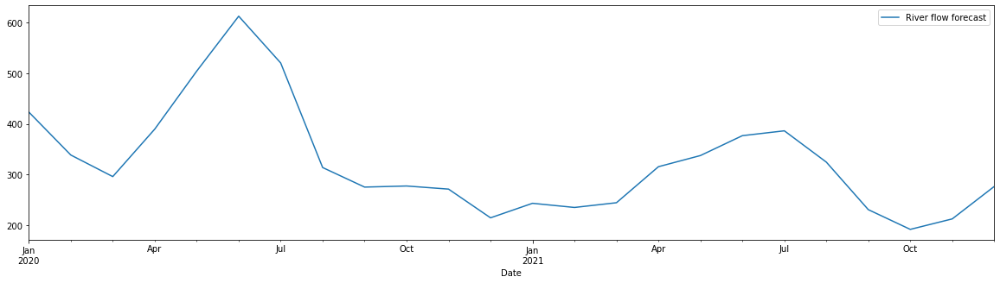


 ################ Basin 35 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


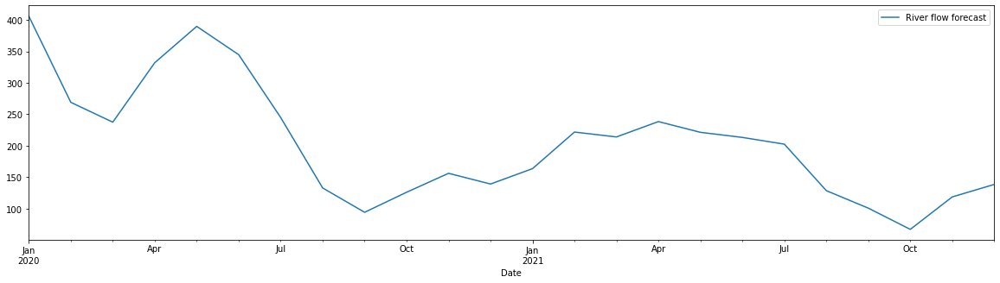


 ################ Basin 36 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


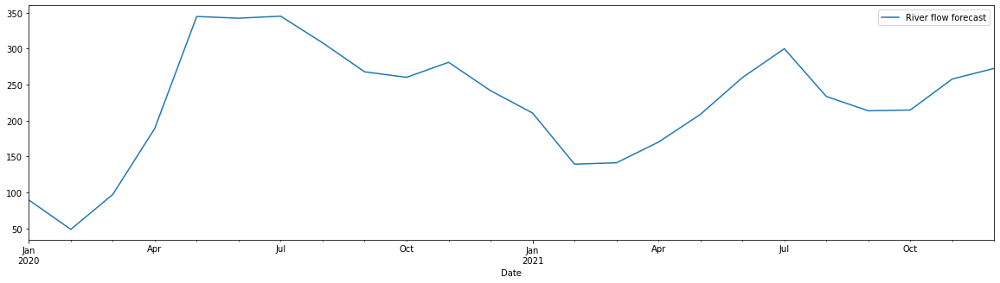


 ################ Basin 37 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


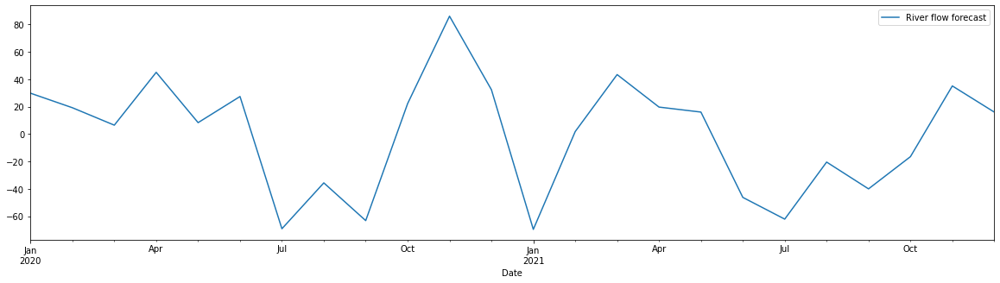


 ################ Basin 38 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


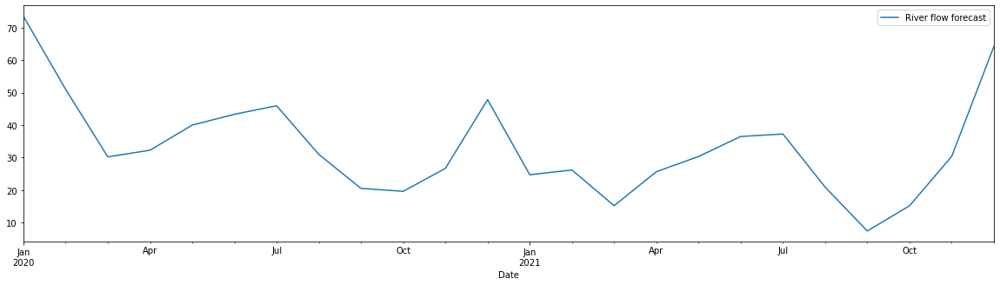


 ################ Basin 39 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


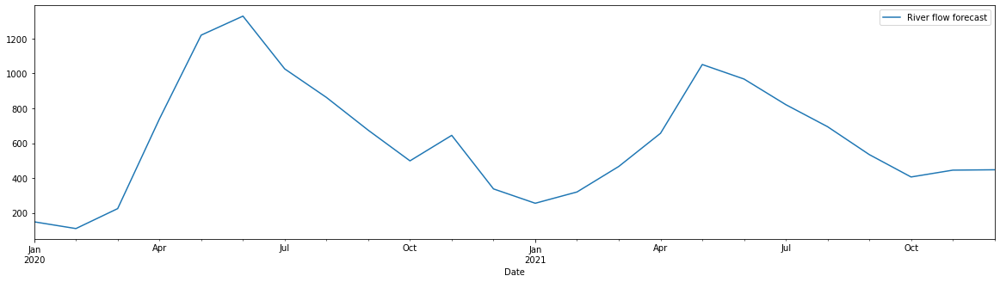


 ################ Basin 40 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


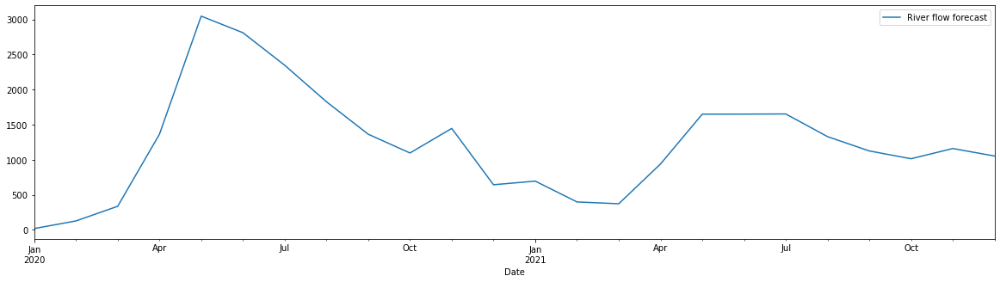


 ################ Basin 41 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


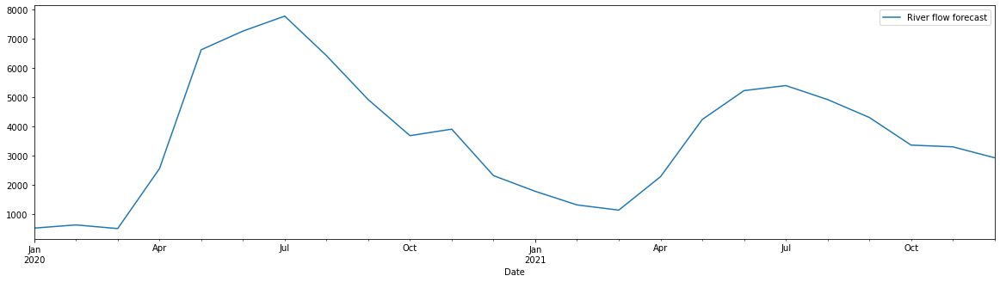


 ################ Basin 42 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


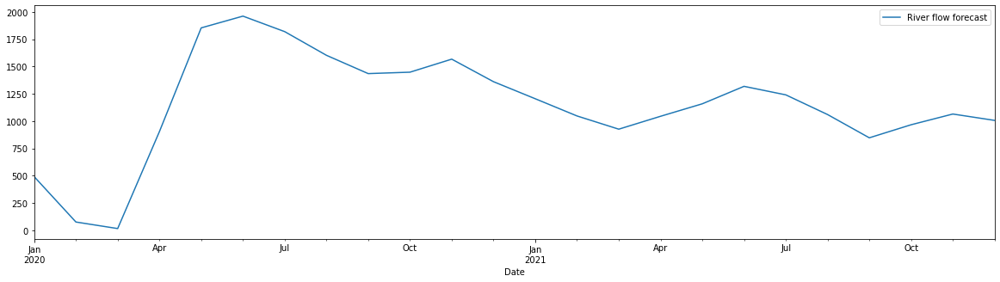


 ################ Basin 43 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


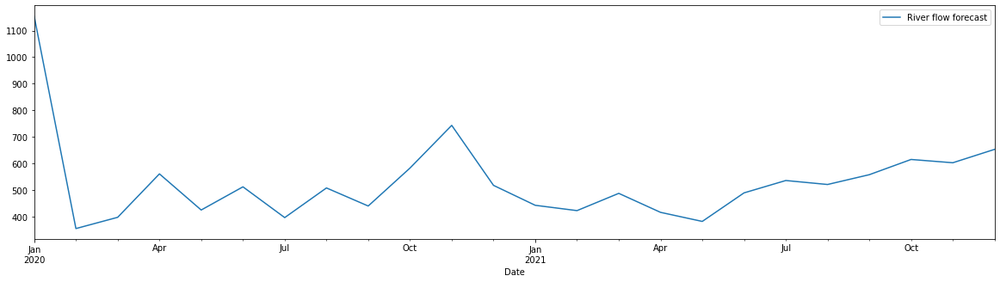


 ################ Basin 44 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


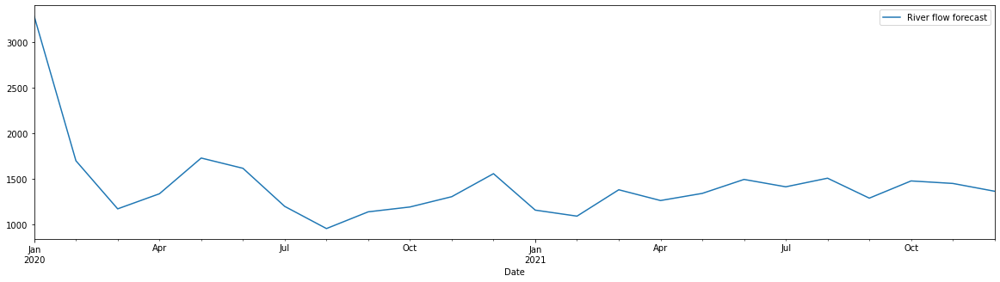


 ################ Basin 45 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


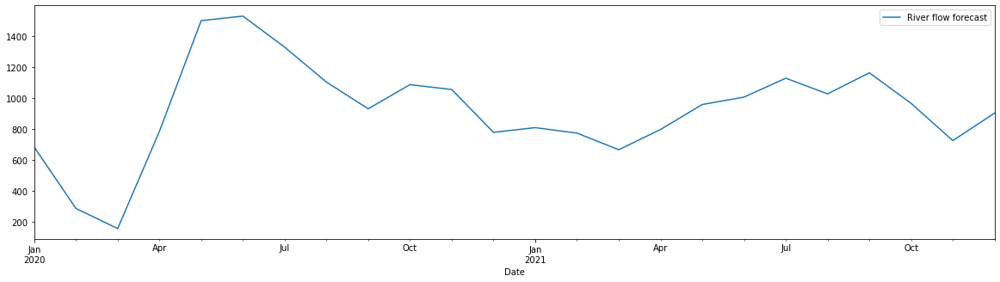


 ################ Basin 46 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


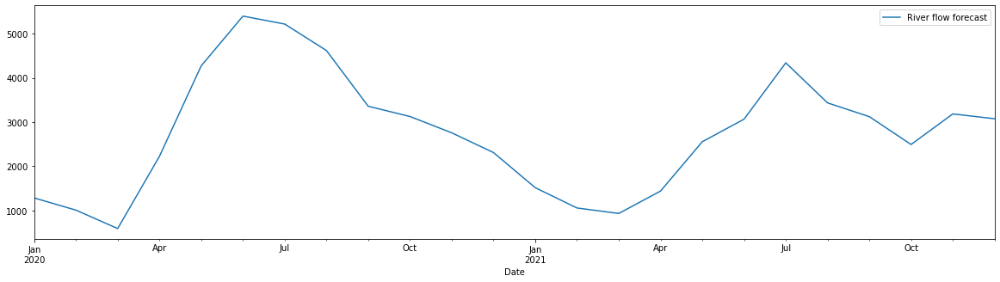


 ################ Basin 47 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


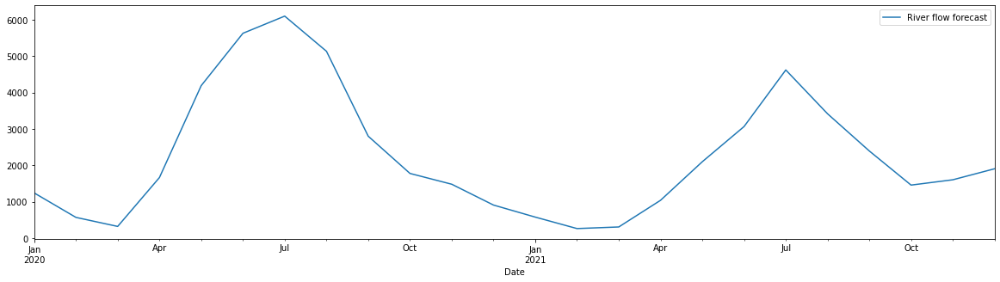


 ################ Basin 48 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


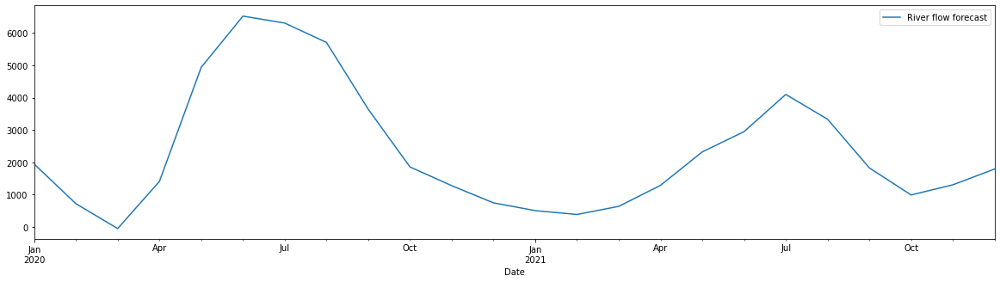

Def_25%
P_B2

 ################ Basin 1 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


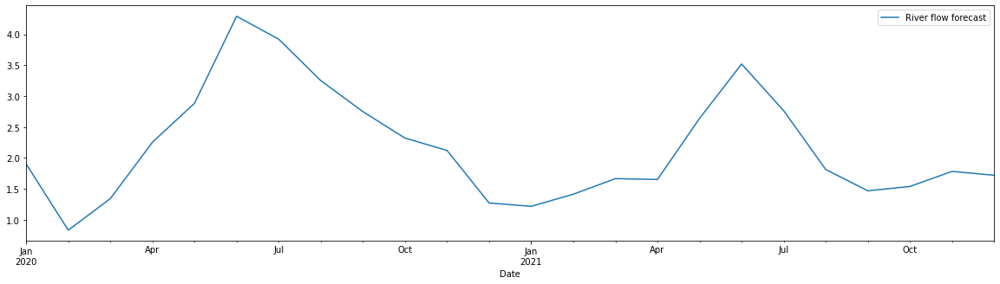


 ################ Basin 2 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


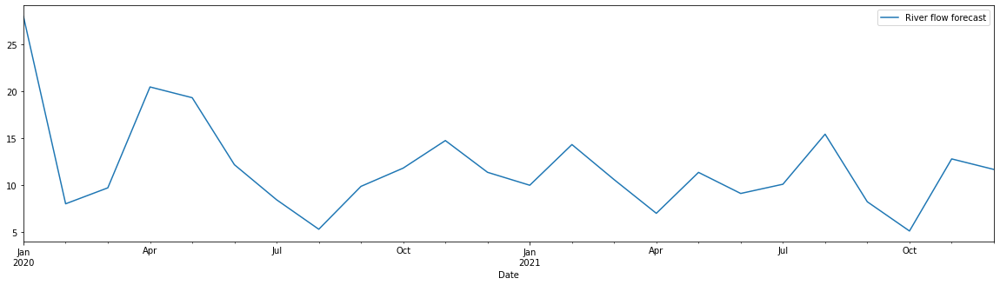


 ################ Basin 3 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


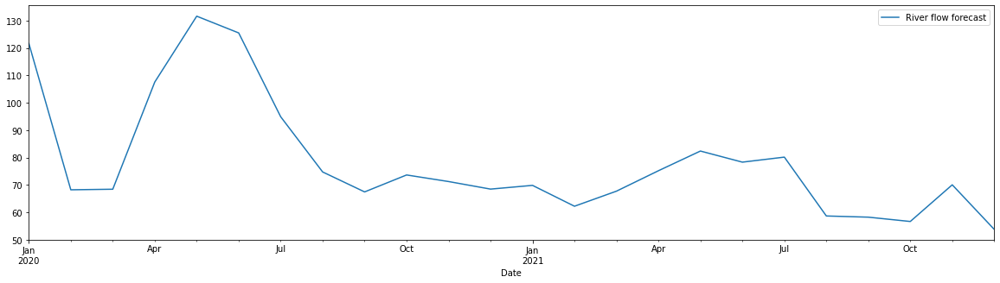


 ################ Basin 4 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


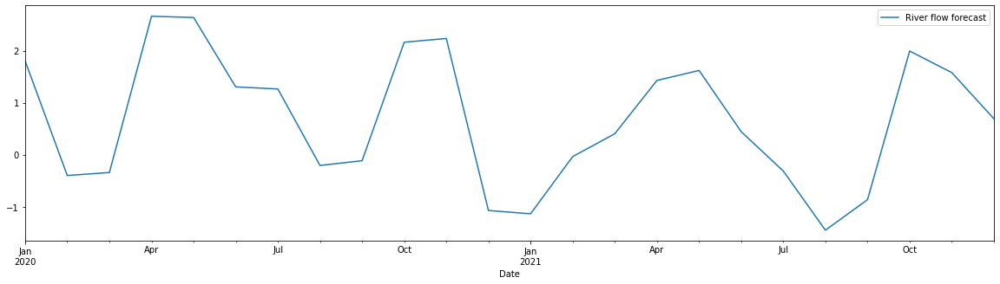


 ################ Basin 5 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


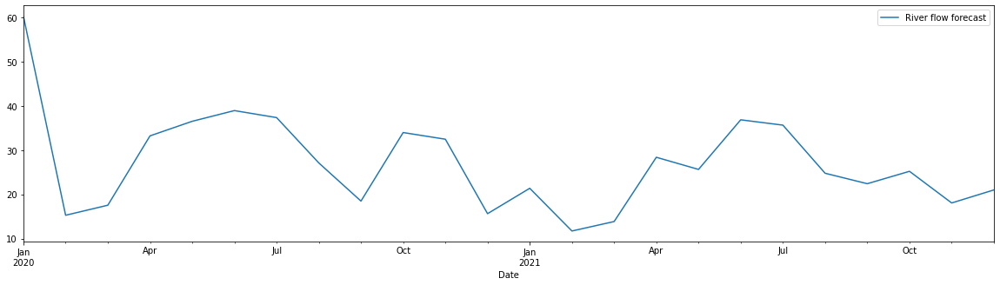


 ################ Basin 6 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


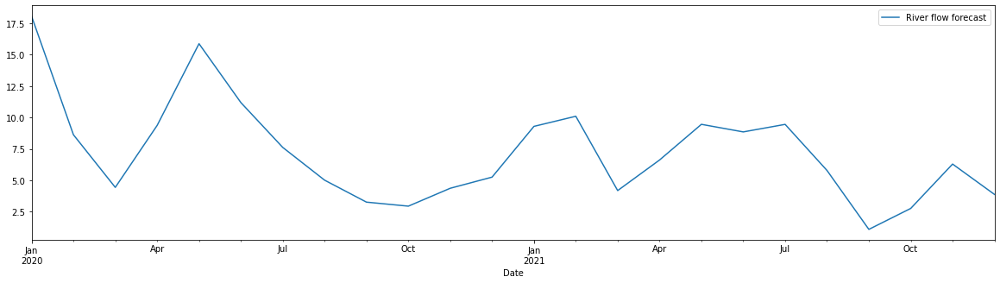


 ################ Basin 7 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


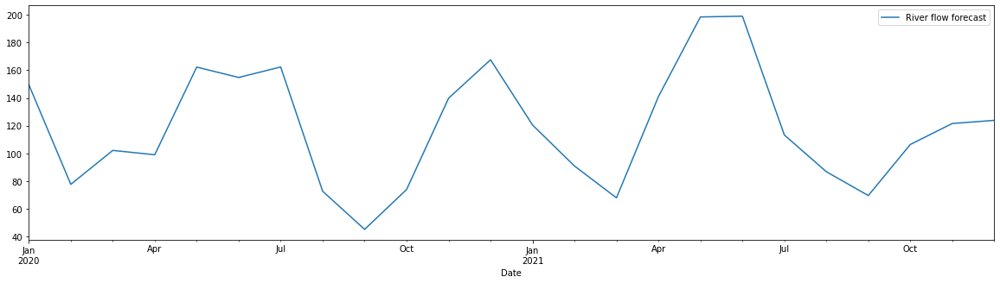


 ################ Basin 8 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


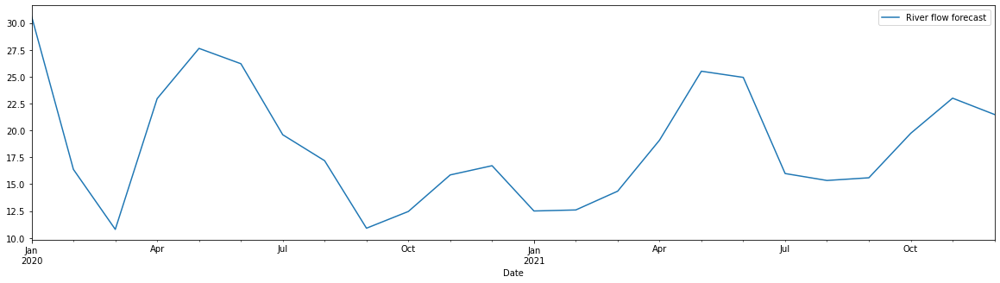


 ################ Basin 9 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


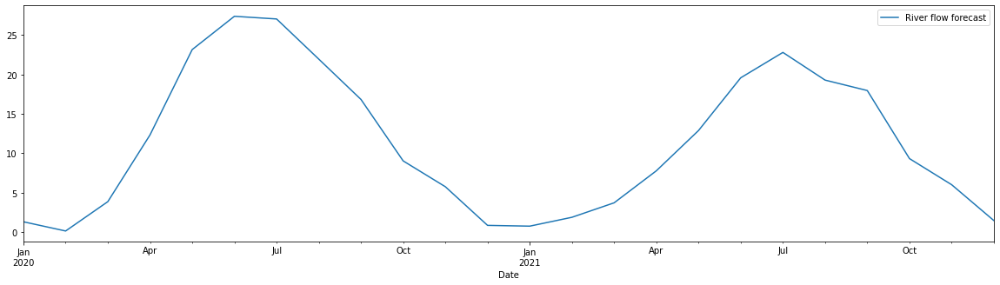


 ################ Basin 10 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


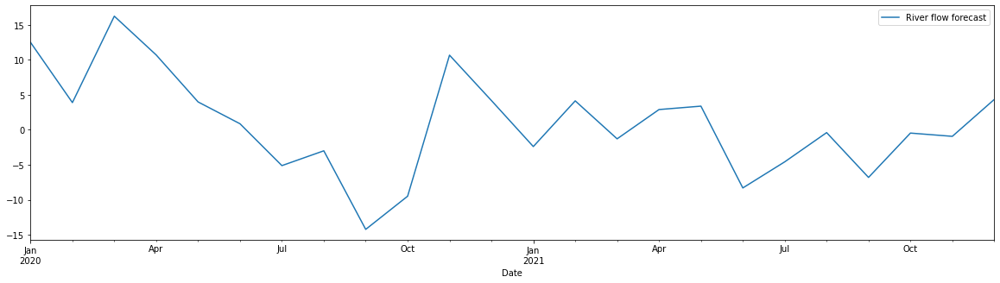


 ################ Basin 11 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


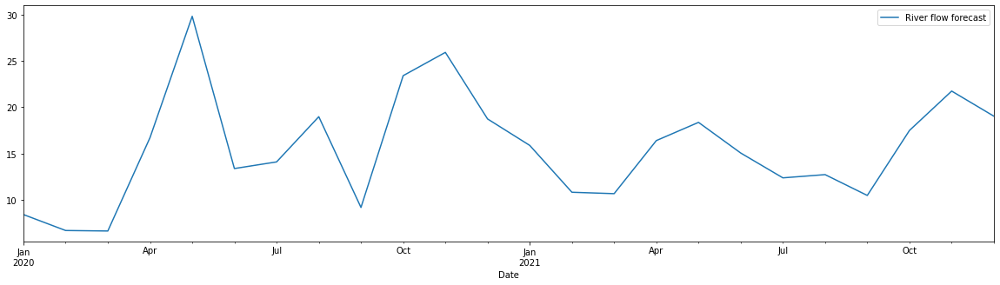


 ################ Basin 12 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


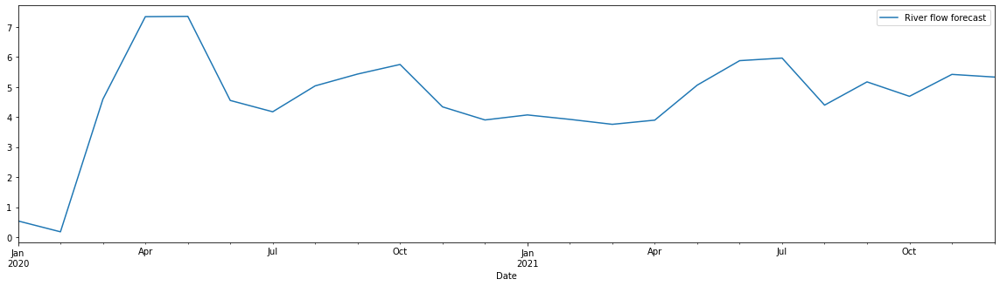


 ################ Basin 13 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


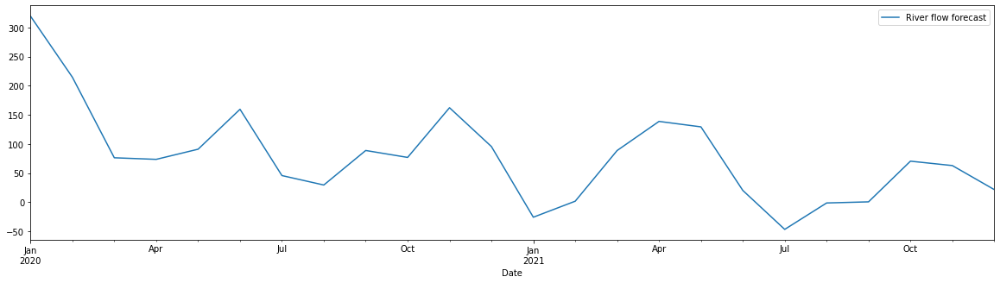


 ################ Basin 14 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


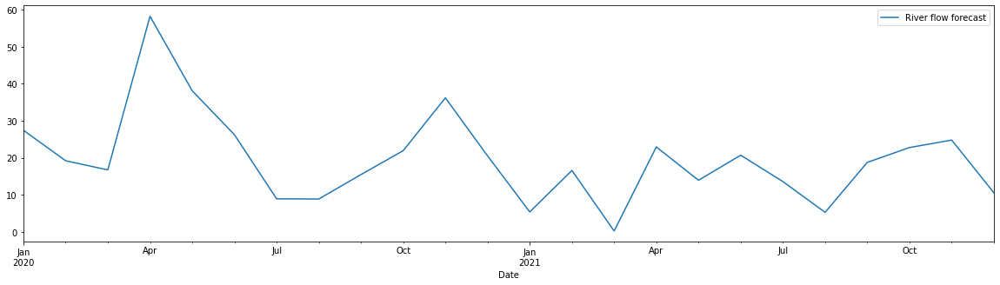


 ################ Basin 15 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


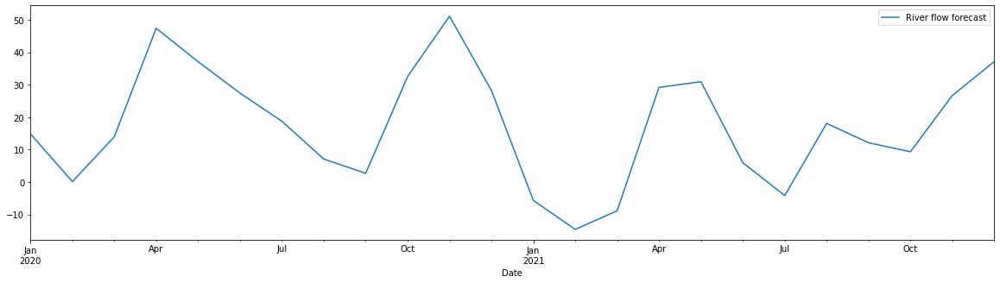


 ################ Basin 16 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


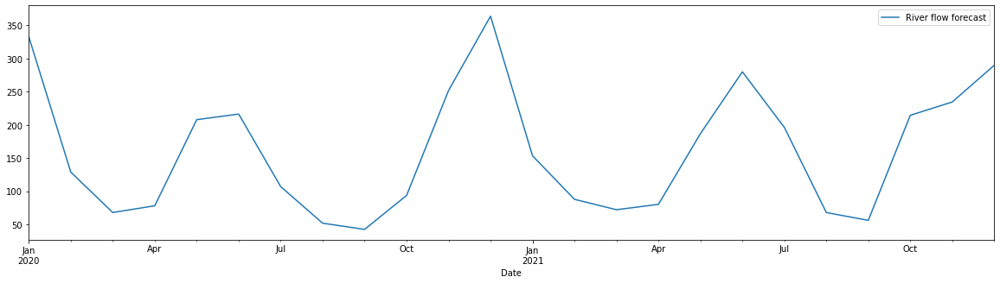


 ################ Basin 17 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


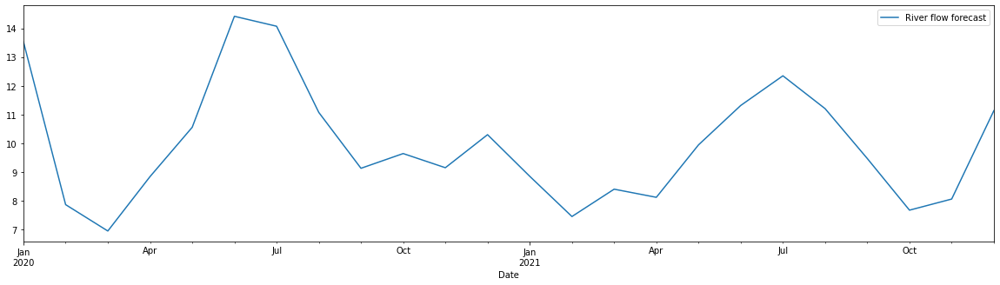


 ################ Basin 18 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


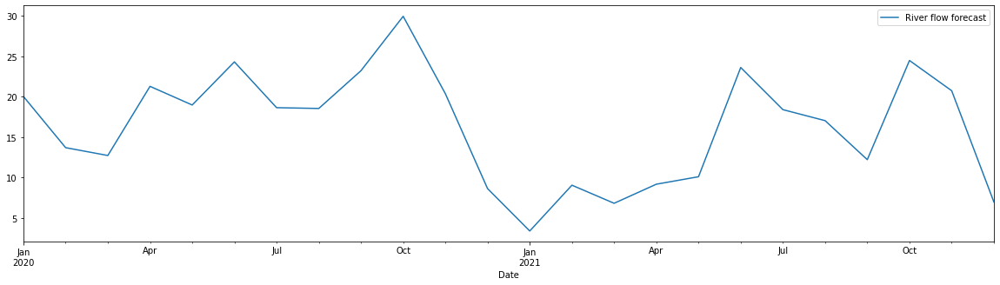


 ################ Basin 19 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


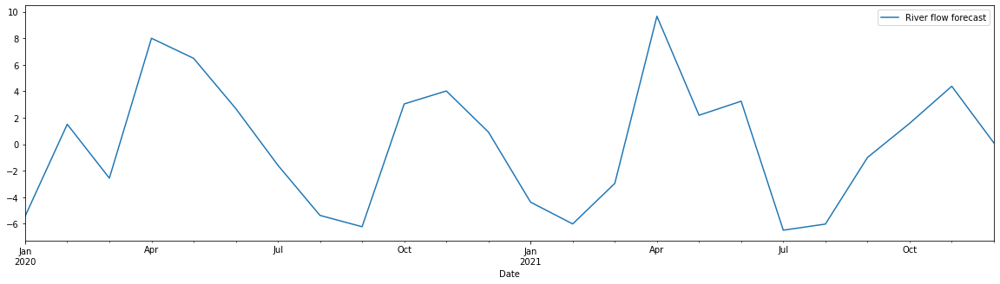


 ################ Basin 20 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


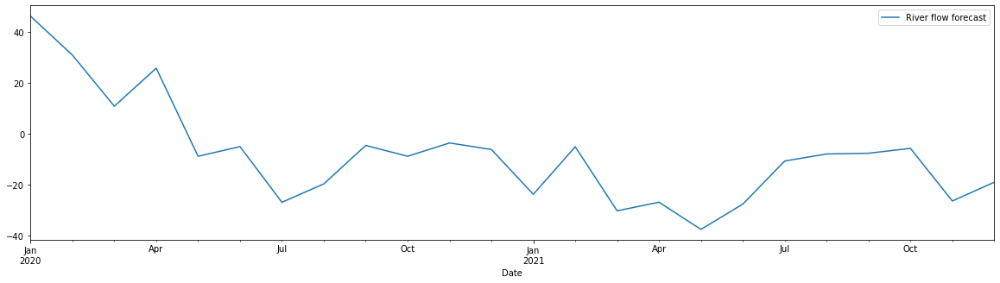


 ################ Basin 21 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


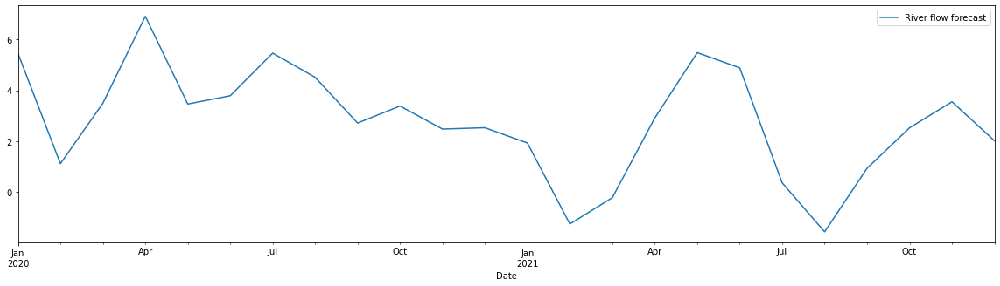


 ################ Basin 22 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


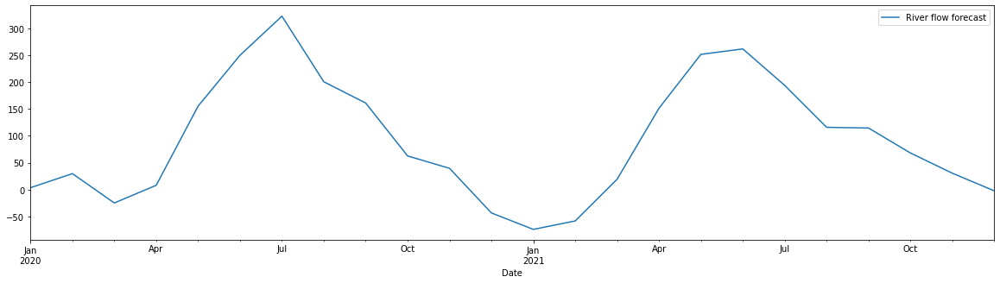


 ################ Basin 23 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


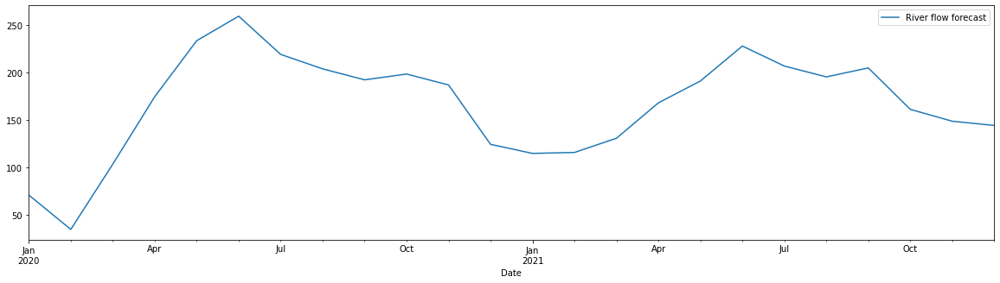


 ################ Basin 24 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


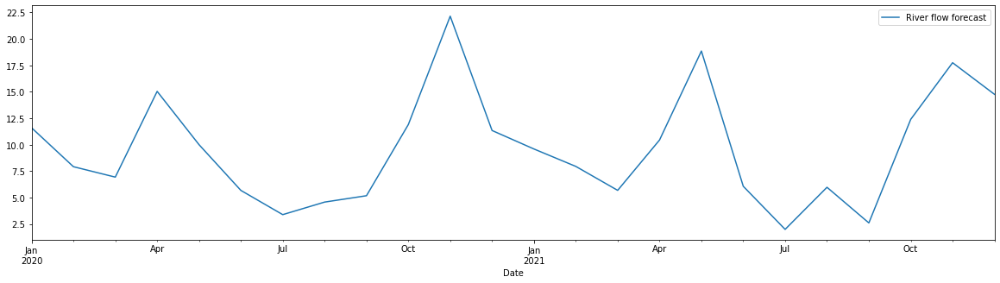


 ################ Basin 25 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


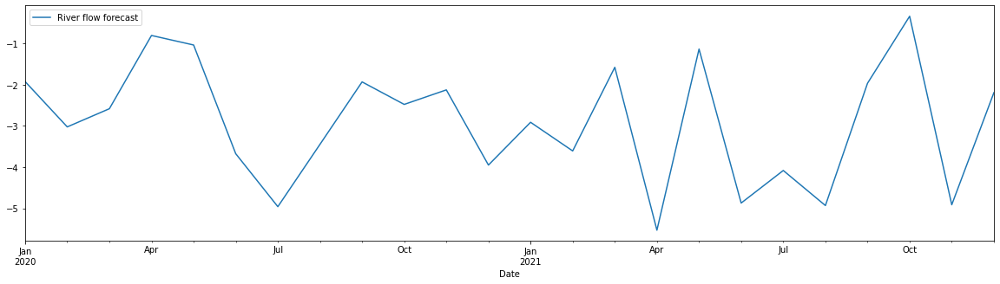


 ################ Basin 26 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


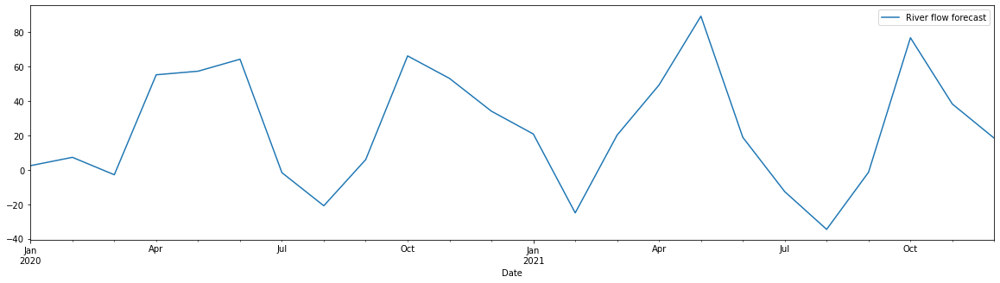


 ################ Basin 27 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


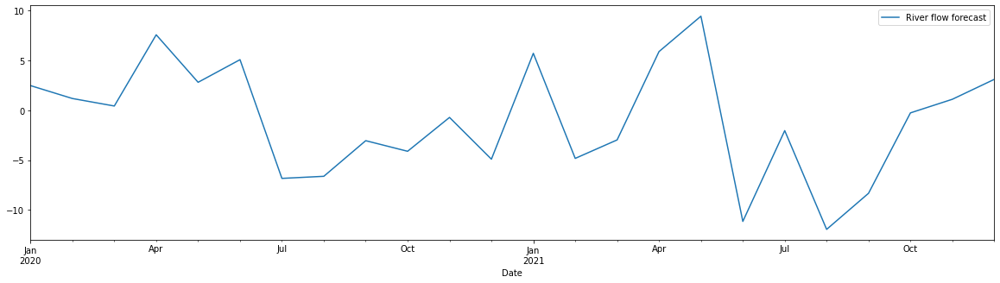


 ################ Basin 28 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


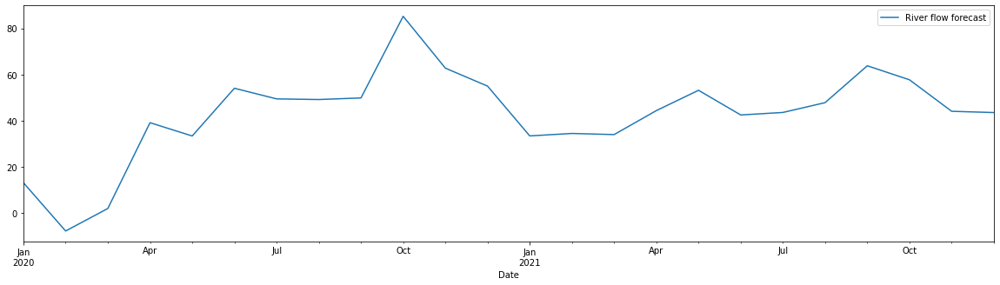


 ################ Basin 29 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


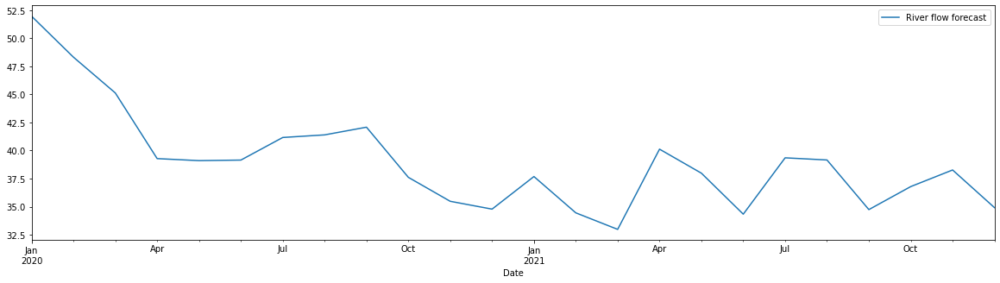


 ################ Basin 30 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


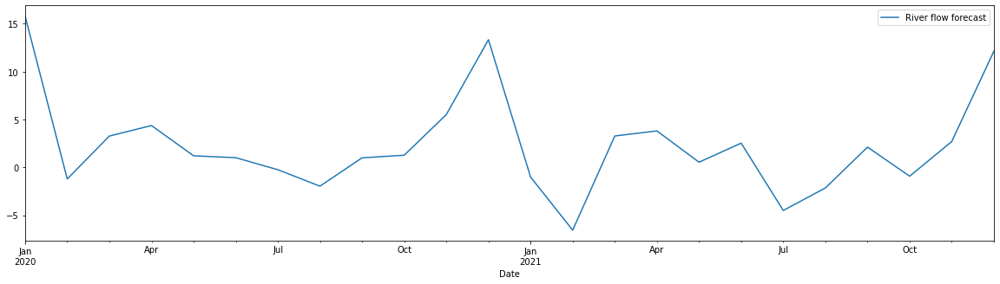


 ################ Basin 31 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


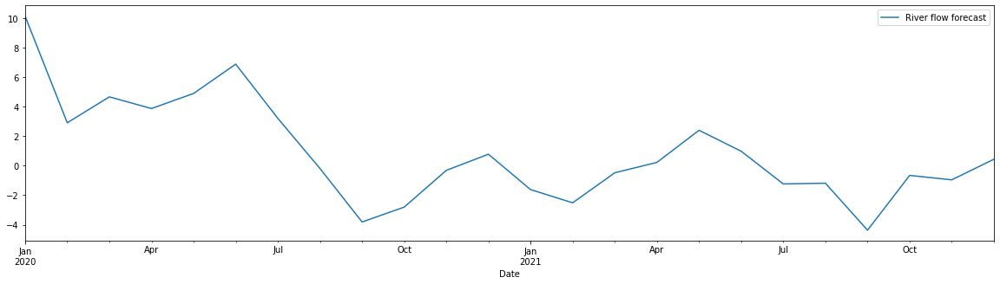


 ################ Basin 32 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


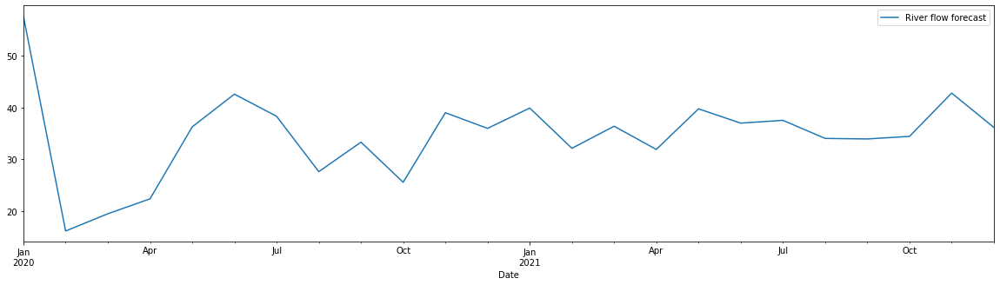


 ################ Basin 33 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


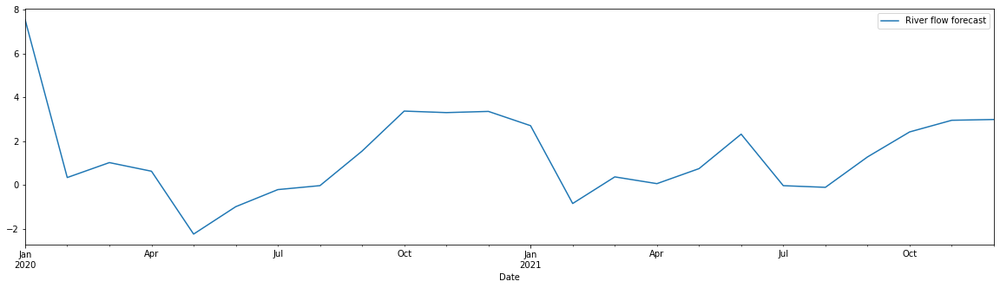


 ################ Basin 34 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


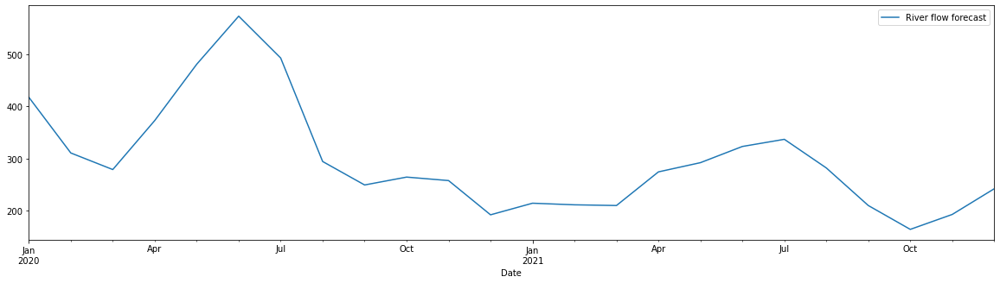


 ################ Basin 35 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


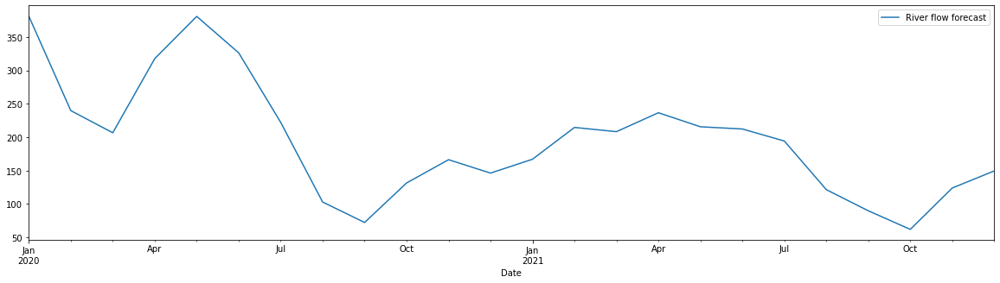


 ################ Basin 36 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


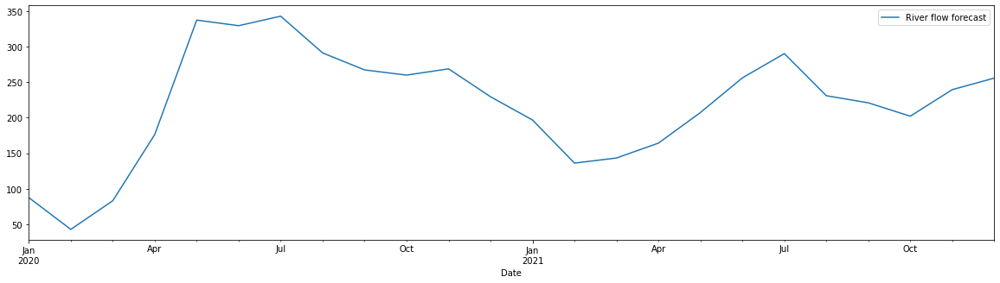


 ################ Basin 37 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


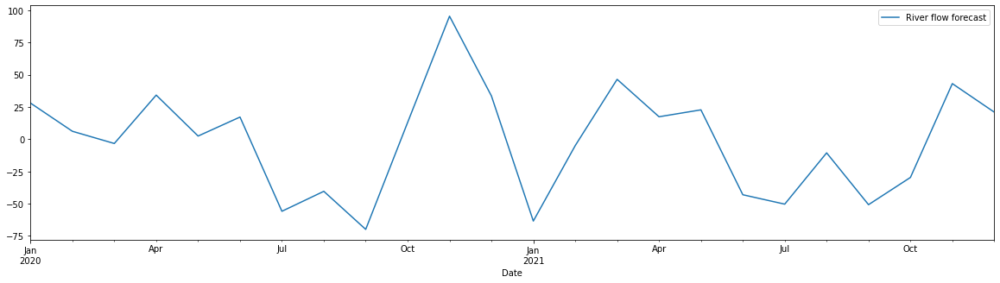


 ################ Basin 38 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


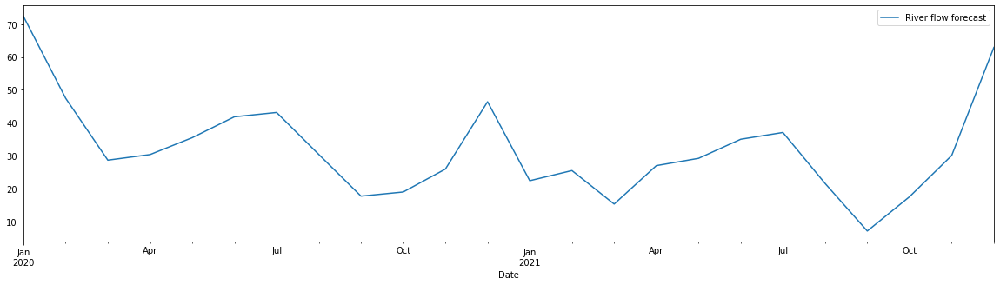


 ################ Basin 39 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


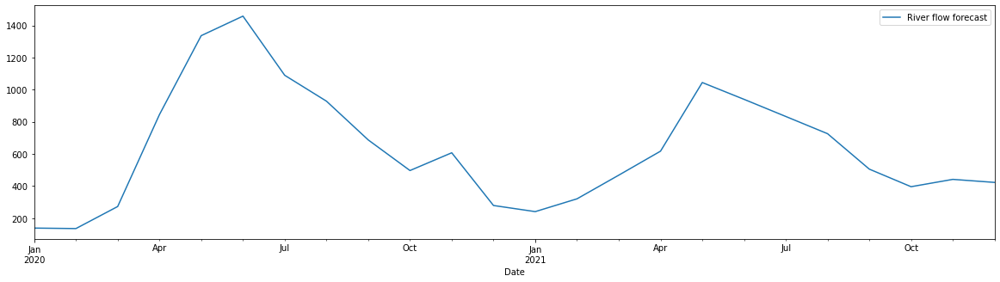


 ################ Basin 40 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


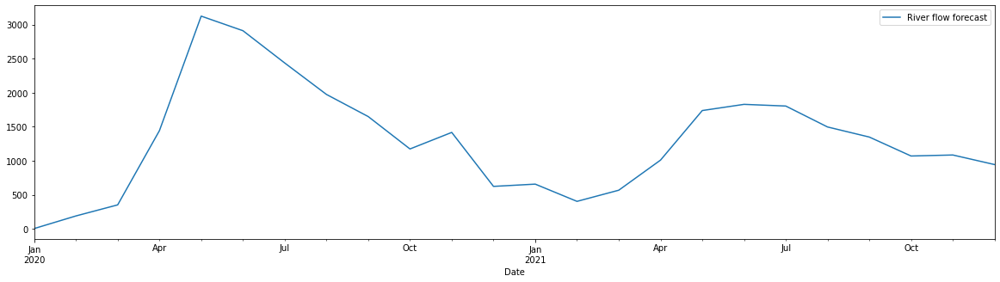


 ################ Basin 41 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


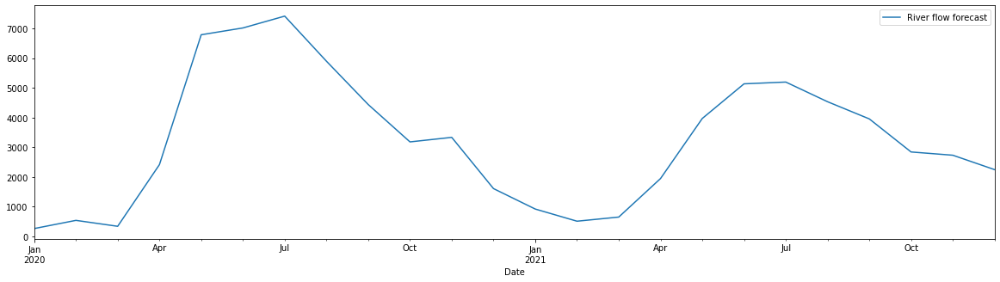


 ################ Basin 42 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


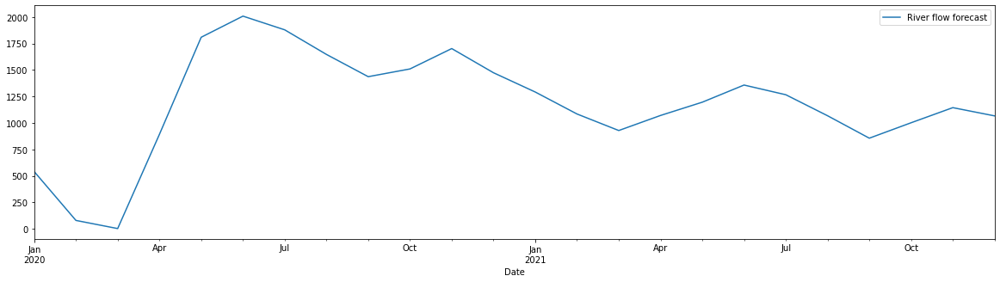


 ################ Basin 43 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


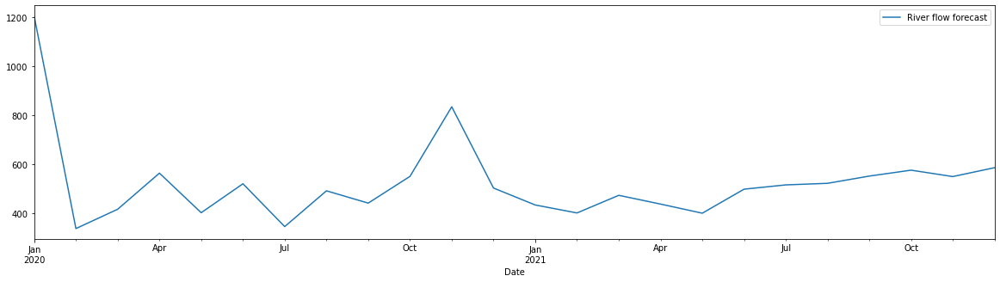


 ################ Basin 44 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


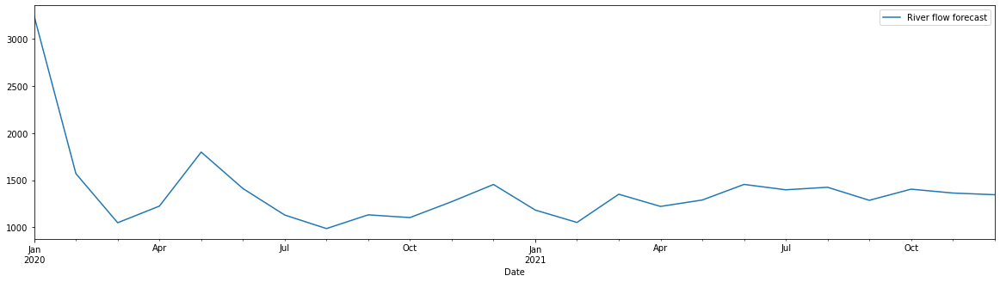


 ################ Basin 45 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


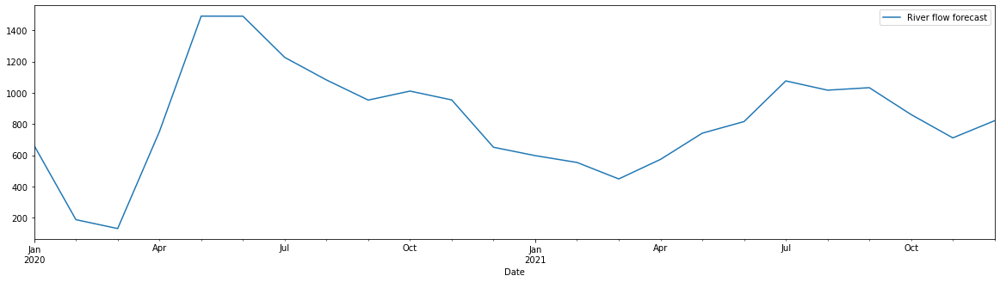


 ################ Basin 46 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


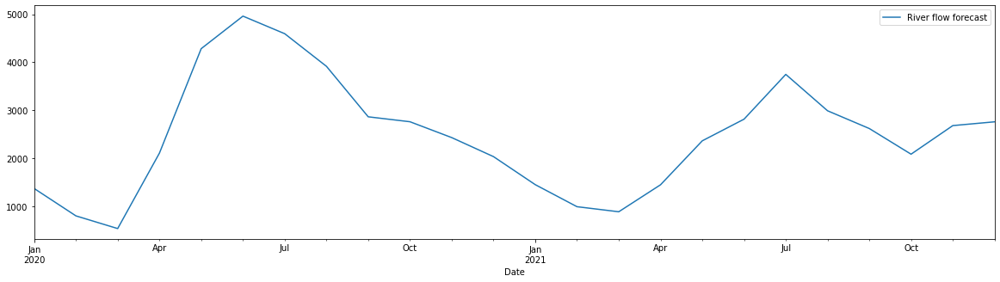


 ################ Basin 47 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


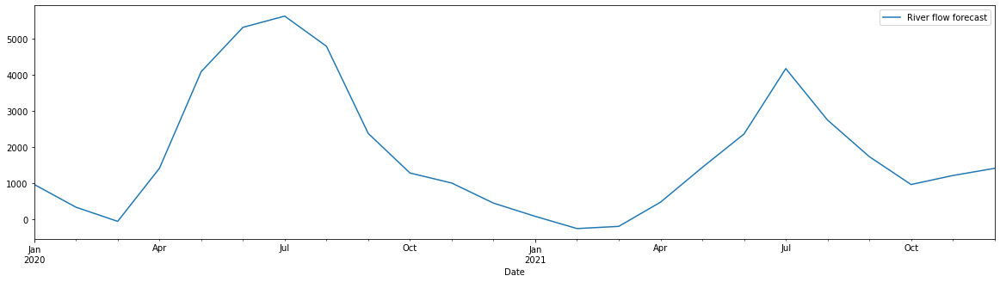


 ################ Basin 48 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


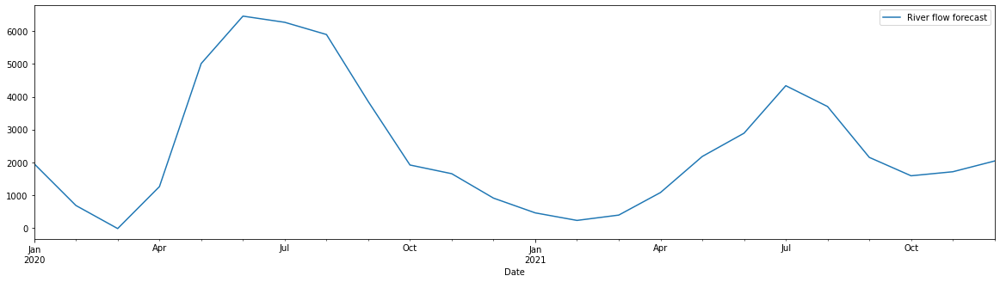

Def_50%
P_A1

 ################ Basin 1 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


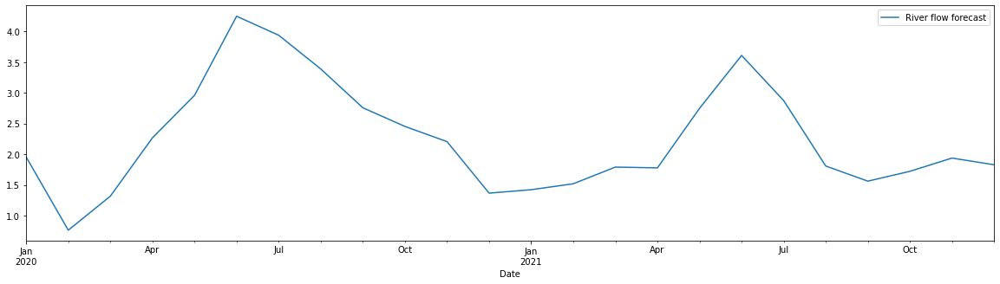


 ################ Basin 2 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


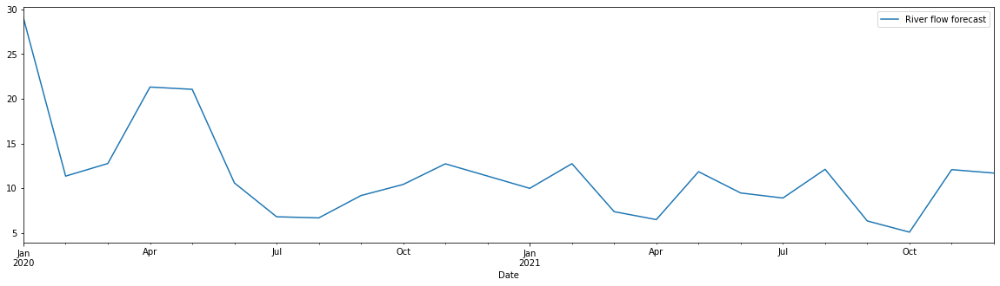


 ################ Basin 3 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


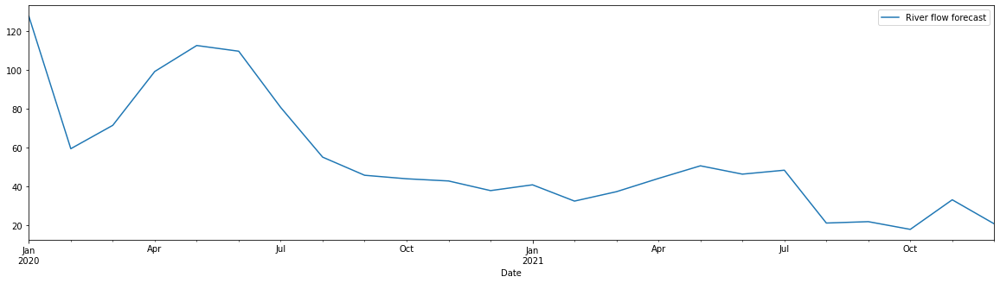


 ################ Basin 4 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


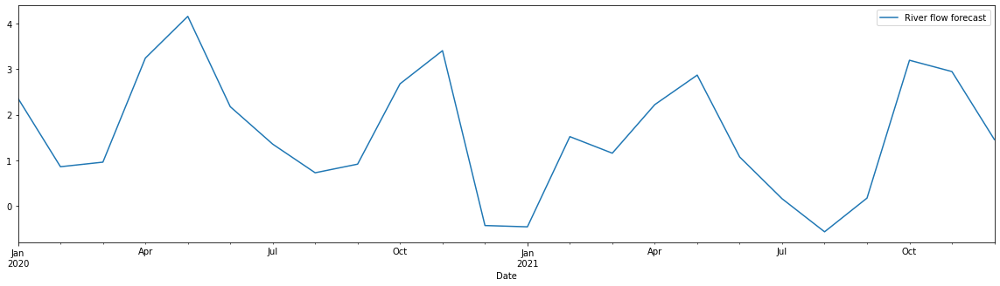


 ################ Basin 5 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


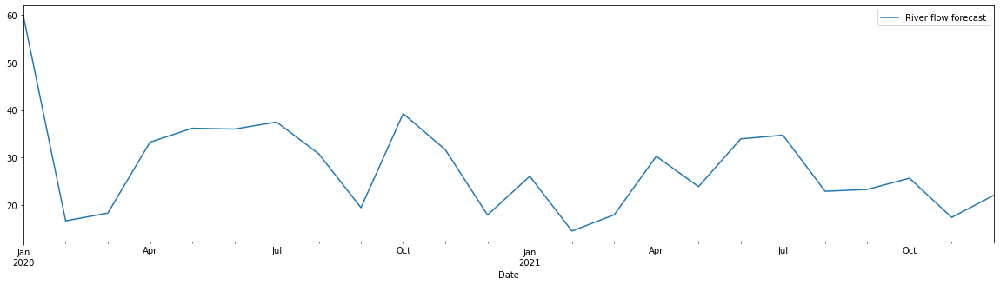


 ################ Basin 6 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


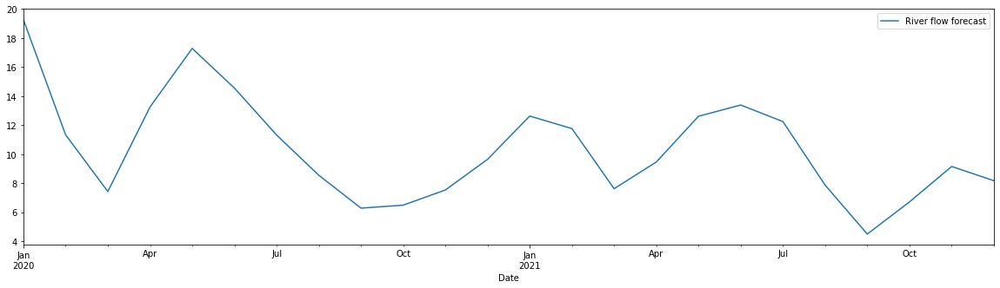


 ################ Basin 7 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


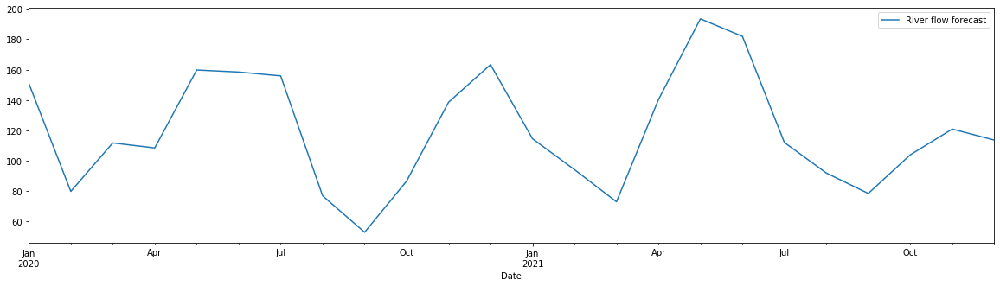


 ################ Basin 8 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


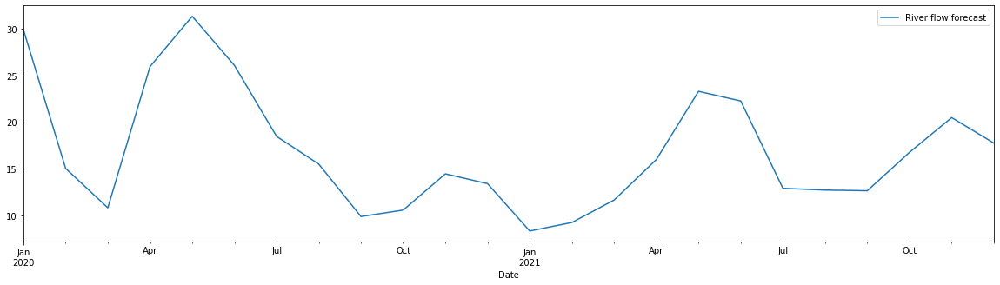


 ################ Basin 9 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


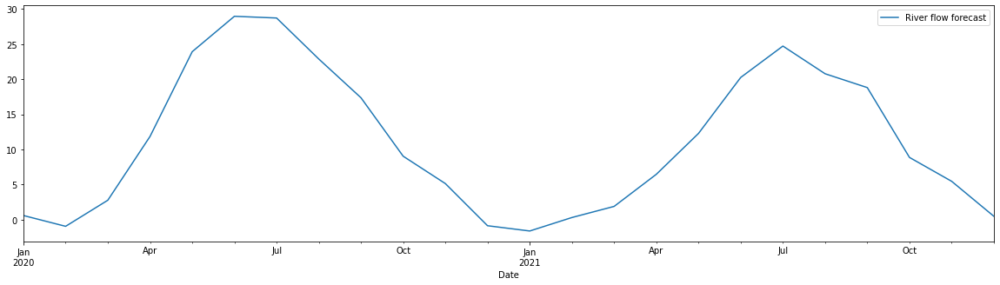


 ################ Basin 10 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


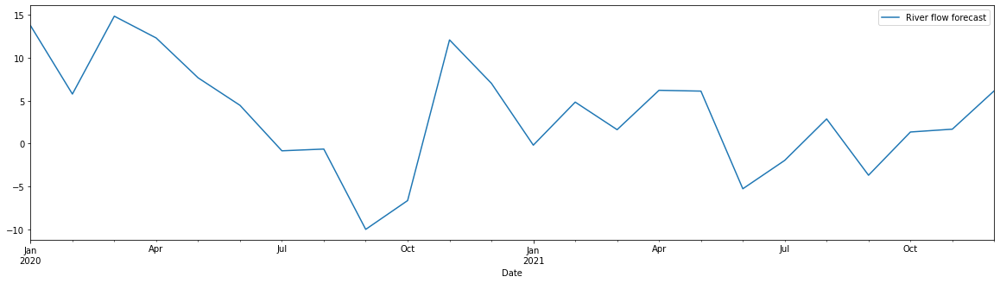


 ################ Basin 11 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


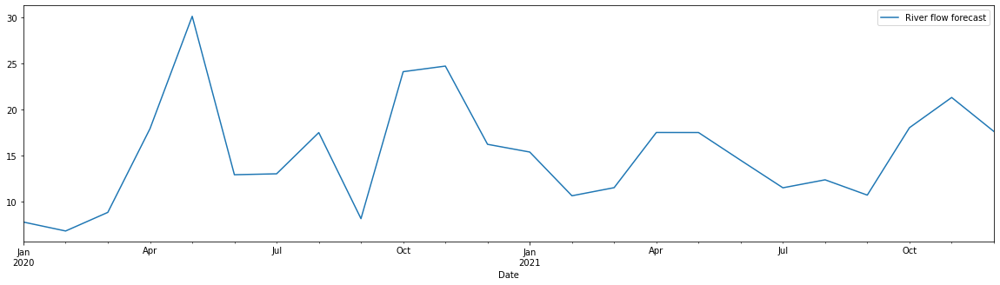


 ################ Basin 12 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


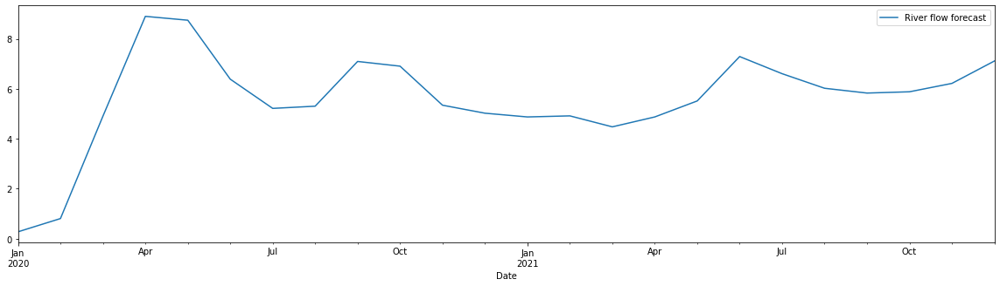


 ################ Basin 13 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


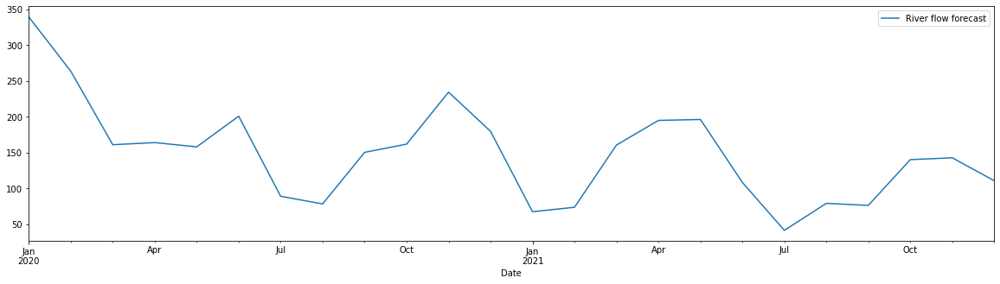


 ################ Basin 14 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


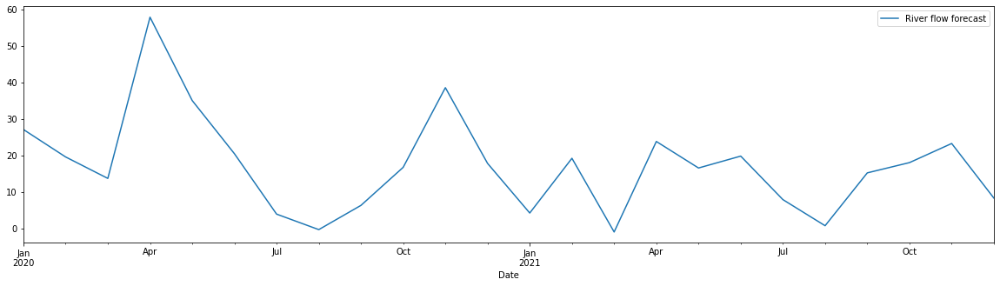


 ################ Basin 15 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


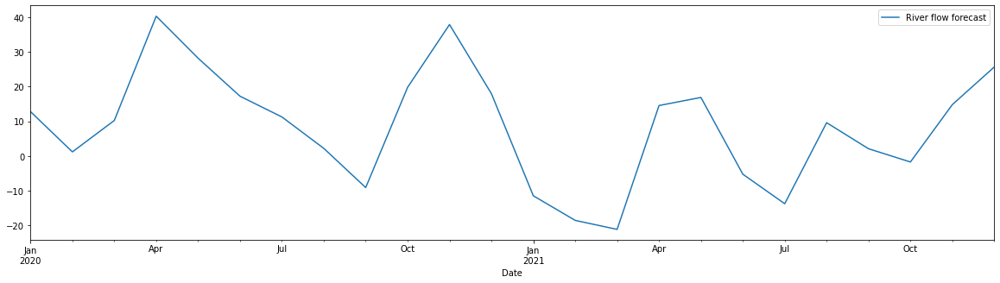


 ################ Basin 16 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


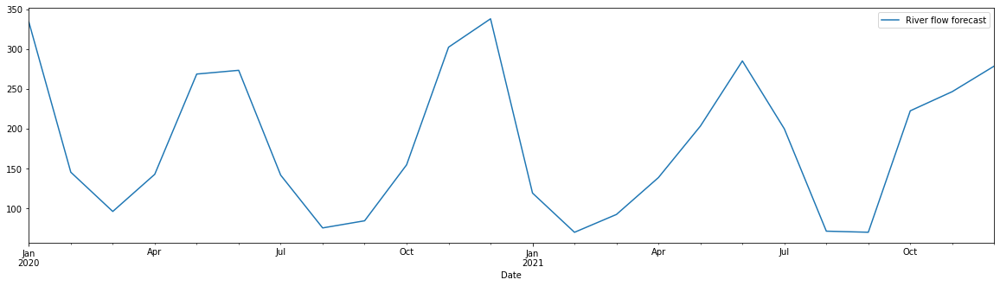


 ################ Basin 17 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


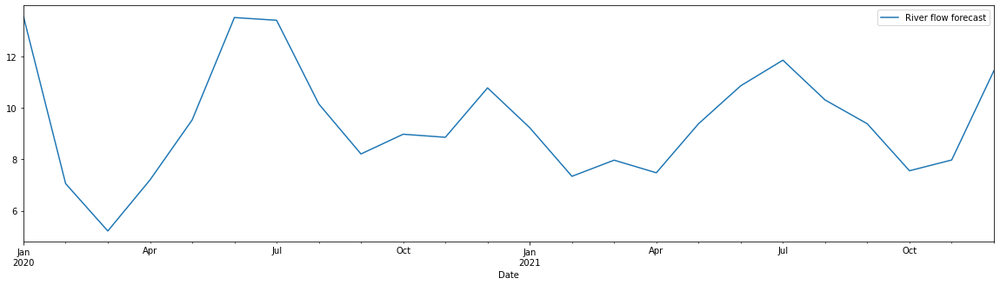


 ################ Basin 18 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


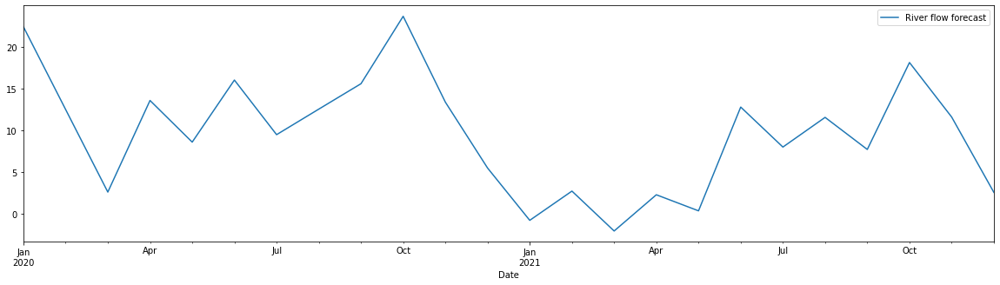


 ################ Basin 19 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


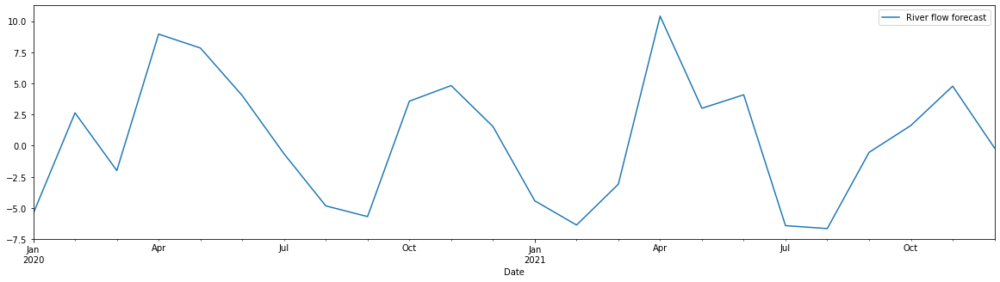


 ################ Basin 20 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


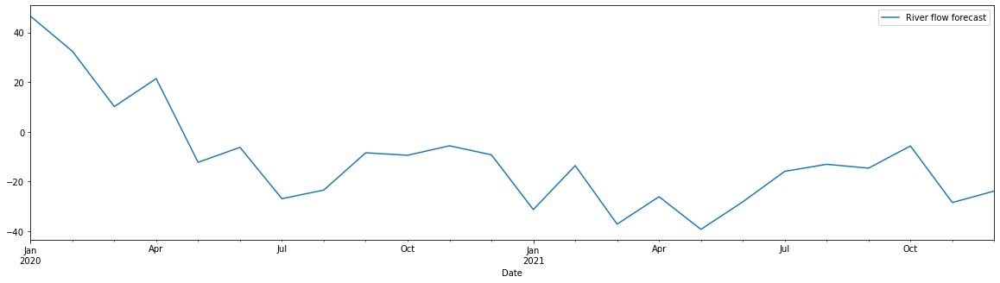


 ################ Basin 21 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


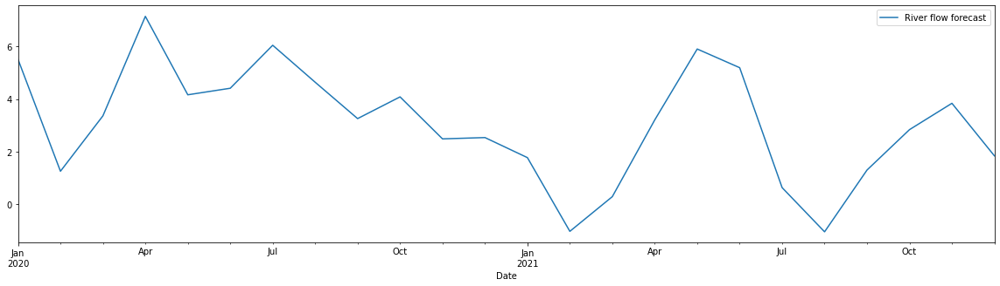


 ################ Basin 22 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


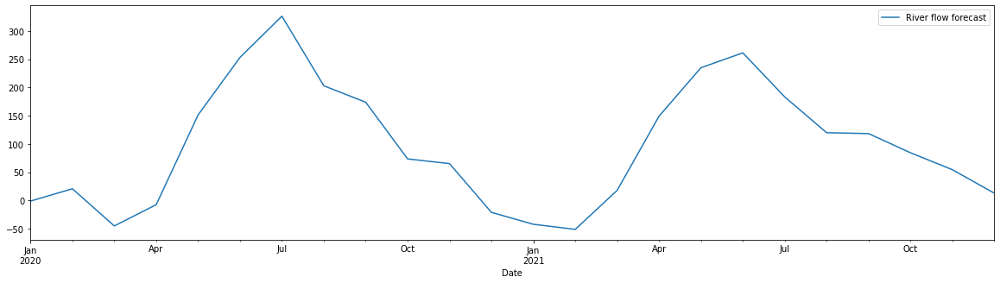


 ################ Basin 23 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


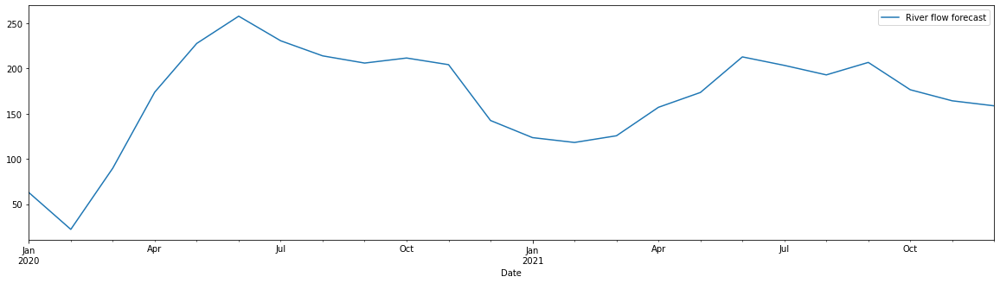


 ################ Basin 24 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


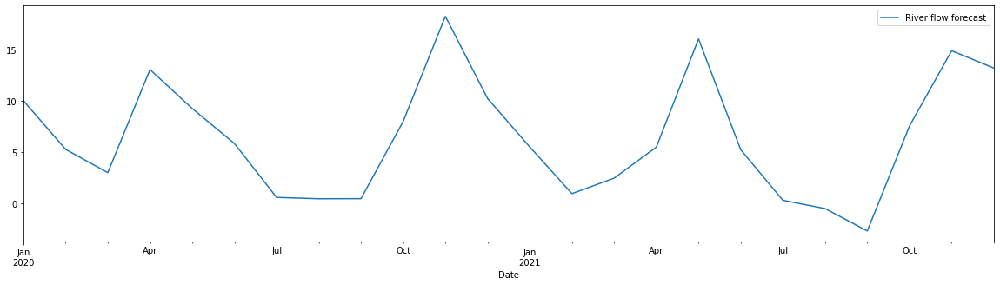


 ################ Basin 25 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


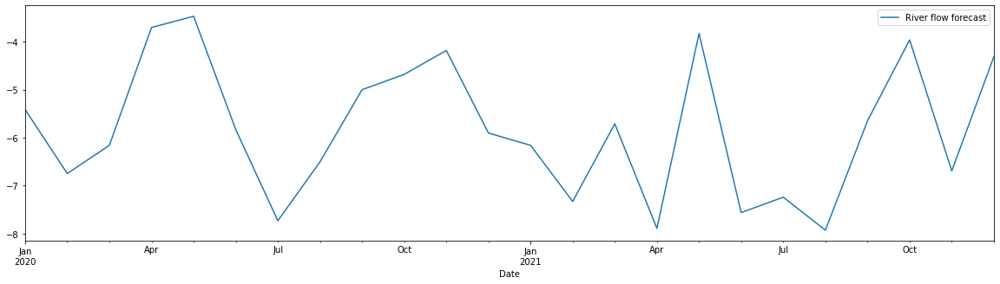


 ################ Basin 26 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


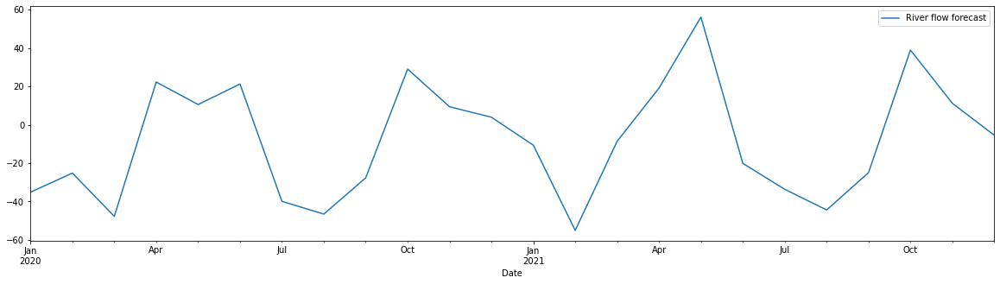


 ################ Basin 27 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


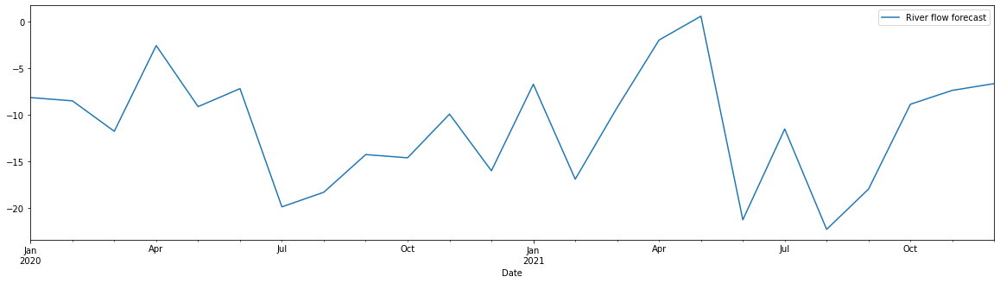


 ################ Basin 28 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


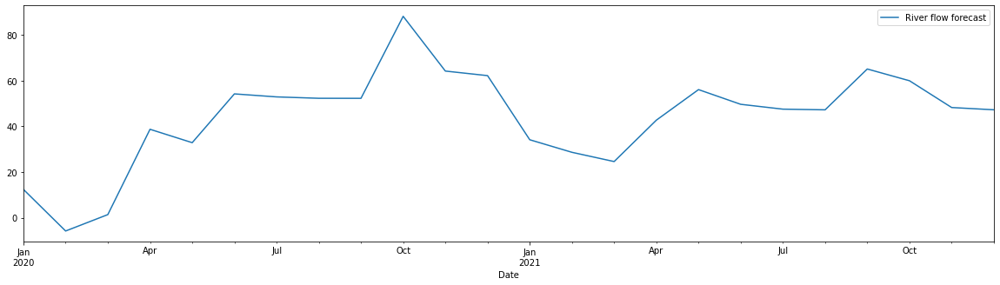


 ################ Basin 29 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


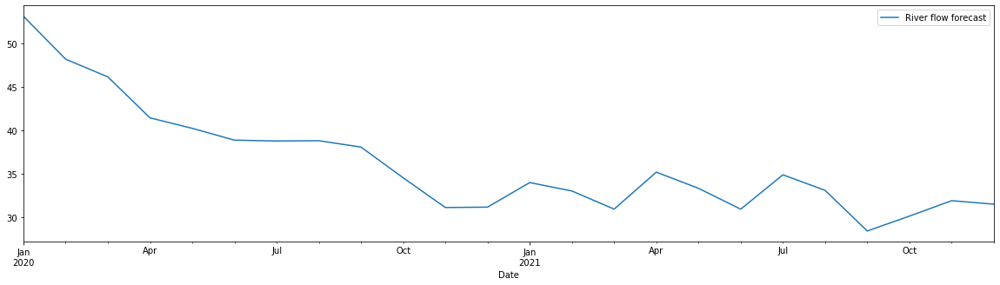


 ################ Basin 30 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


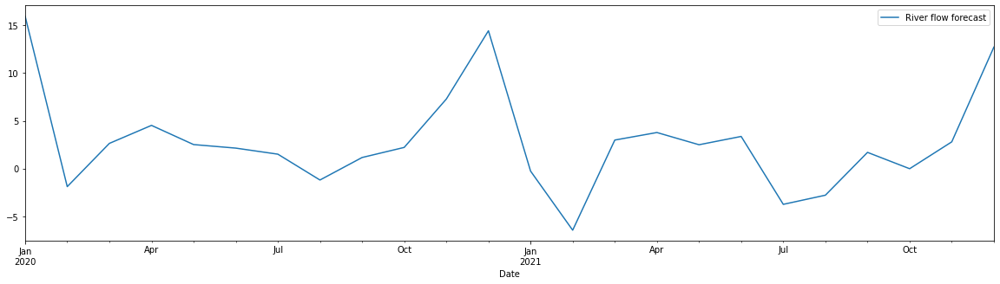


 ################ Basin 31 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


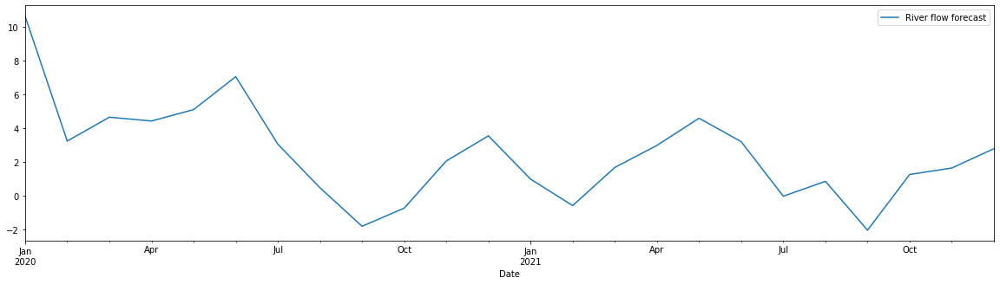


 ################ Basin 32 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


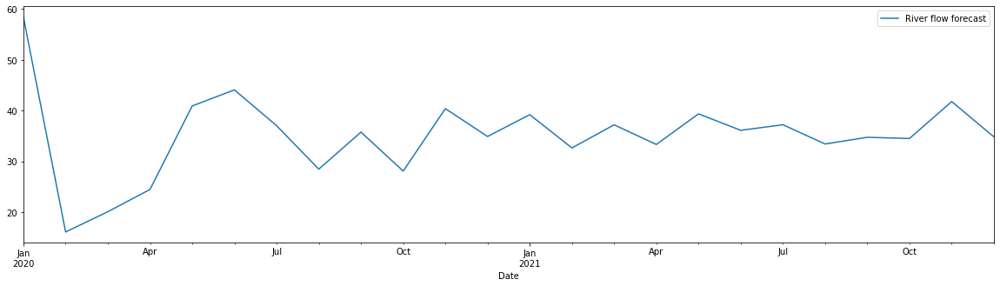


 ################ Basin 33 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


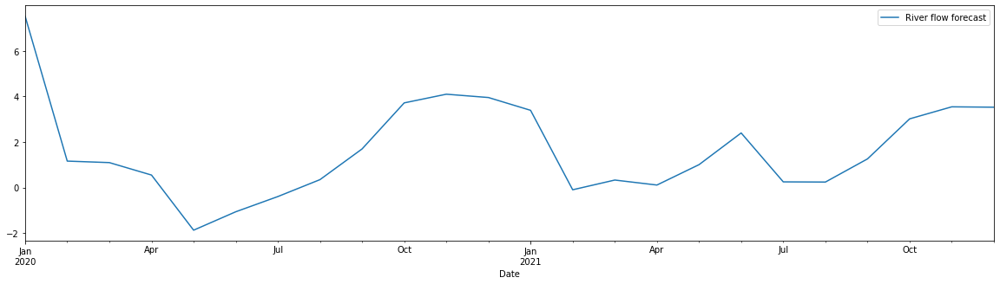


 ################ Basin 34 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


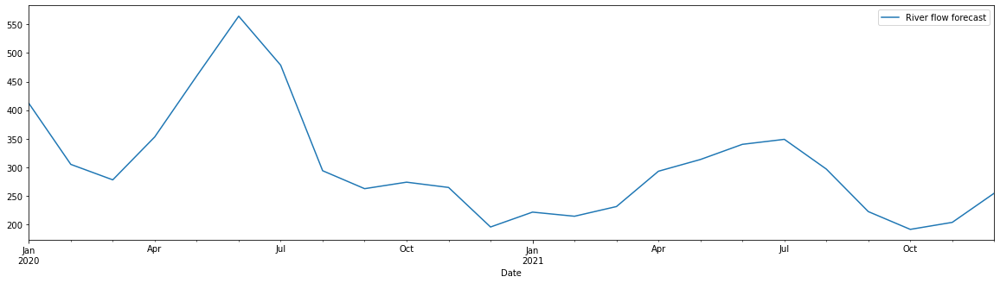


 ################ Basin 35 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


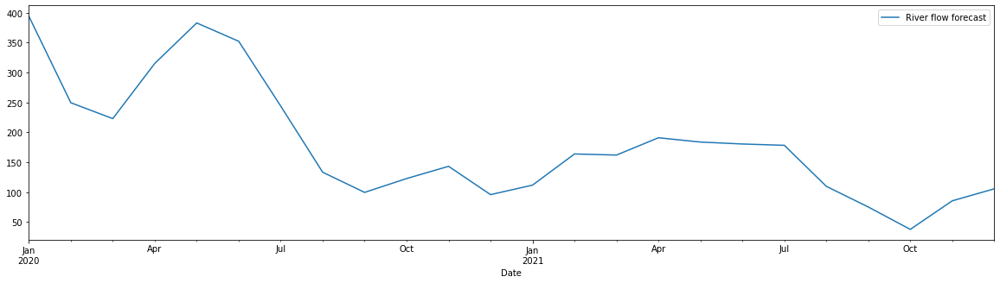


 ################ Basin 36 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


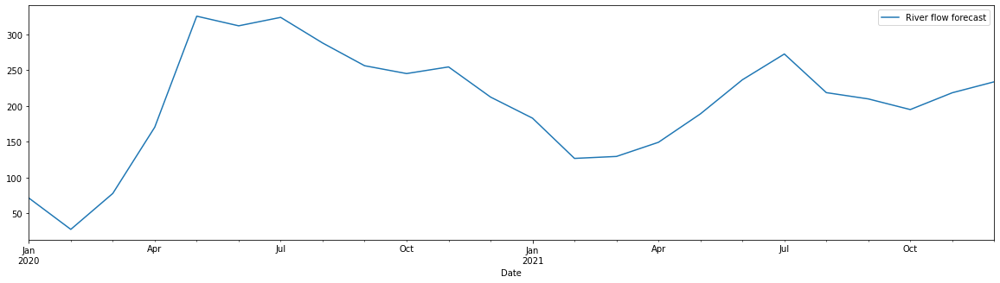


 ################ Basin 37 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


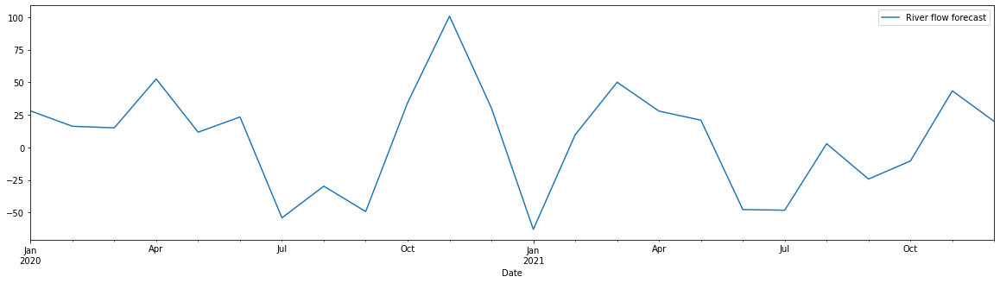


 ################ Basin 38 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


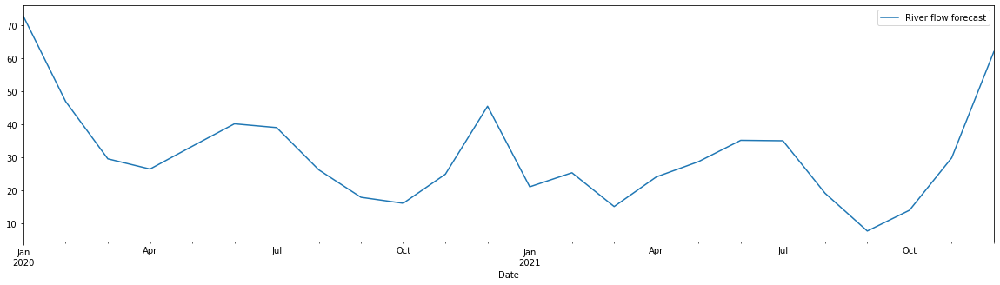


 ################ Basin 39 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


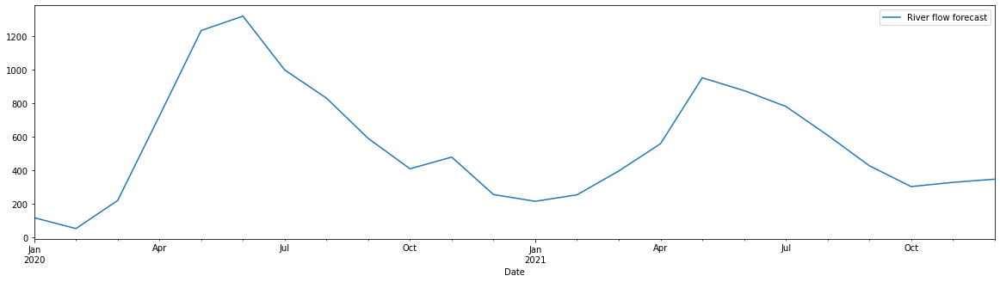


 ################ Basin 40 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


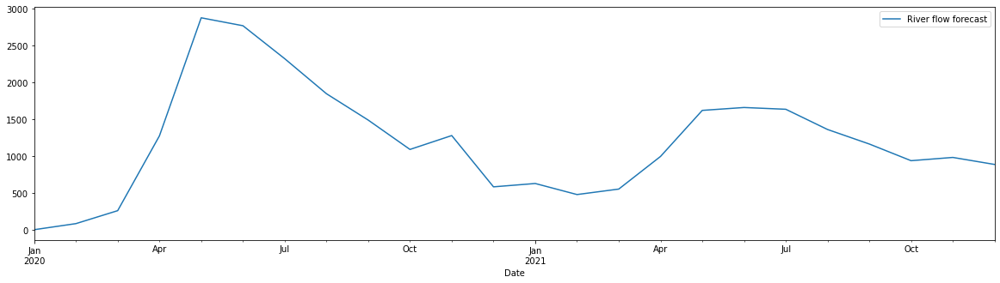


 ################ Basin 41 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


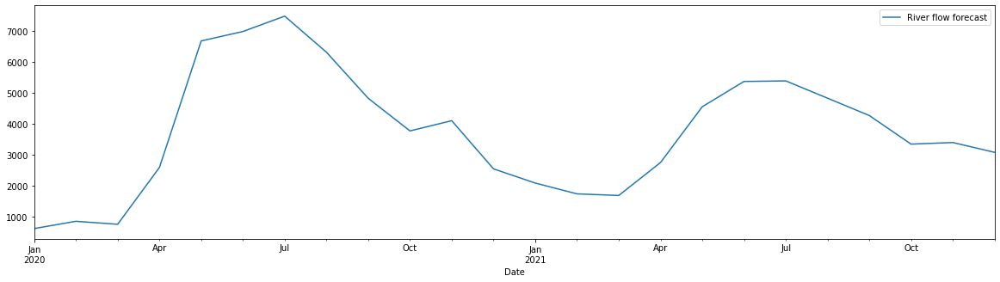


 ################ Basin 42 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


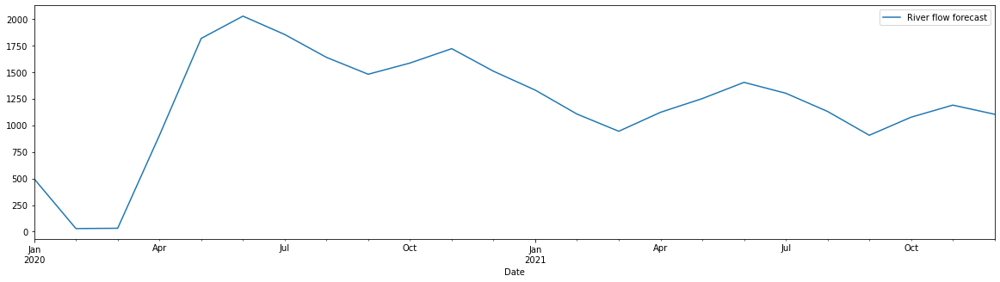


 ################ Basin 43 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


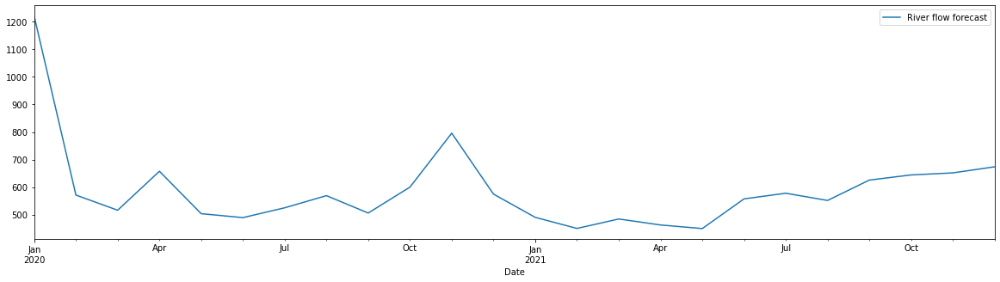


 ################ Basin 44 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


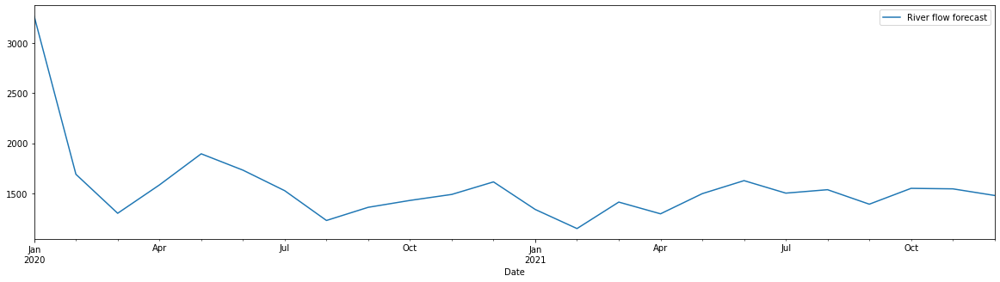


 ################ Basin 45 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


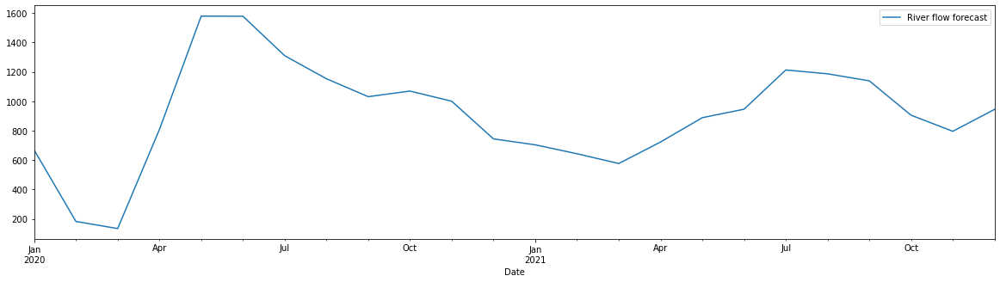


 ################ Basin 46 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


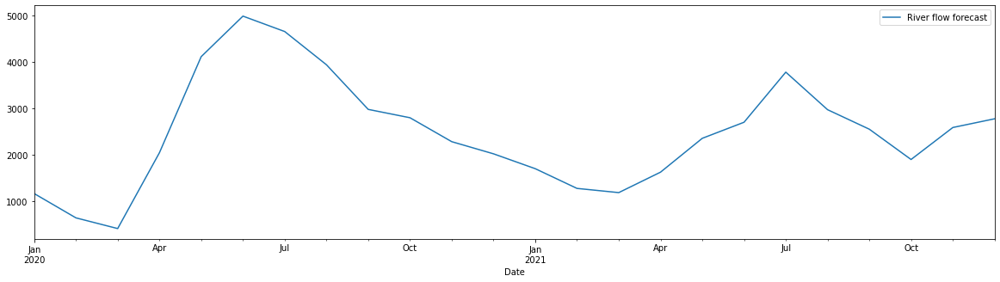


 ################ Basin 47 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


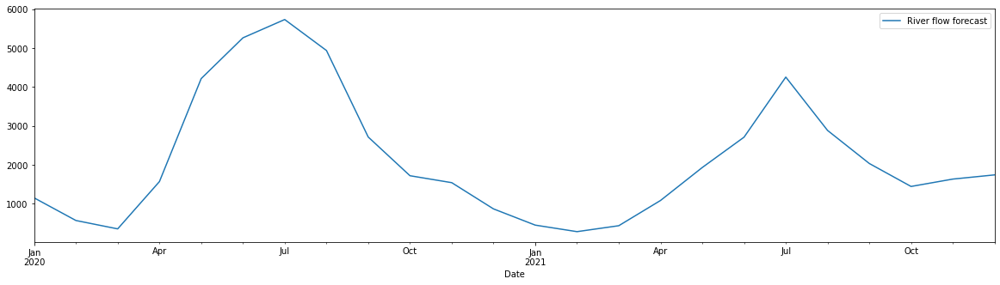


 ################ Basin 48 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


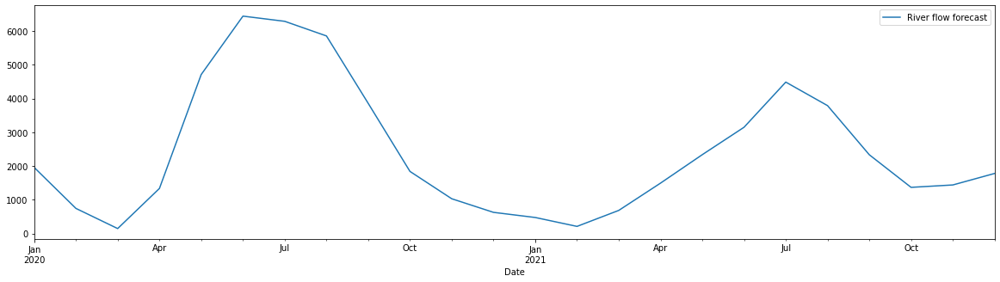

Def_50%
P_A2

 ################ Basin 1 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


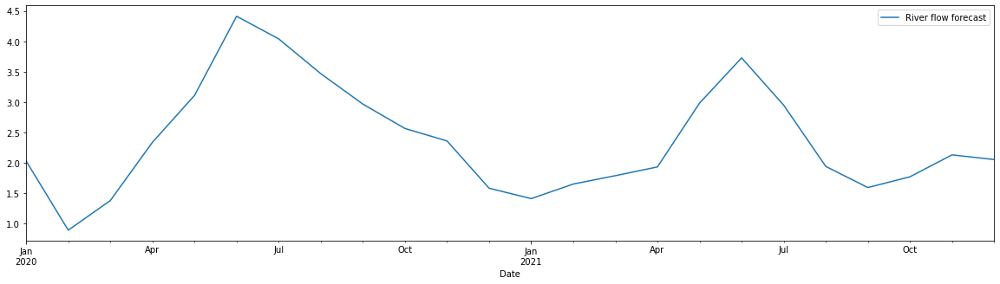


 ################ Basin 2 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


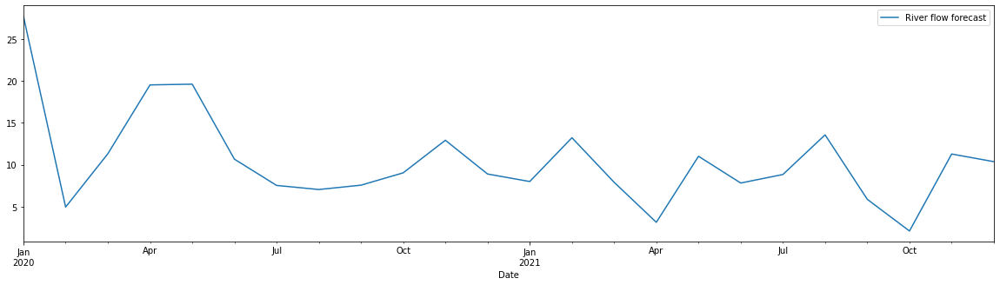


 ################ Basin 3 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


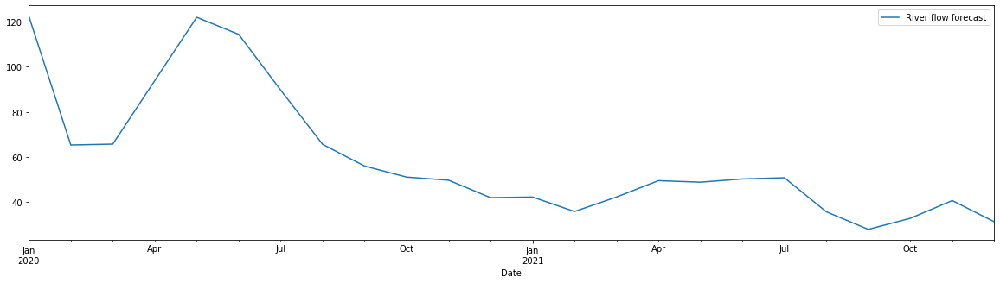


 ################ Basin 4 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


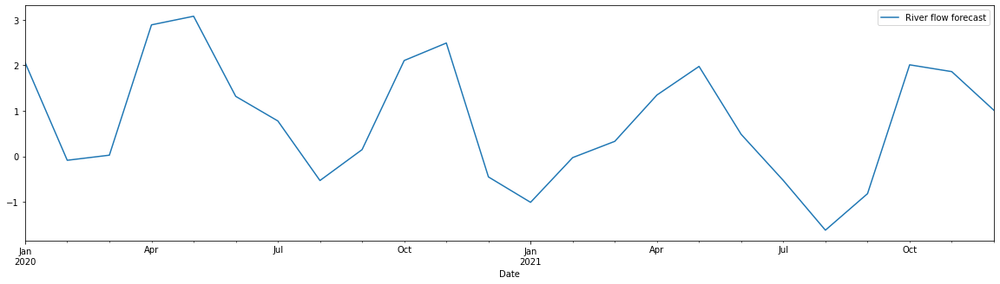


 ################ Basin 5 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


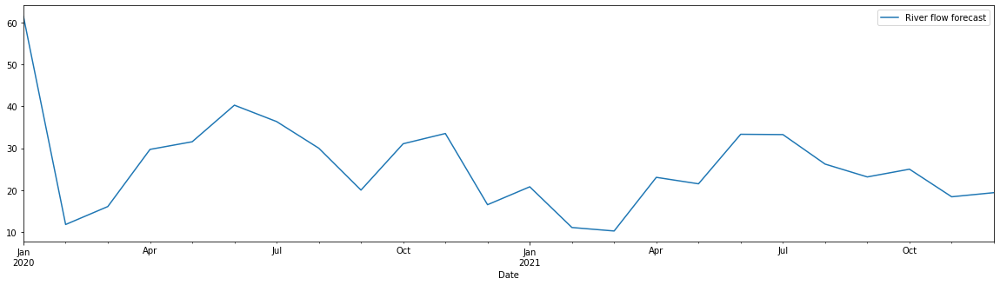


 ################ Basin 6 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


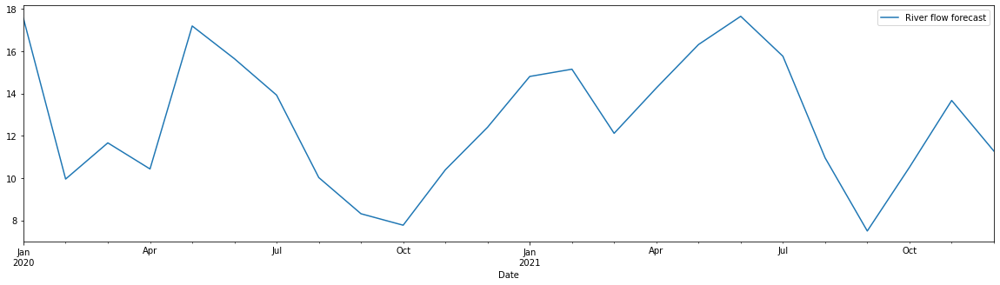


 ################ Basin 7 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


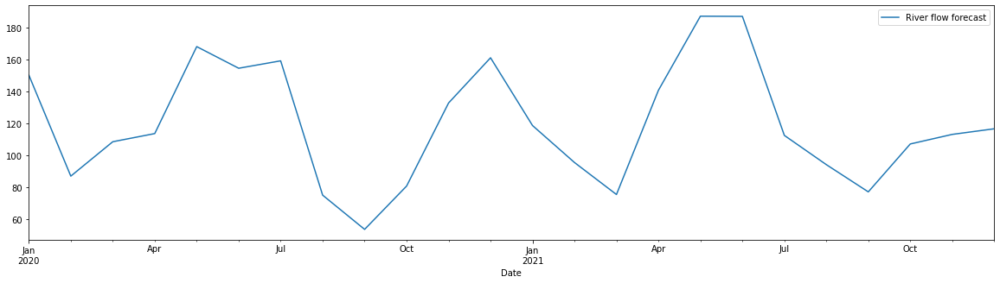


 ################ Basin 8 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


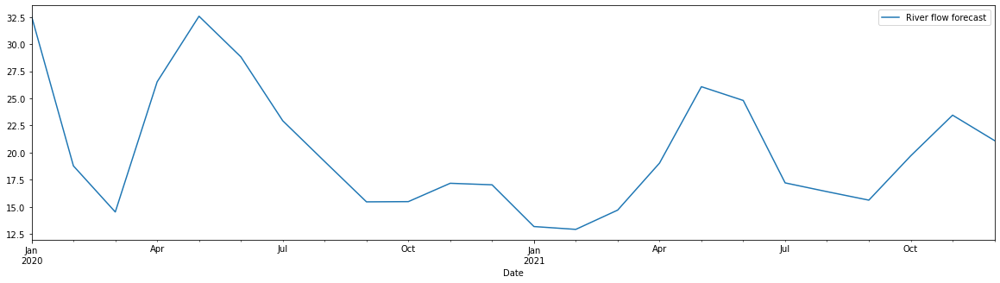


 ################ Basin 9 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


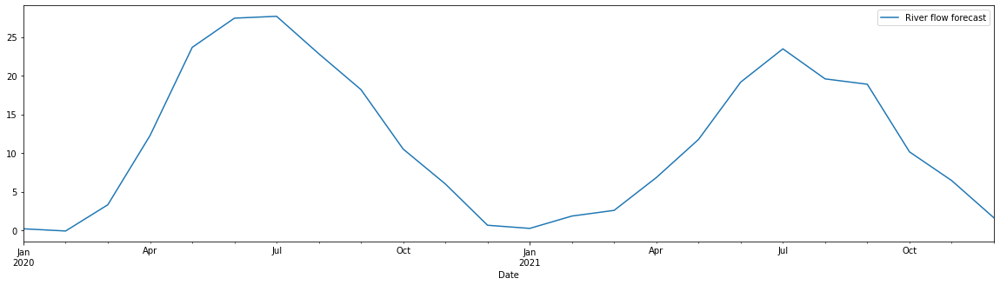


 ################ Basin 10 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


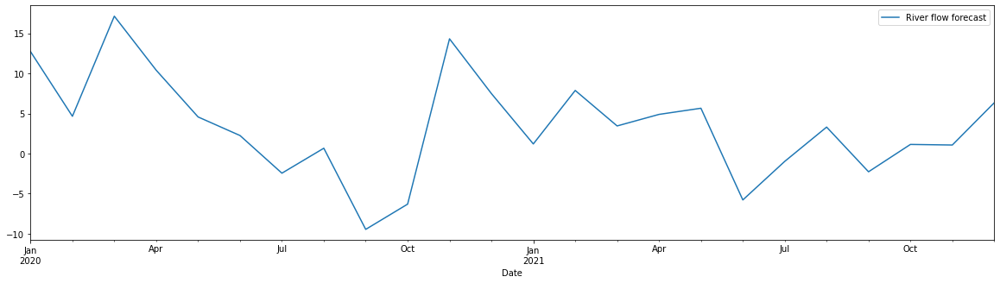


 ################ Basin 11 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


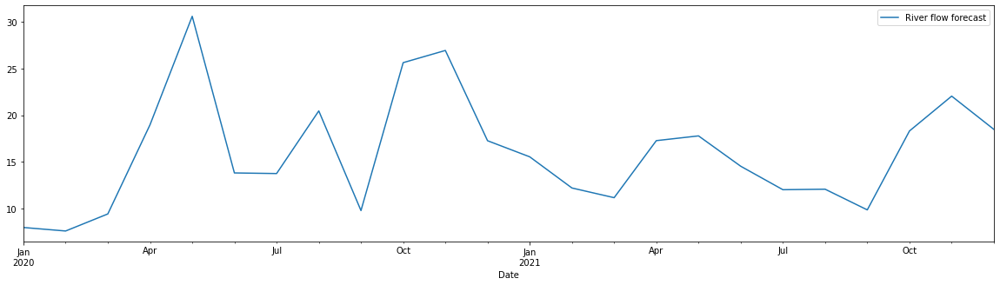


 ################ Basin 12 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


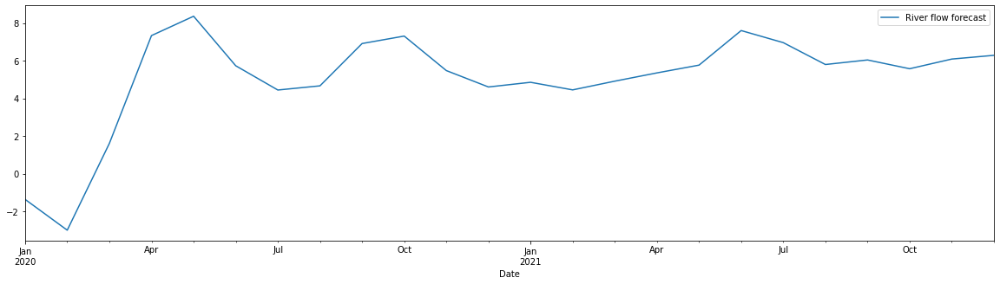


 ################ Basin 13 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


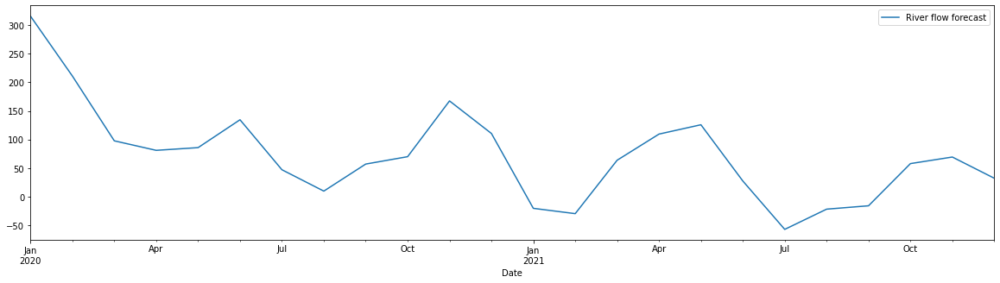


 ################ Basin 14 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


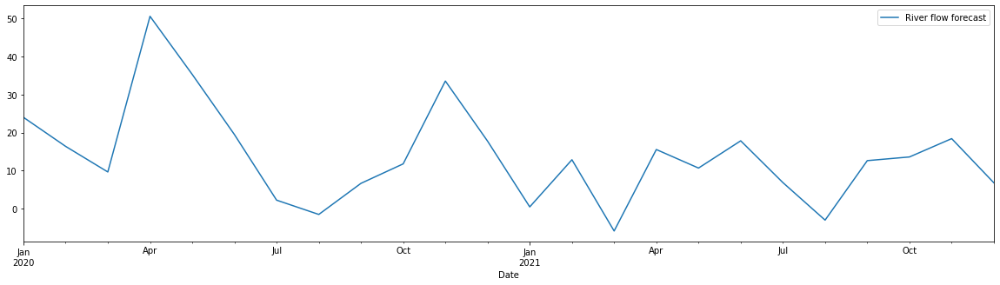


 ################ Basin 15 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


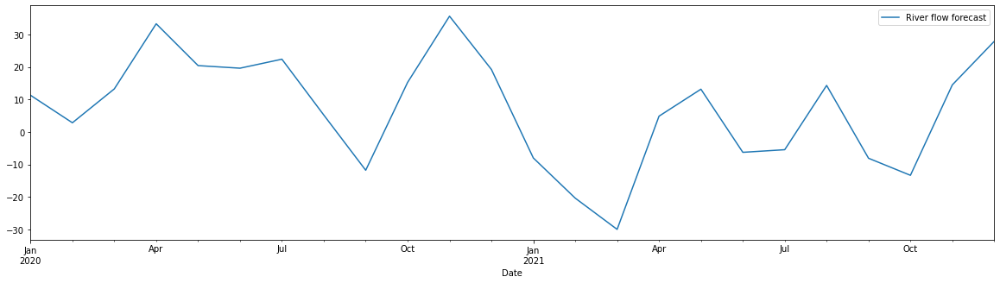


 ################ Basin 16 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


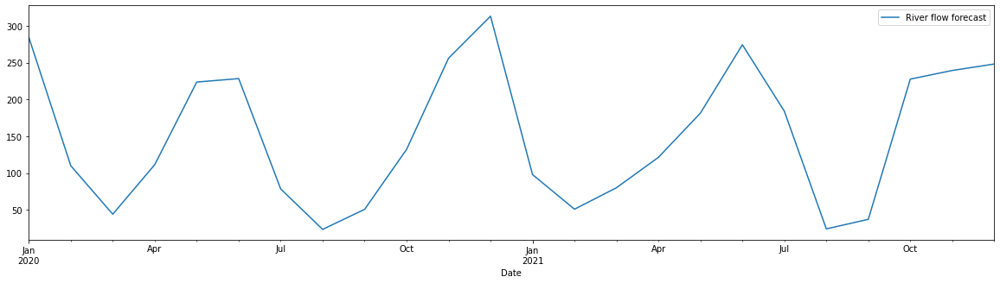


 ################ Basin 17 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


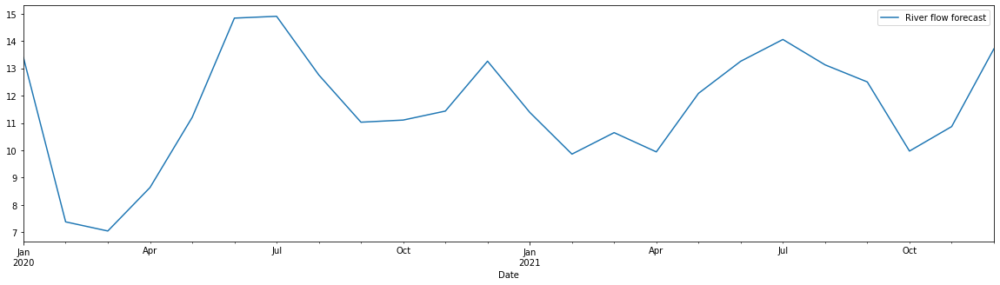


 ################ Basin 18 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


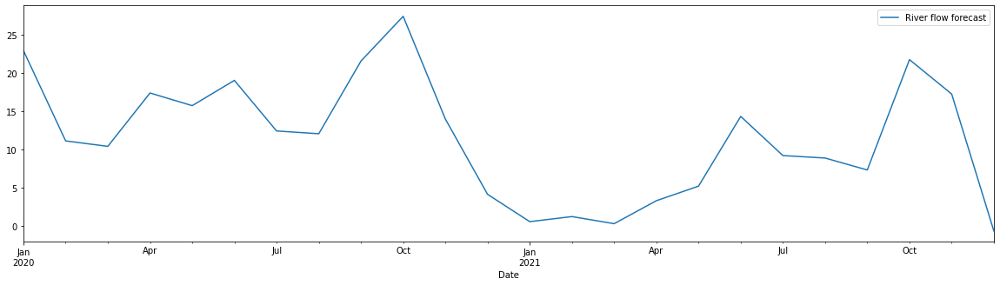


 ################ Basin 19 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


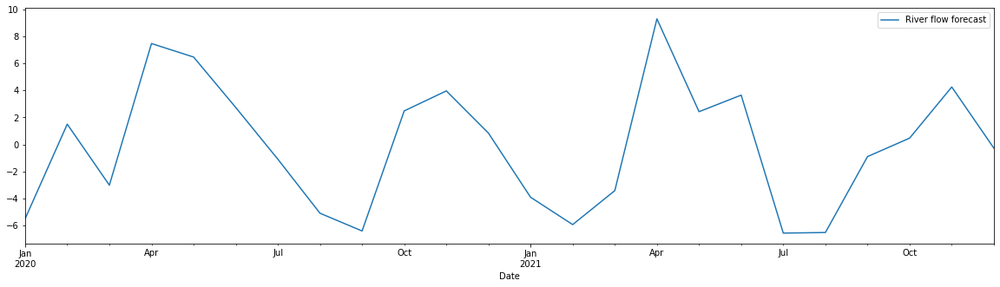


 ################ Basin 20 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


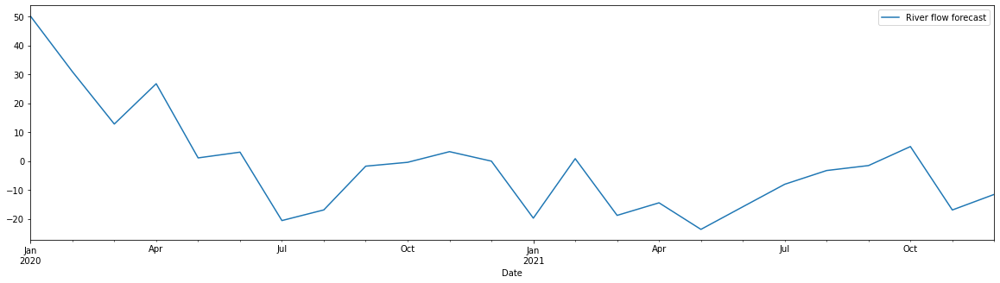


 ################ Basin 21 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


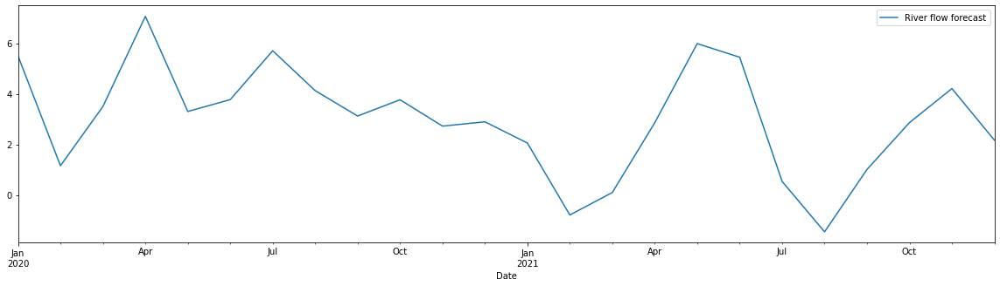


 ################ Basin 22 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


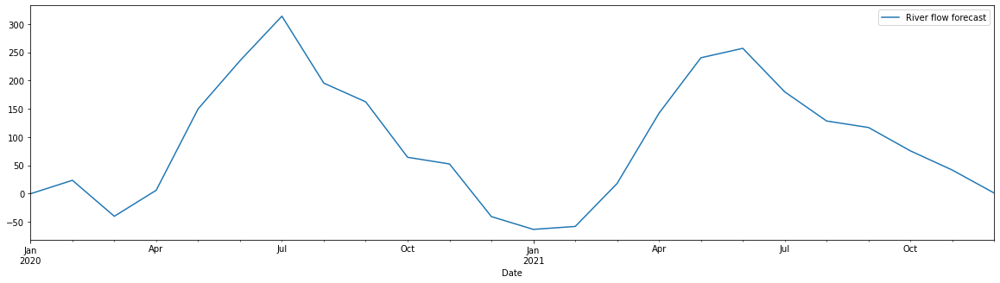


 ################ Basin 23 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


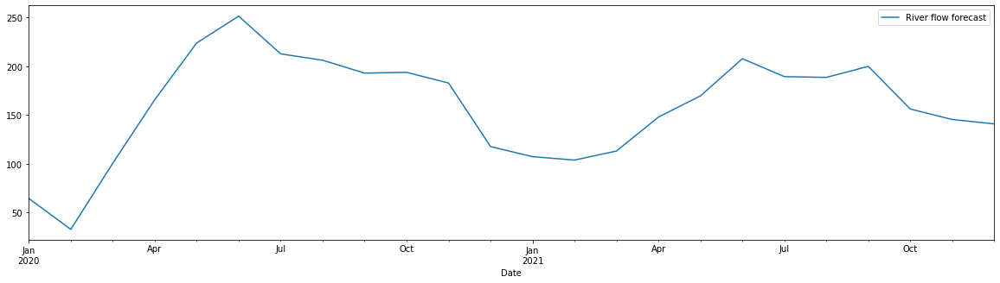


 ################ Basin 24 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


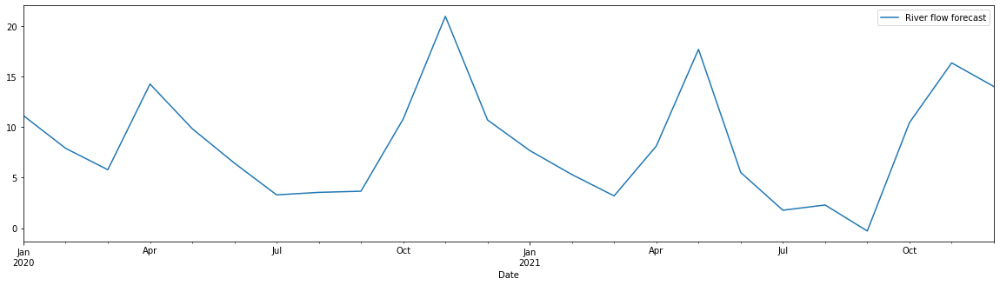


 ################ Basin 25 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


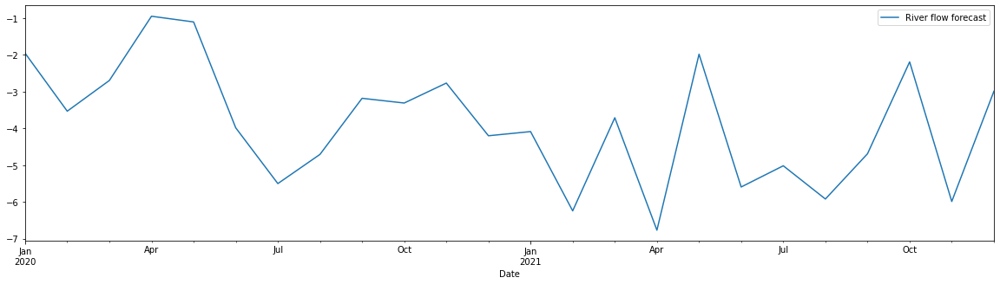


 ################ Basin 26 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


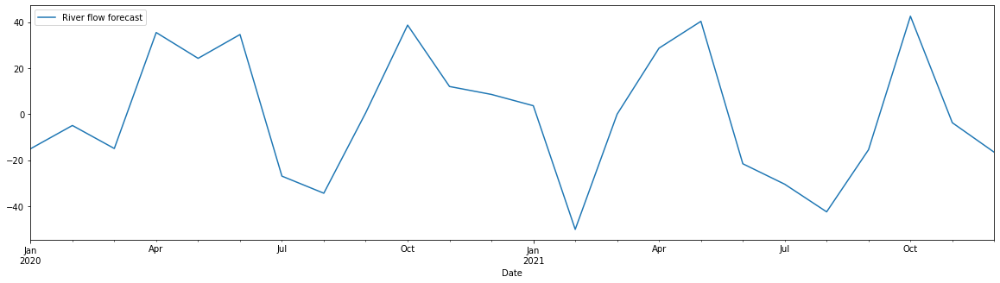


 ################ Basin 27 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


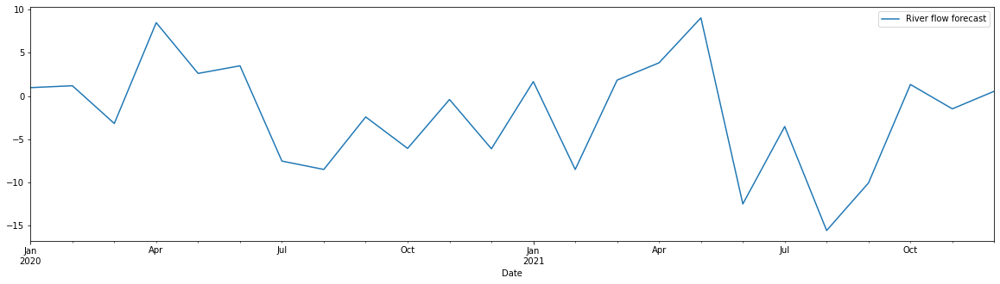


 ################ Basin 28 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


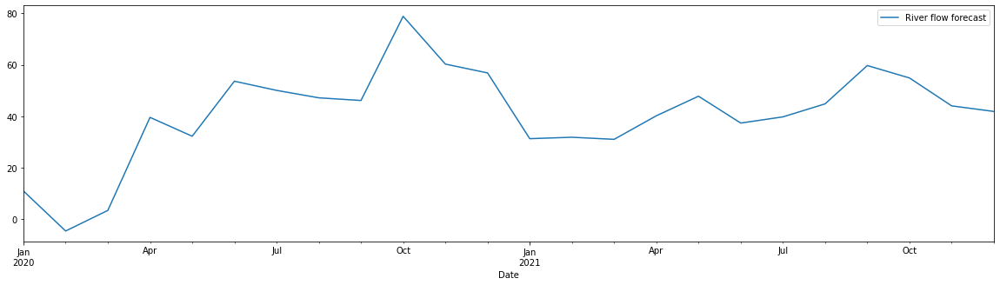


 ################ Basin 29 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


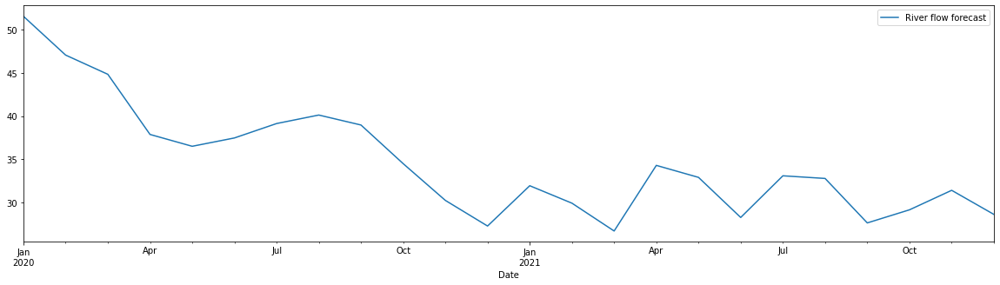


 ################ Basin 30 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


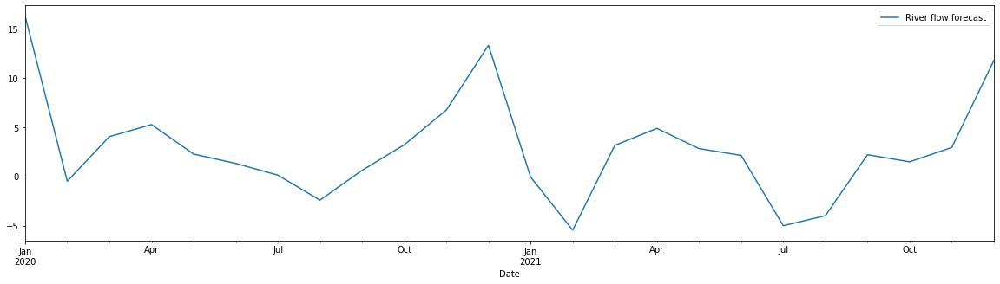


 ################ Basin 31 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


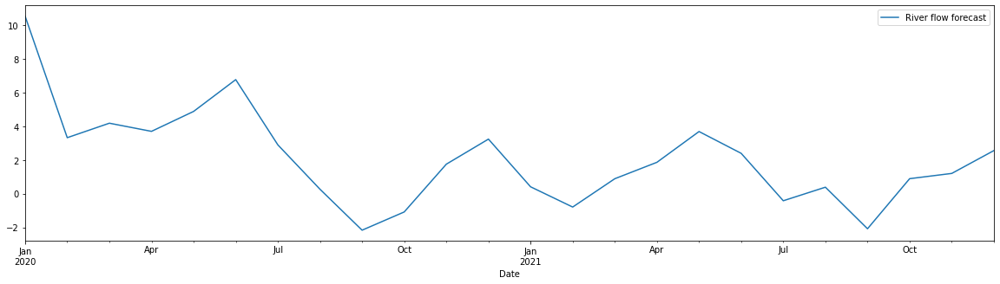


 ################ Basin 32 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


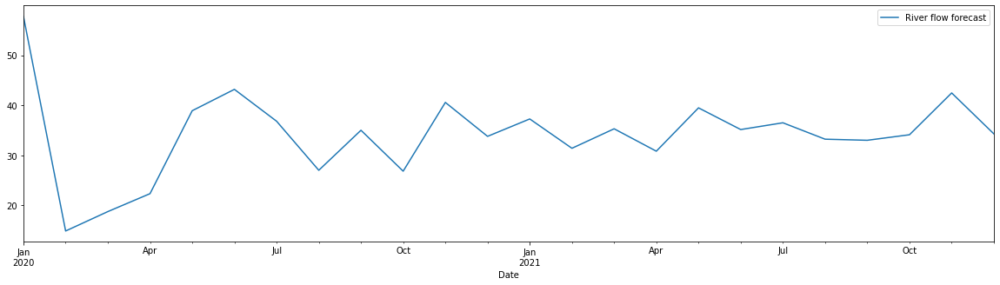


 ################ Basin 33 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


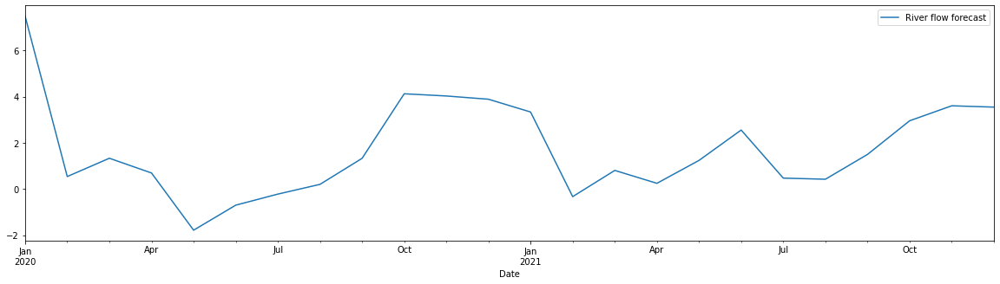


 ################ Basin 34 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


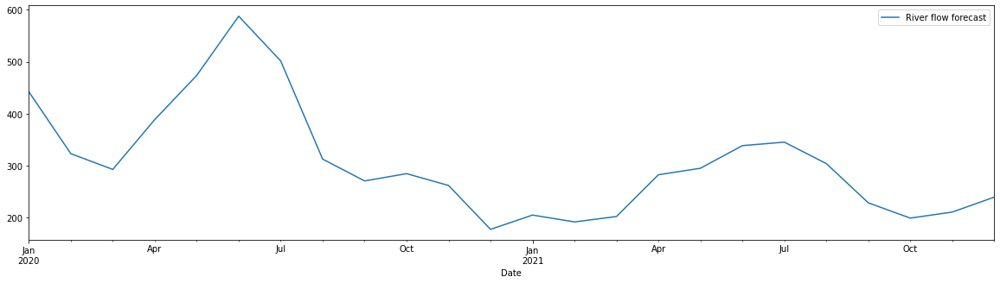


 ################ Basin 35 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


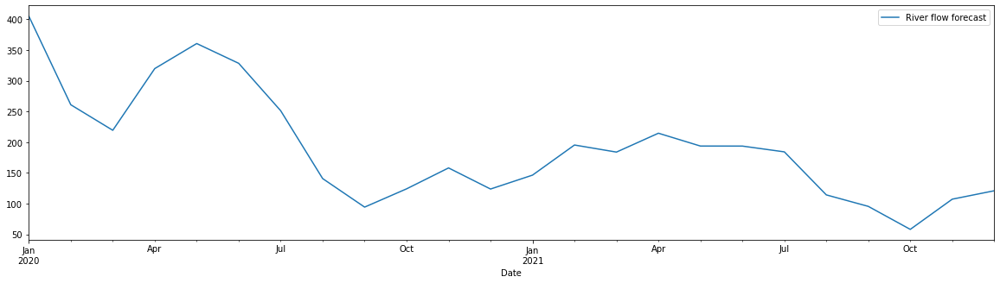


 ################ Basin 36 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


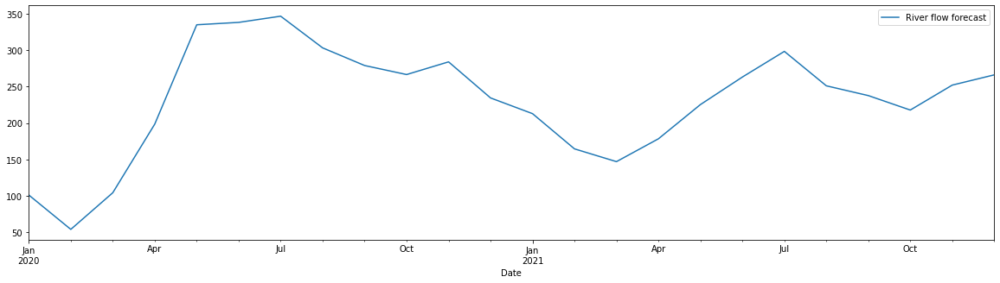


 ################ Basin 37 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


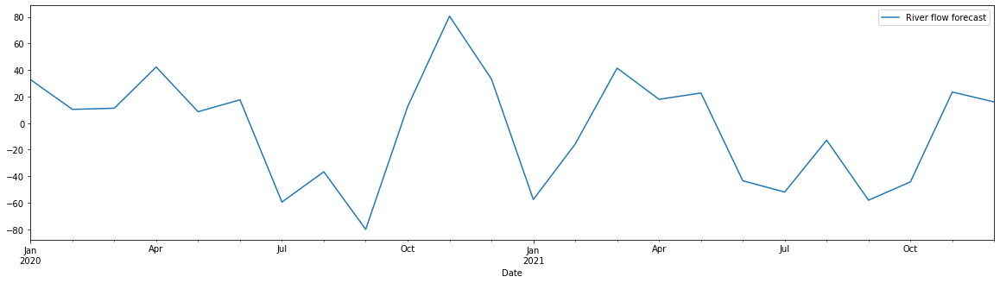


 ################ Basin 38 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


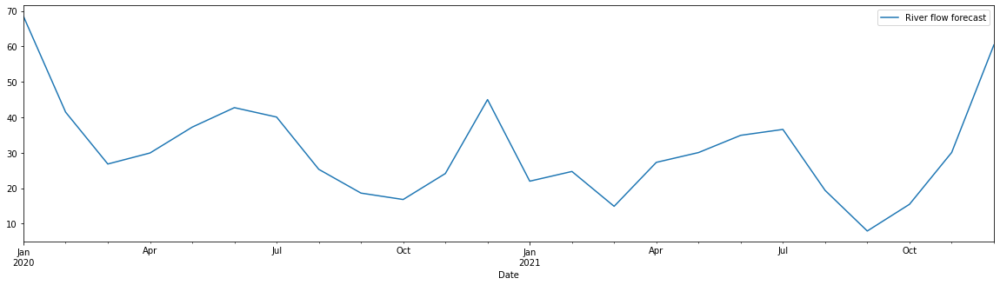


 ################ Basin 39 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


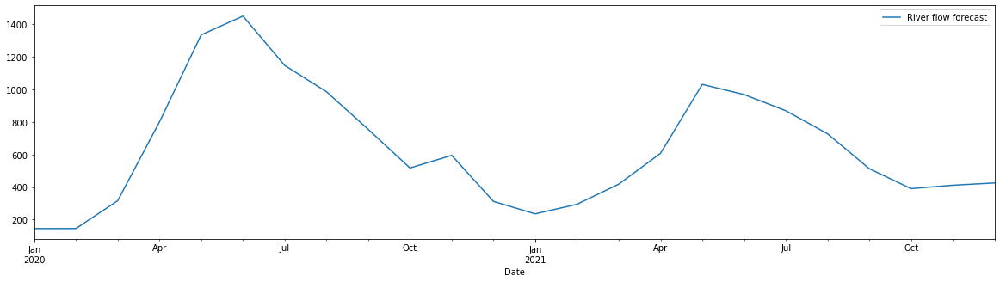


 ################ Basin 40 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


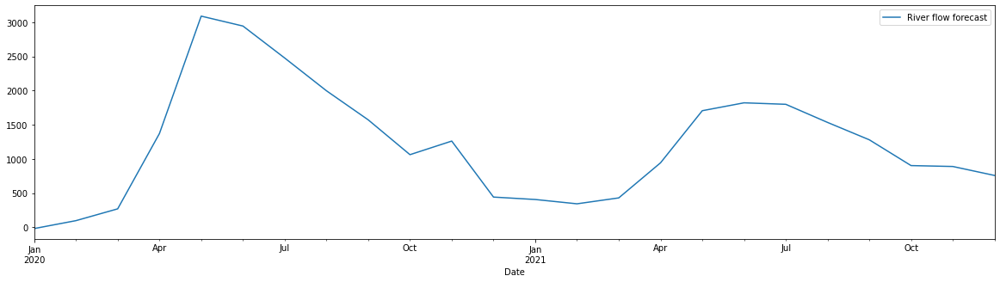


 ################ Basin 41 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


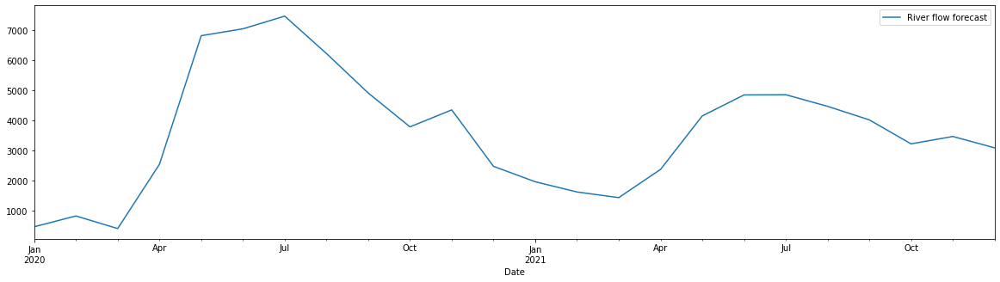


 ################ Basin 42 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


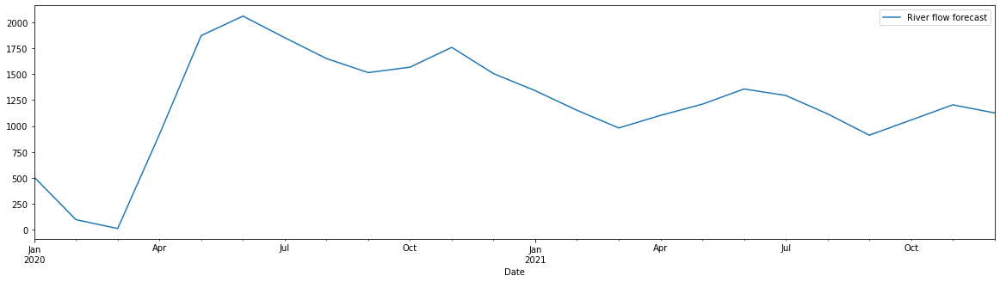


 ################ Basin 43 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


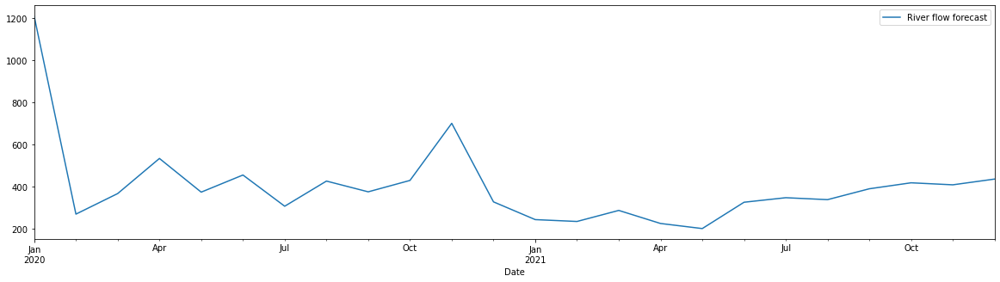


 ################ Basin 44 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


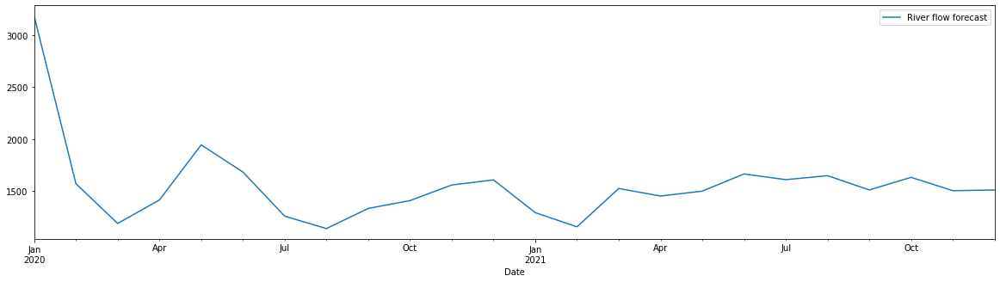


 ################ Basin 45 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


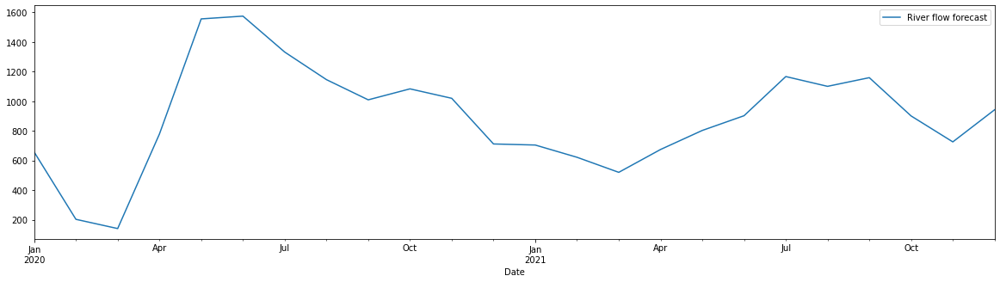


 ################ Basin 46 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


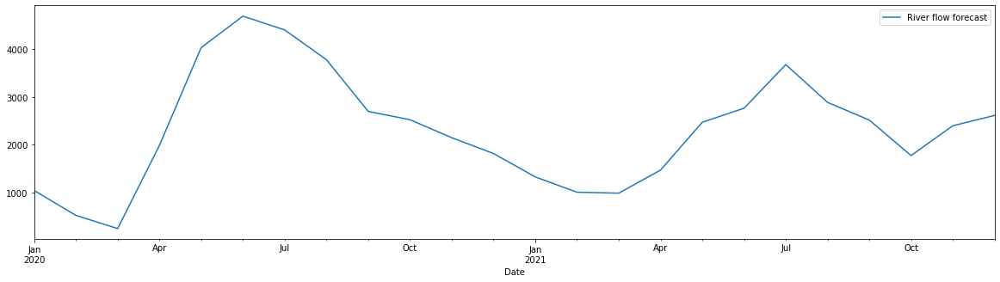


 ################ Basin 47 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


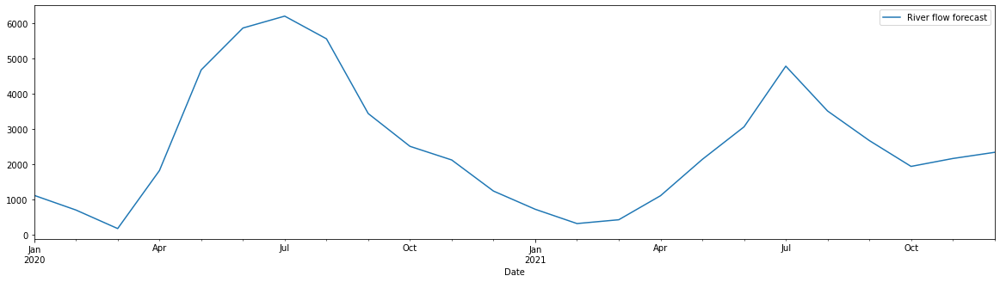


 ################ Basin 48 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


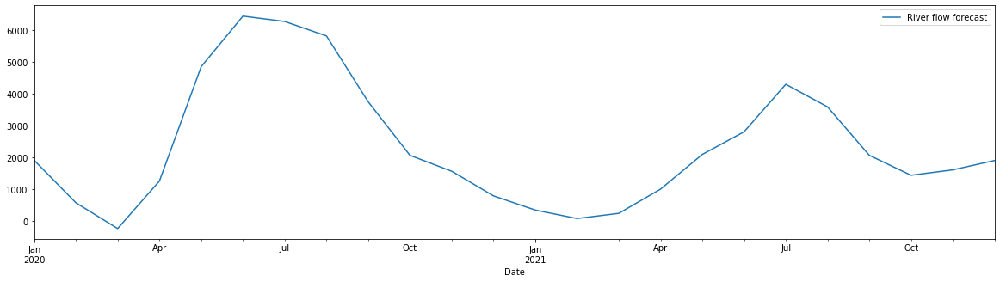

Def_50%
P_B1

 ################ Basin 1 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


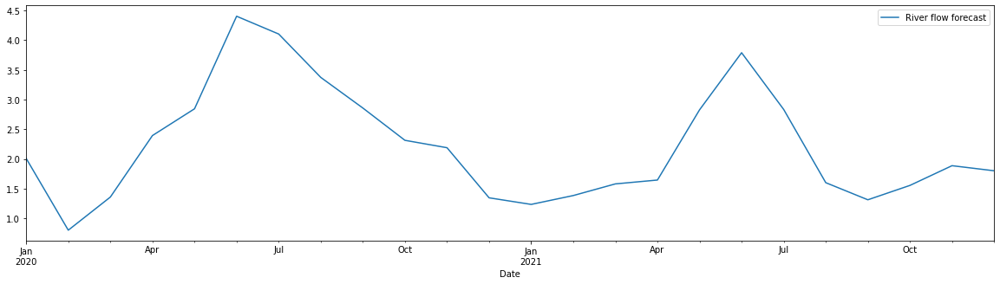


 ################ Basin 2 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


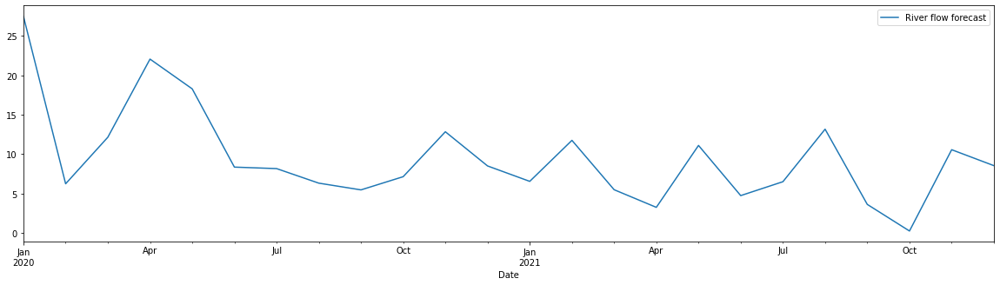


 ################ Basin 3 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


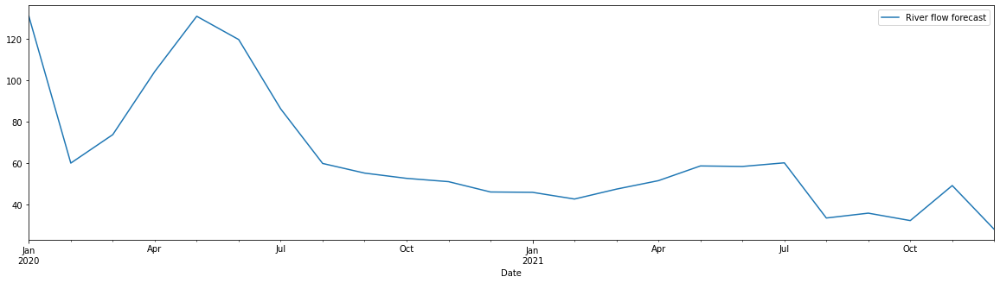


 ################ Basin 4 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


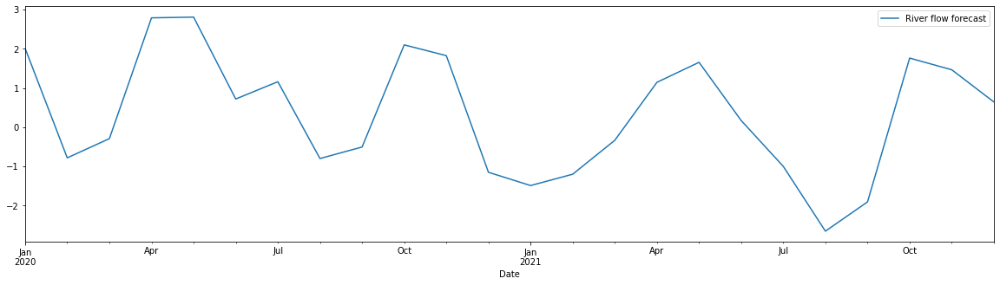


 ################ Basin 5 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


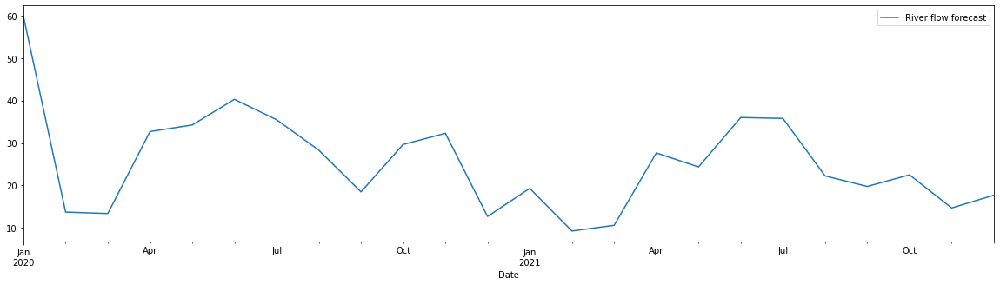


 ################ Basin 6 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


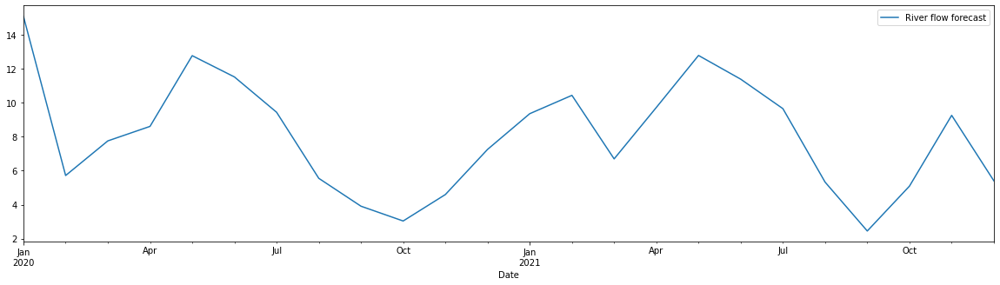


 ################ Basin 7 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


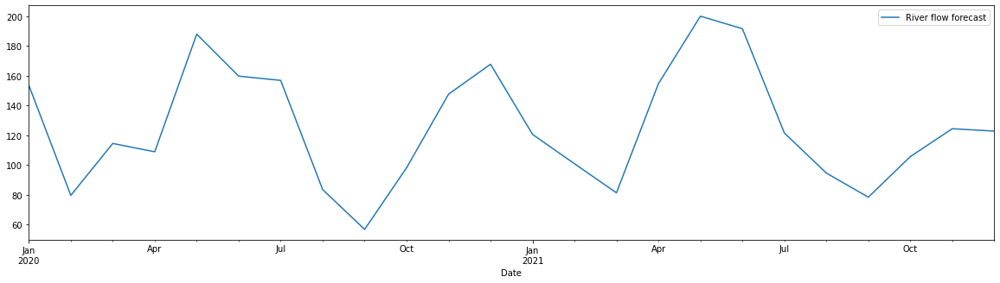


 ################ Basin 8 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


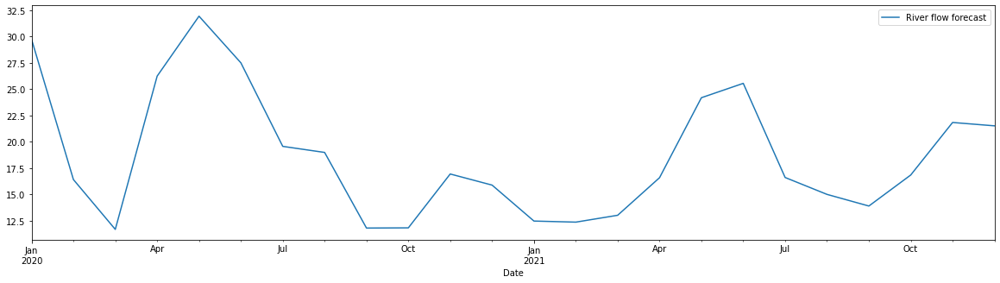


 ################ Basin 9 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


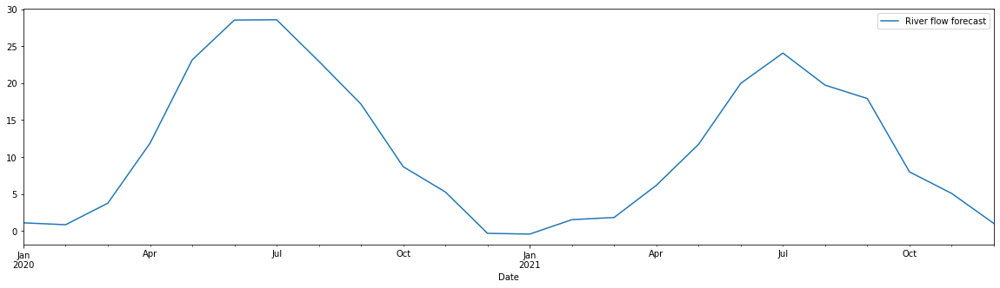


 ################ Basin 10 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


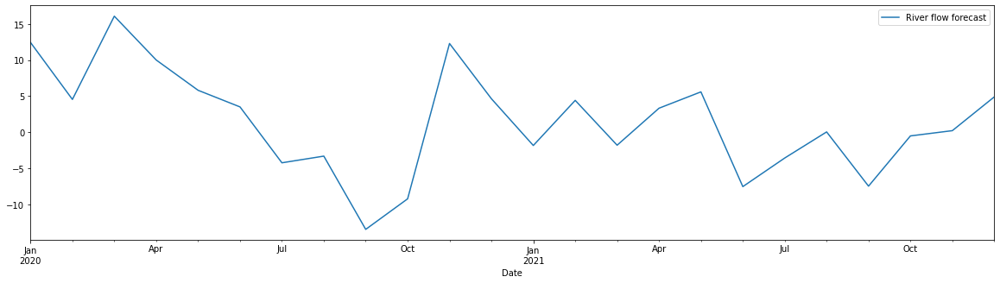


 ################ Basin 11 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


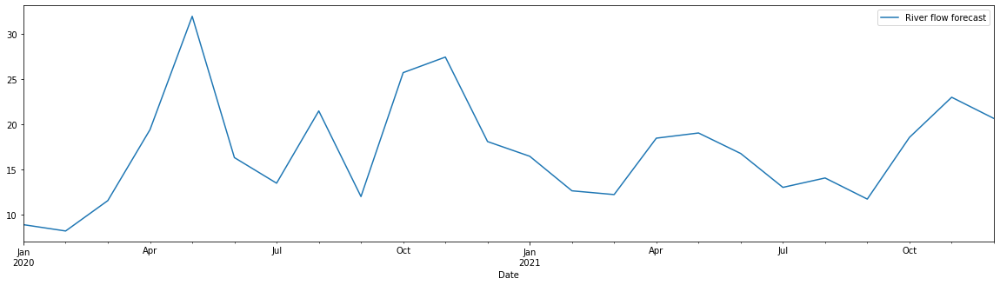


 ################ Basin 12 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


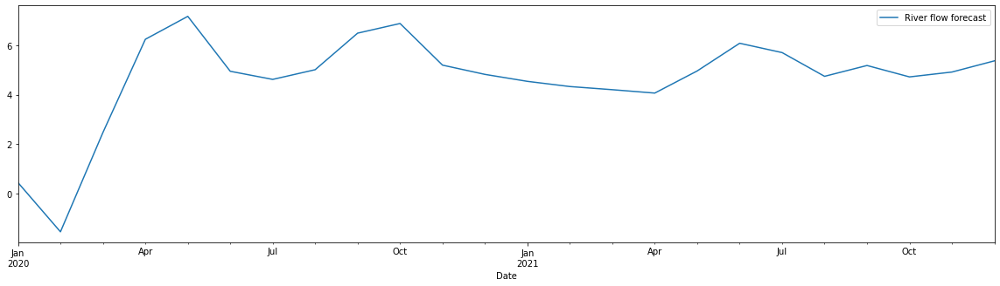


 ################ Basin 13 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


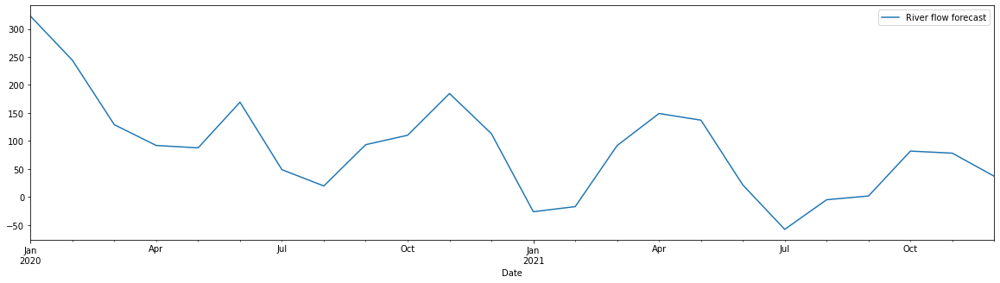


 ################ Basin 14 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


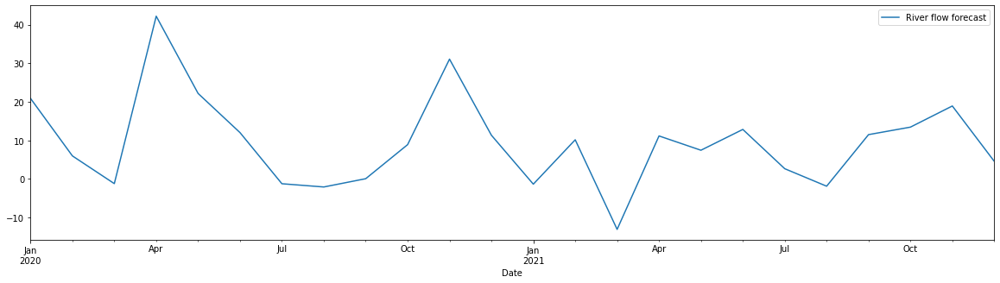


 ################ Basin 15 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


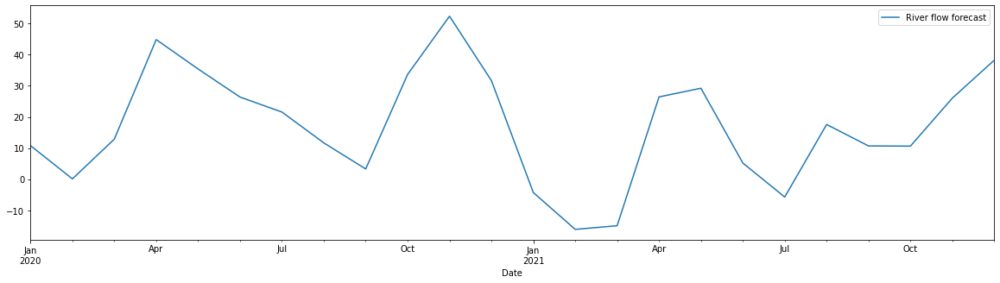


 ################ Basin 16 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


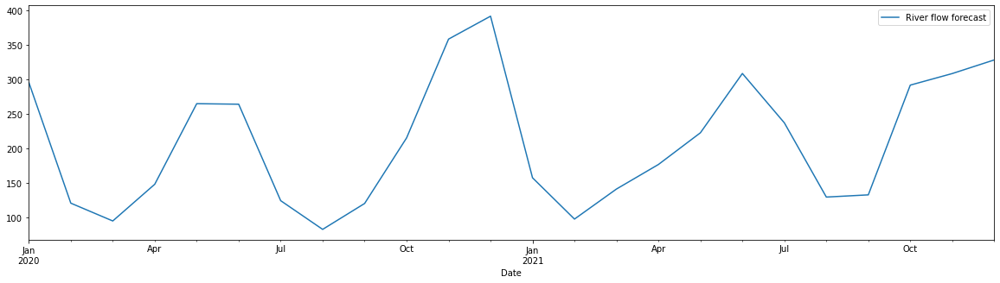


 ################ Basin 17 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


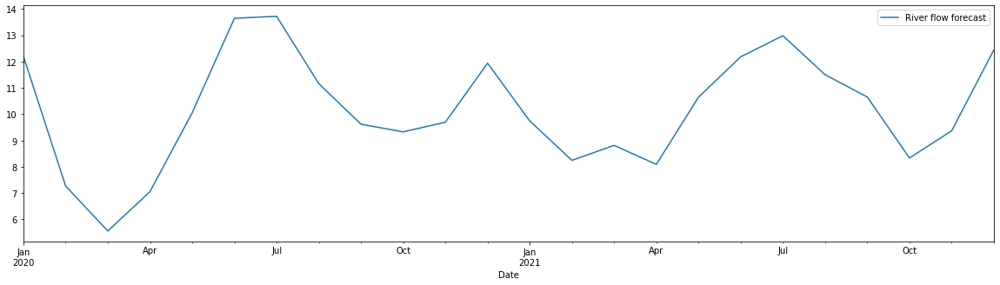


 ################ Basin 18 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


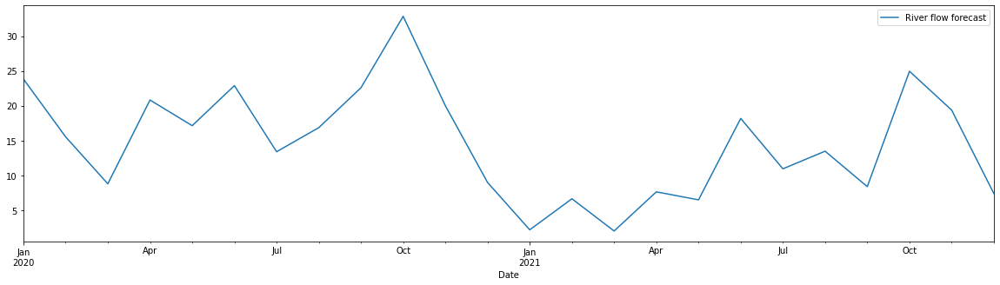


 ################ Basin 19 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


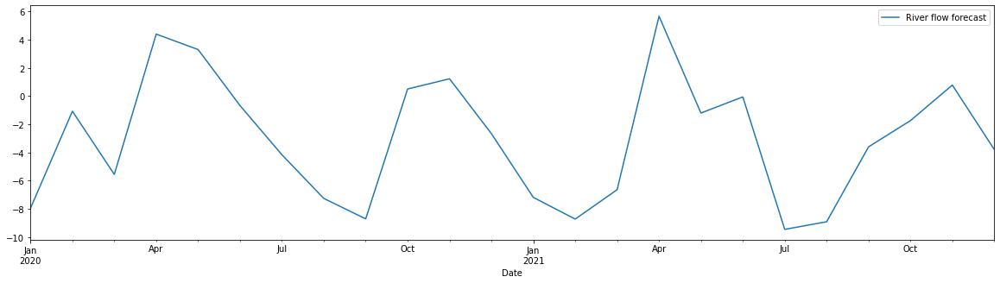


 ################ Basin 20 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


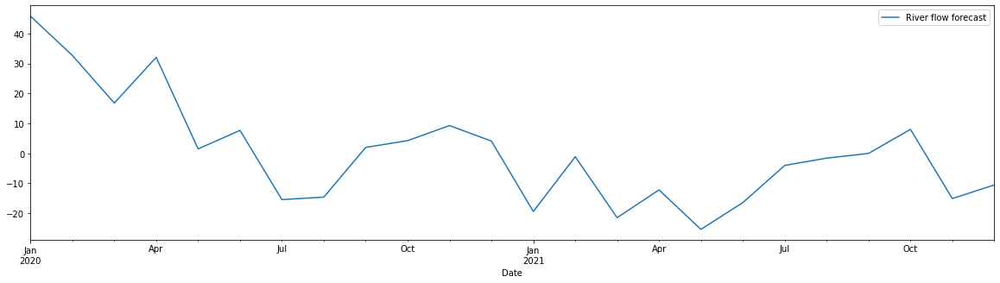


 ################ Basin 21 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


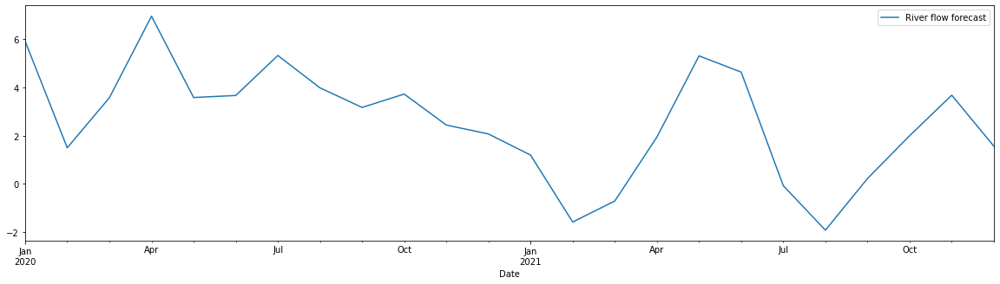


 ################ Basin 22 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


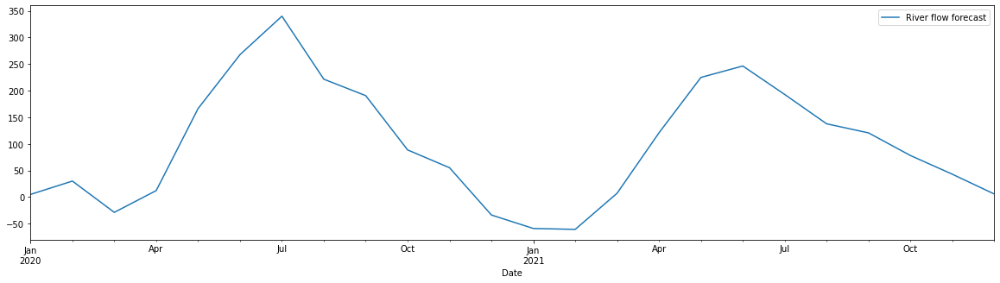


 ################ Basin 23 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


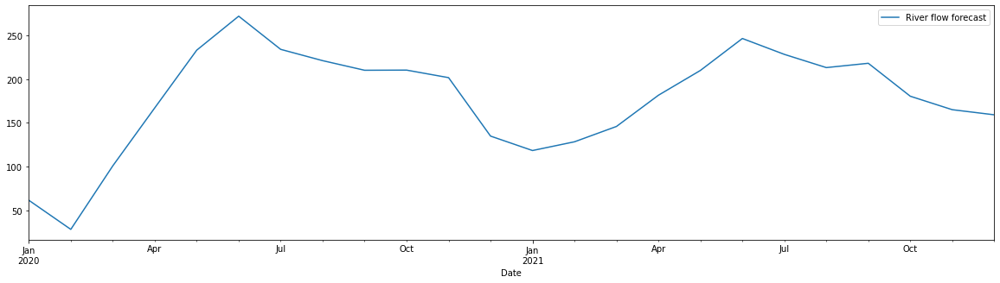


 ################ Basin 24 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


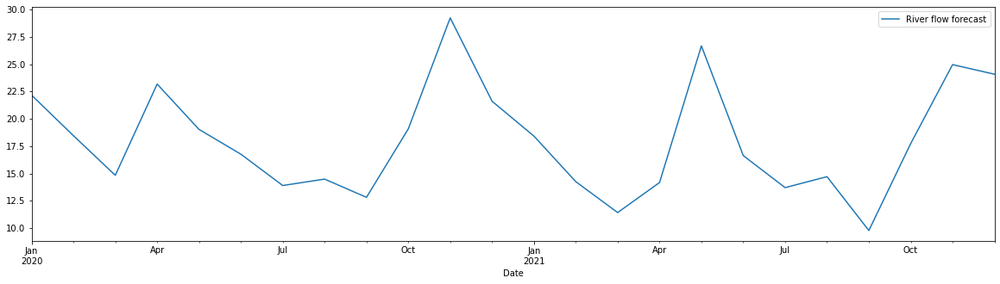


 ################ Basin 25 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


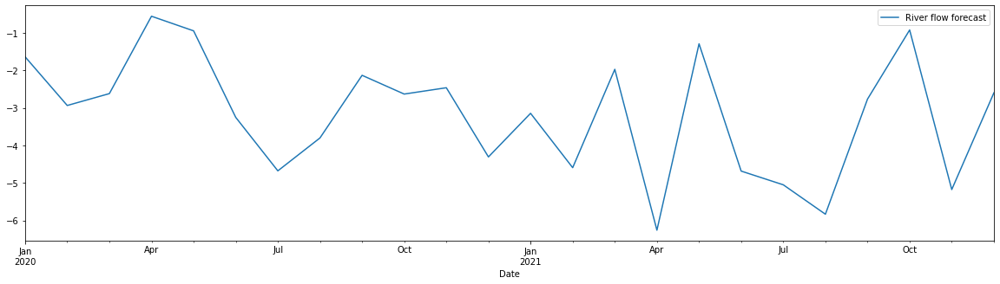


 ################ Basin 26 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


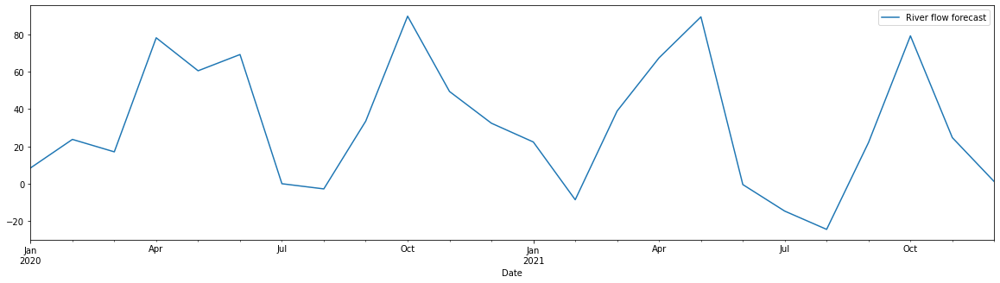


 ################ Basin 27 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


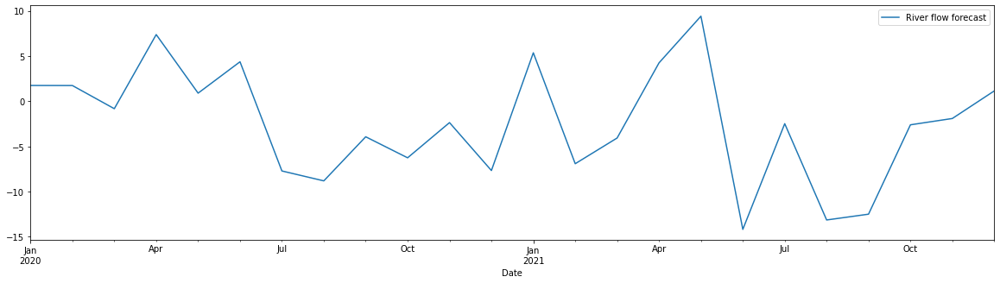


 ################ Basin 28 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


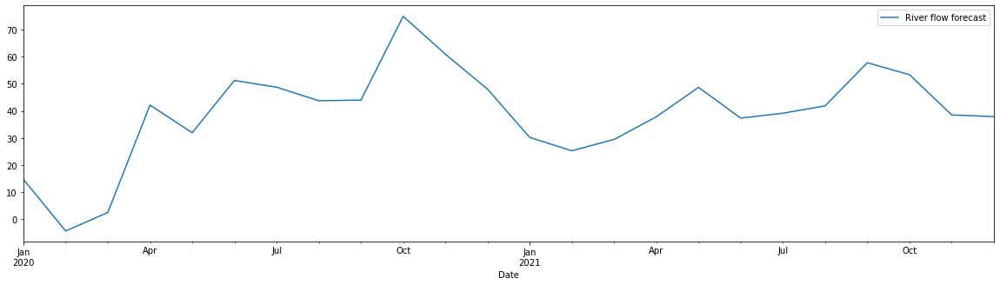


 ################ Basin 29 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


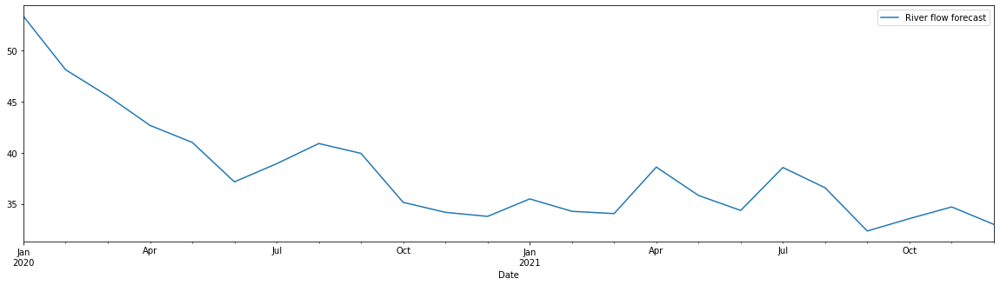


 ################ Basin 30 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


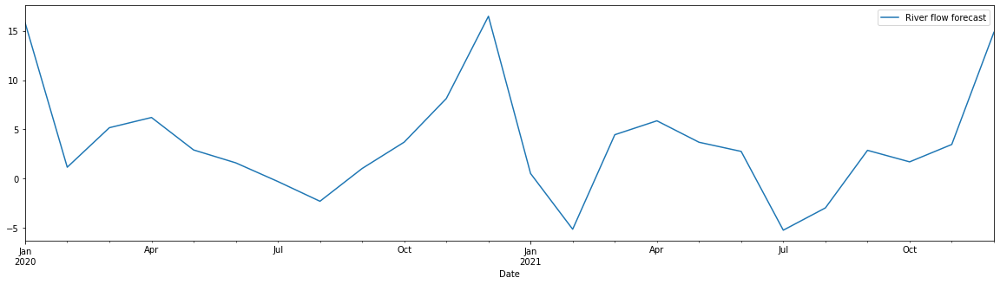


 ################ Basin 31 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


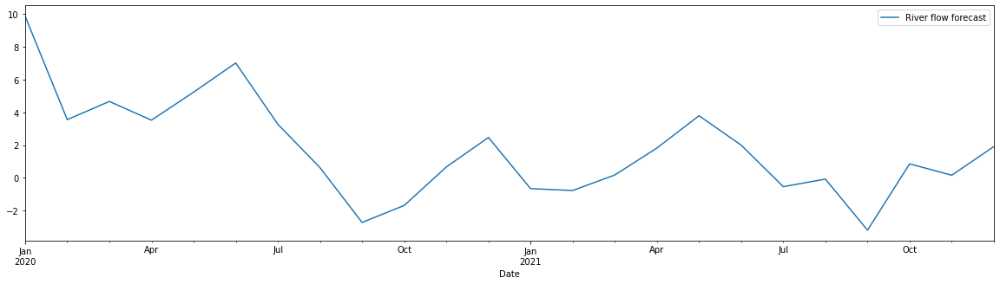


 ################ Basin 32 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


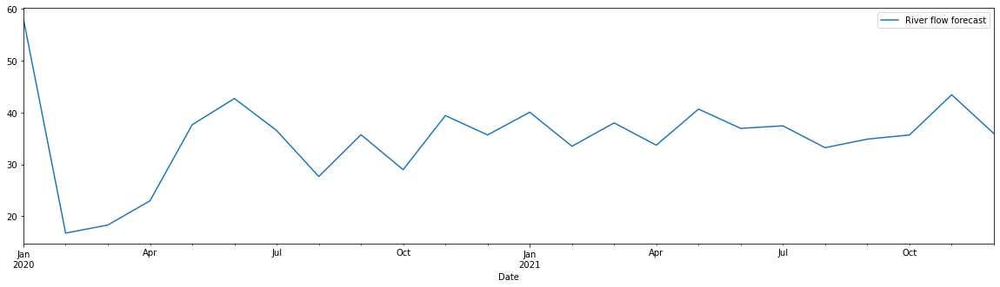


 ################ Basin 33 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


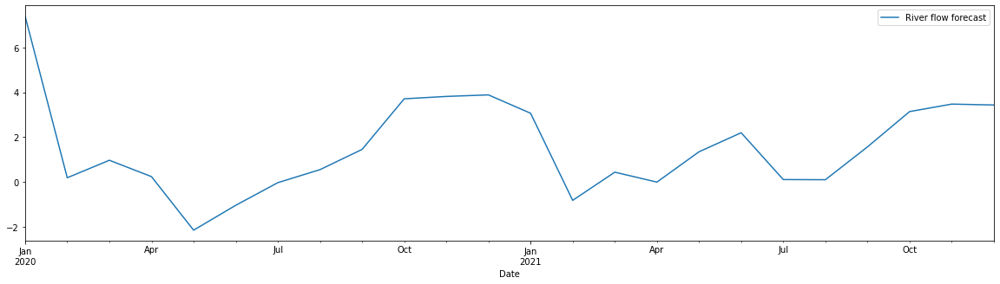


 ################ Basin 34 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


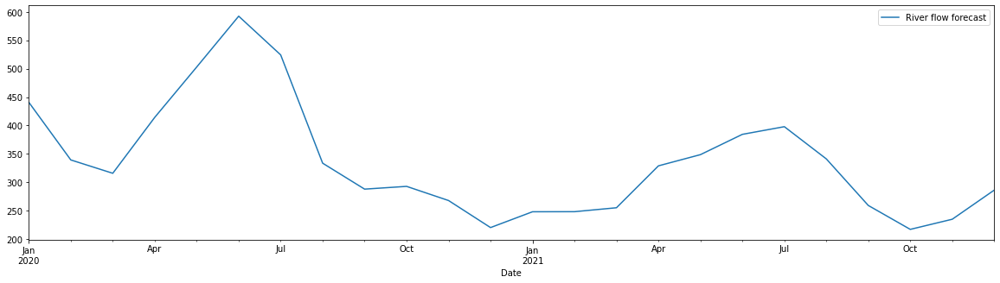


 ################ Basin 35 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


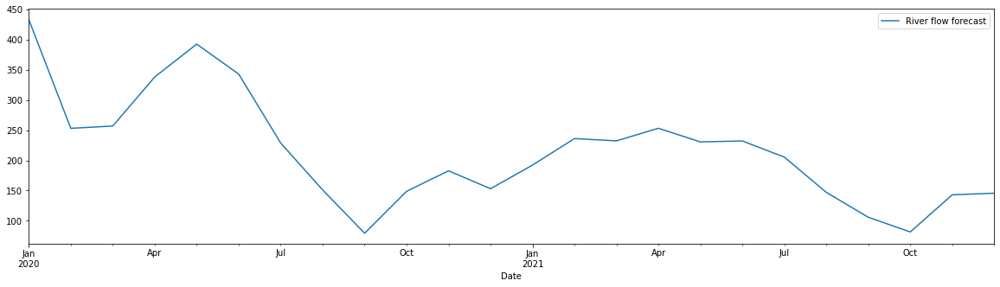


 ################ Basin 36 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


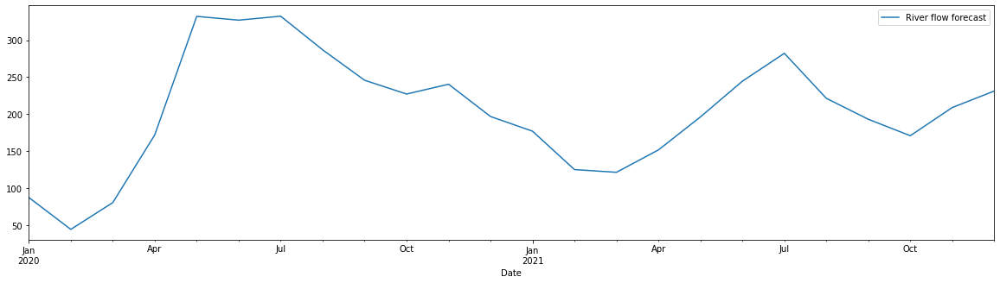


 ################ Basin 37 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


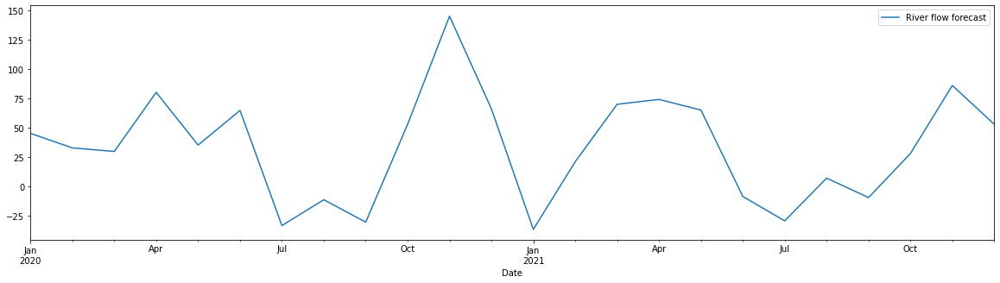


 ################ Basin 38 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


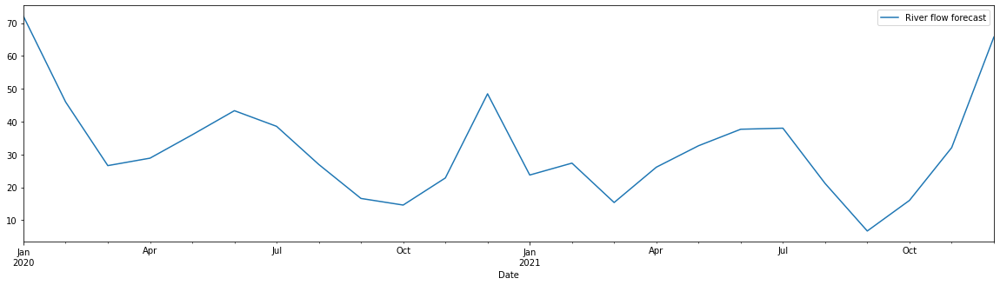


 ################ Basin 39 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


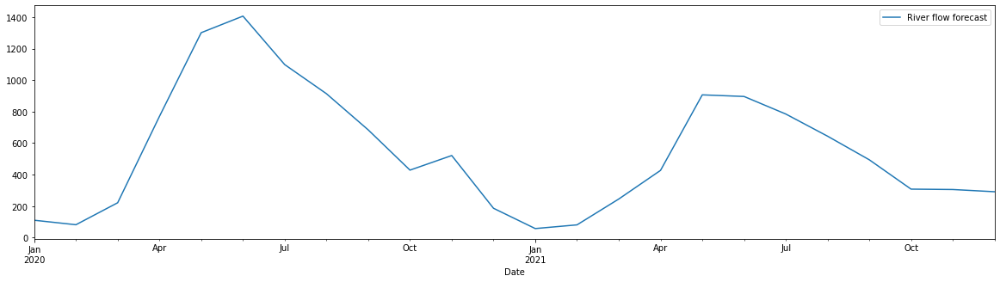


 ################ Basin 40 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


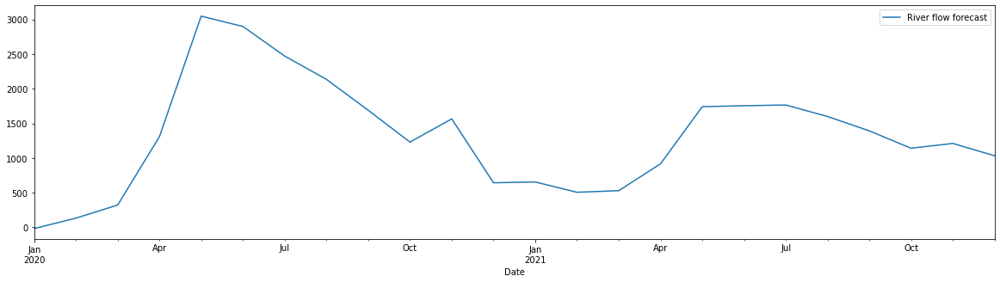


 ################ Basin 41 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


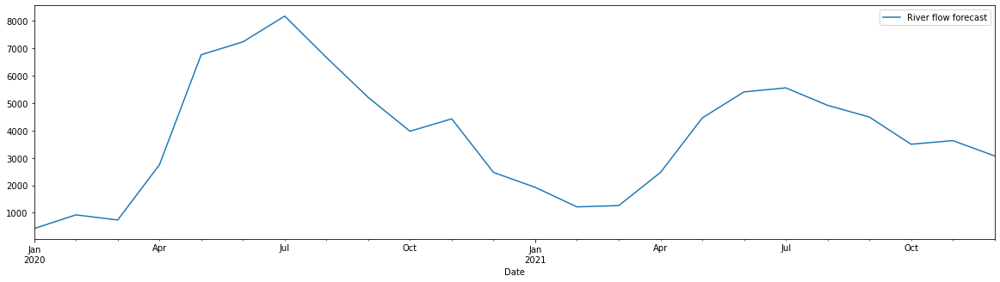


 ################ Basin 42 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


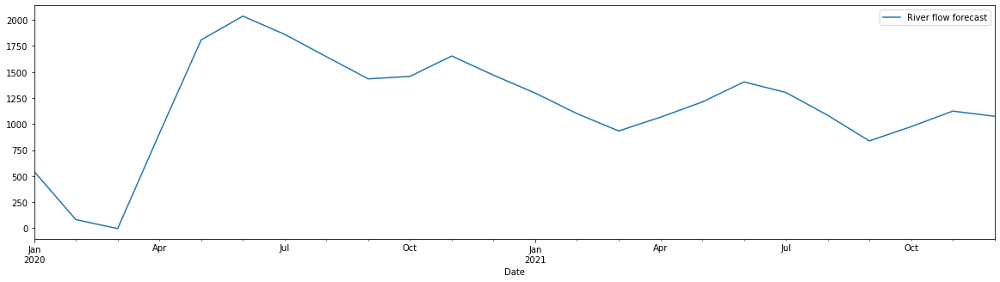


 ################ Basin 43 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


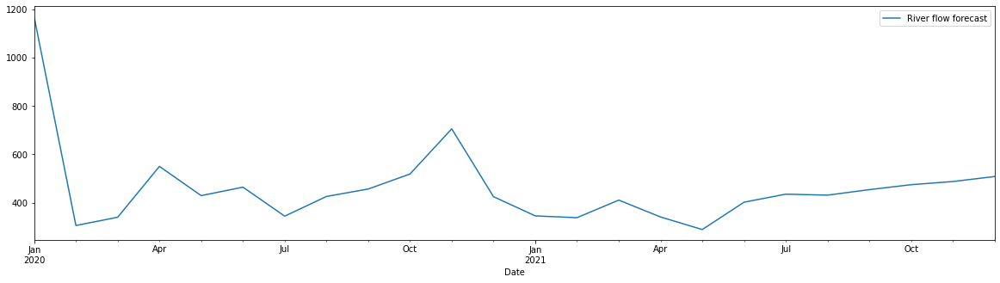


 ################ Basin 44 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


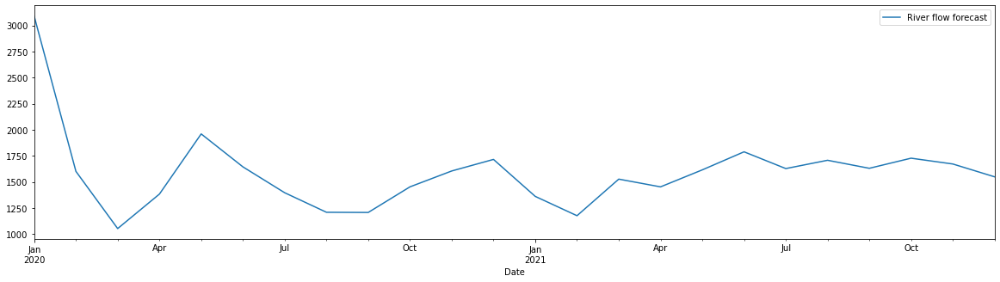


 ################ Basin 45 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


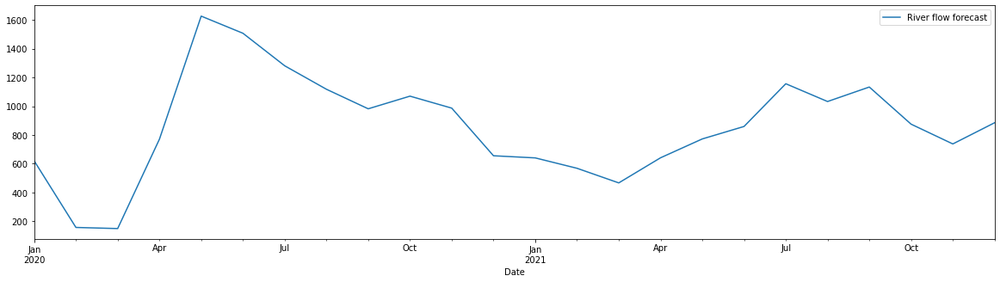


 ################ Basin 46 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


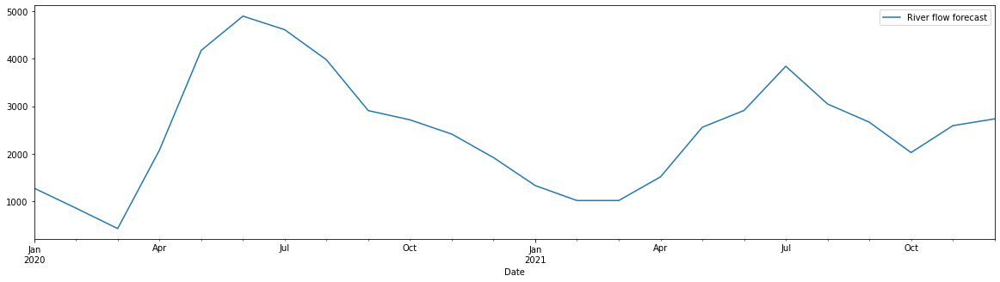


 ################ Basin 47 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


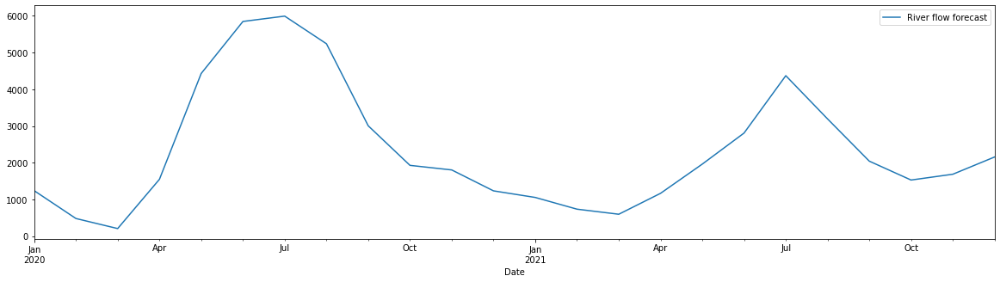


 ################ Basin 48 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


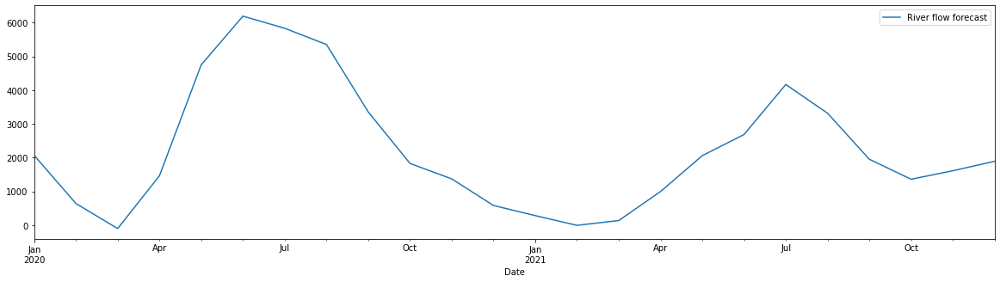

Def_50%
P_B2

 ################ Basin 1 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


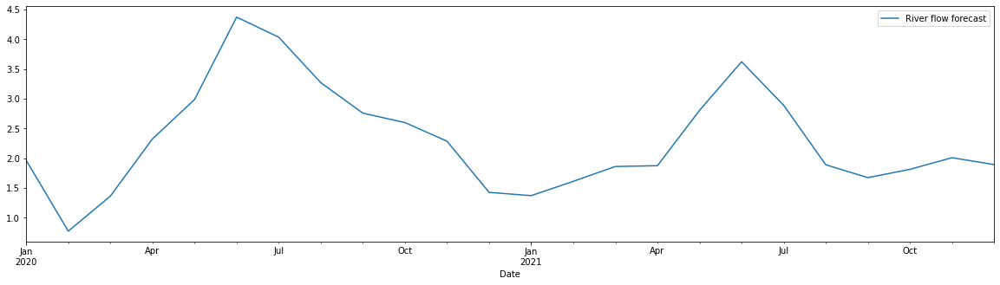


 ################ Basin 2 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


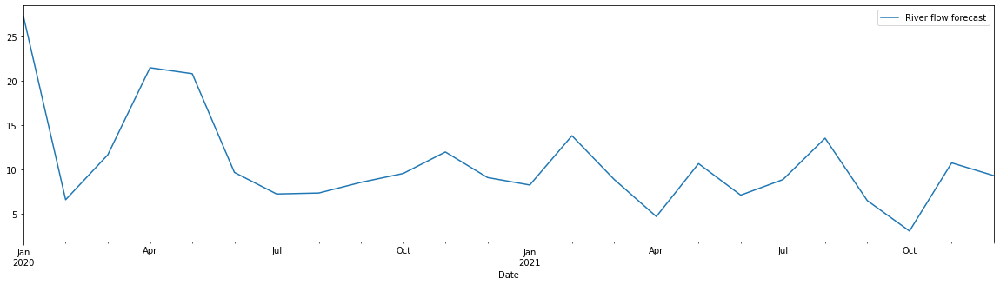


 ################ Basin 3 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


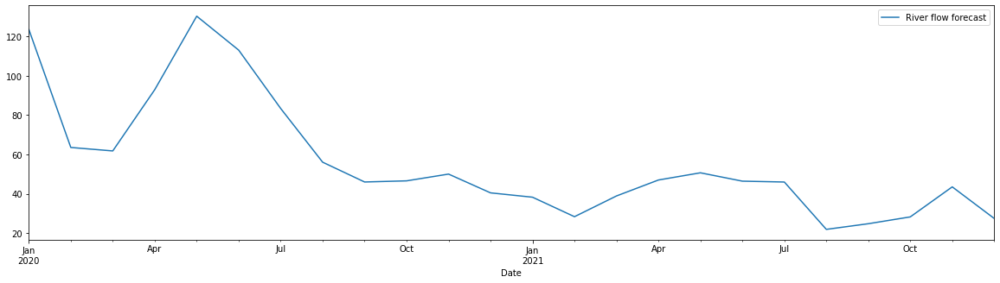


 ################ Basin 4 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


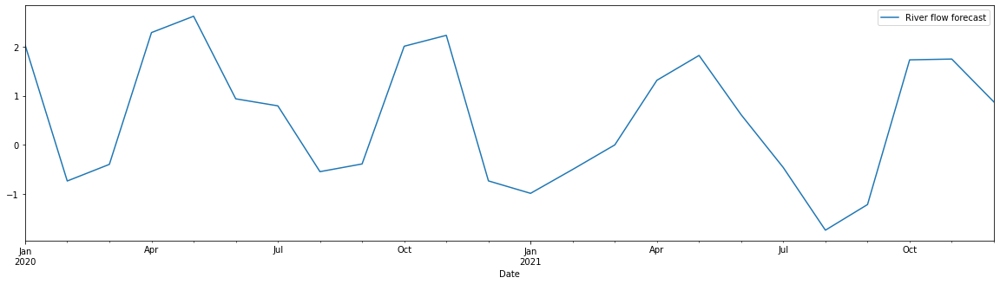


 ################ Basin 5 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


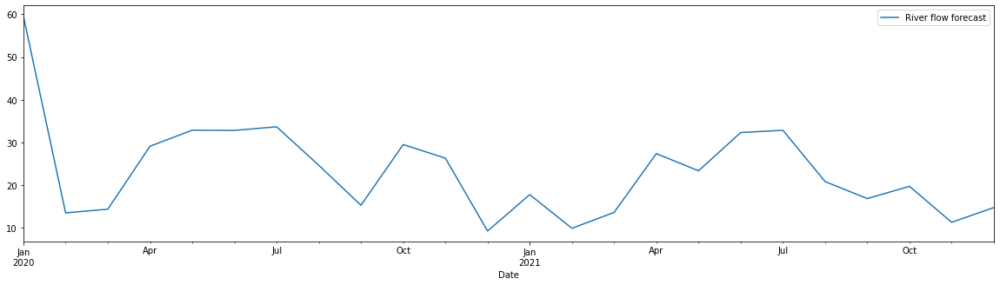


 ################ Basin 6 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


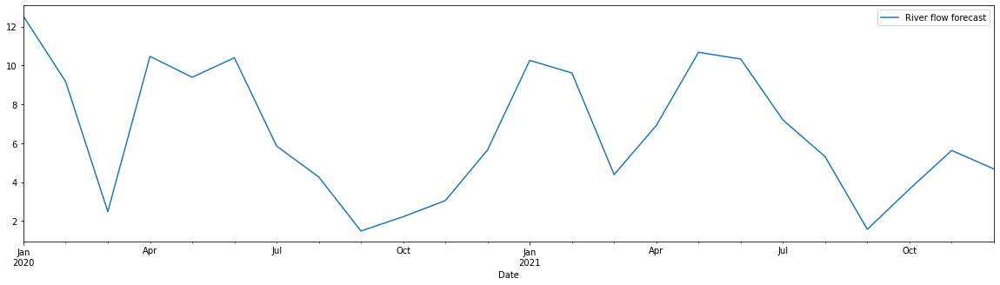


 ################ Basin 7 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


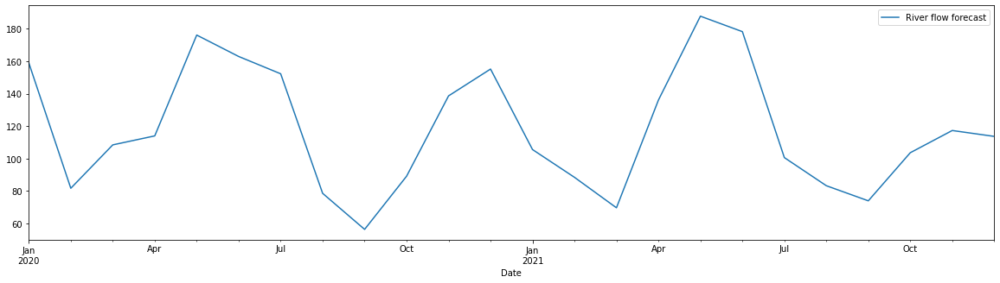


 ################ Basin 8 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


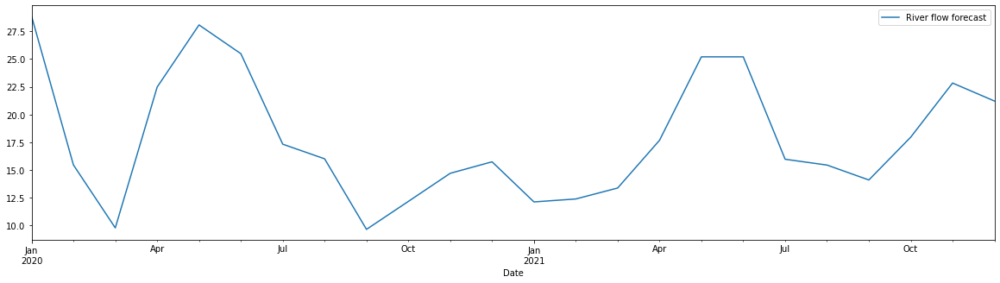


 ################ Basin 9 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


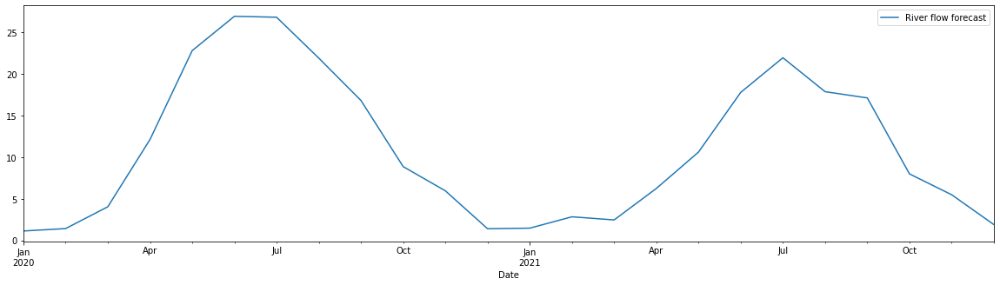


 ################ Basin 10 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


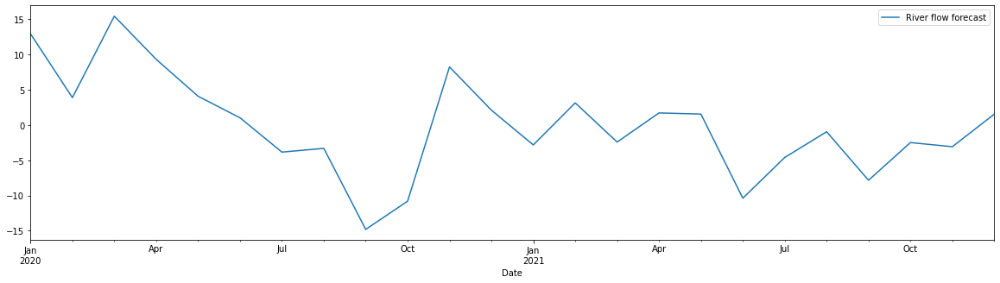


 ################ Basin 11 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


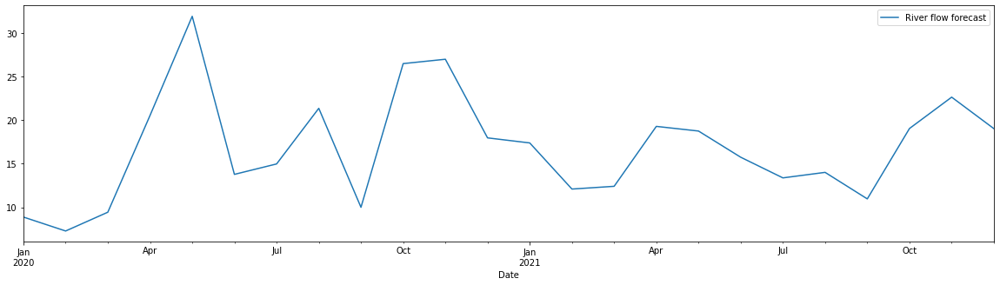


 ################ Basin 12 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


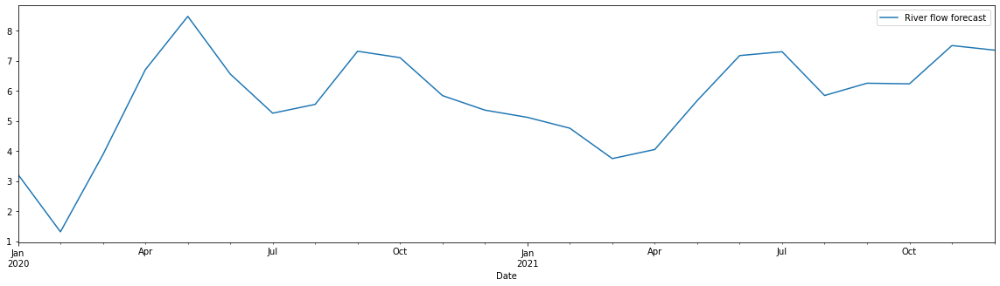


 ################ Basin 13 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


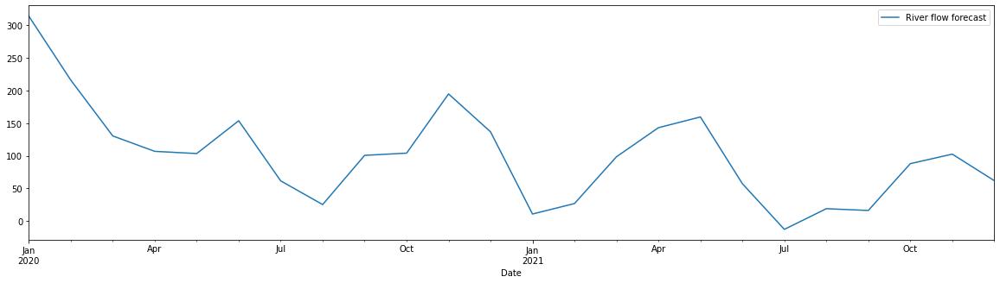


 ################ Basin 14 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


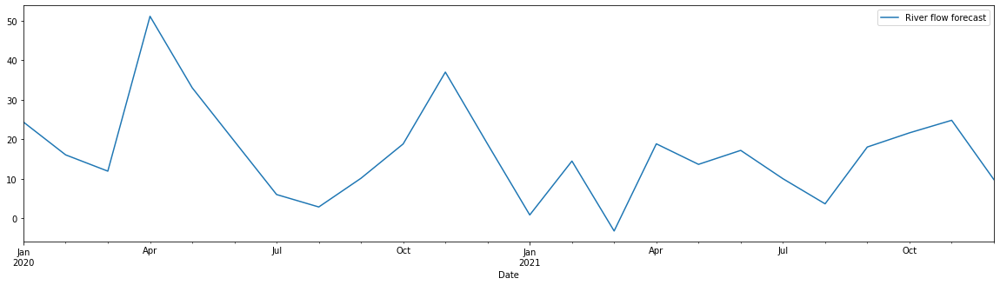


 ################ Basin 15 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


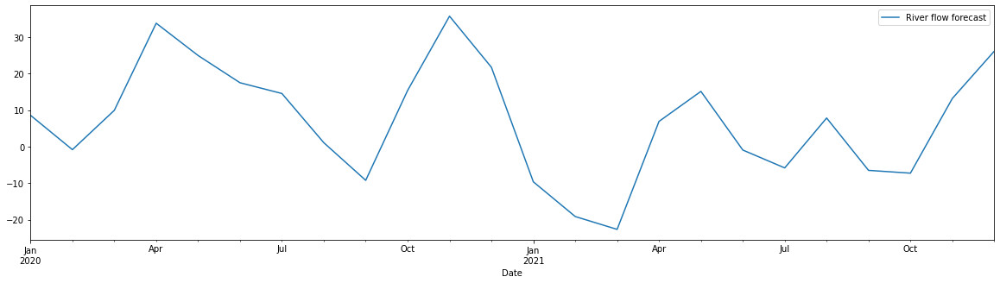


 ################ Basin 16 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


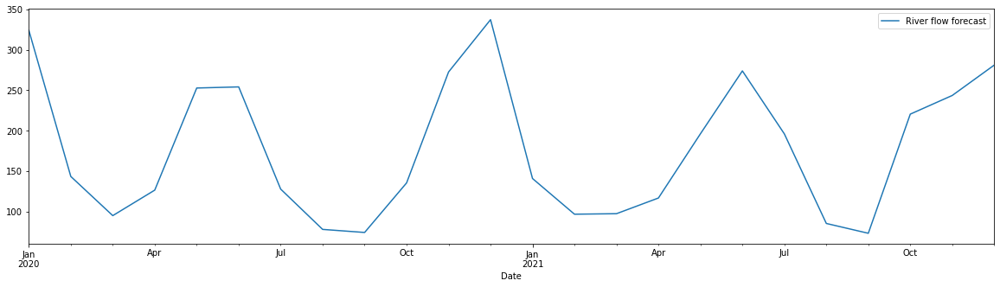


 ################ Basin 17 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


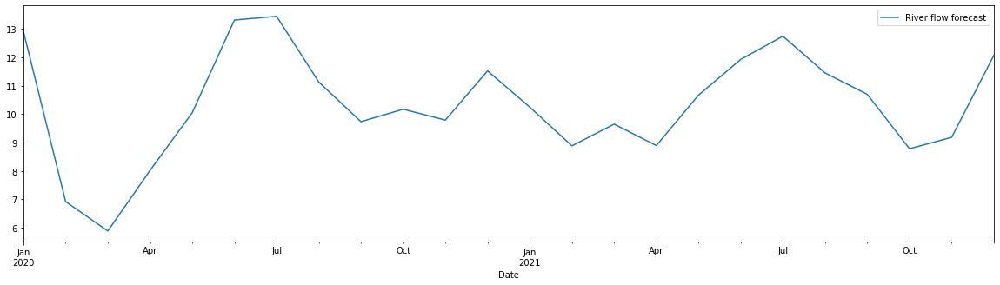


 ################ Basin 18 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


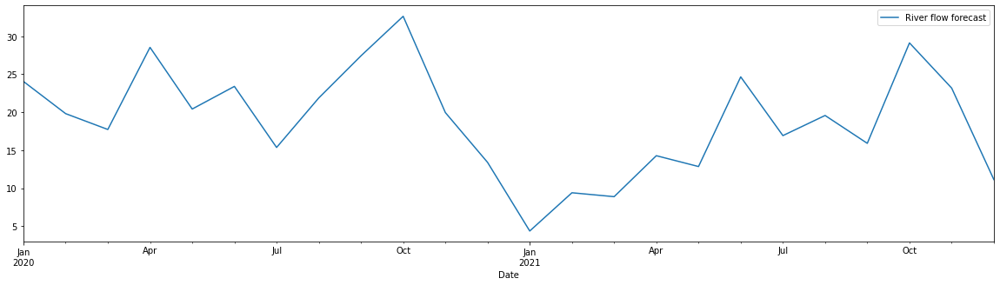


 ################ Basin 19 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


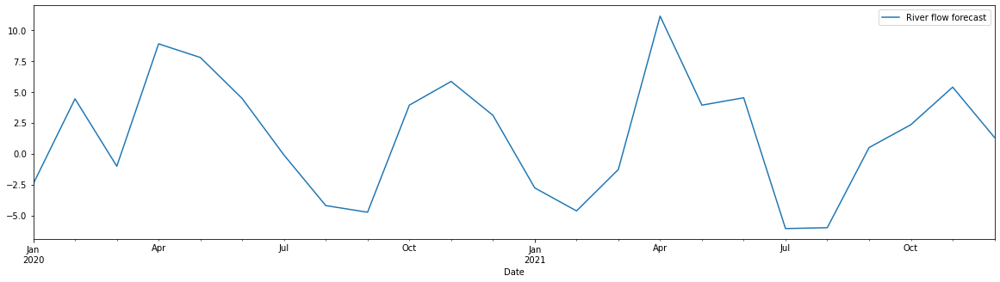


 ################ Basin 20 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


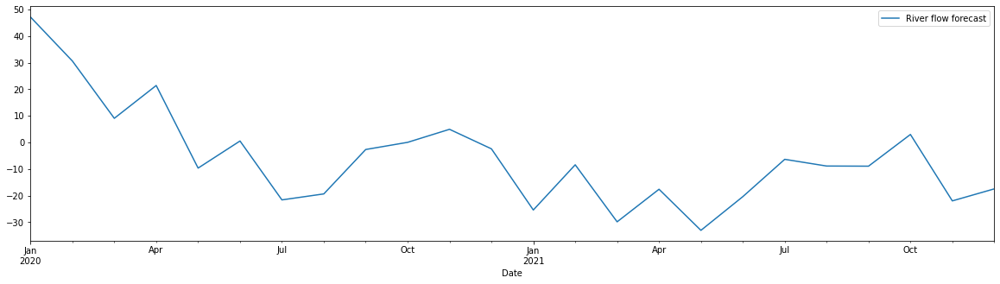


 ################ Basin 21 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


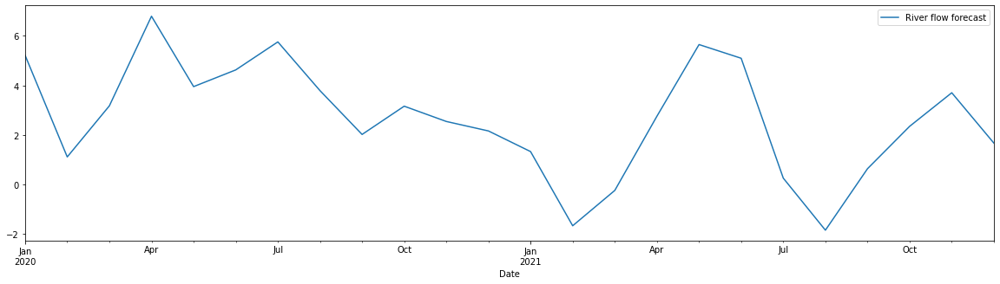


 ################ Basin 22 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


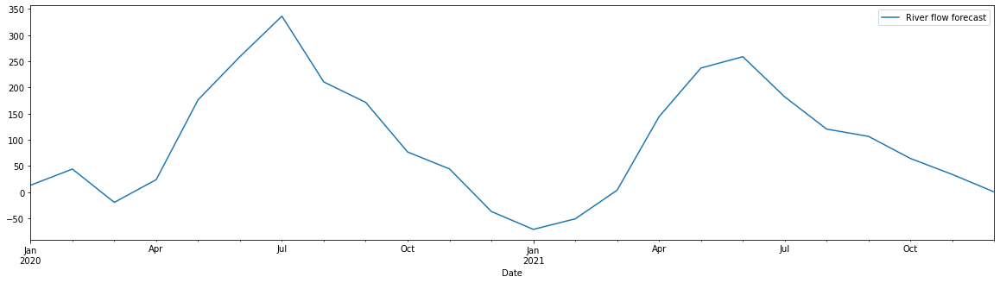


 ################ Basin 23 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


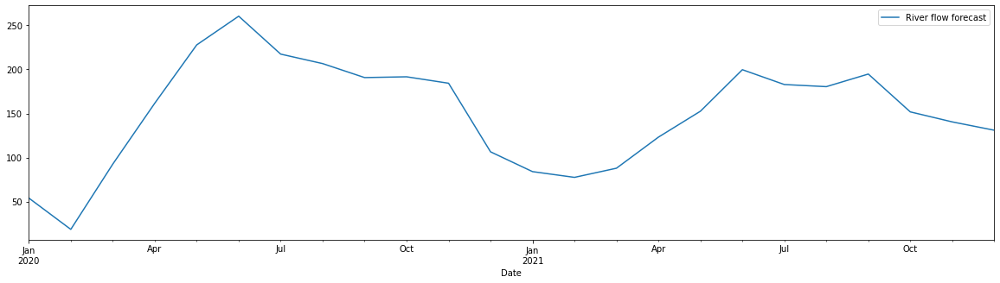


 ################ Basin 24 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


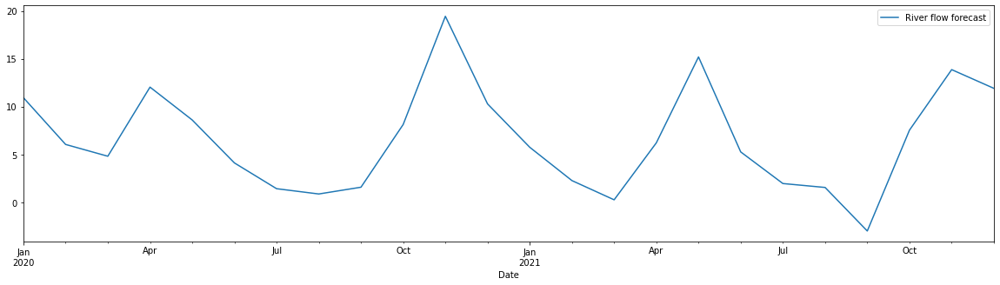


 ################ Basin 25 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


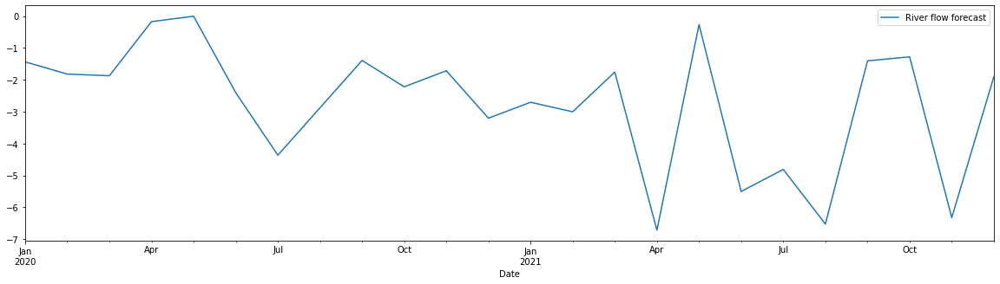


 ################ Basin 26 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


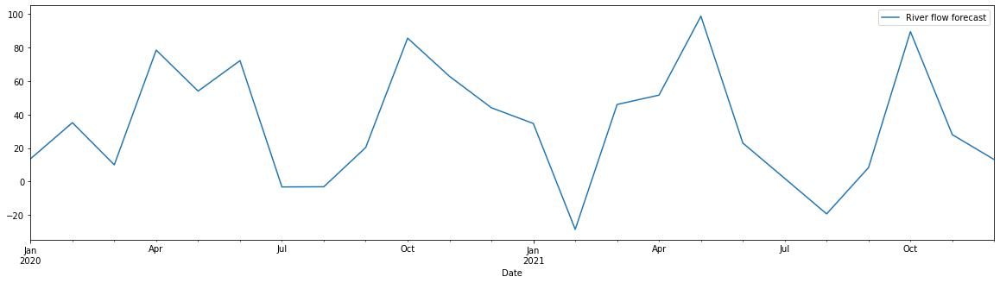


 ################ Basin 27 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


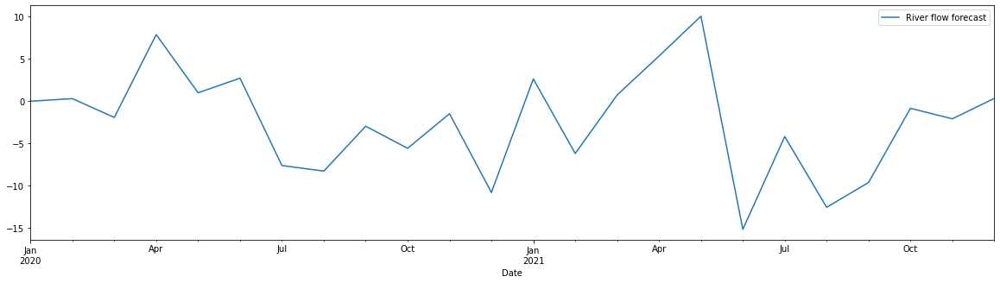


 ################ Basin 28 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


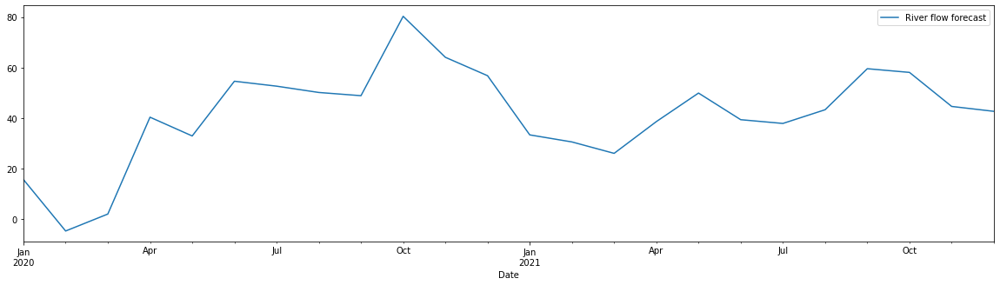


 ################ Basin 29 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


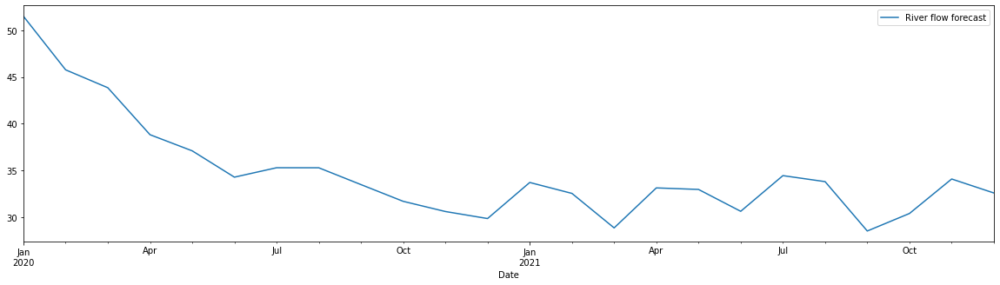


 ################ Basin 30 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


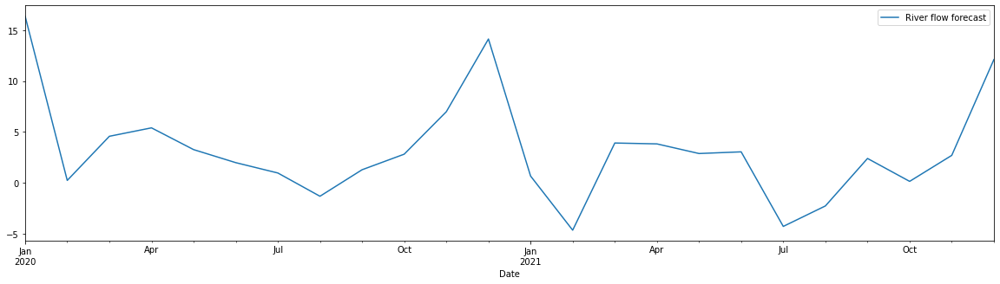


 ################ Basin 31 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


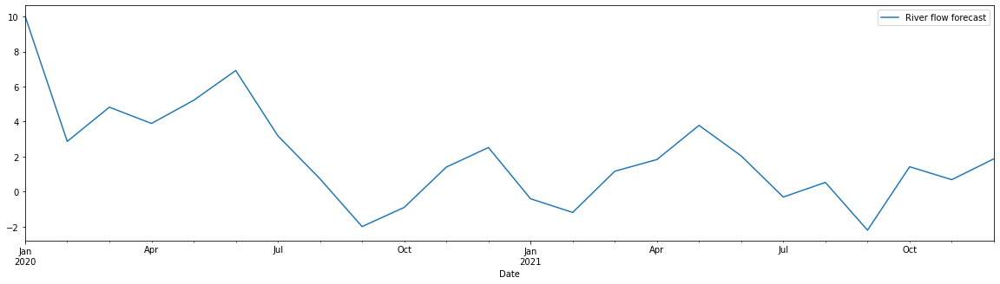


 ################ Basin 32 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


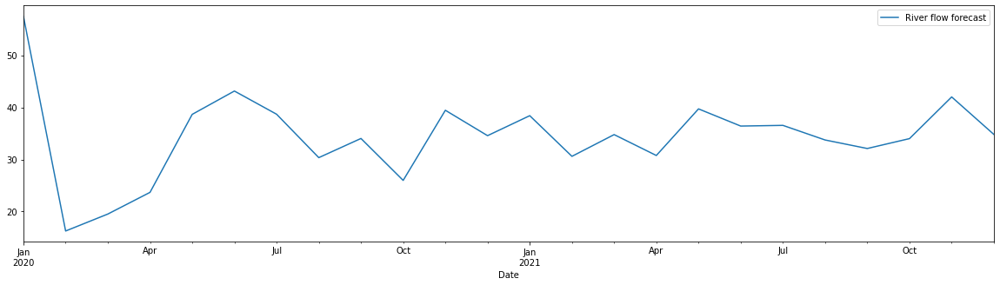


 ################ Basin 33 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


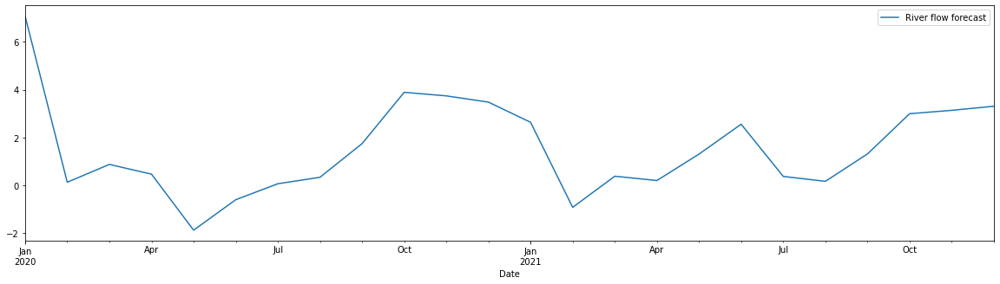


 ################ Basin 34 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


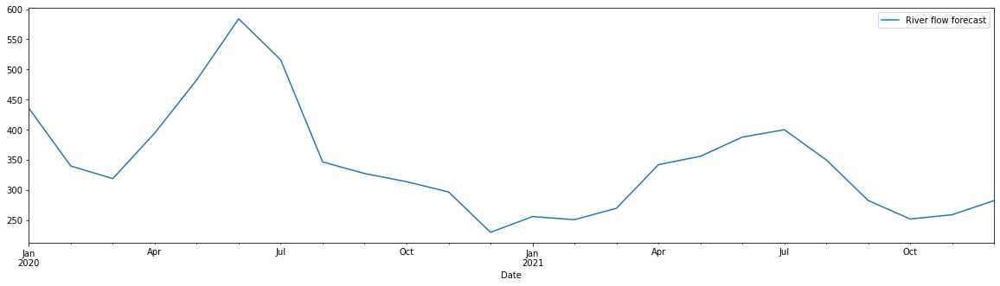


 ################ Basin 35 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


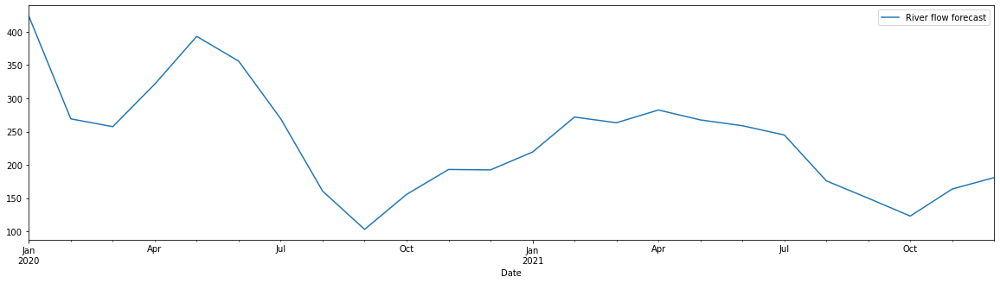


 ################ Basin 36 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


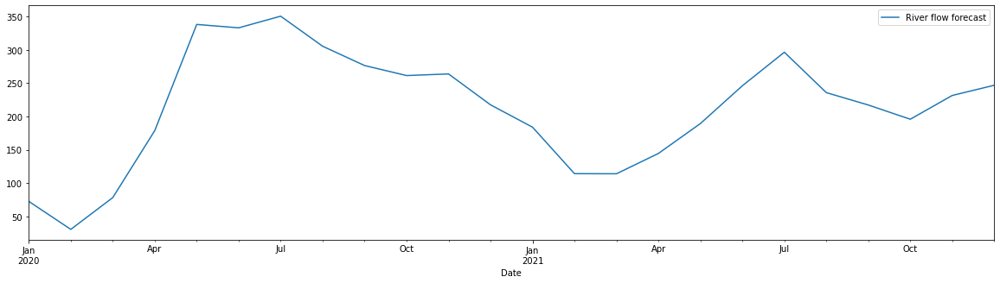


 ################ Basin 37 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


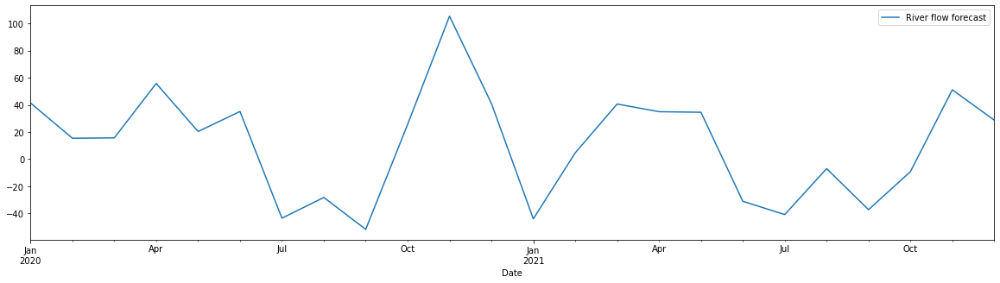


 ################ Basin 38 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


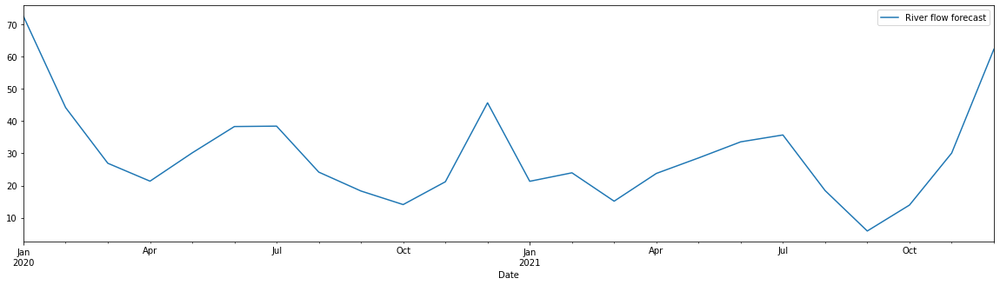


 ################ Basin 39 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


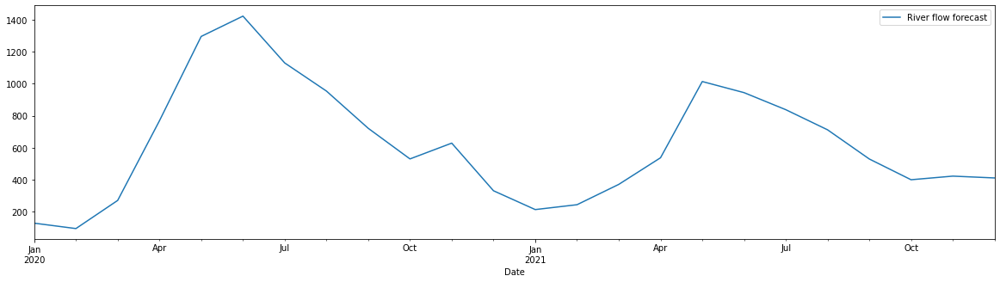


 ################ Basin 40 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


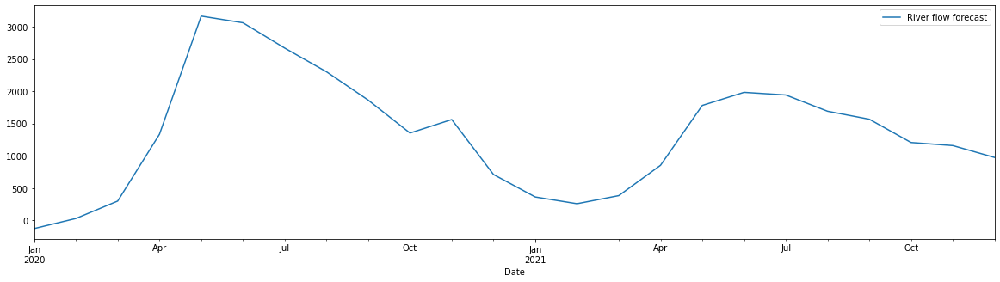


 ################ Basin 41 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


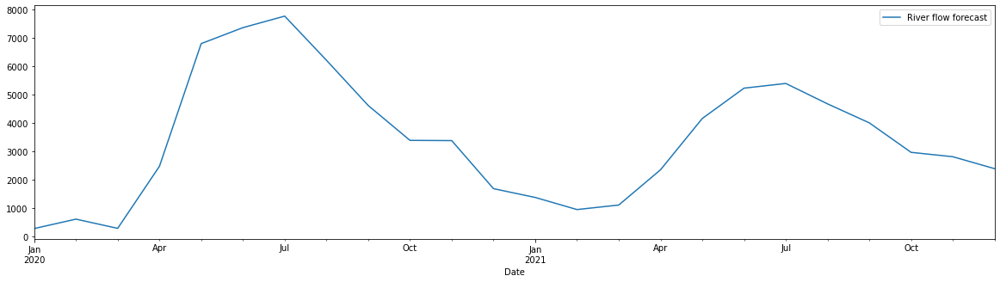


 ################ Basin 42 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


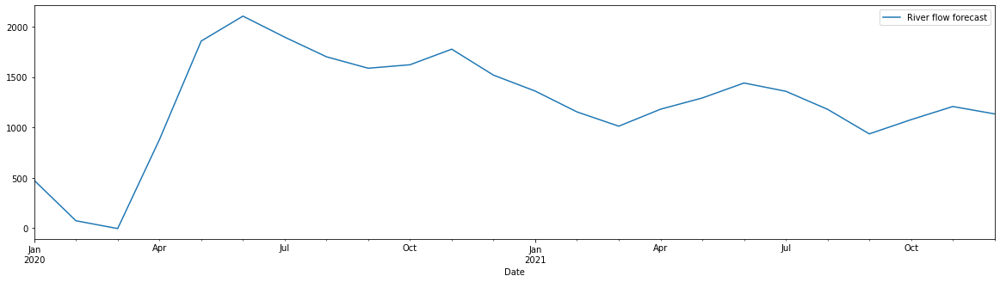


 ################ Basin 43 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


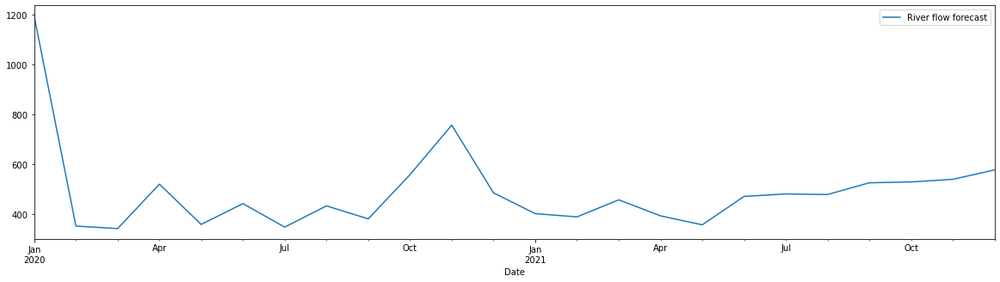


 ################ Basin 44 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


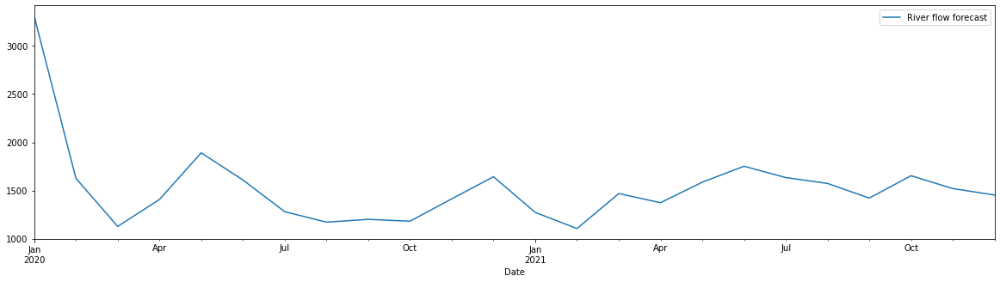


 ################ Basin 45 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


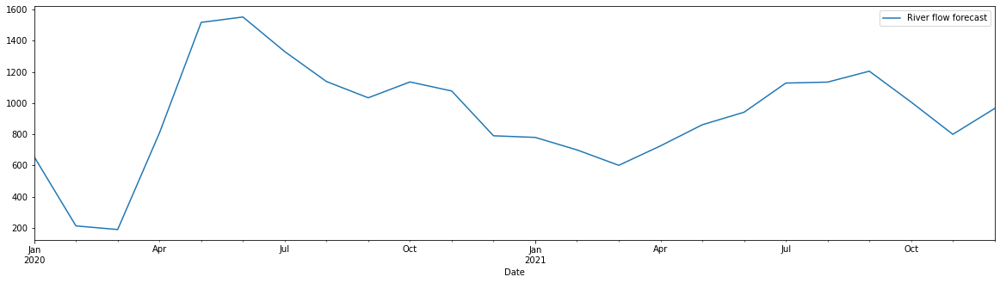


 ################ Basin 46 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


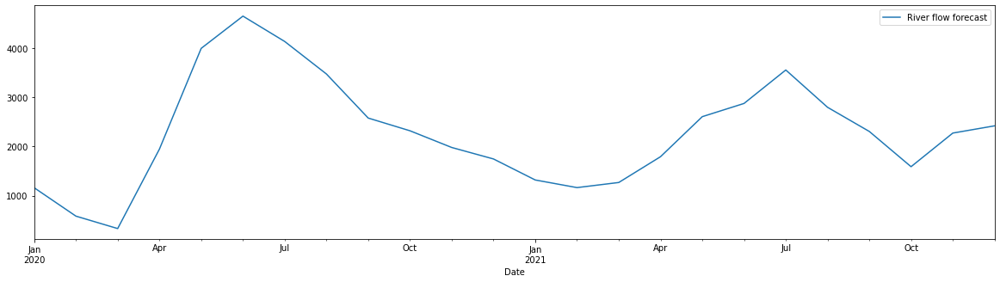


 ################ Basin 47 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


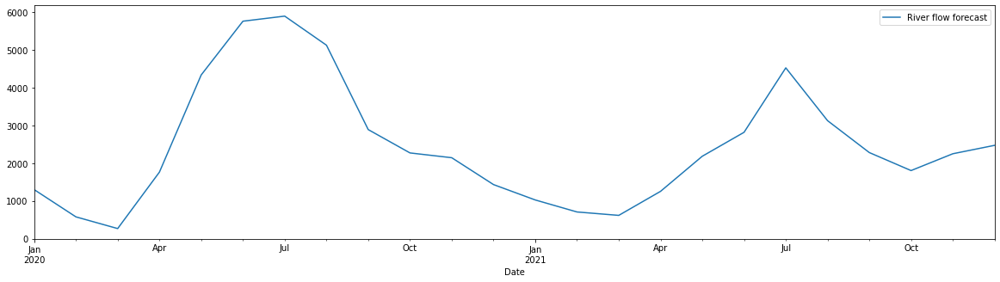


 ################ Basin 48 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


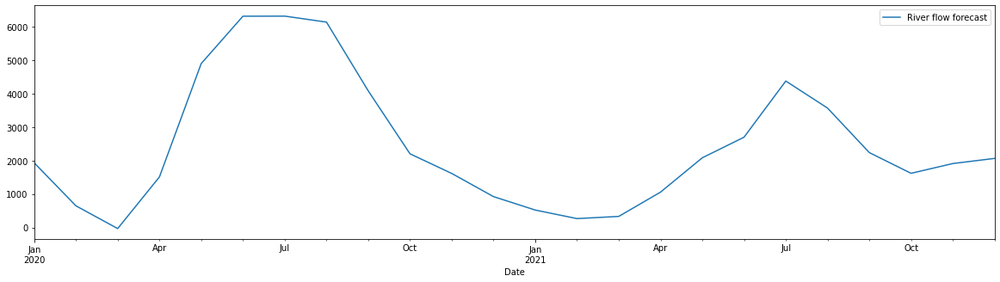

Def_75%
P_A1

 ################ Basin 1 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


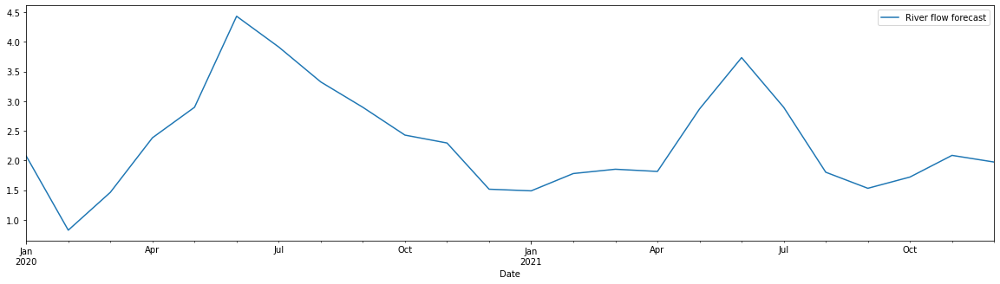


 ################ Basin 2 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


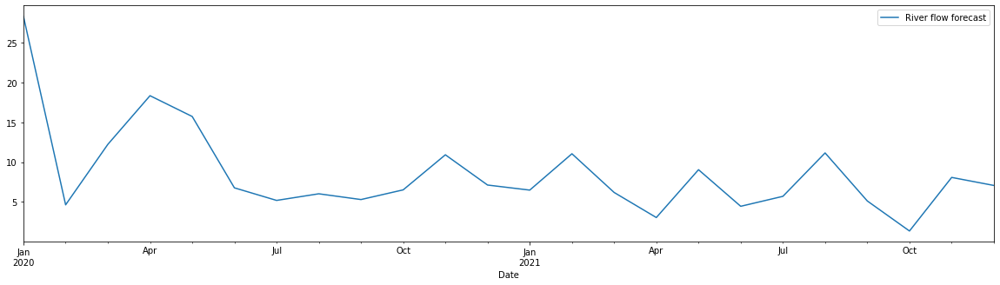


 ################ Basin 3 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


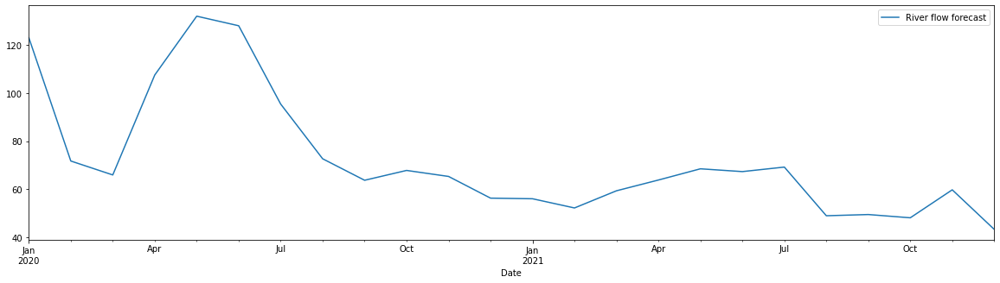


 ################ Basin 4 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


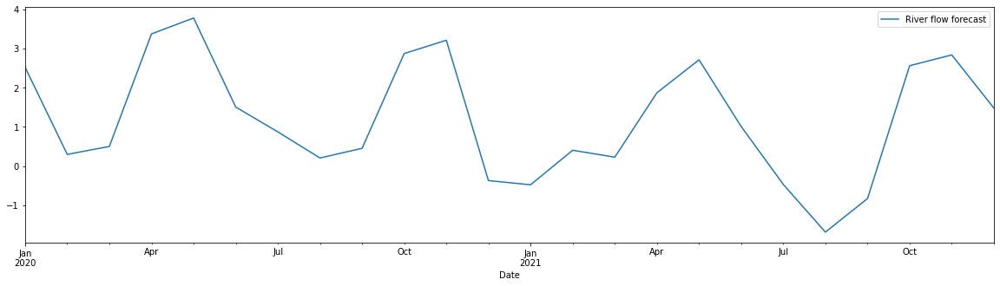


 ################ Basin 5 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


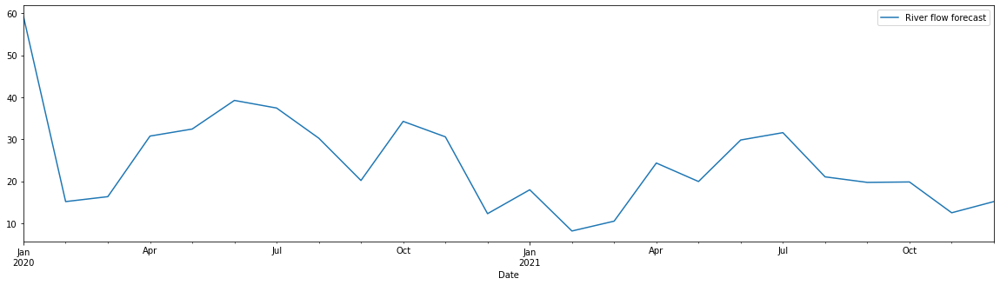


 ################ Basin 6 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


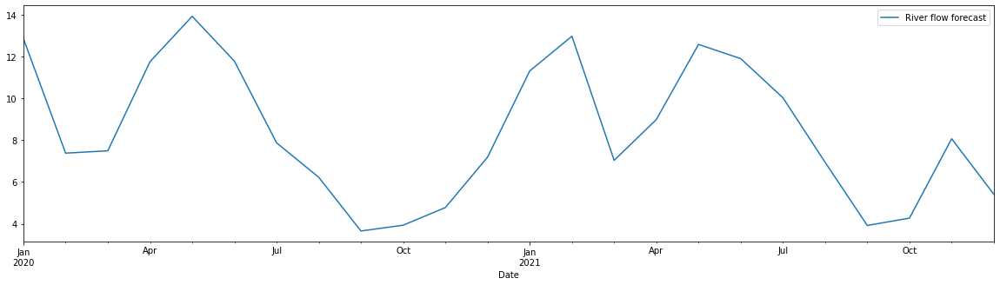


 ################ Basin 7 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


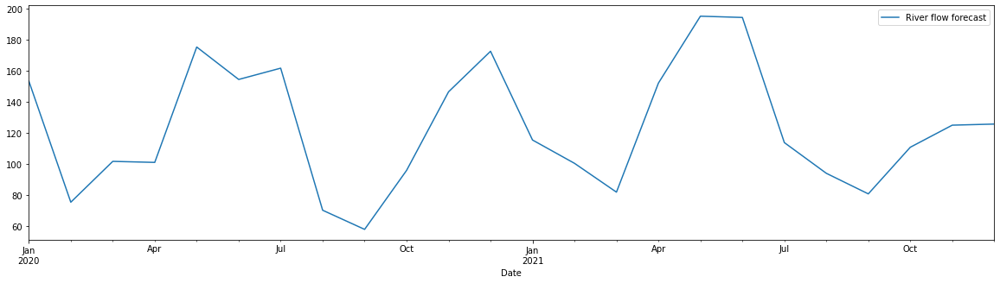


 ################ Basin 8 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


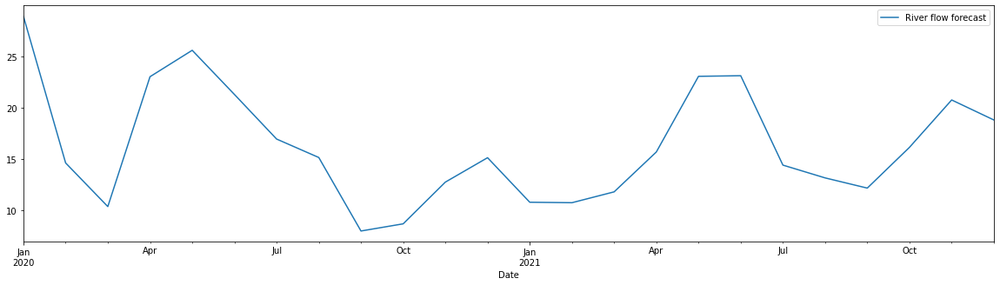


 ################ Basin 9 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


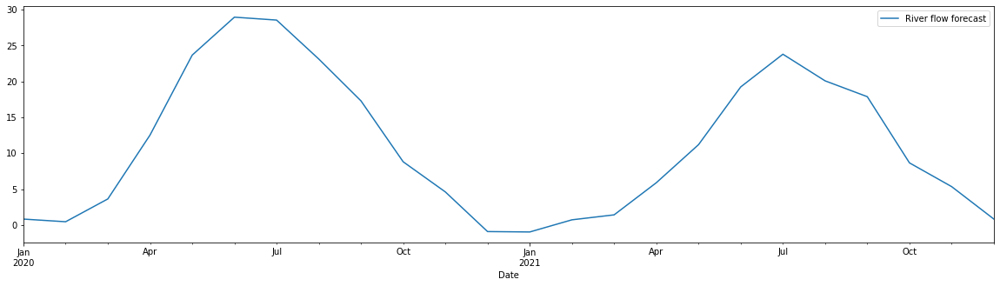


 ################ Basin 10 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


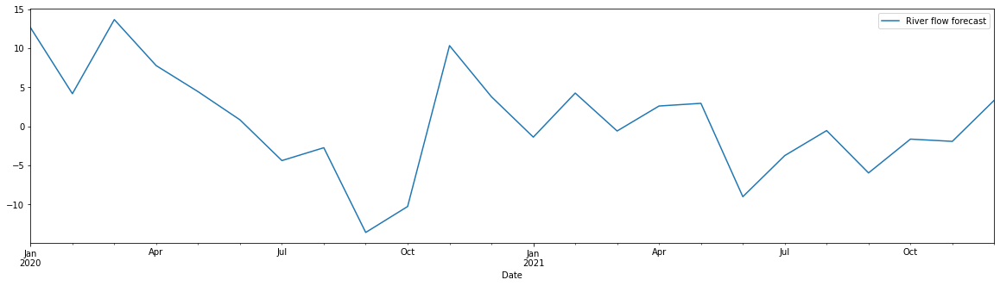


 ################ Basin 11 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


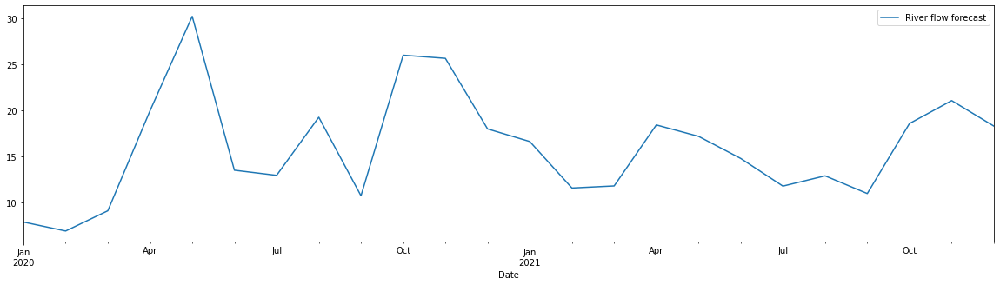


 ################ Basin 12 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


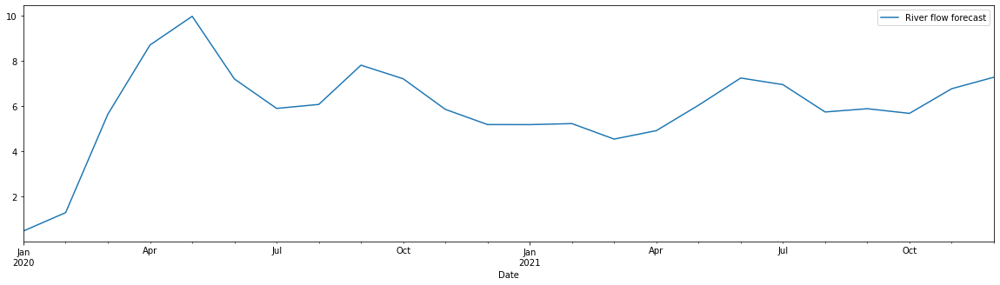


 ################ Basin 13 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


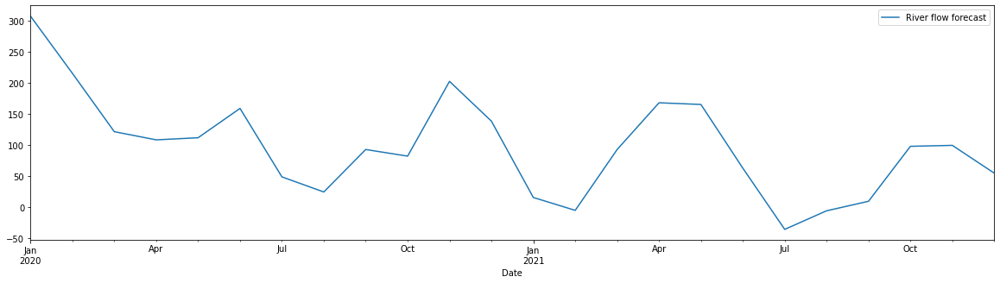


 ################ Basin 14 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


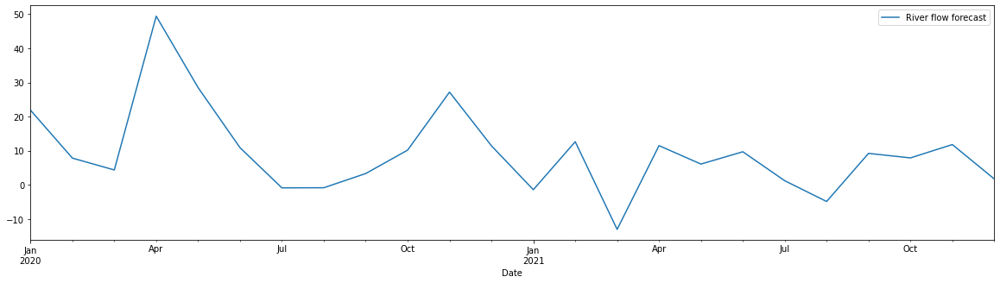


 ################ Basin 15 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


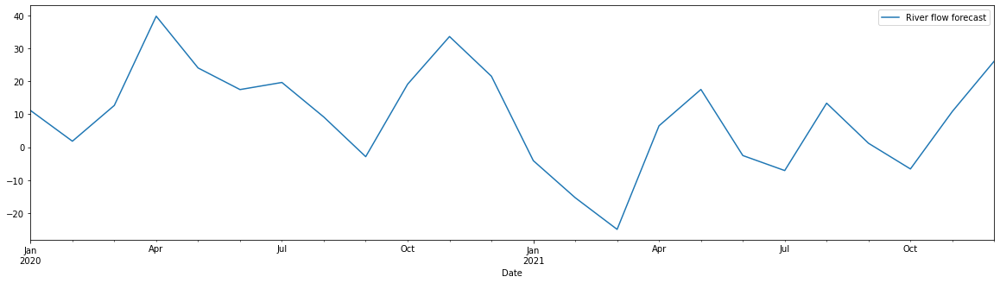


 ################ Basin 16 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


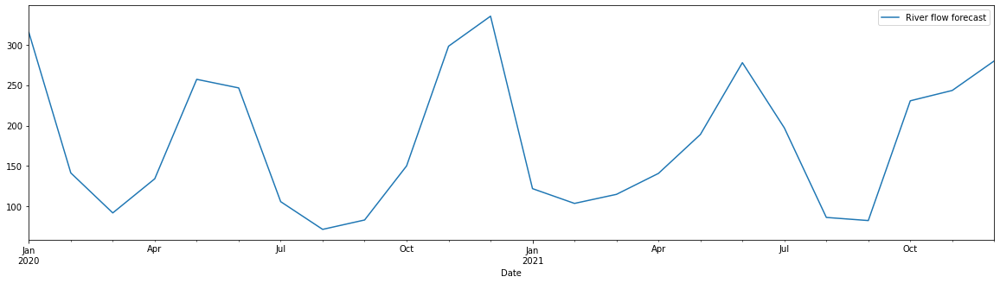


 ################ Basin 17 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


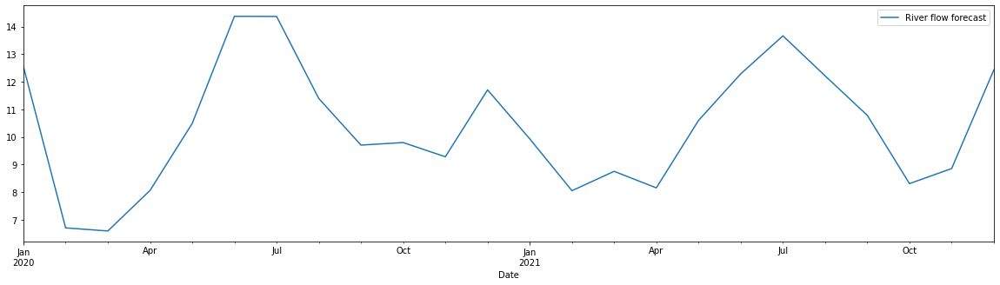


 ################ Basin 18 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


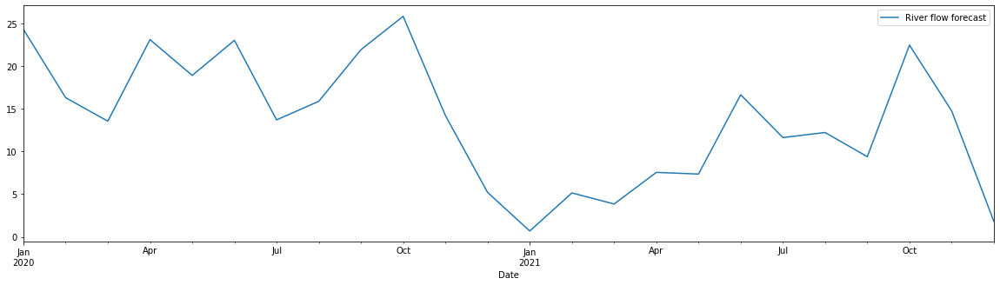


 ################ Basin 19 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


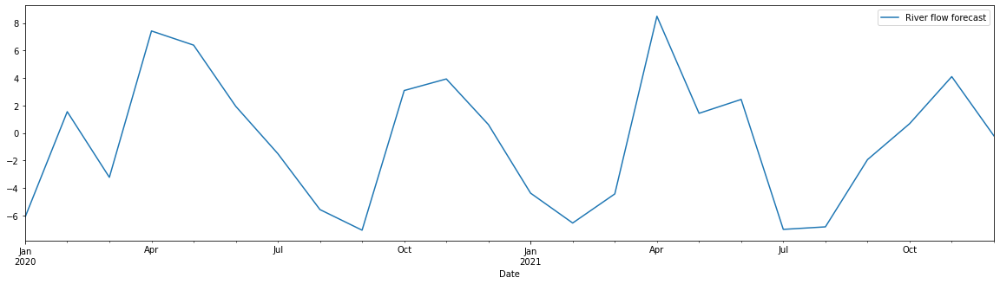


 ################ Basin 20 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


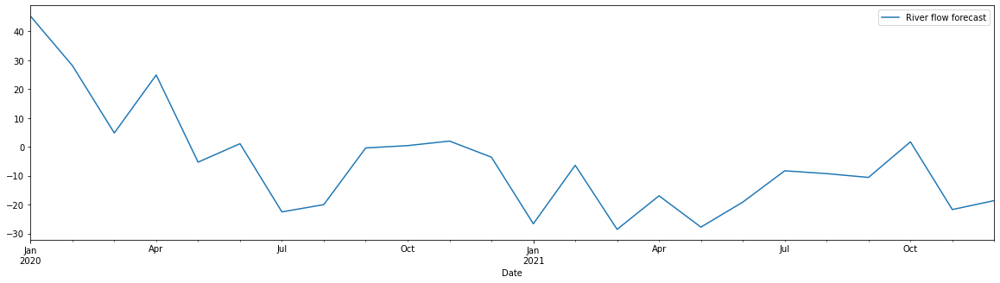


 ################ Basin 21 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


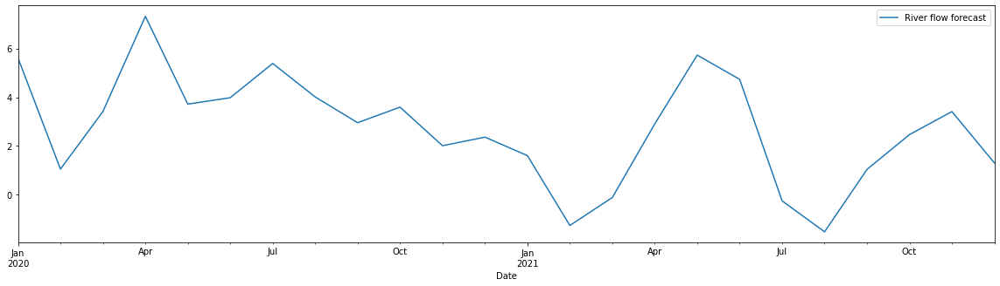


 ################ Basin 22 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


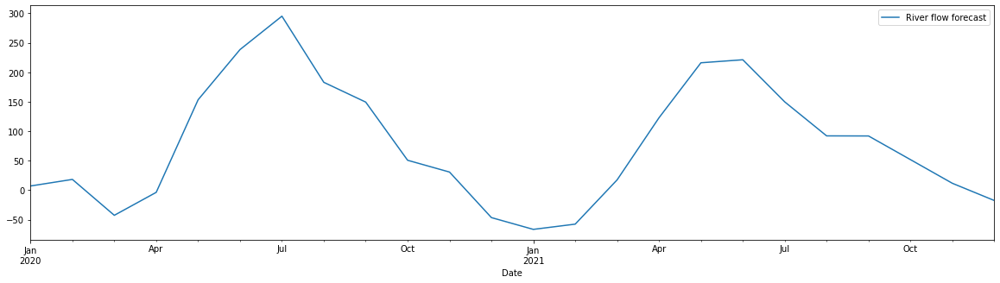


 ################ Basin 23 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


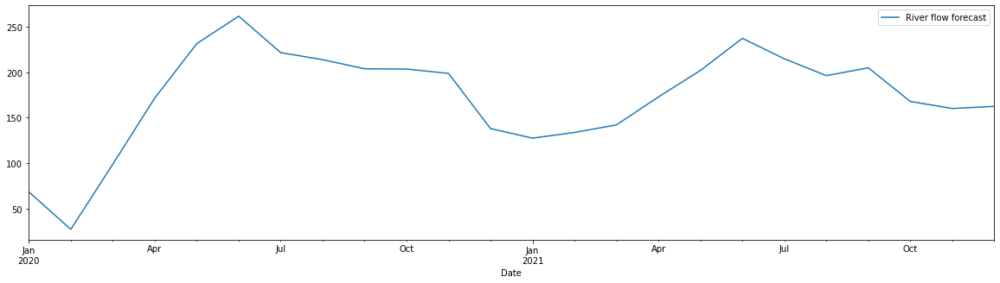


 ################ Basin 24 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


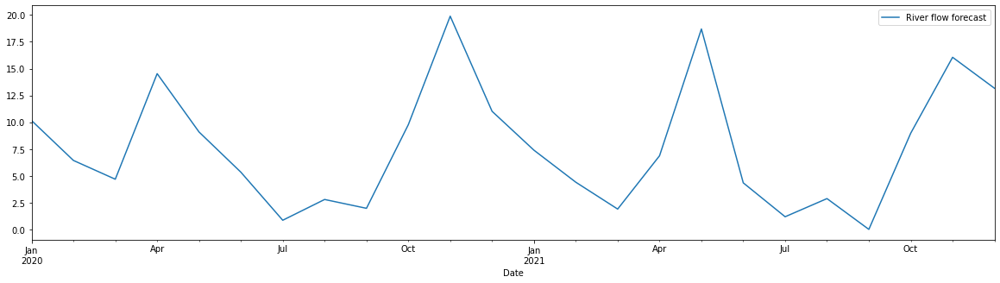


 ################ Basin 25 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


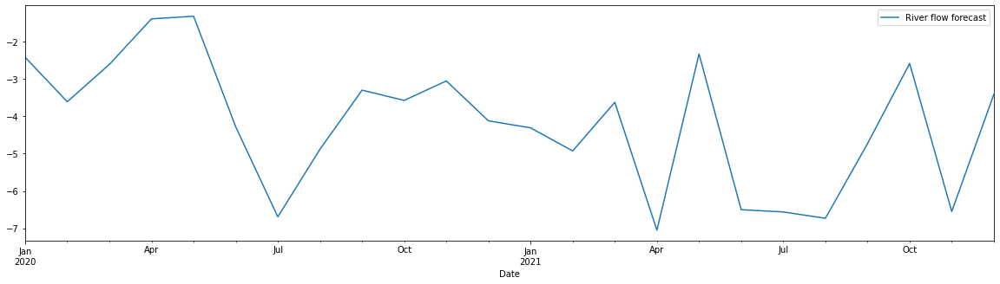


 ################ Basin 26 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


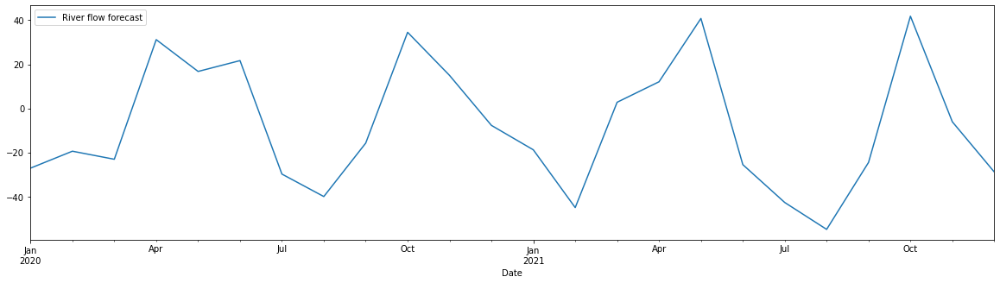


 ################ Basin 27 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


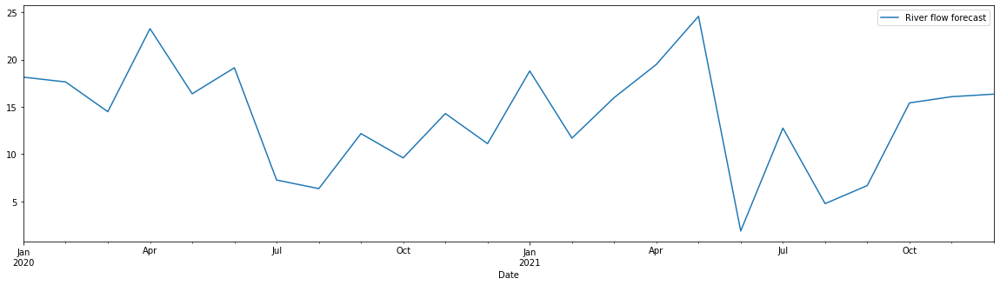


 ################ Basin 28 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


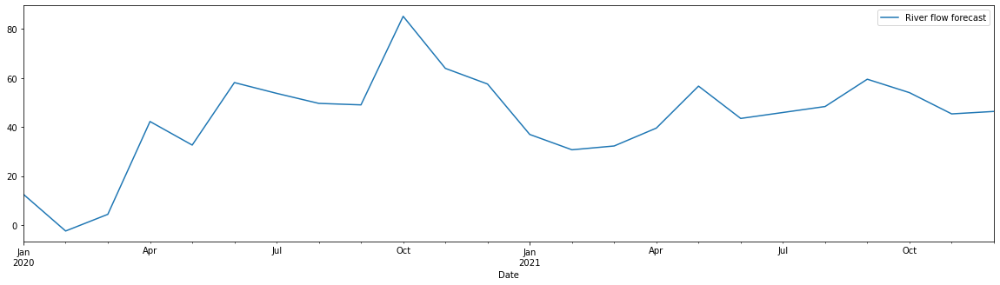


 ################ Basin 29 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


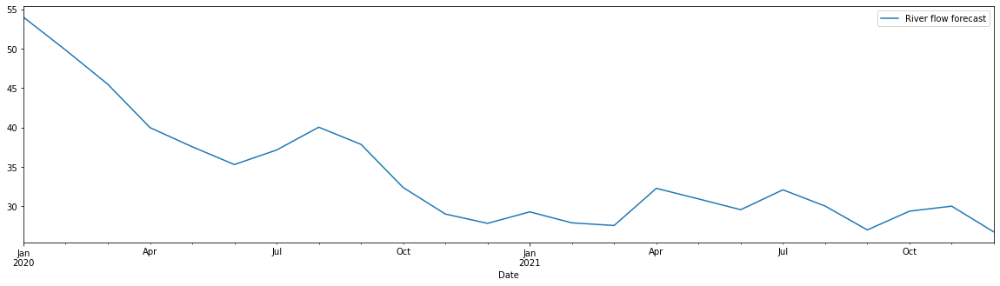


 ################ Basin 30 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


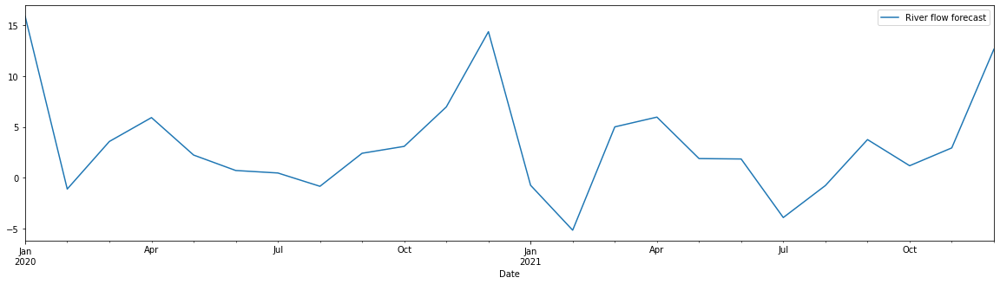


 ################ Basin 31 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


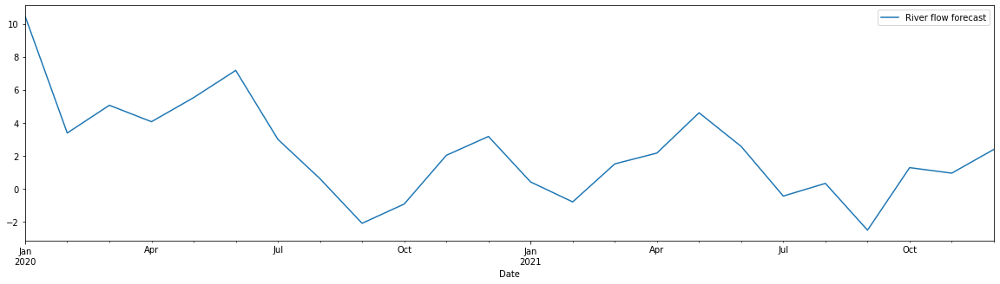


 ################ Basin 32 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


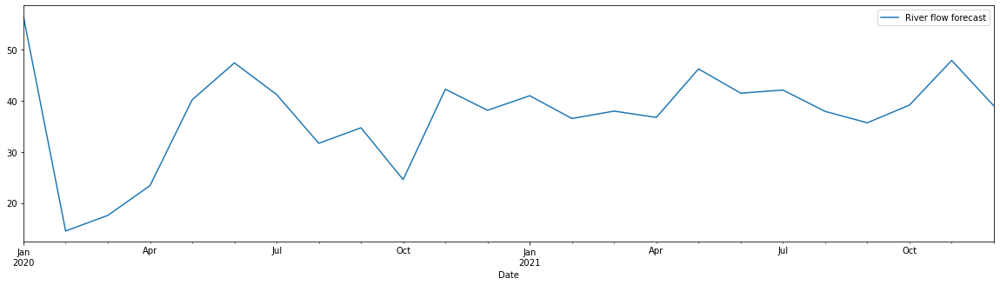


 ################ Basin 33 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


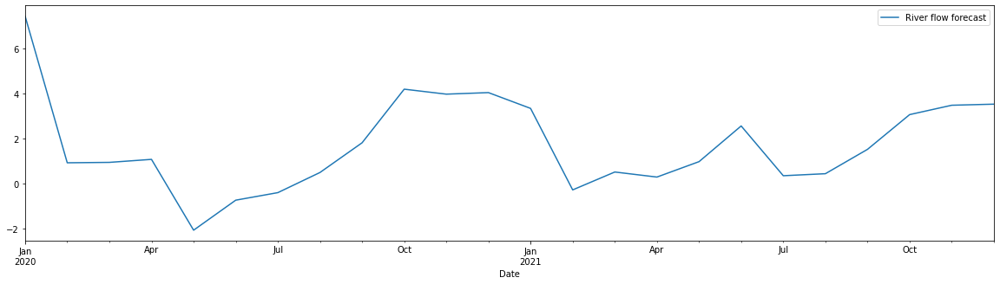


 ################ Basin 34 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


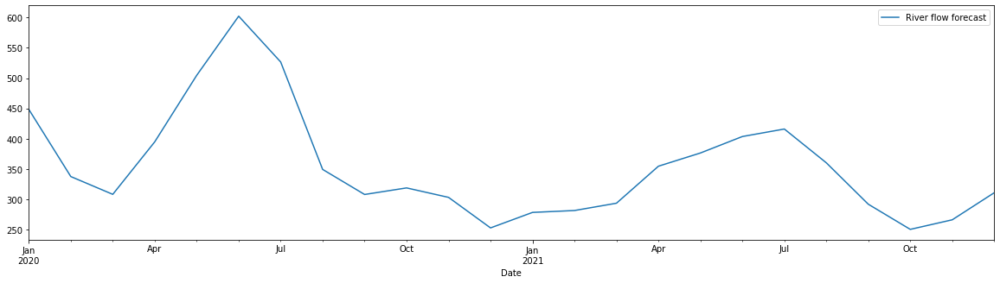


 ################ Basin 35 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


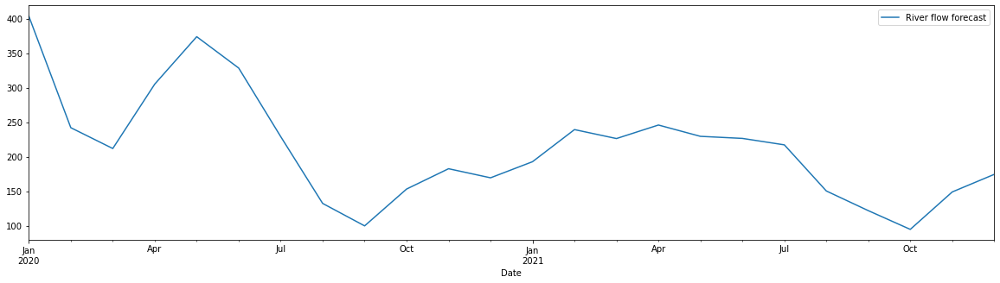


 ################ Basin 36 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


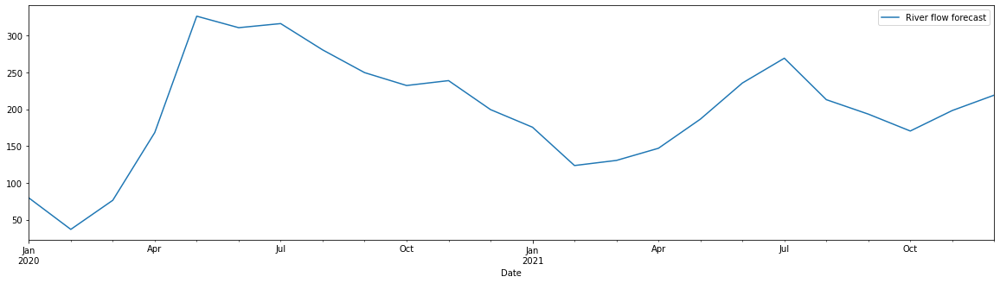


 ################ Basin 37 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


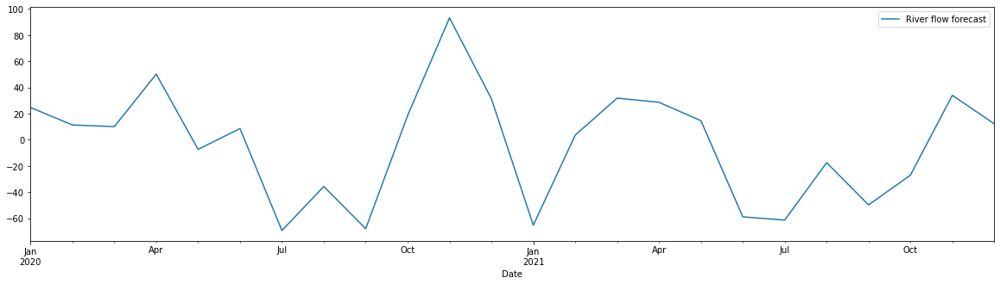


 ################ Basin 38 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


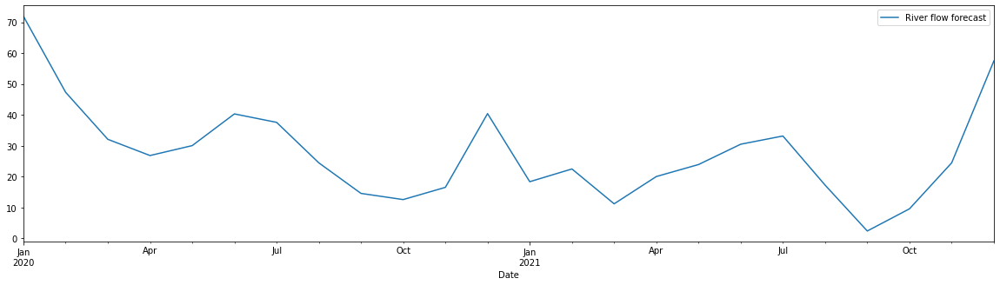


 ################ Basin 39 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


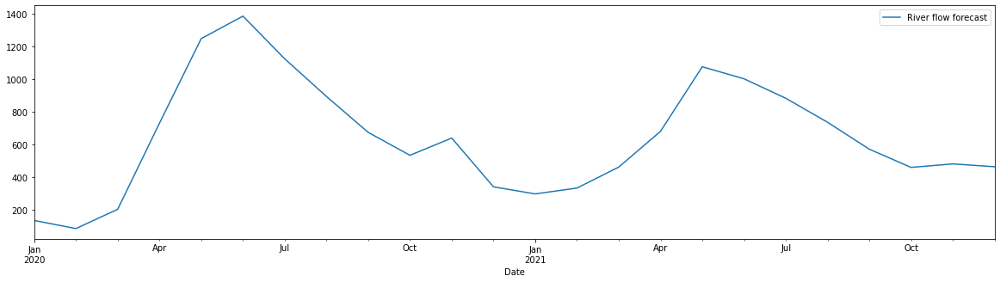


 ################ Basin 40 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


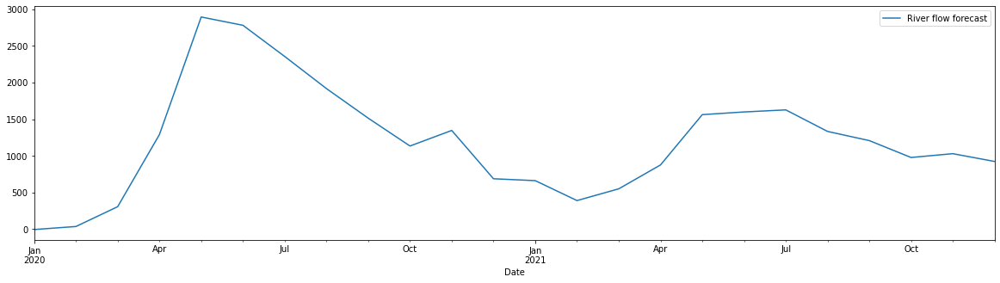


 ################ Basin 41 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


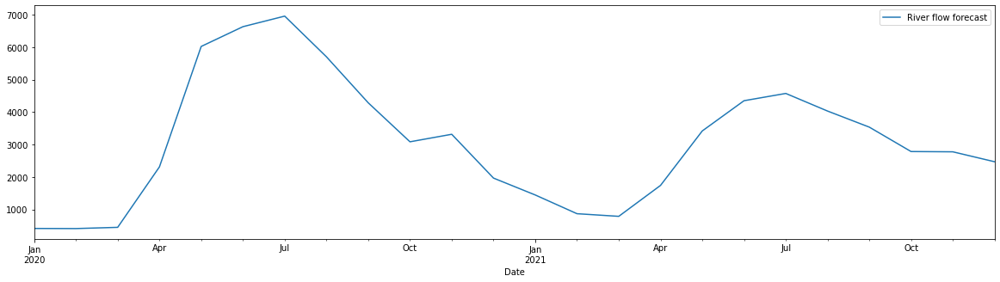


 ################ Basin 42 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


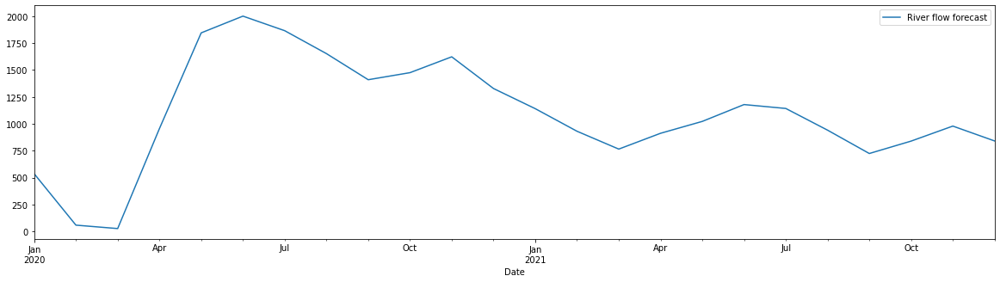


 ################ Basin 43 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


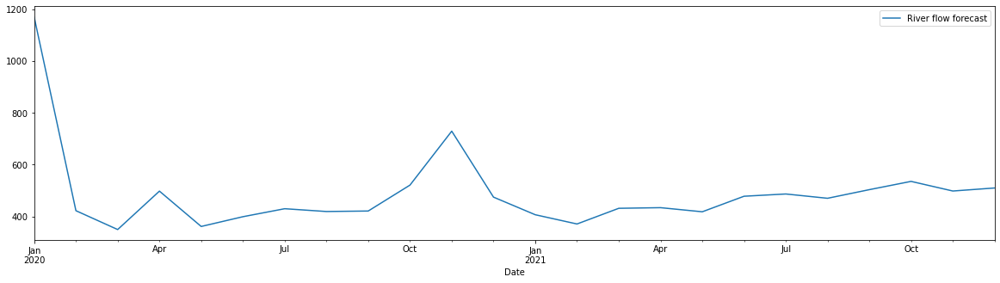


 ################ Basin 44 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


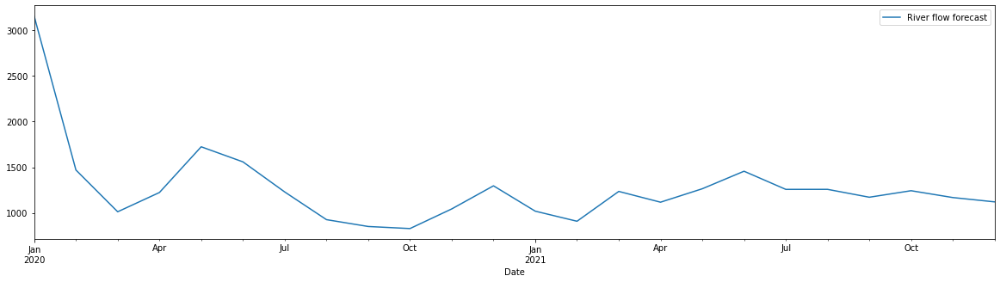


 ################ Basin 45 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


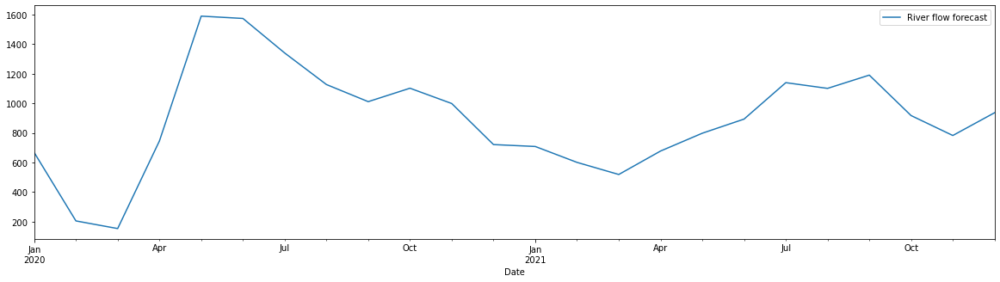


 ################ Basin 46 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


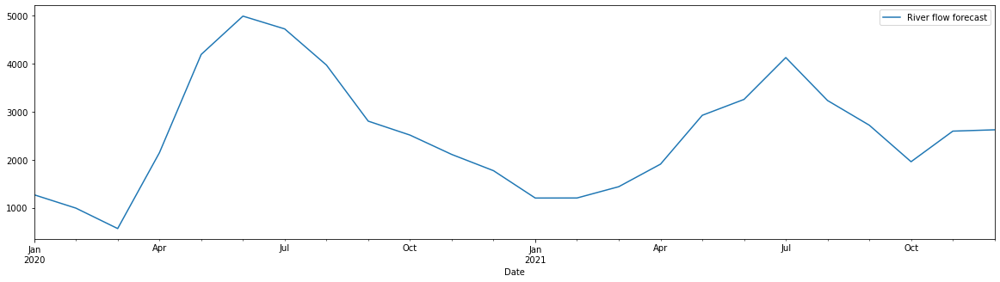


 ################ Basin 47 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


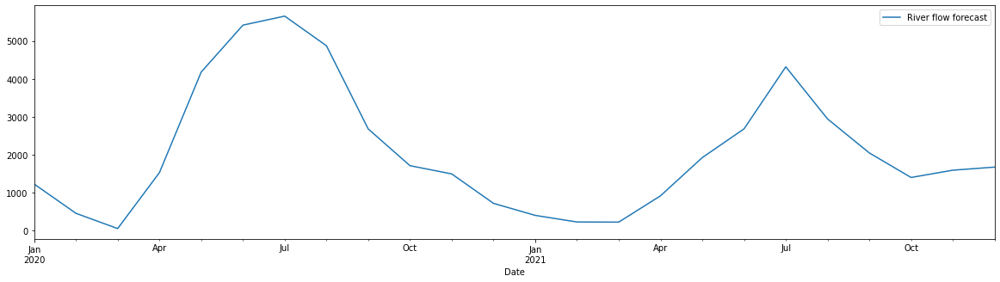


 ################ Basin 48 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


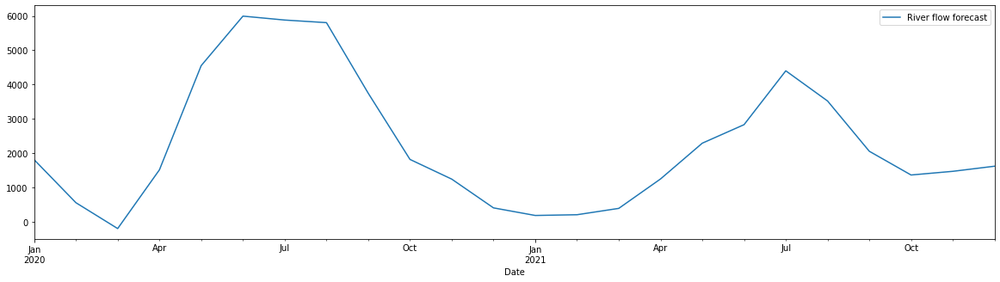

Def_75%
P_A2

 ################ Basin 1 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


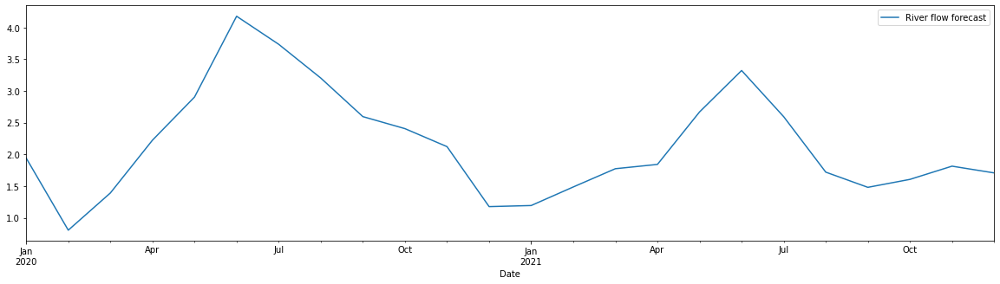


 ################ Basin 2 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


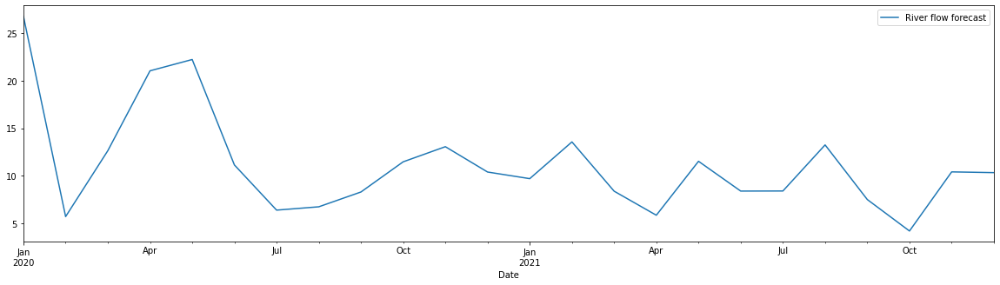


 ################ Basin 3 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


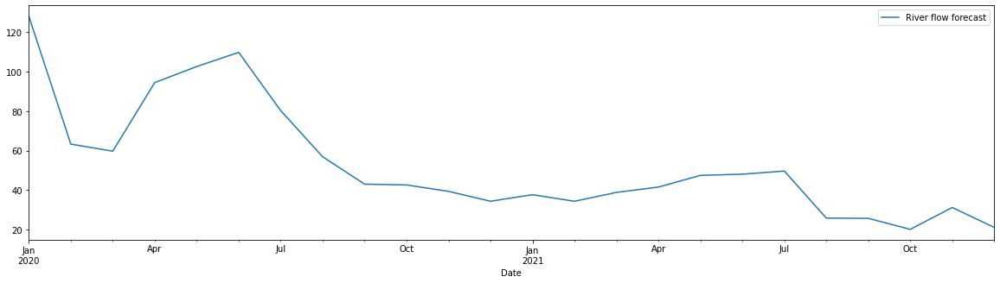


 ################ Basin 4 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


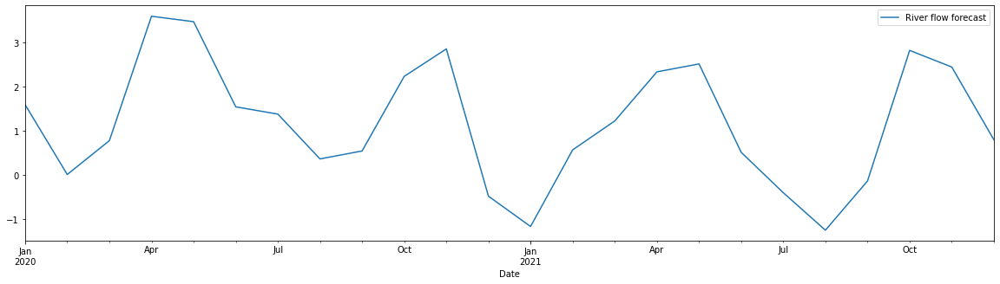


 ################ Basin 5 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


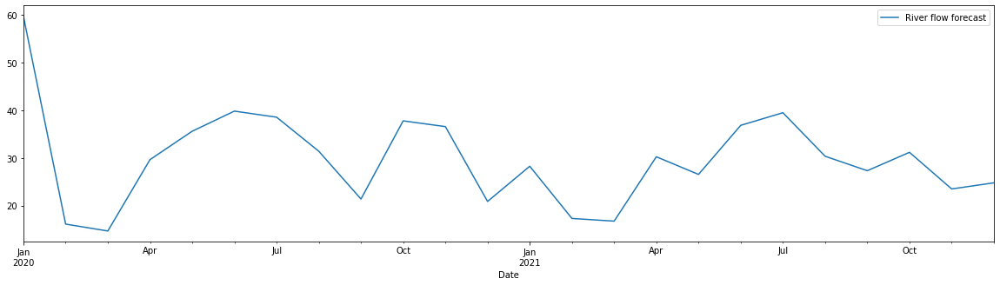


 ################ Basin 6 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


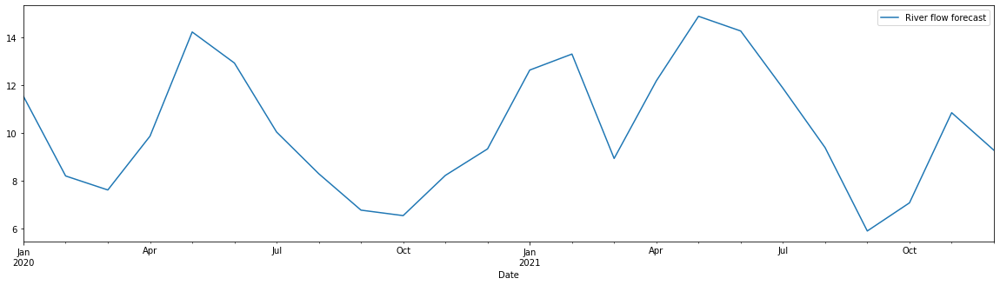


 ################ Basin 7 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


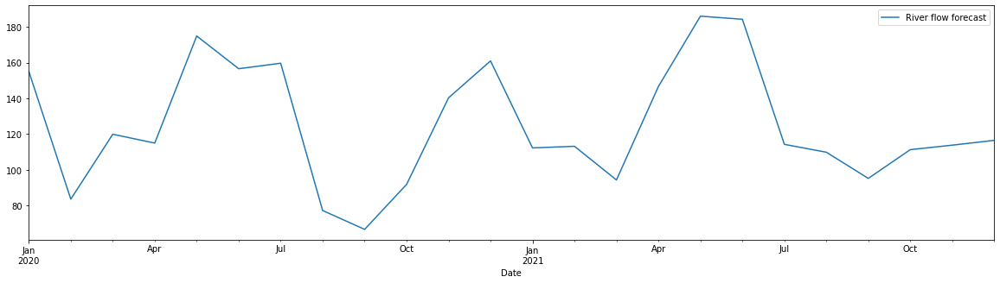


 ################ Basin 8 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


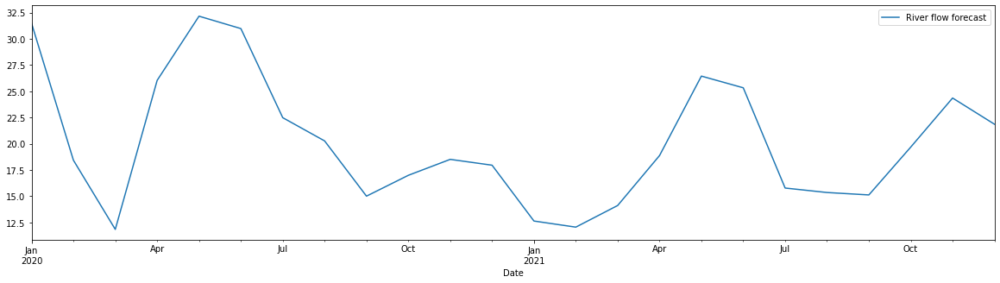


 ################ Basin 9 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


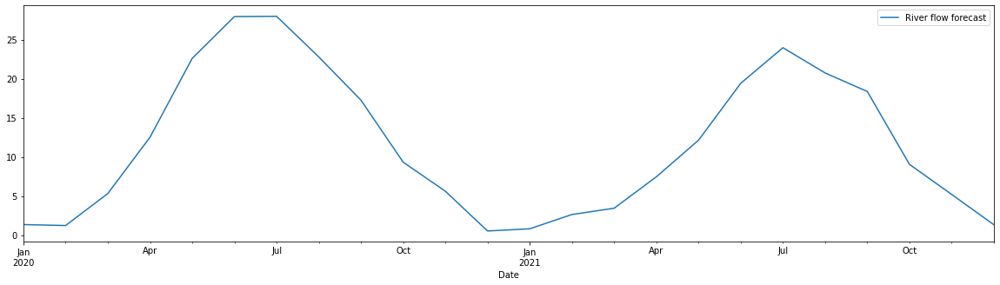


 ################ Basin 10 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


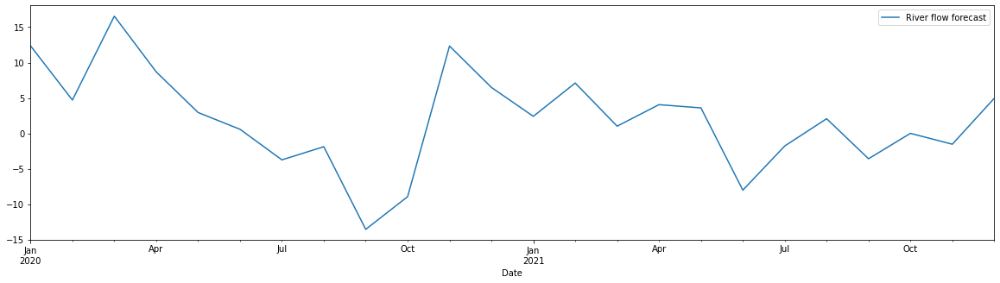


 ################ Basin 11 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


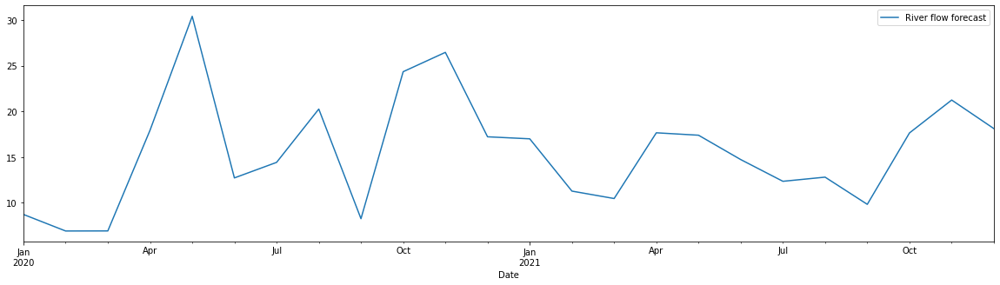


 ################ Basin 12 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


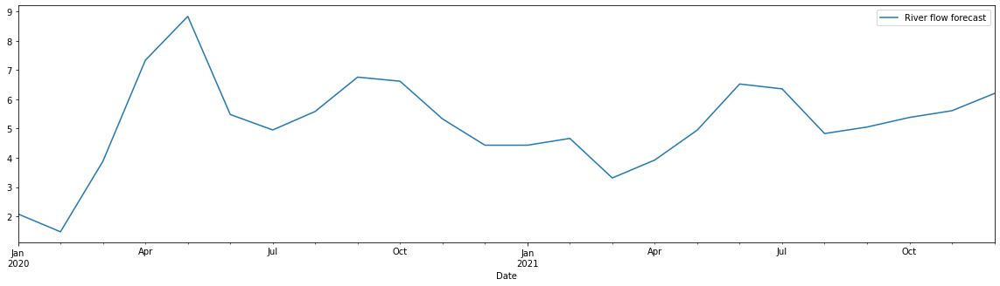


 ################ Basin 13 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


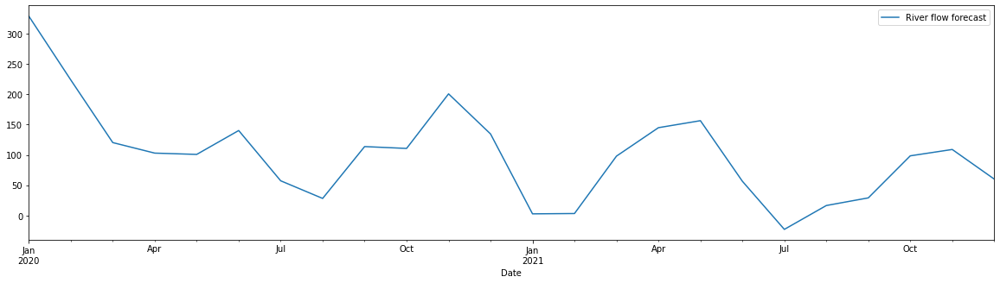


 ################ Basin 14 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


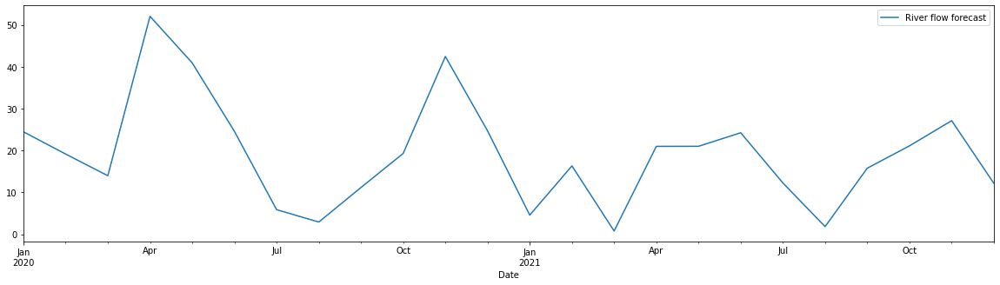


 ################ Basin 15 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


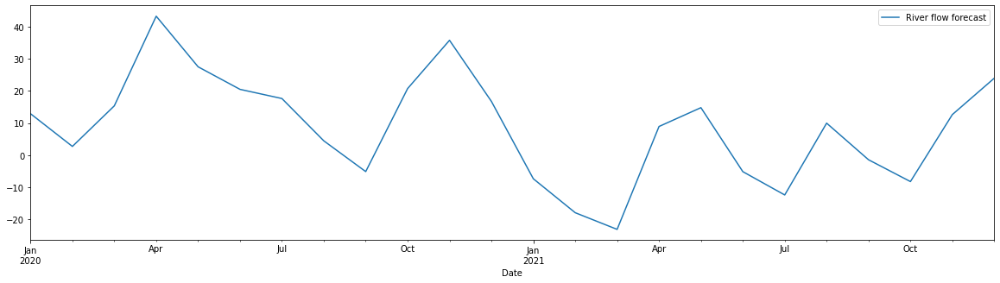


 ################ Basin 16 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


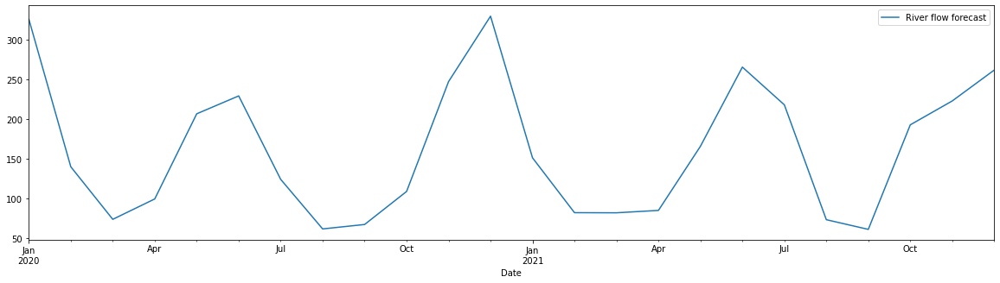


 ################ Basin 17 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


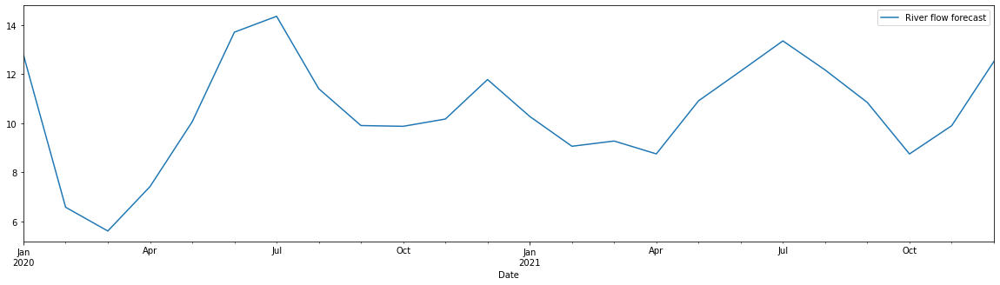


 ################ Basin 18 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


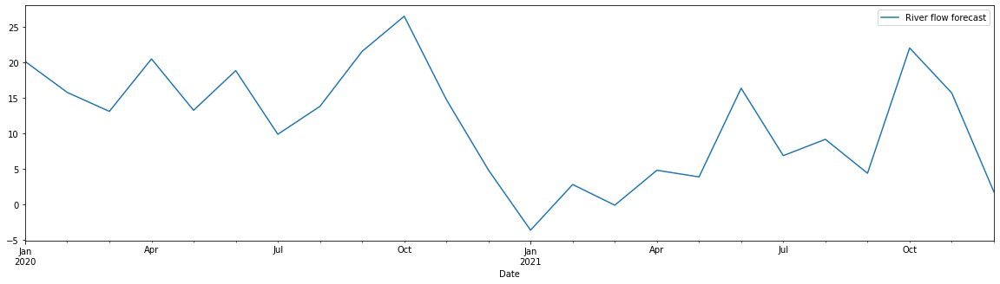


 ################ Basin 19 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


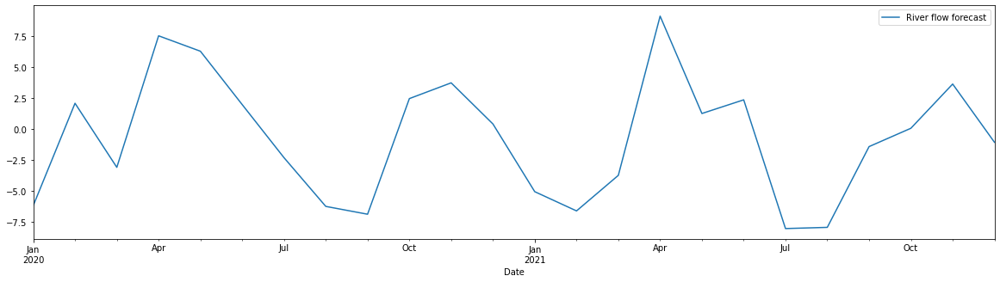


 ################ Basin 20 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


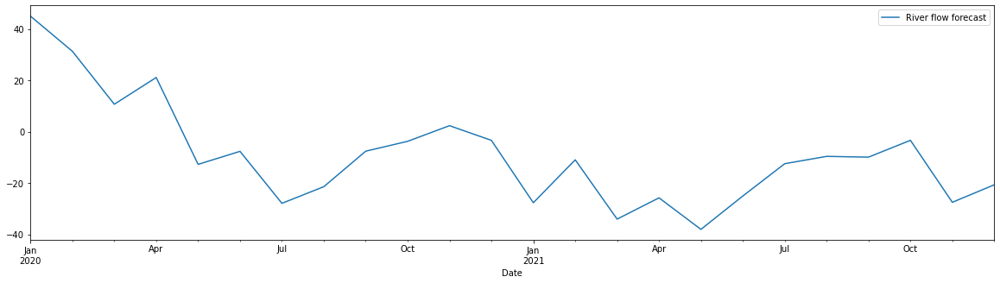


 ################ Basin 21 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


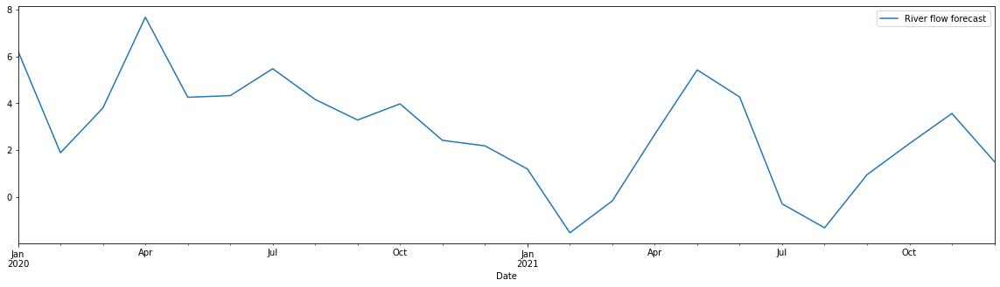


 ################ Basin 22 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


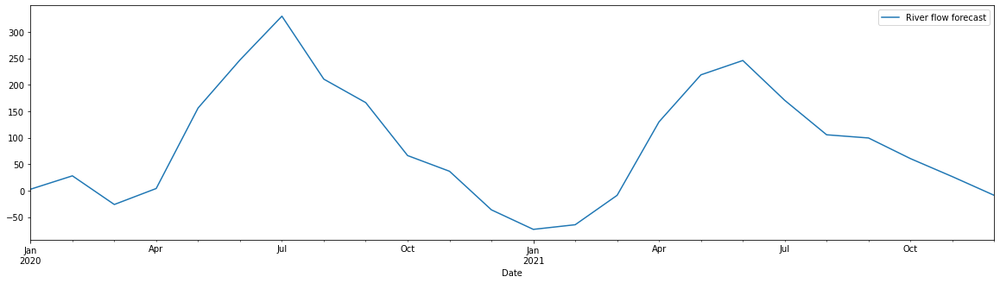


 ################ Basin 23 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


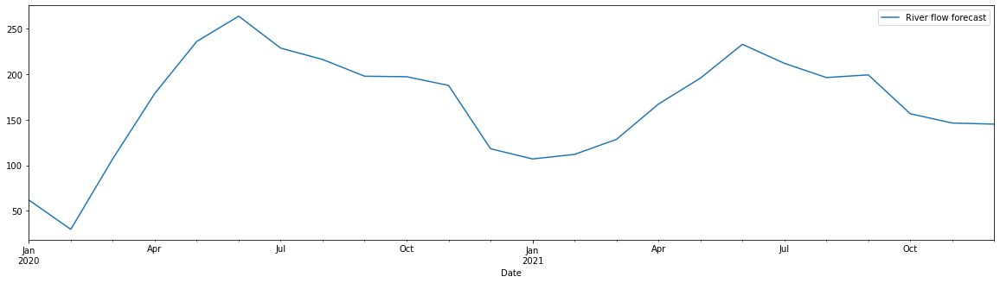


 ################ Basin 24 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


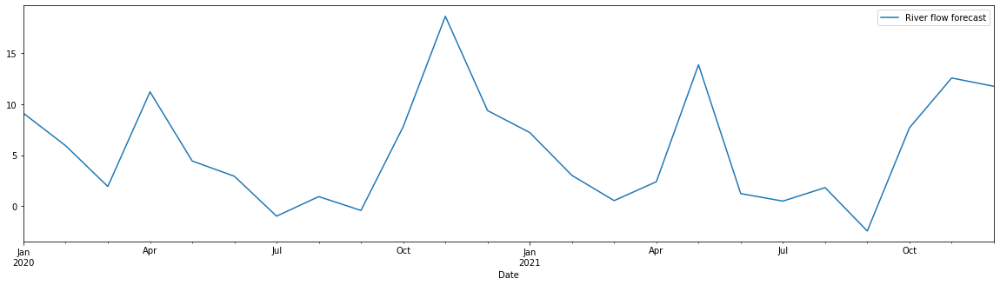


 ################ Basin 25 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


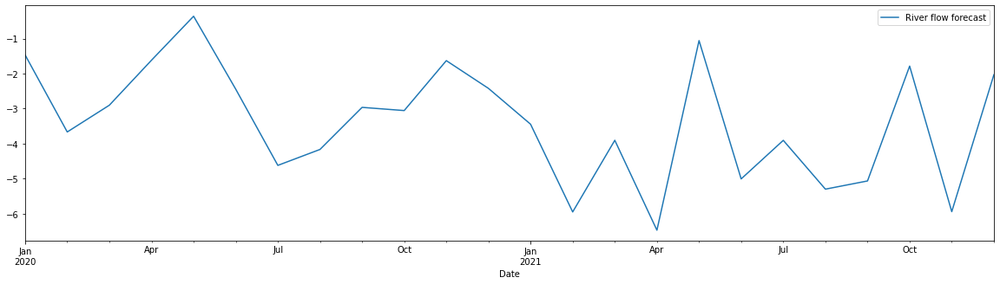


 ################ Basin 26 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


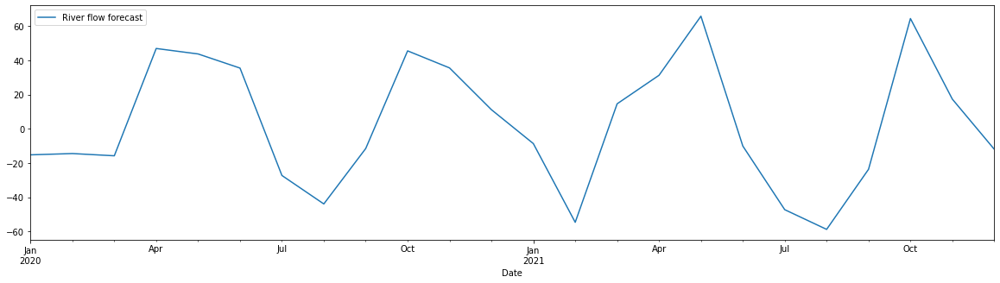


 ################ Basin 27 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


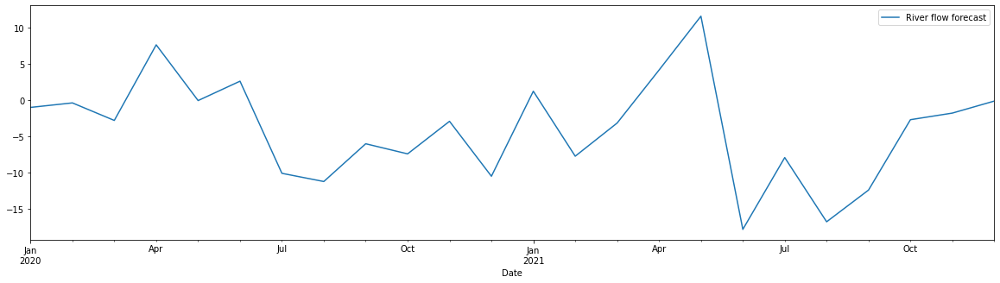


 ################ Basin 28 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


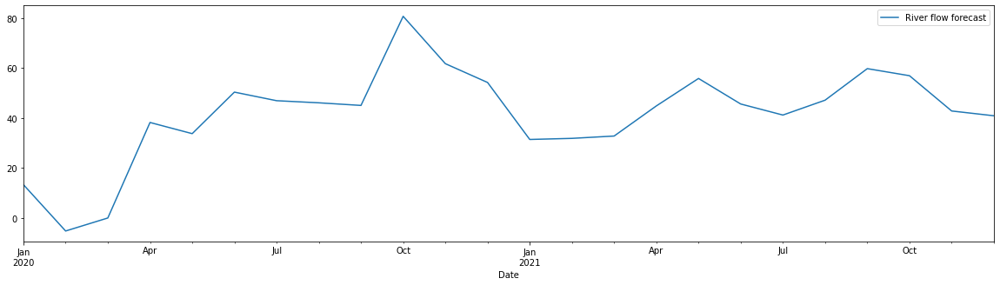


 ################ Basin 29 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


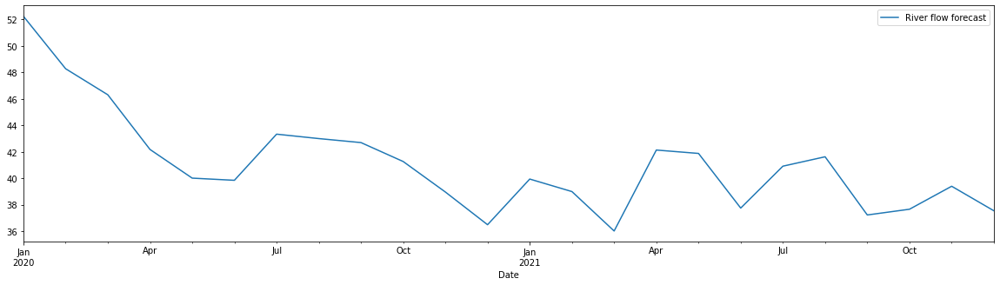


 ################ Basin 30 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


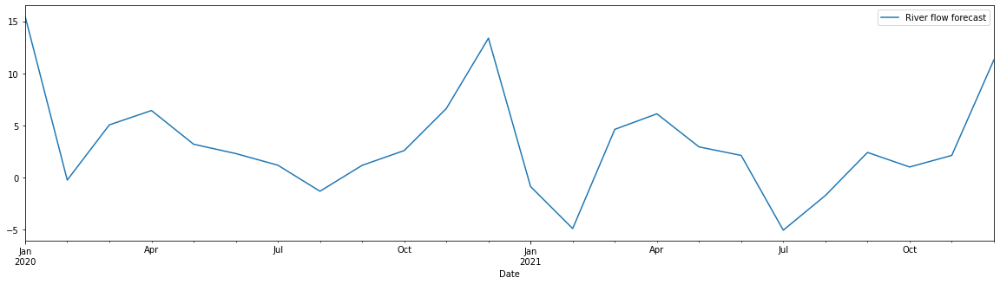


 ################ Basin 31 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


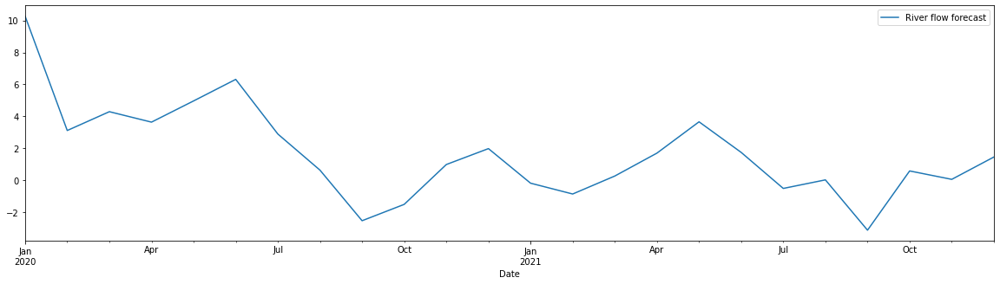


 ################ Basin 32 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


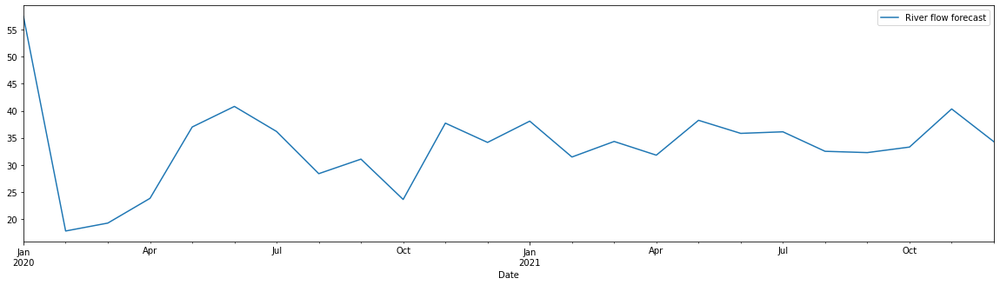


 ################ Basin 33 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


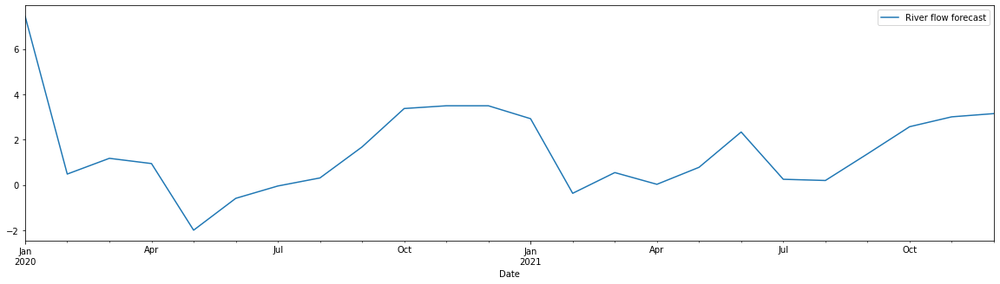


 ################ Basin 34 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


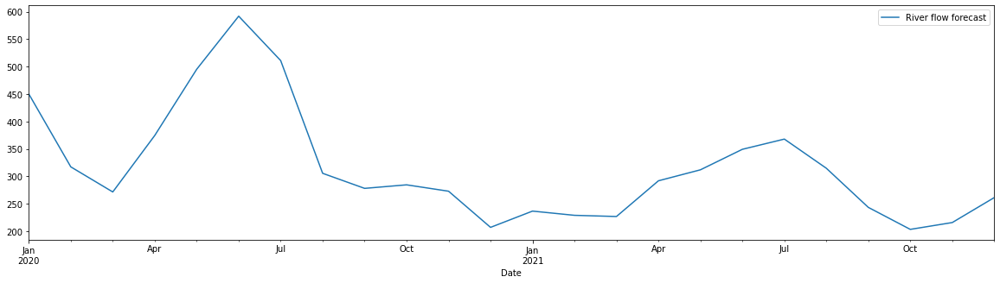


 ################ Basin 35 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


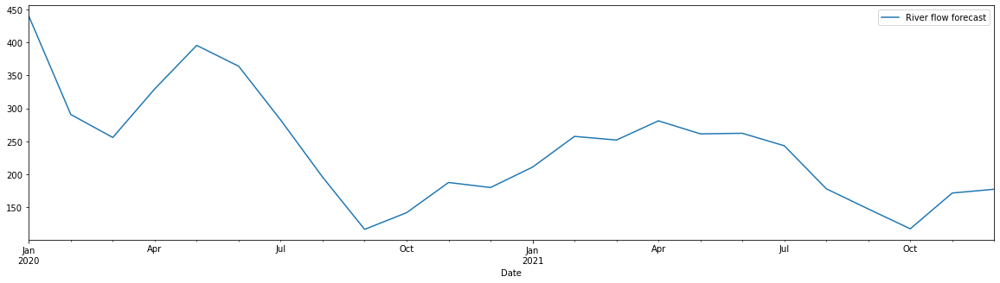


 ################ Basin 36 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


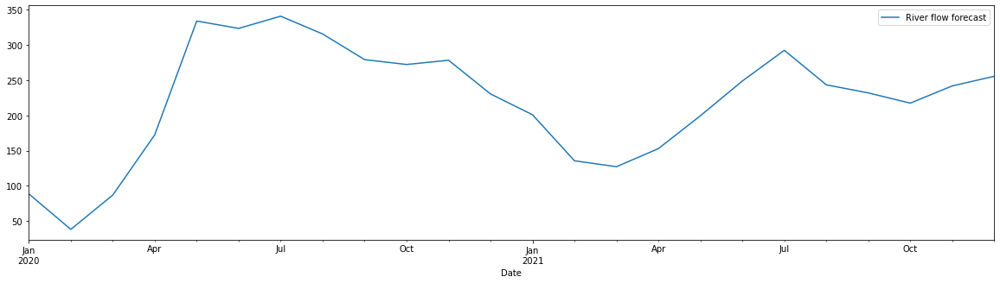


 ################ Basin 37 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


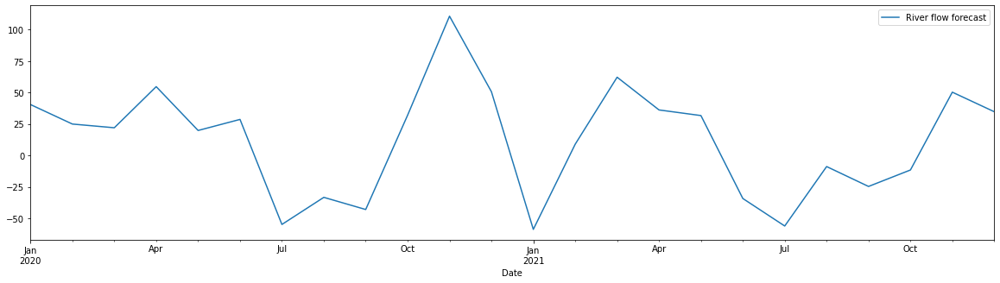


 ################ Basin 38 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


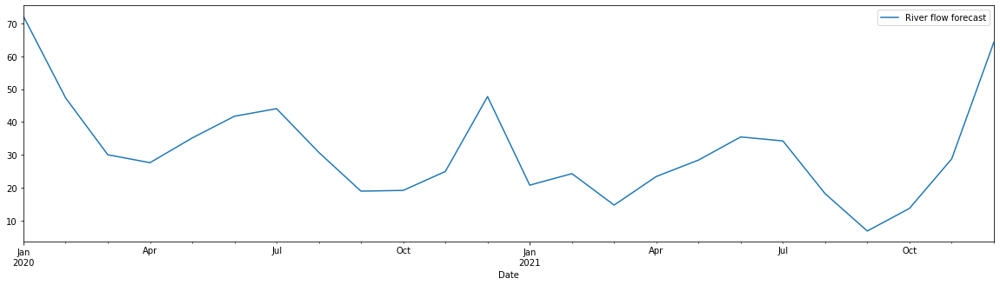


 ################ Basin 39 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


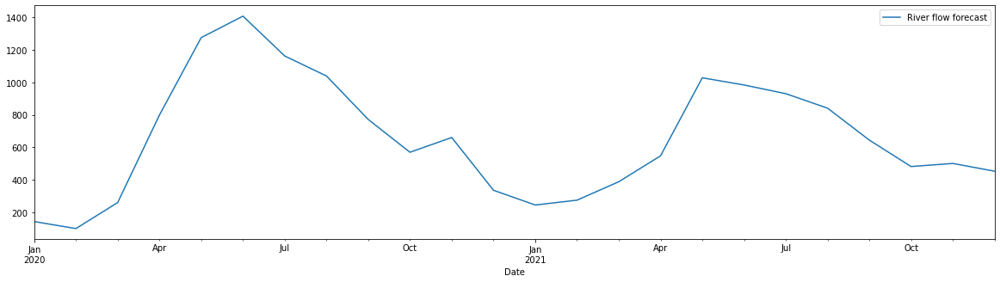


 ################ Basin 40 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


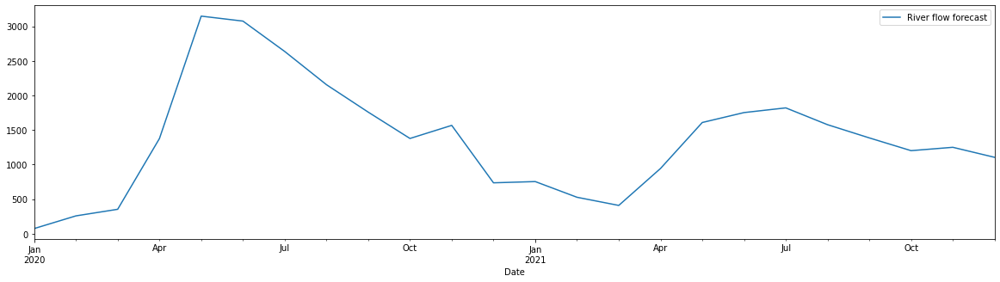


 ################ Basin 41 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


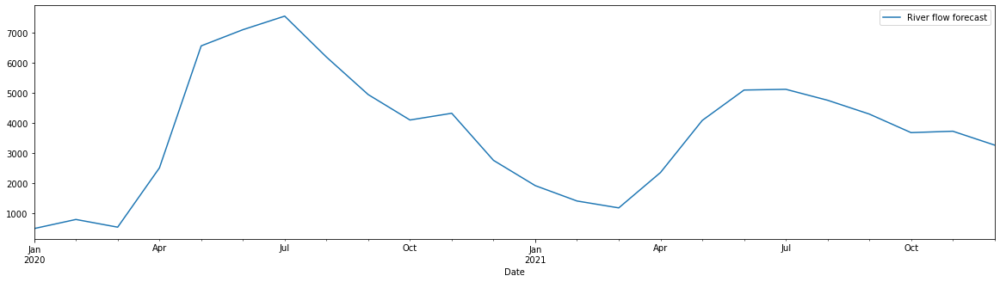


 ################ Basin 42 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


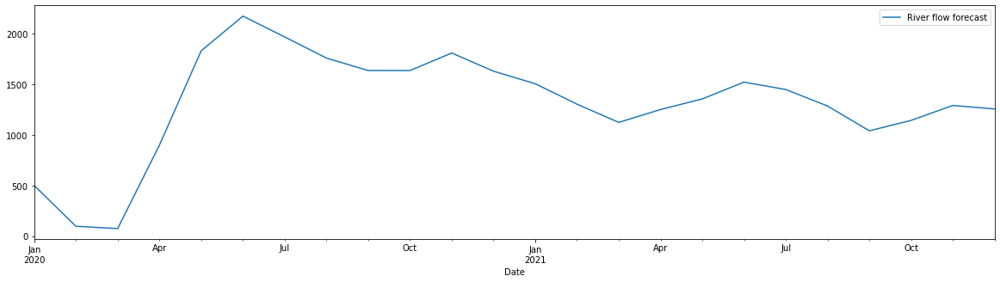


 ################ Basin 43 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


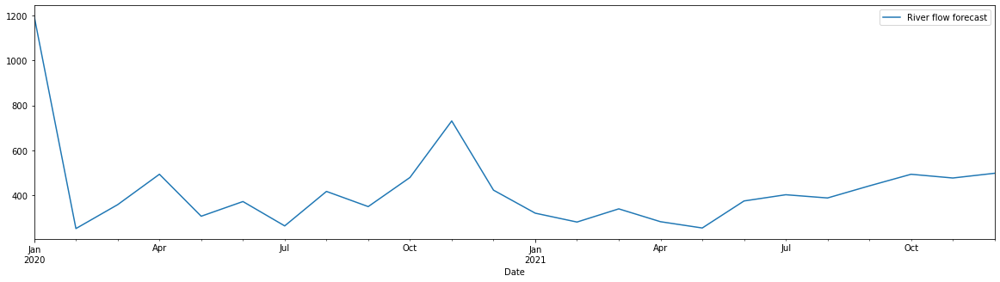


 ################ Basin 44 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


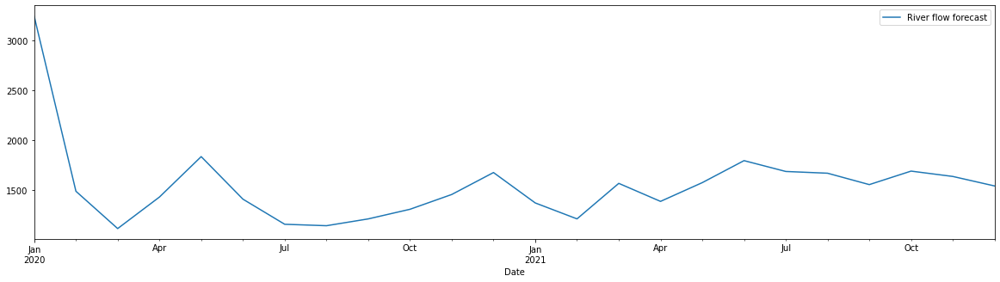


 ################ Basin 45 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


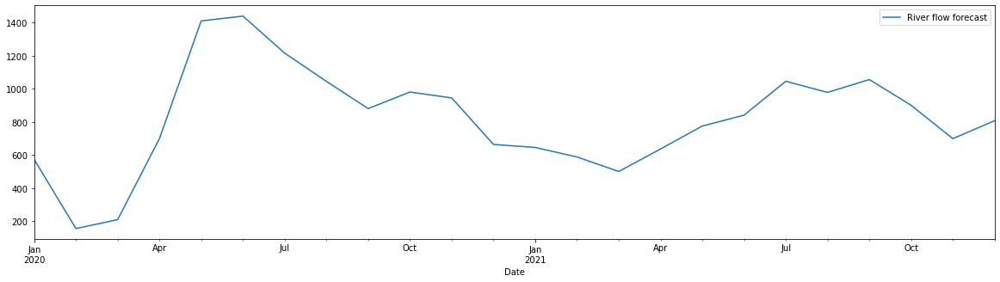


 ################ Basin 46 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


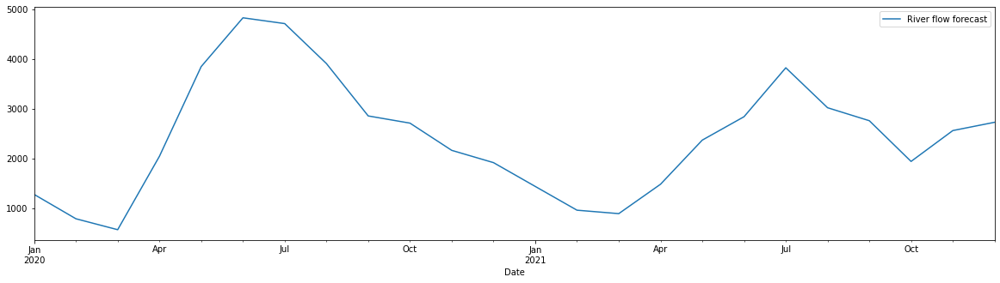


 ################ Basin 47 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


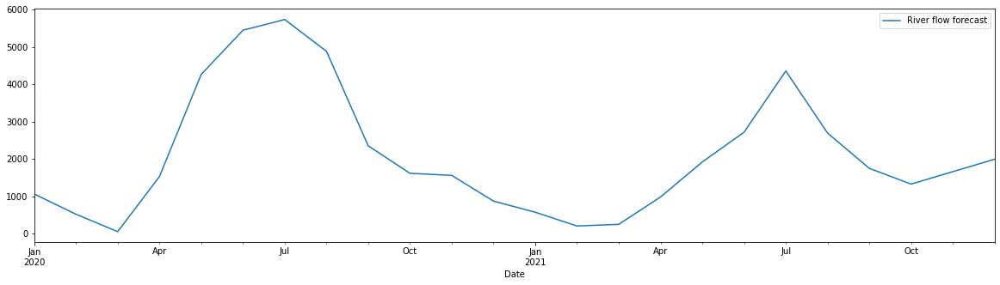


 ################ Basin 48 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


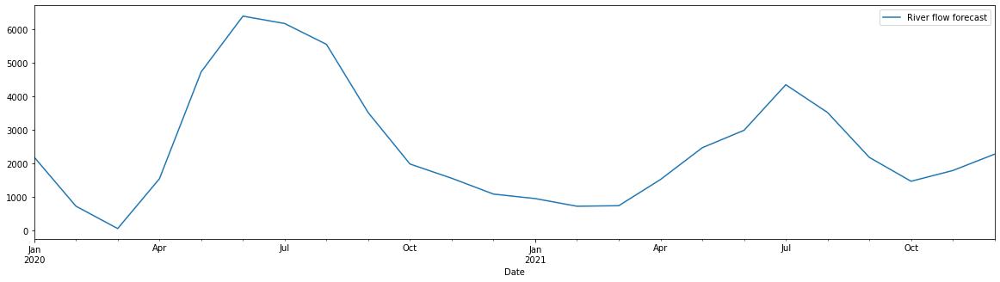

Def_75%
P_B1

 ################ Basin 1 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


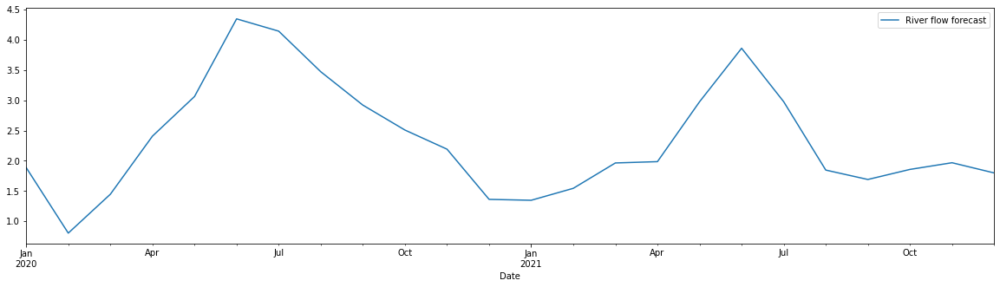


 ################ Basin 2 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


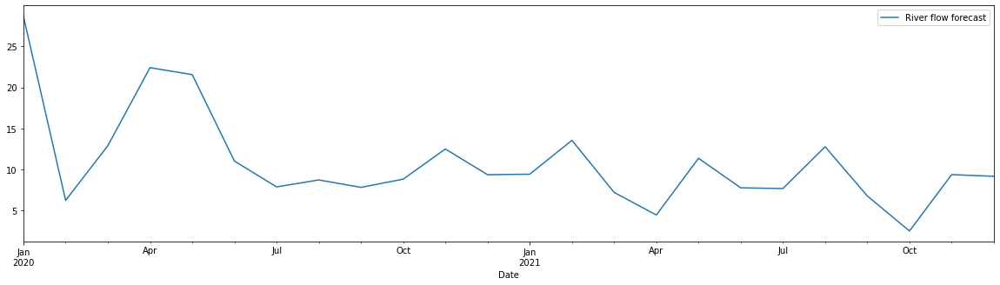


 ################ Basin 3 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


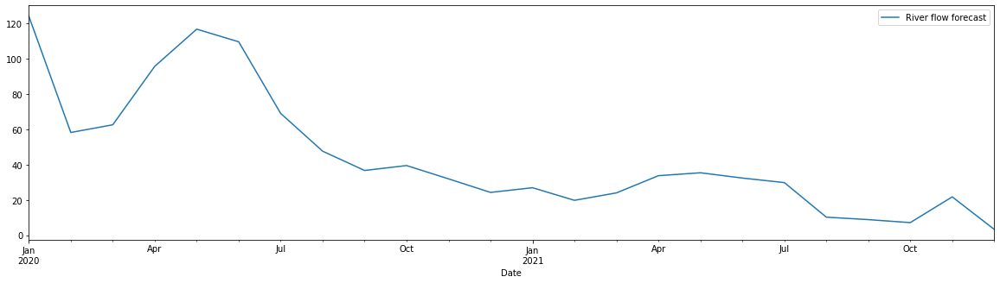


 ################ Basin 4 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


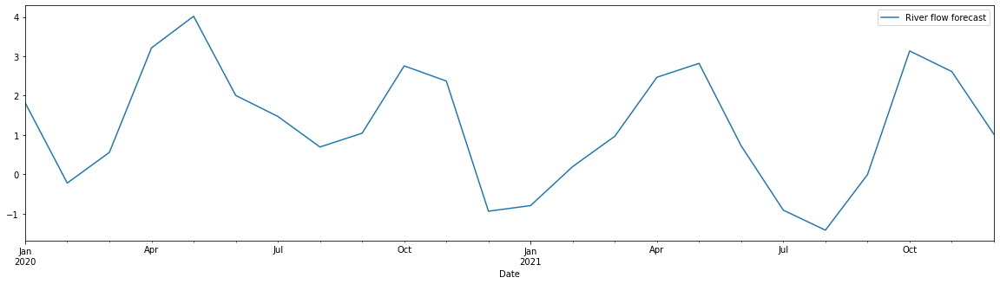


 ################ Basin 5 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


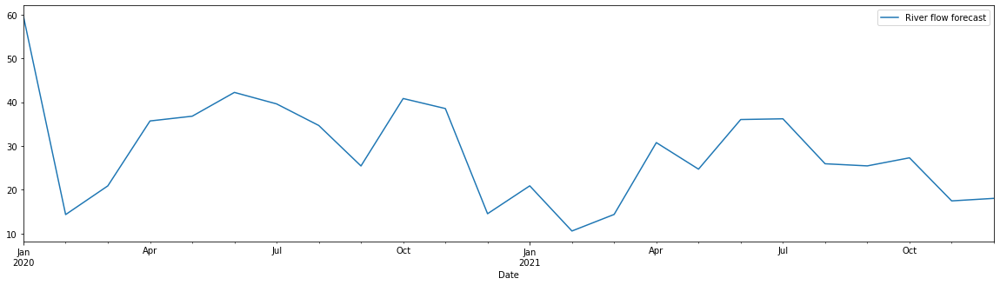


 ################ Basin 6 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


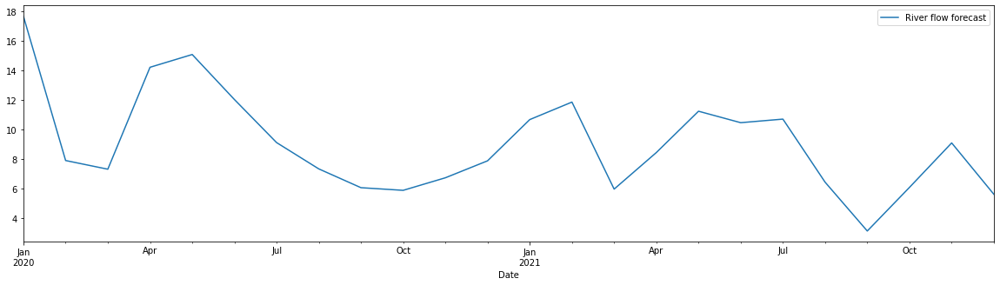


 ################ Basin 7 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


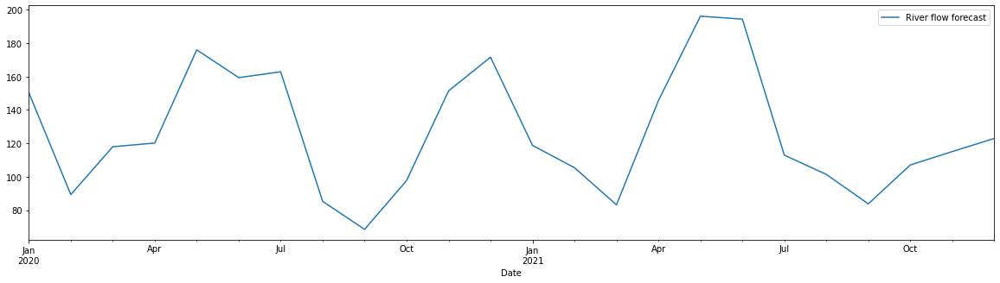


 ################ Basin 8 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


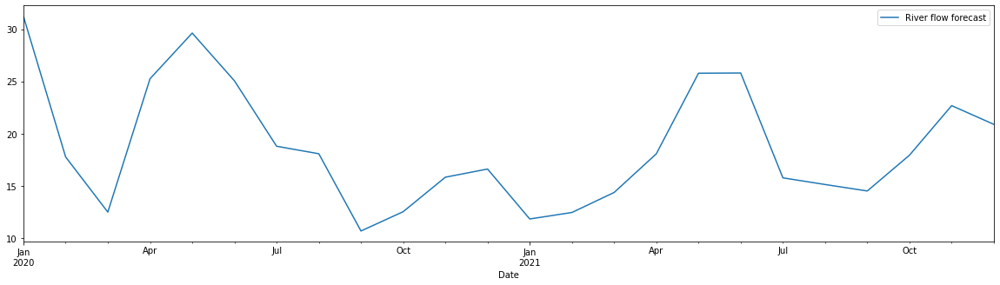


 ################ Basin 9 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


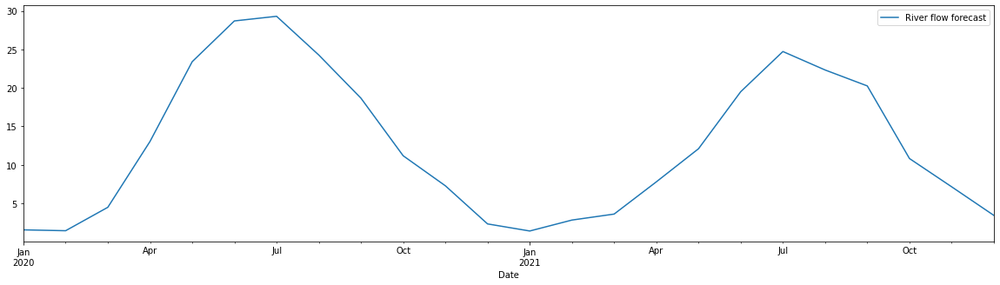


 ################ Basin 10 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


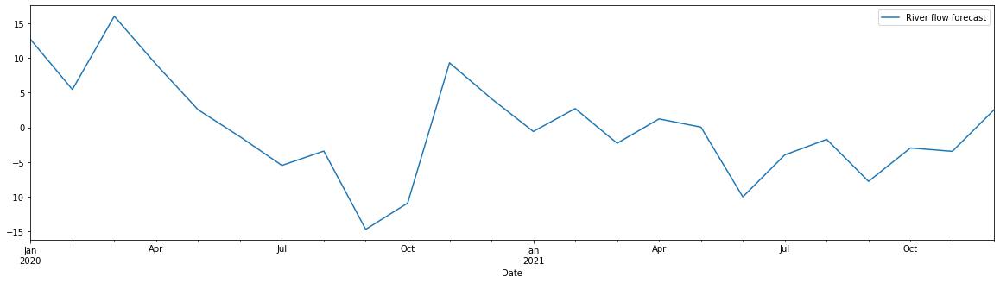


 ################ Basin 11 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


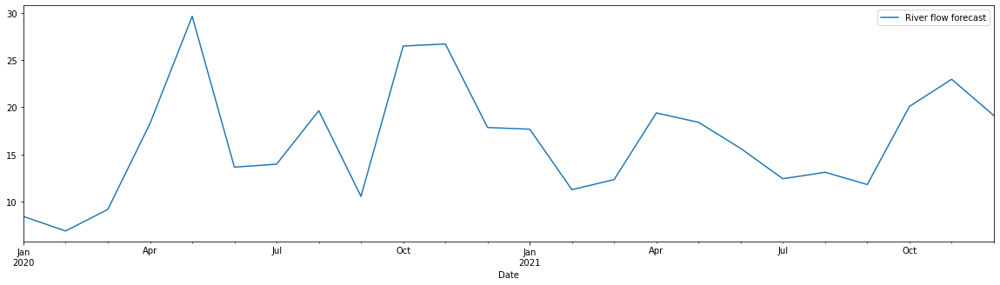


 ################ Basin 12 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


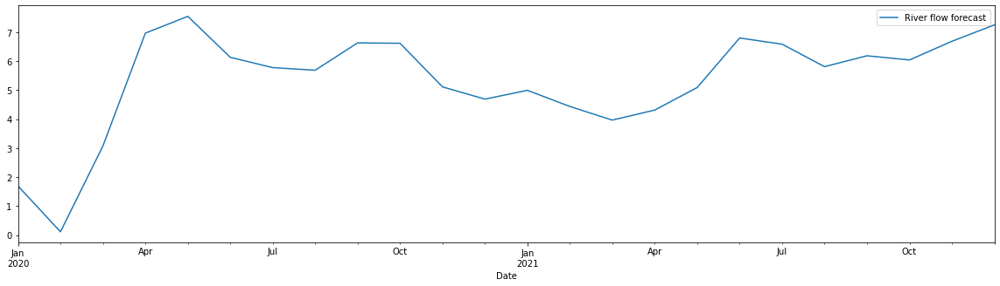


 ################ Basin 13 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


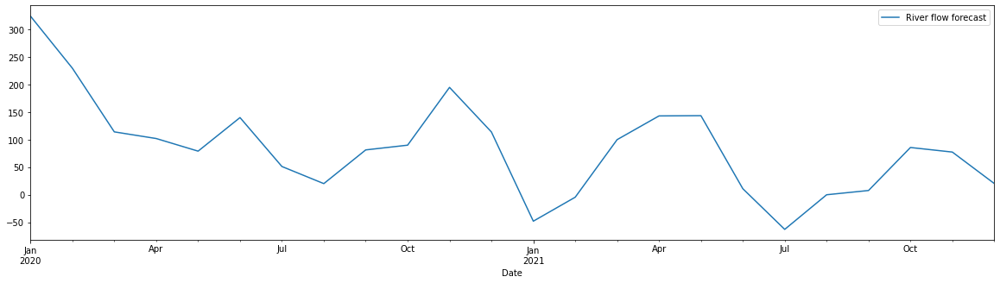


 ################ Basin 14 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


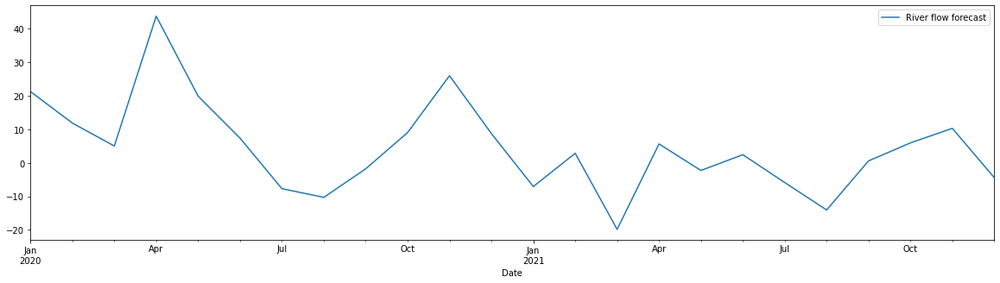


 ################ Basin 15 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


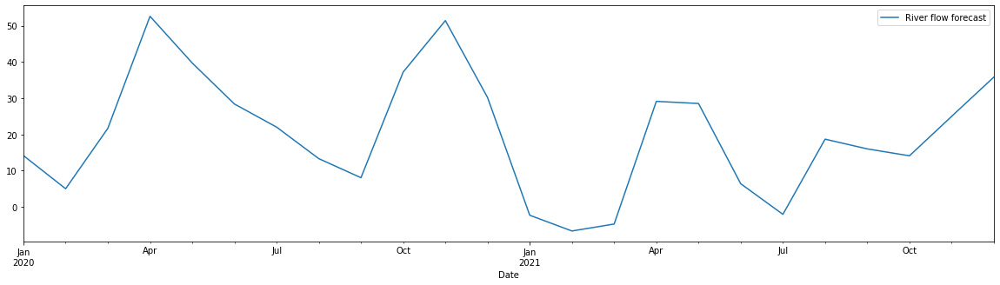


 ################ Basin 16 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


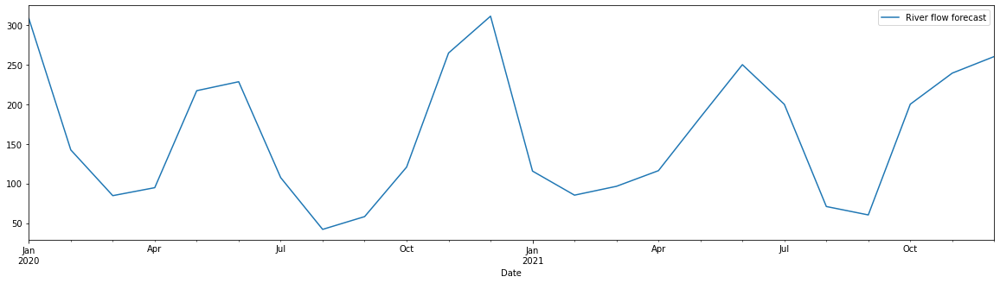


 ################ Basin 17 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


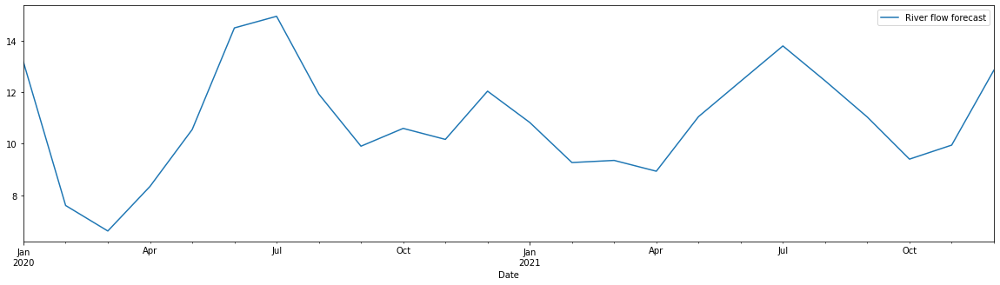


 ################ Basin 18 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


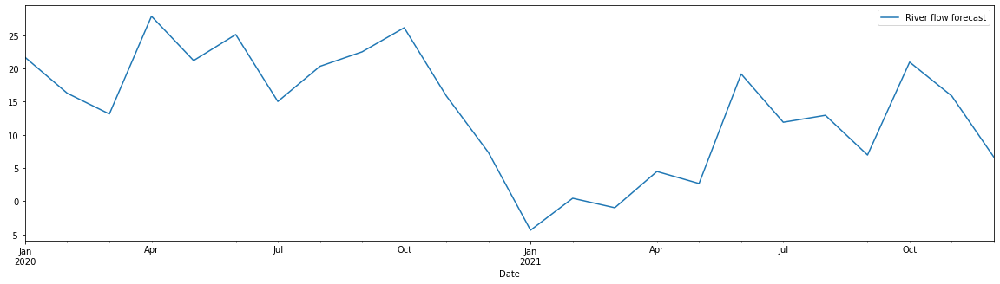


 ################ Basin 19 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


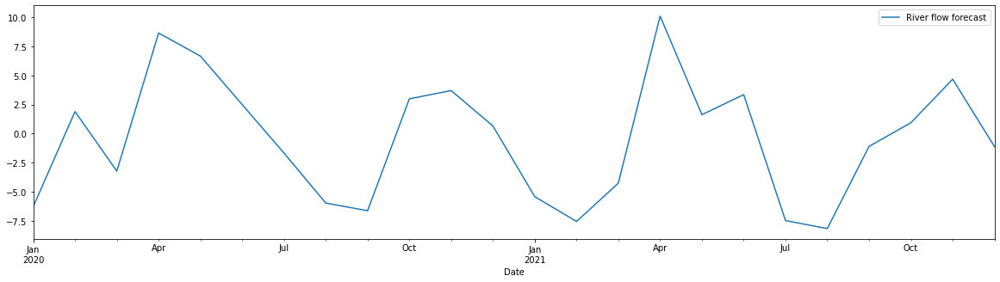


 ################ Basin 20 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


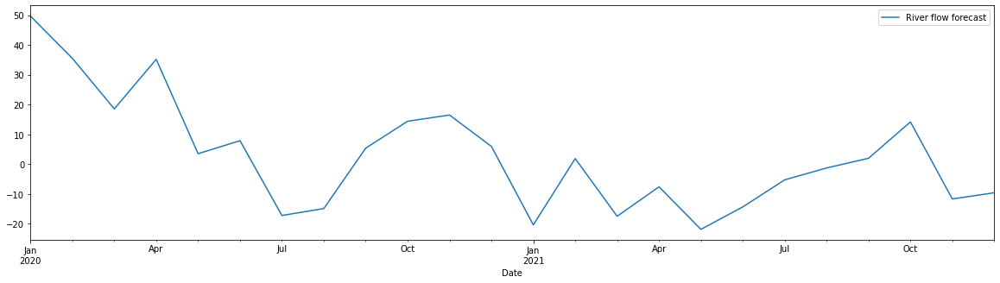


 ################ Basin 21 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


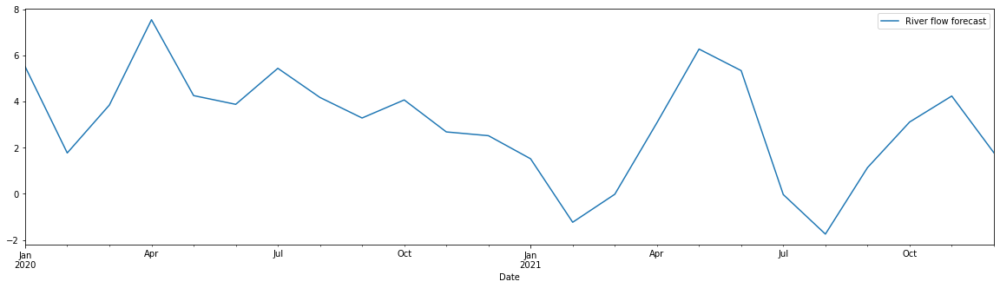


 ################ Basin 22 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


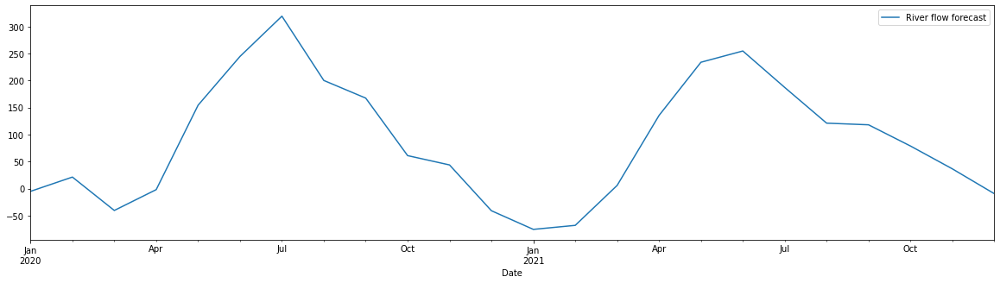


 ################ Basin 23 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


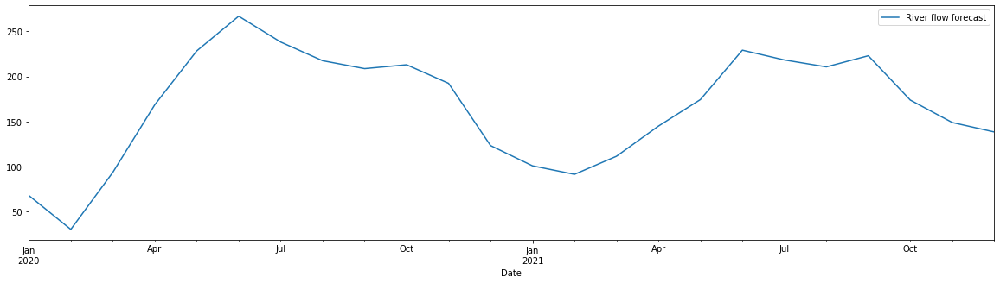


 ################ Basin 24 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


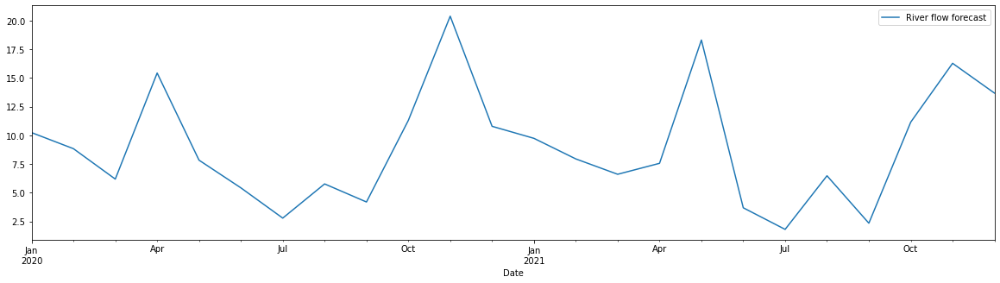


 ################ Basin 25 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


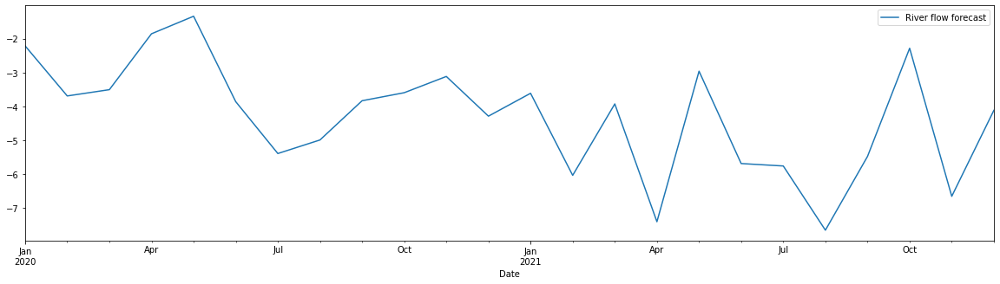


 ################ Basin 26 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


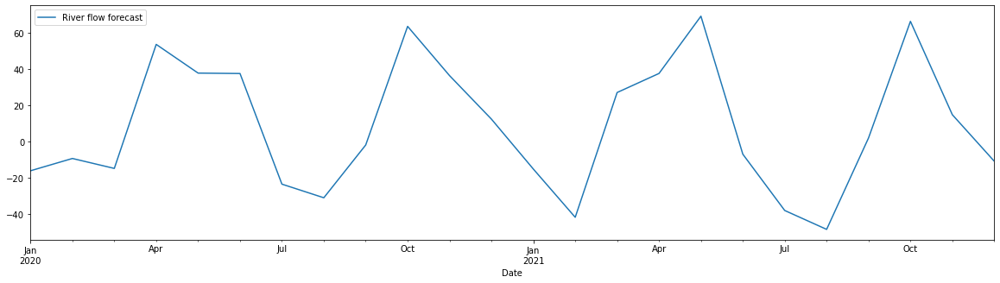


 ################ Basin 27 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


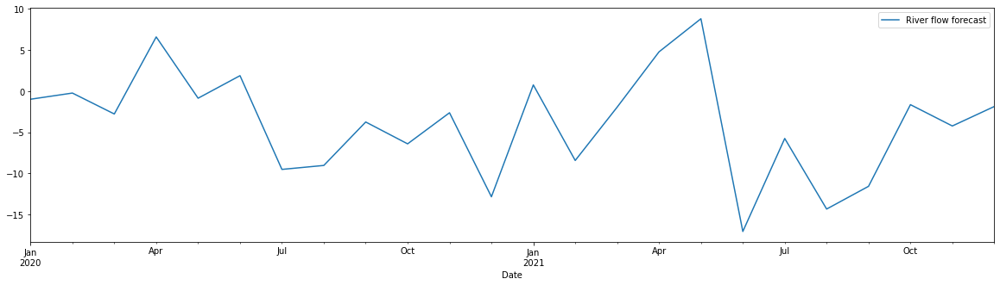


 ################ Basin 28 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


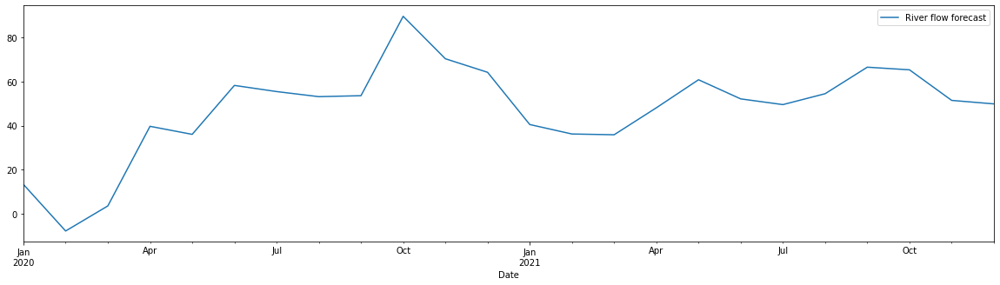


 ################ Basin 29 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


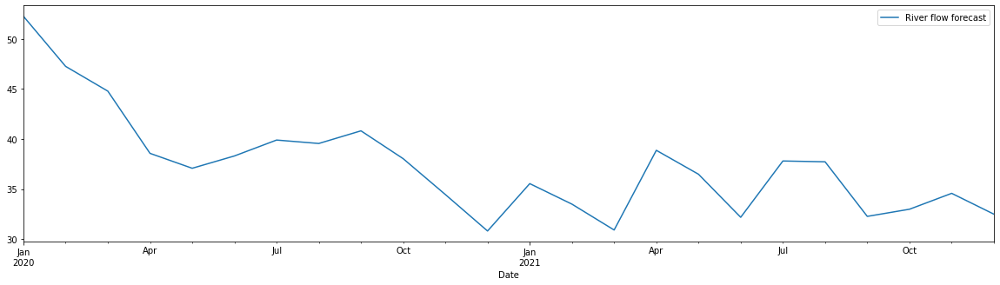


 ################ Basin 30 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


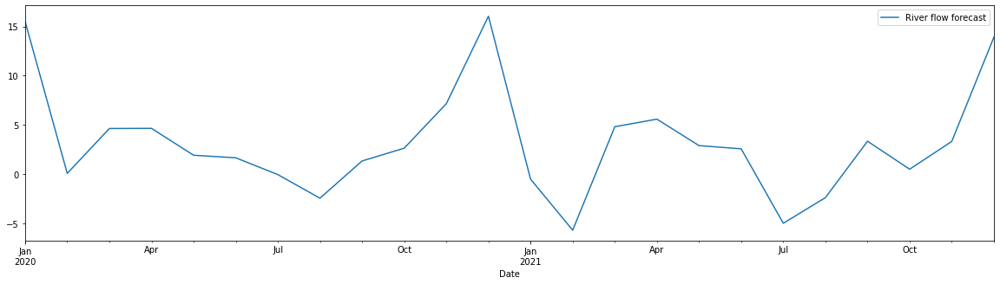


 ################ Basin 31 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


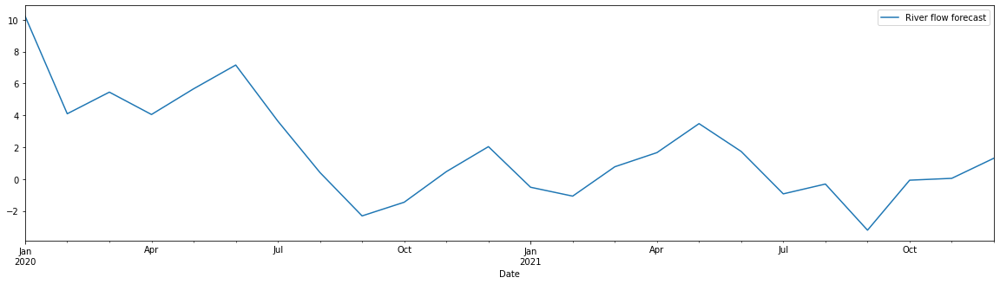


 ################ Basin 32 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


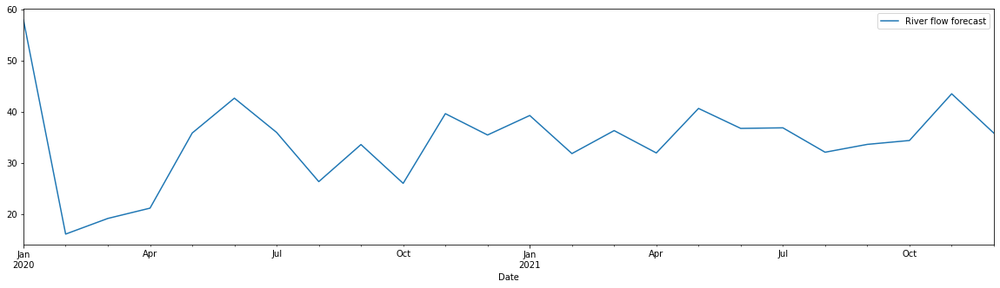


 ################ Basin 33 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


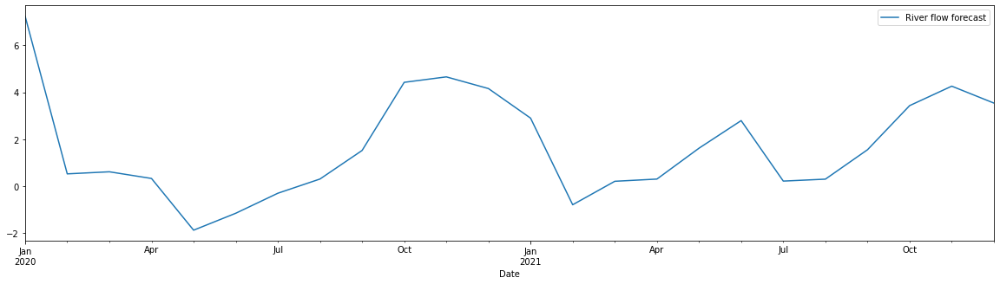


 ################ Basin 34 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


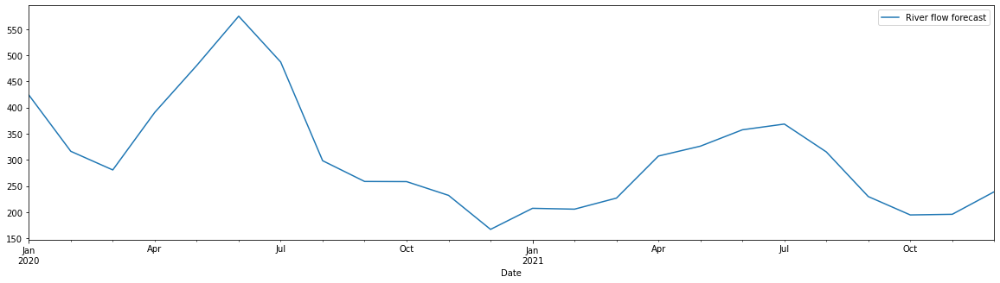


 ################ Basin 35 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


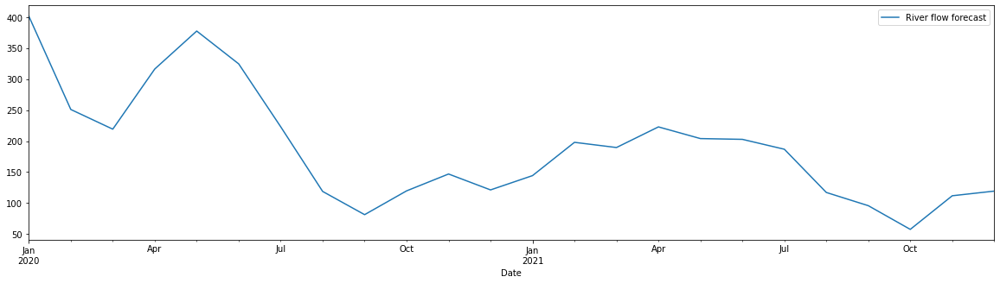


 ################ Basin 36 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


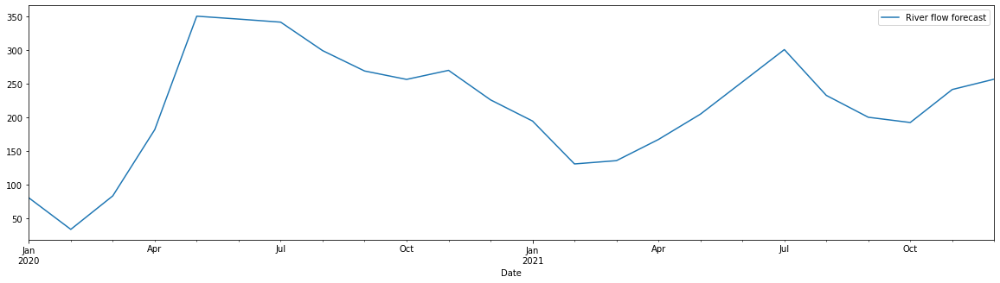


 ################ Basin 37 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


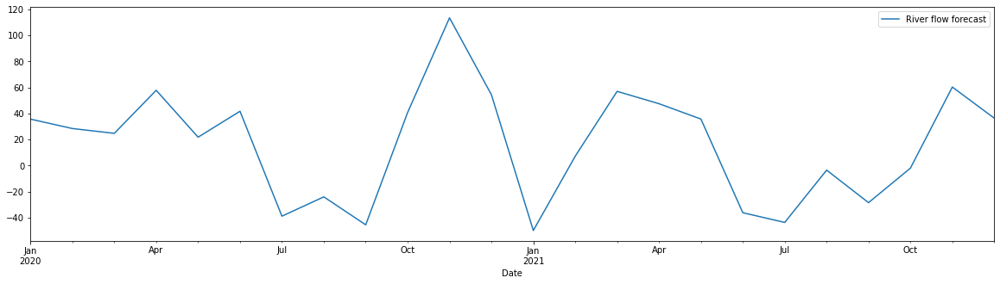


 ################ Basin 38 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


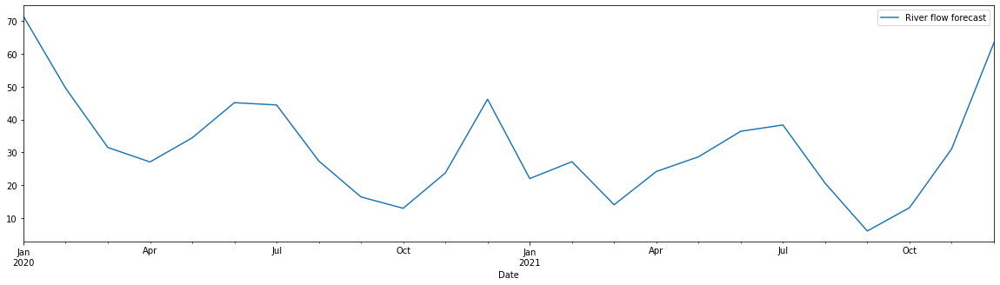


 ################ Basin 39 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


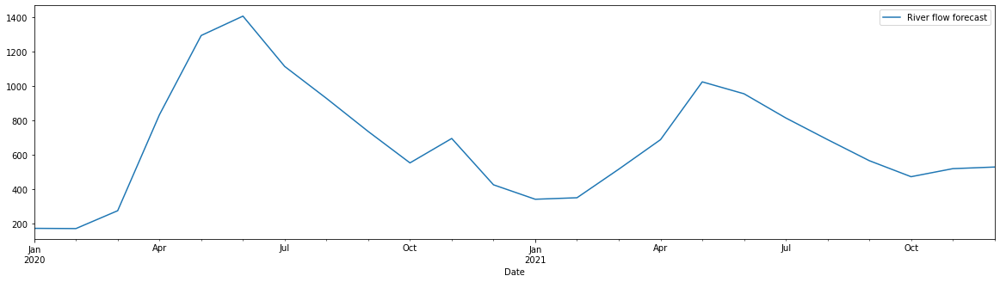


 ################ Basin 40 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


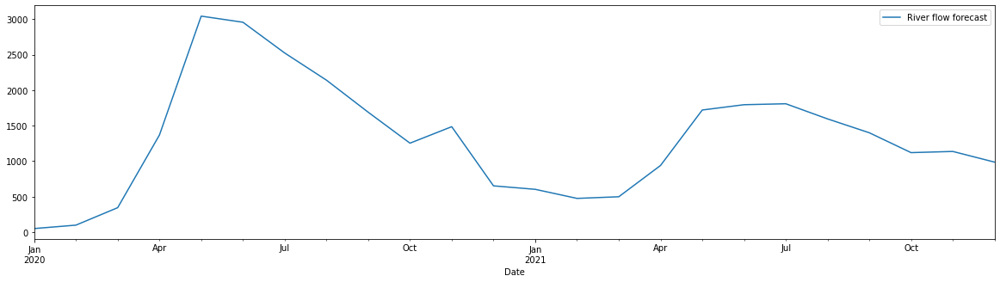


 ################ Basin 41 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


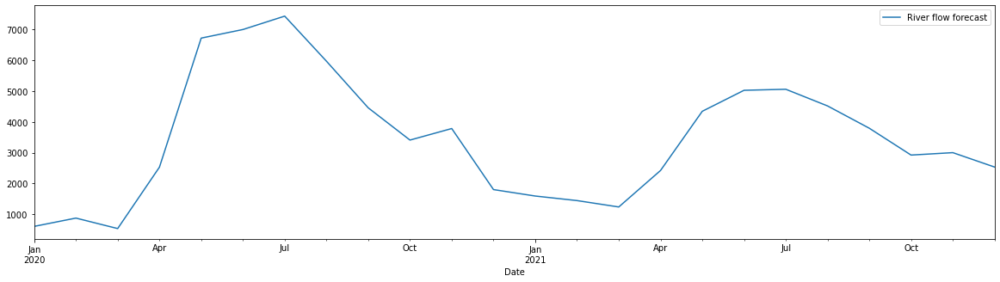


 ################ Basin 42 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


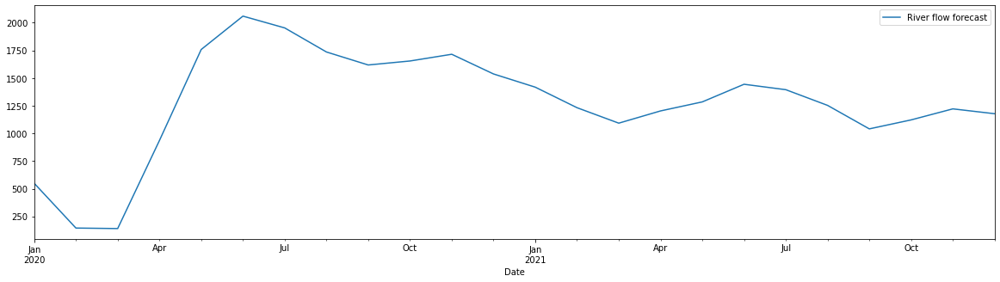


 ################ Basin 43 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


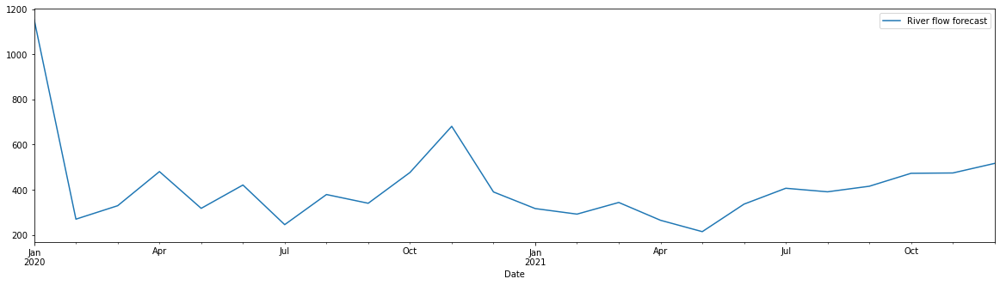


 ################ Basin 44 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


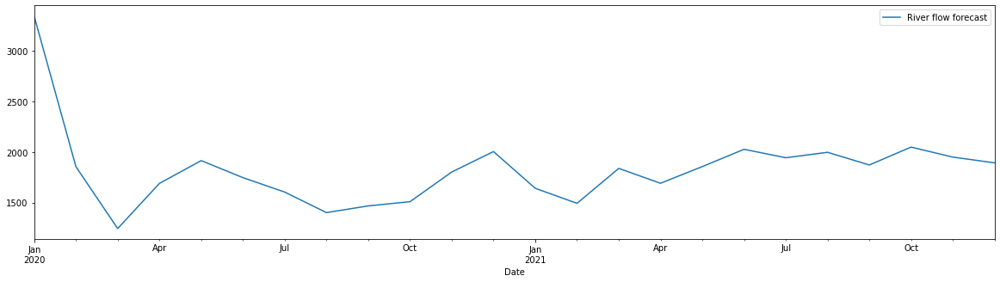


 ################ Basin 45 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


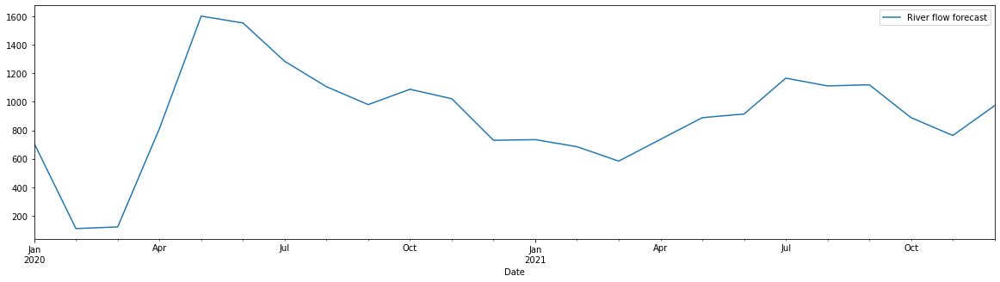


 ################ Basin 46 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


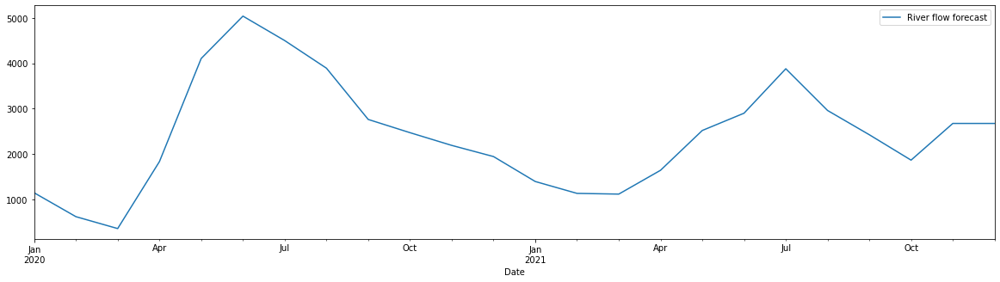


 ################ Basin 47 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


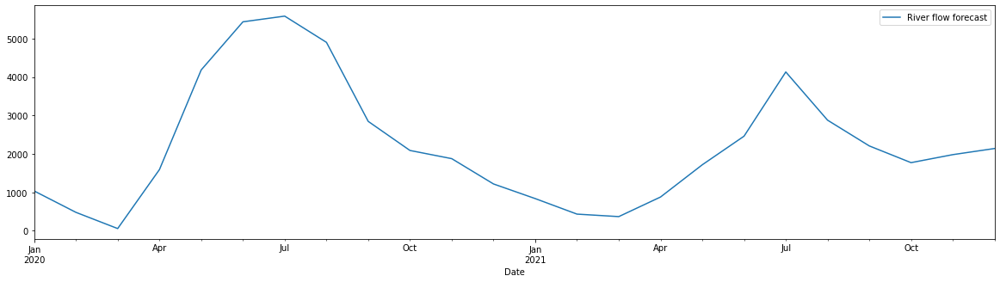


 ################ Basin 48 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


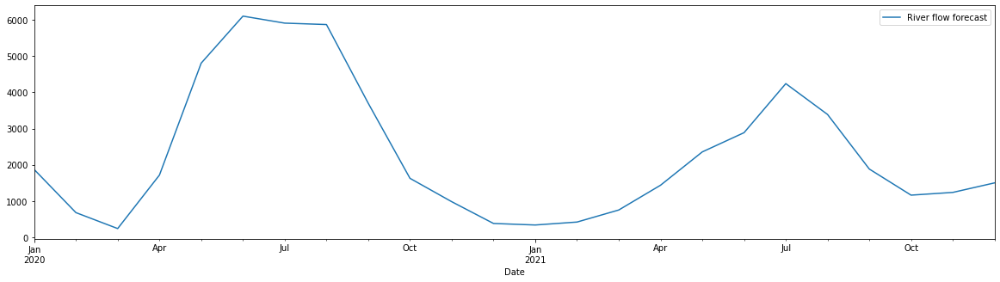

Def_75%
P_B2

 ################ Basin 1 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


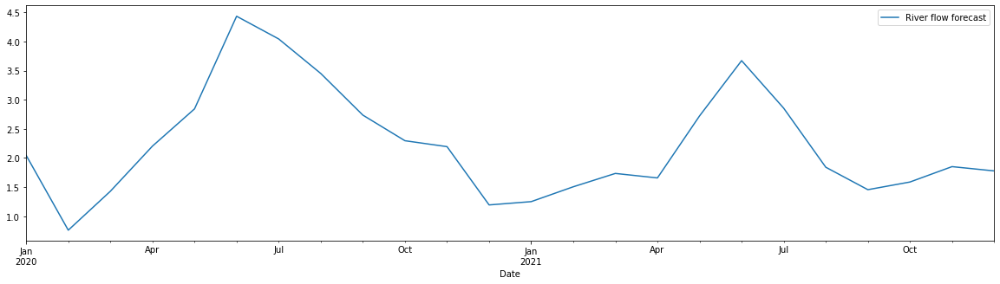


 ################ Basin 2 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


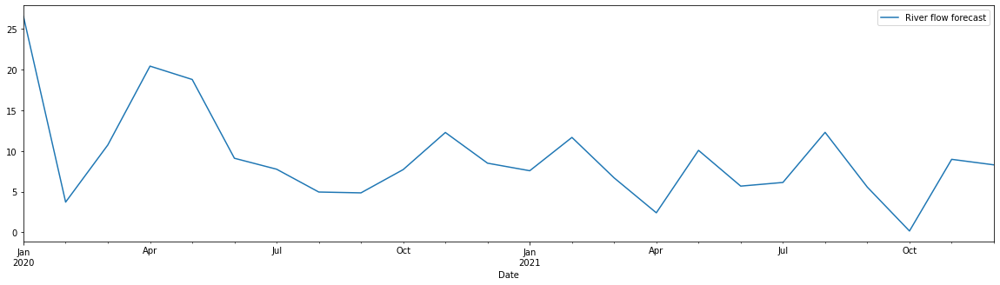


 ################ Basin 3 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


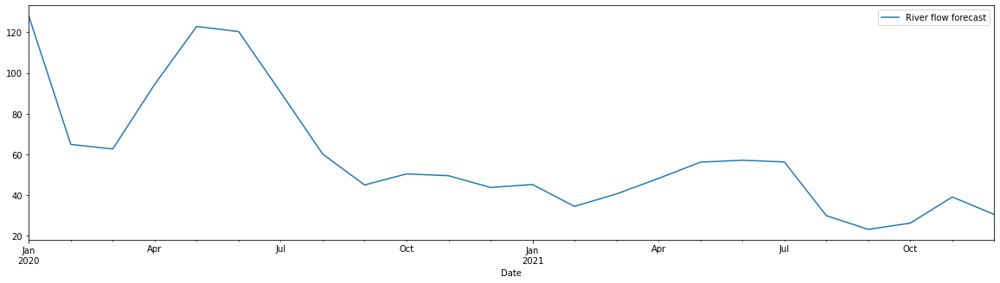


 ################ Basin 4 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


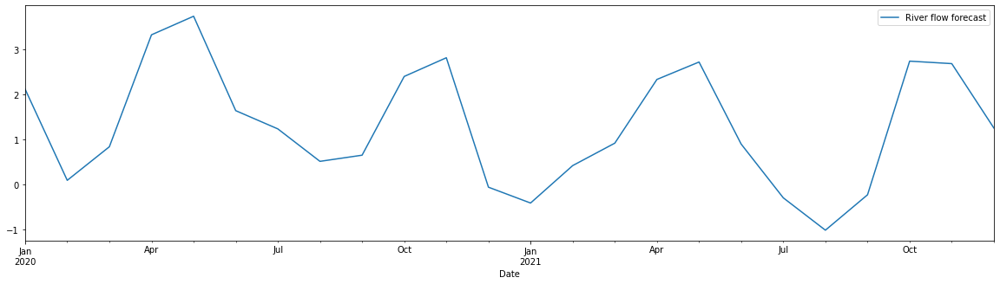


 ################ Basin 5 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


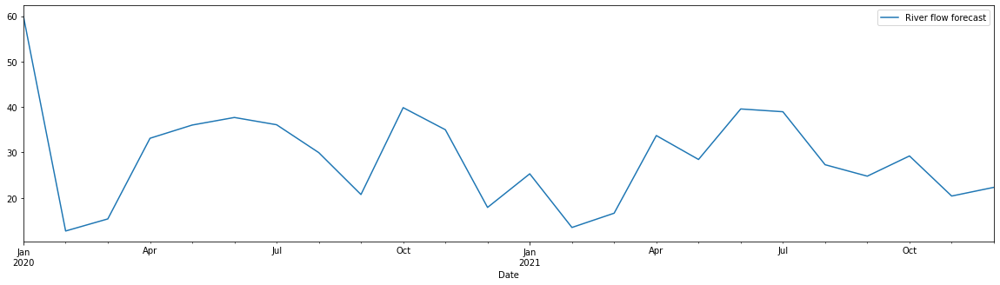


 ################ Basin 6 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


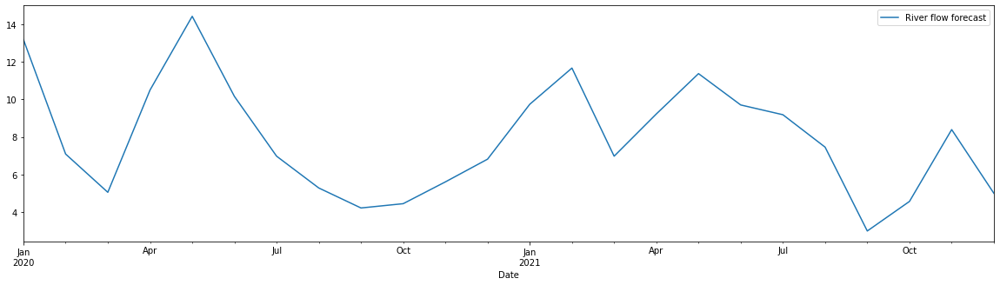


 ################ Basin 7 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


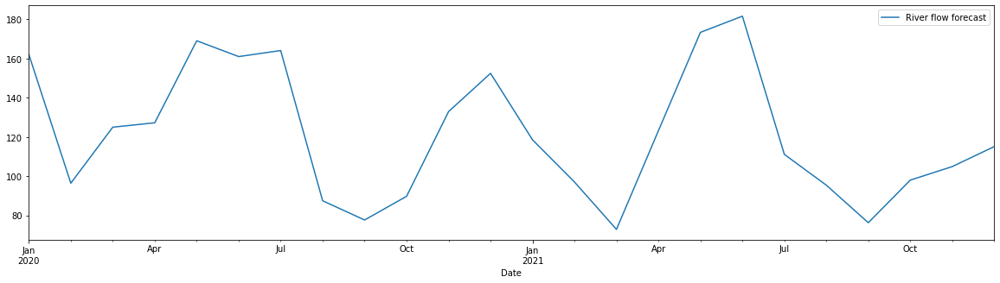


 ################ Basin 8 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


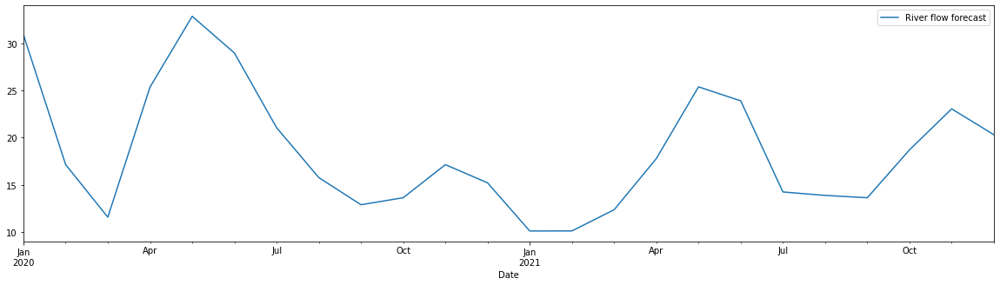


 ################ Basin 9 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


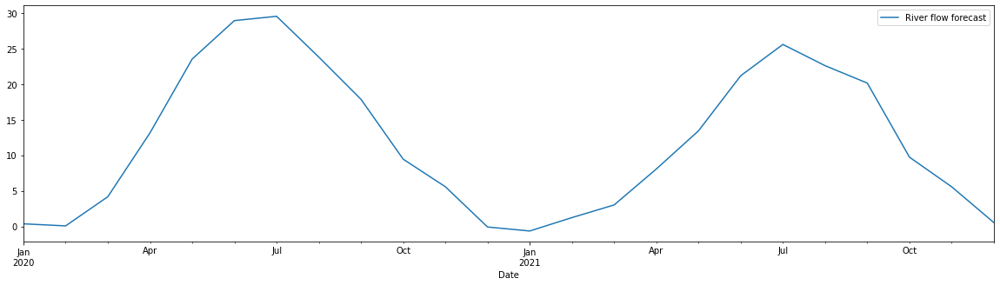


 ################ Basin 10 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


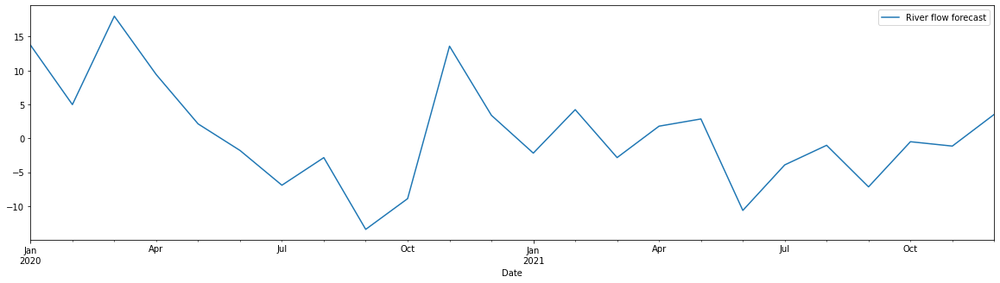


 ################ Basin 11 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


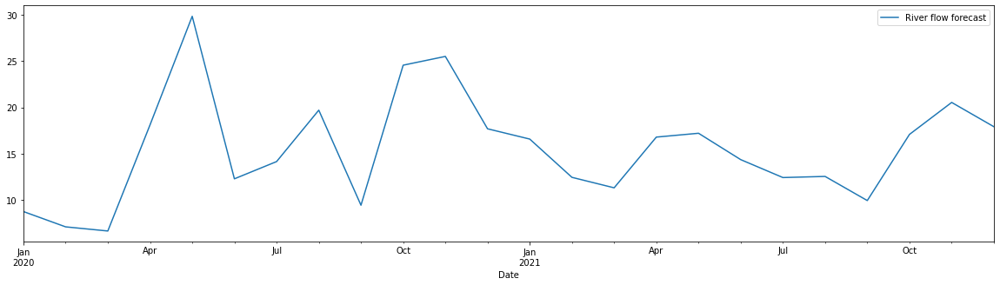


 ################ Basin 12 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


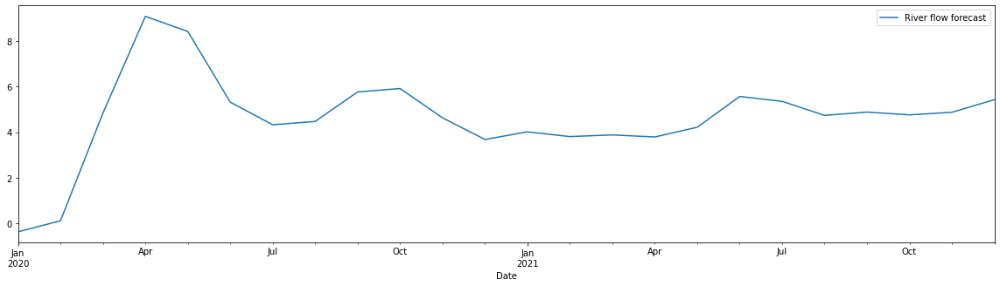


 ################ Basin 13 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


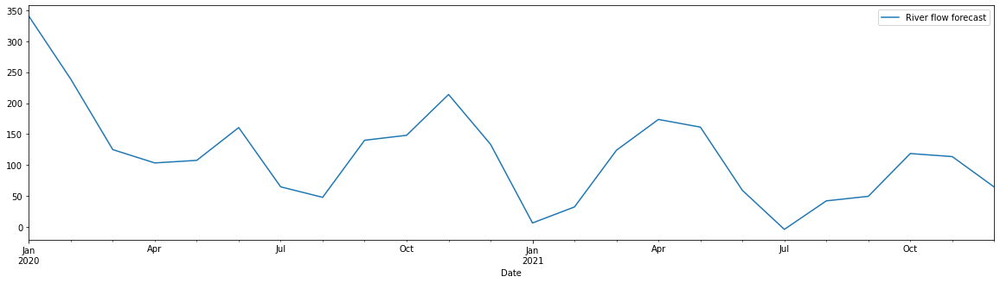


 ################ Basin 14 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


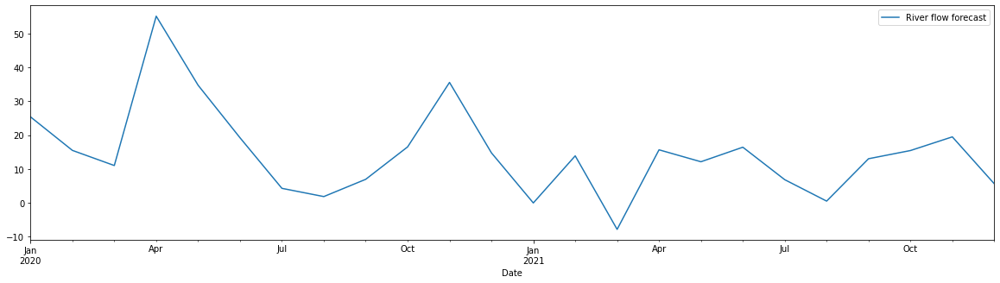


 ################ Basin 15 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


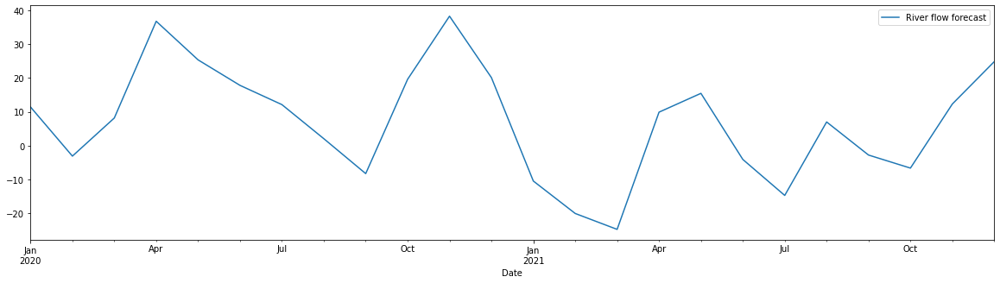


 ################ Basin 16 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


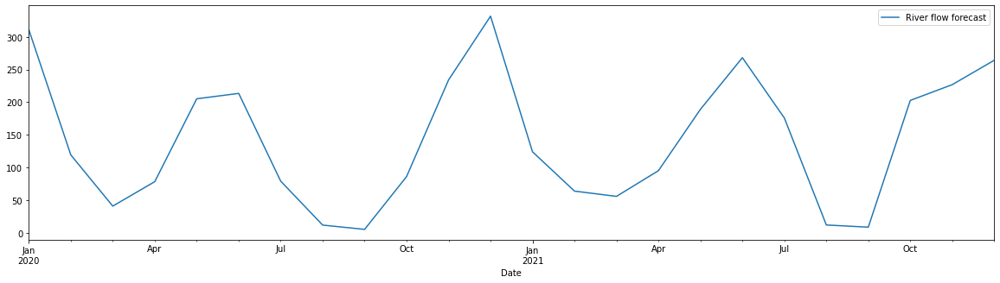


 ################ Basin 17 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


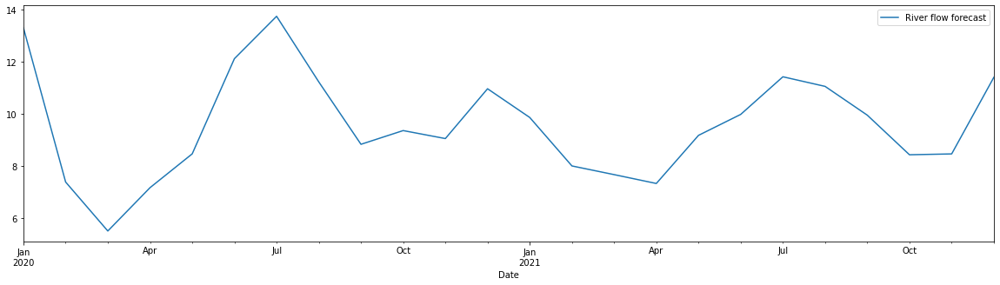


 ################ Basin 18 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


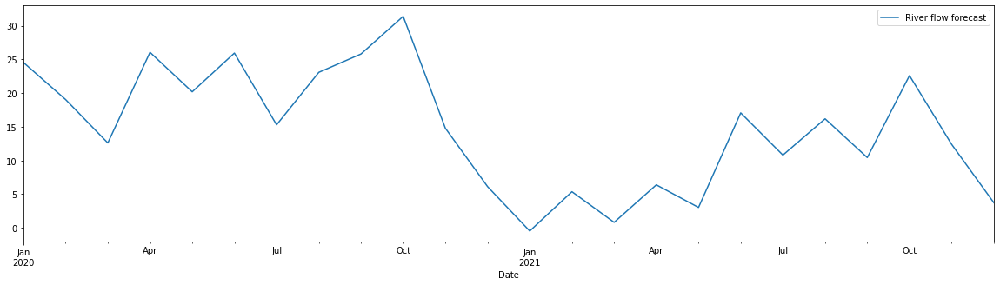


 ################ Basin 19 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


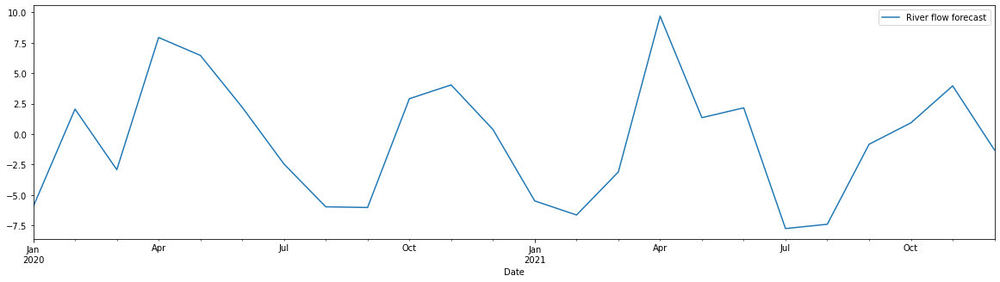


 ################ Basin 20 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


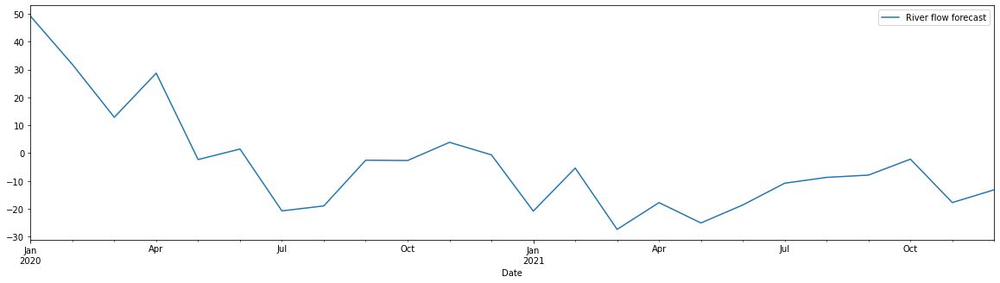


 ################ Basin 21 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


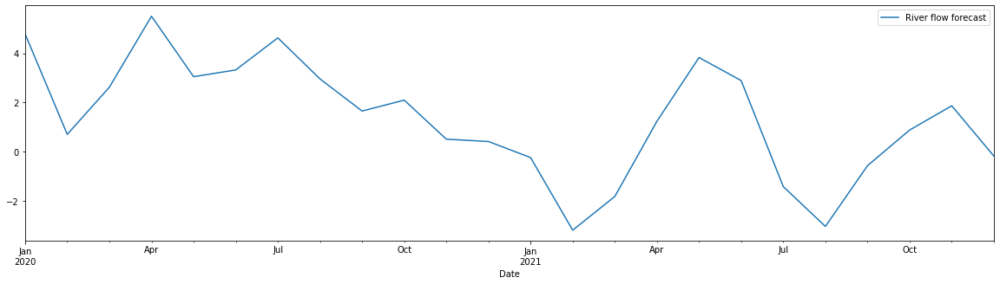


 ################ Basin 22 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


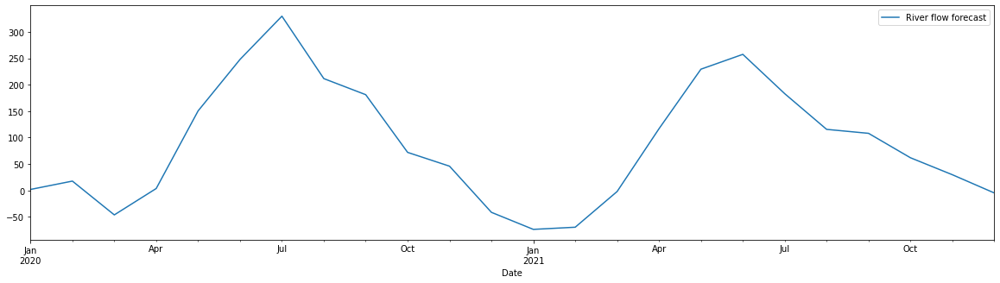


 ################ Basin 23 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


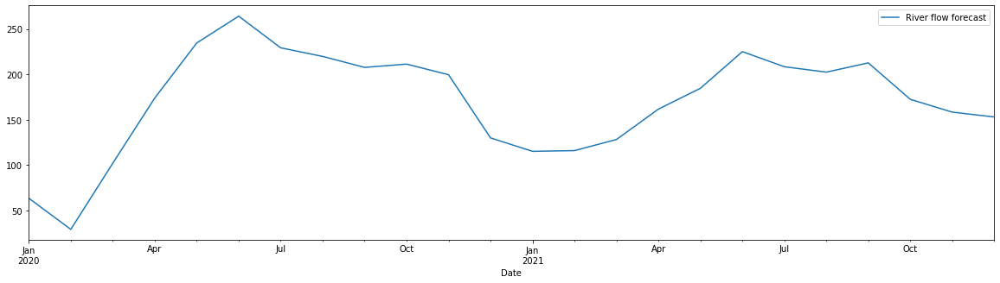


 ################ Basin 24 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


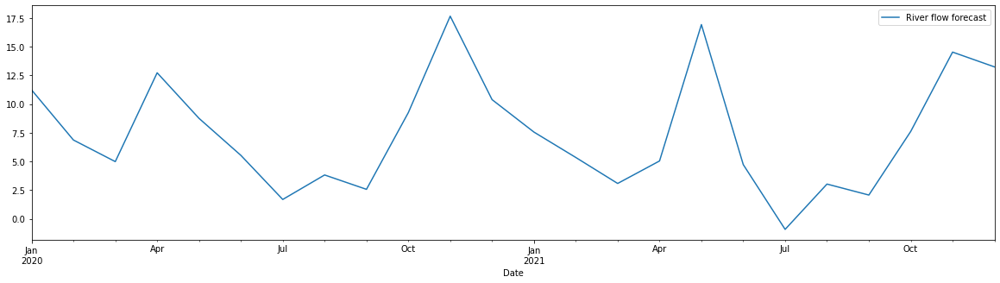


 ################ Basin 25 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


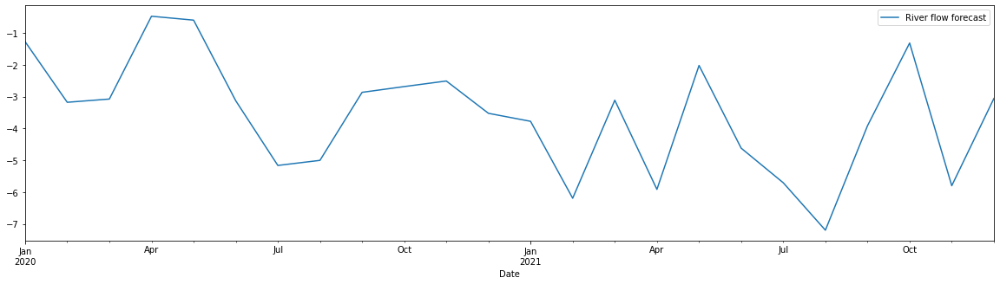


 ################ Basin 26 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


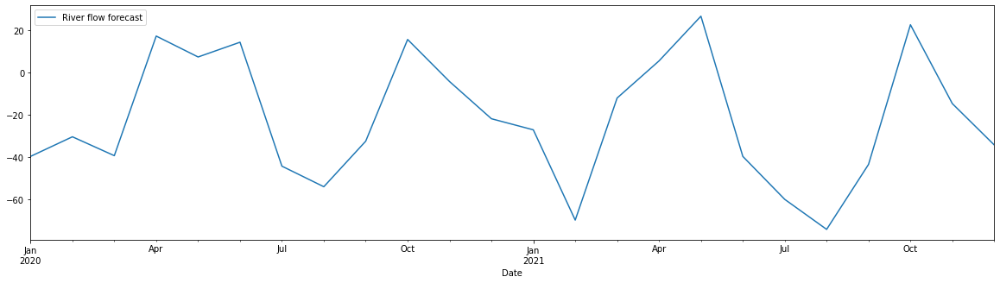


 ################ Basin 27 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


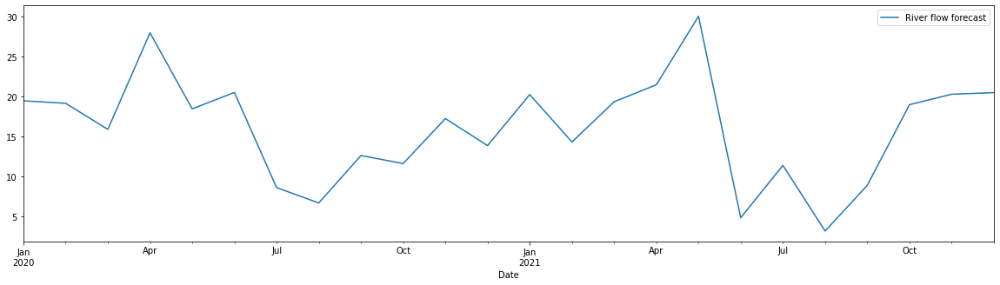


 ################ Basin 28 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


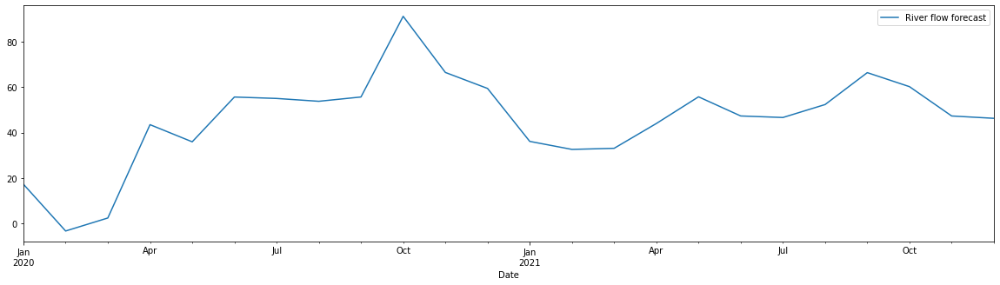


 ################ Basin 29 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


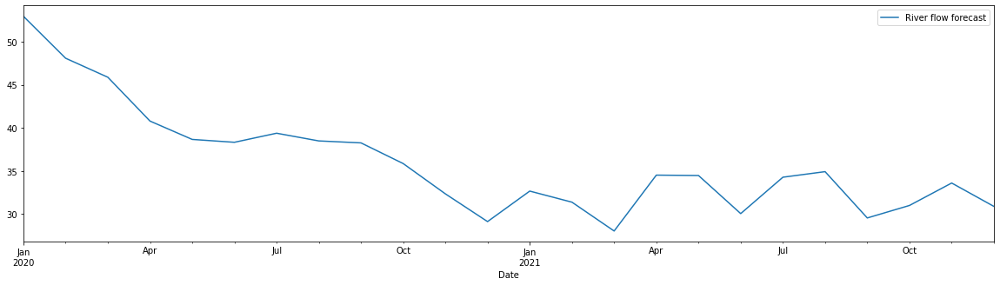


 ################ Basin 30 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


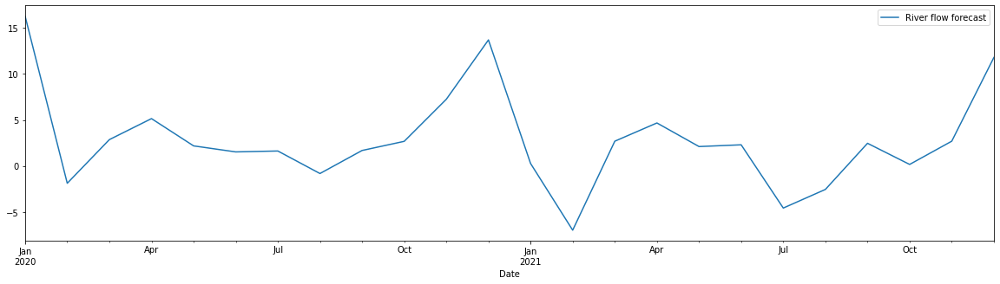


 ################ Basin 31 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


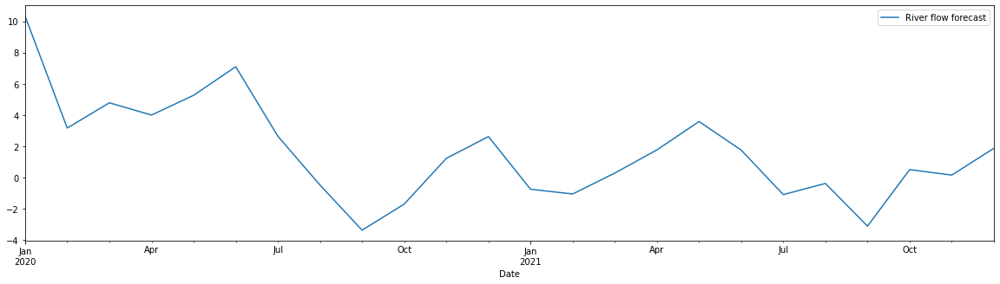


 ################ Basin 32 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


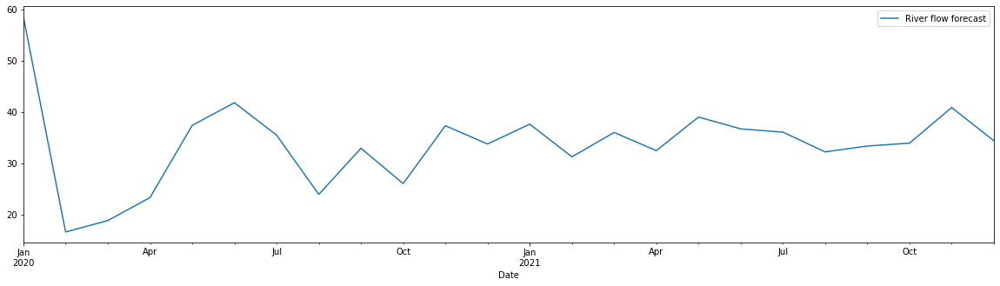


 ################ Basin 33 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


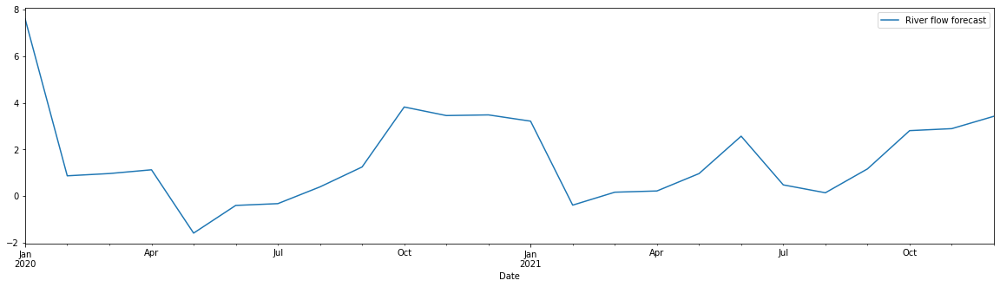


 ################ Basin 34 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


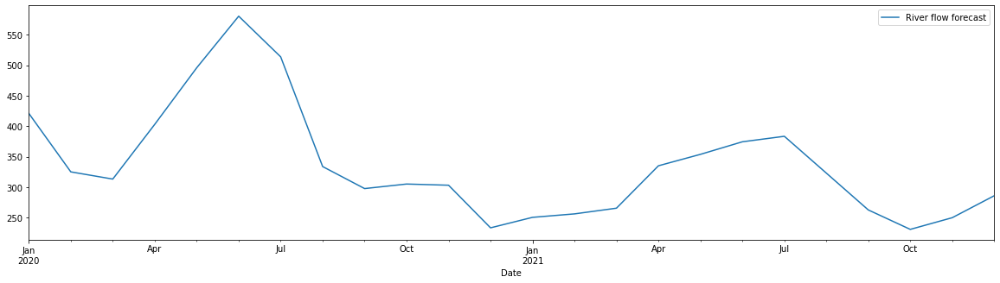


 ################ Basin 35 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


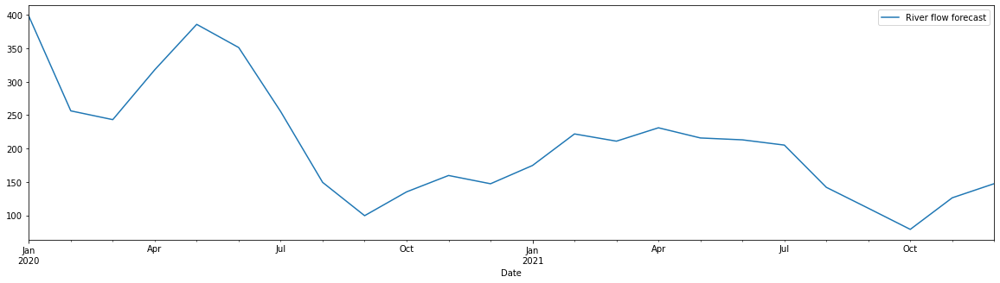


 ################ Basin 36 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


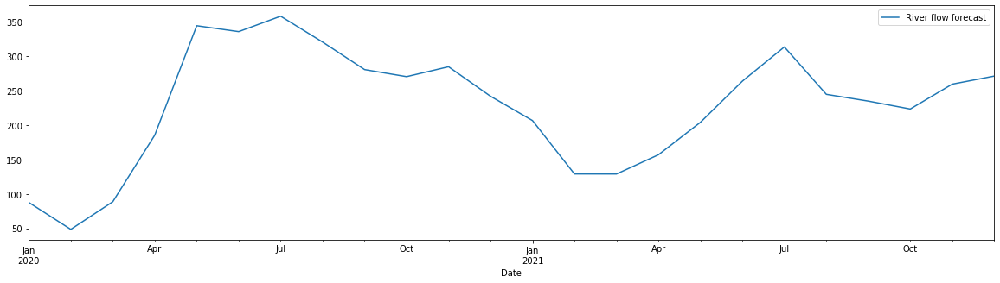


 ################ Basin 37 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


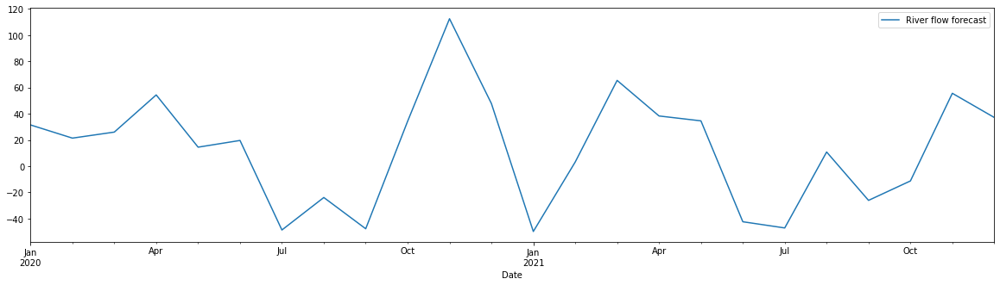


 ################ Basin 38 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


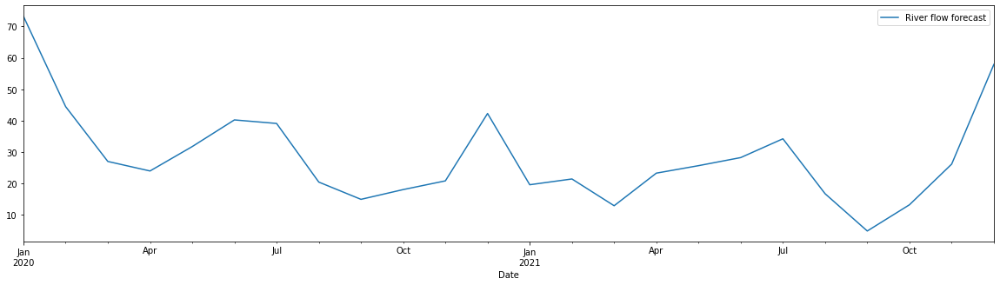


 ################ Basin 39 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


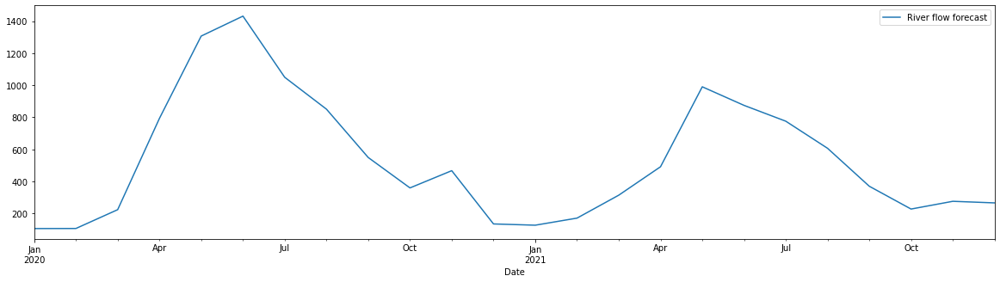


 ################ Basin 40 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


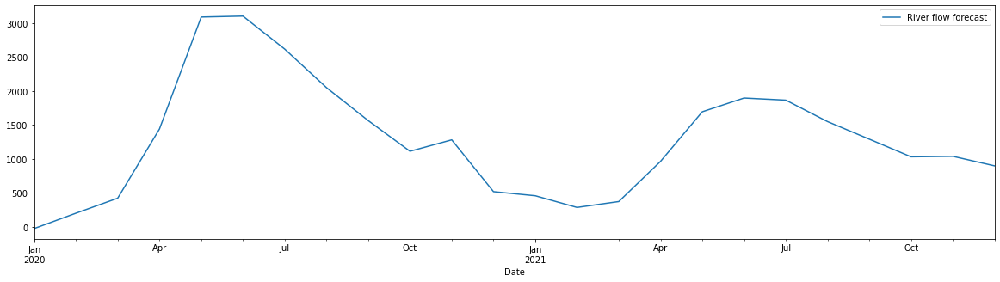


 ################ Basin 41 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


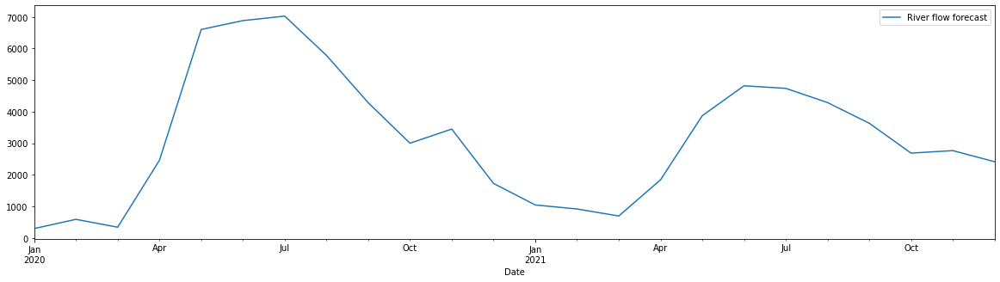


 ################ Basin 42 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


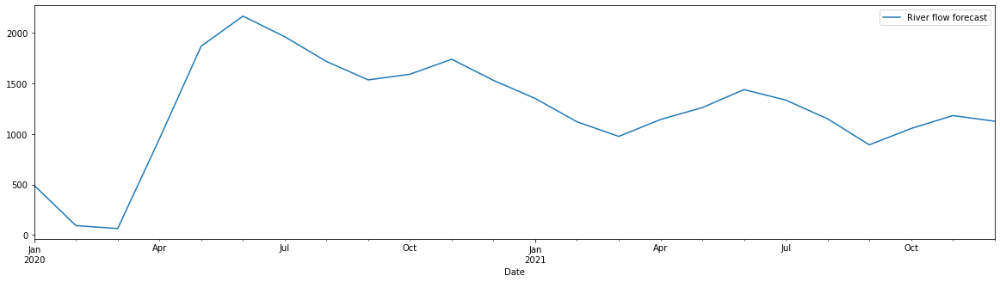


 ################ Basin 43 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


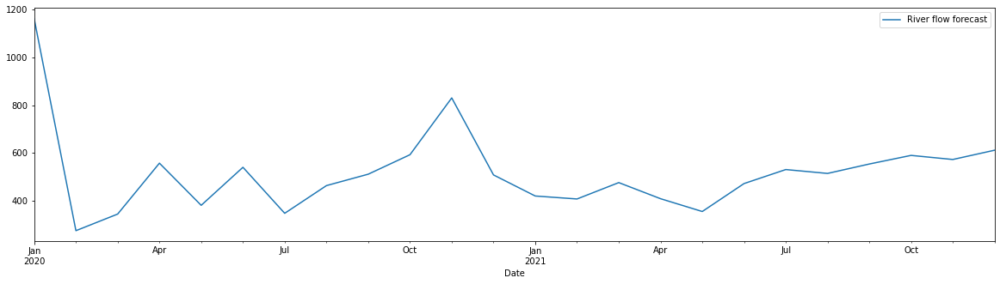


 ################ Basin 44 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


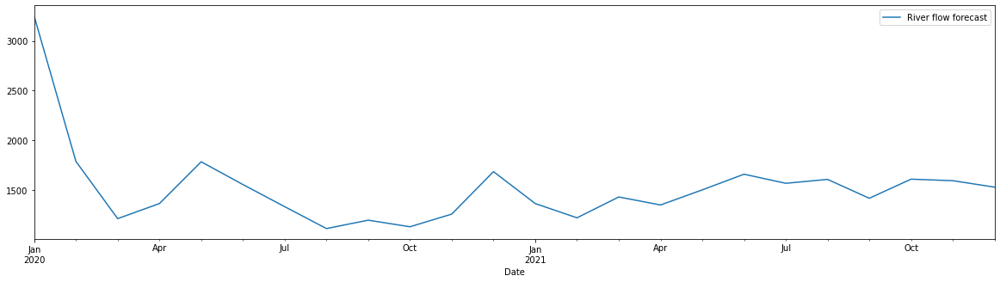


 ################ Basin 45 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


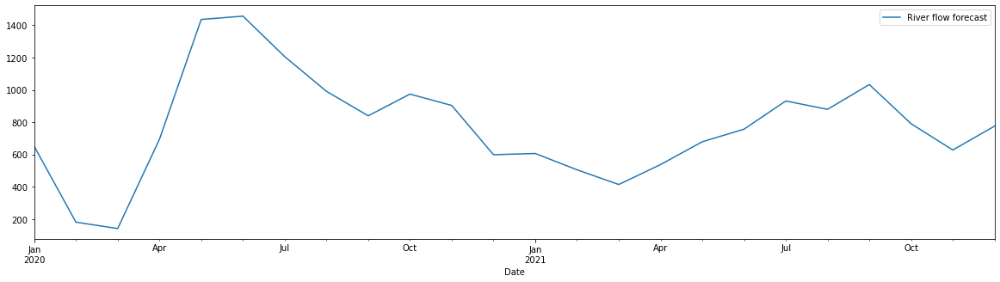


 ################ Basin 46 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


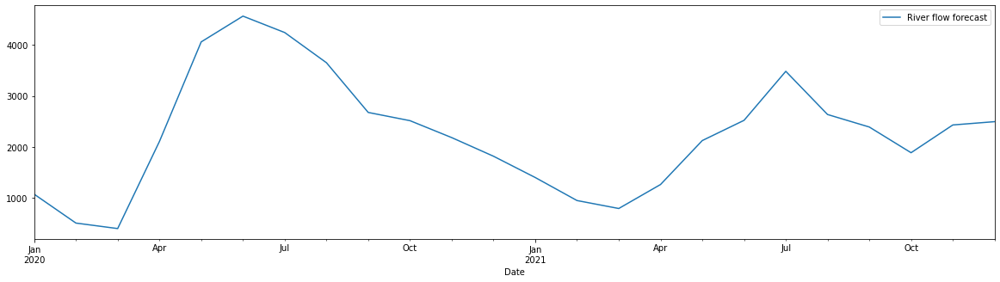


 ################ Basin 47 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


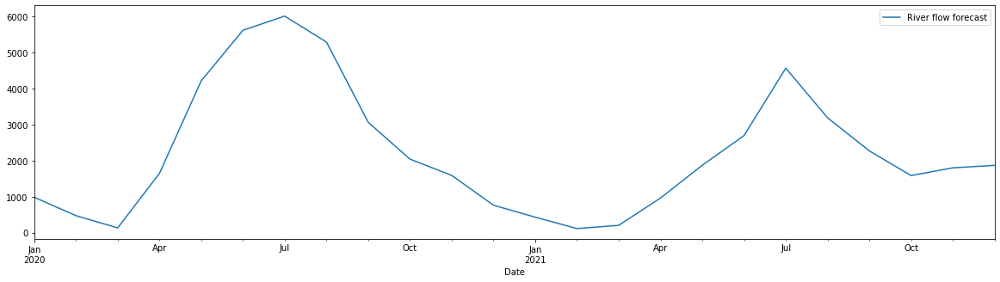


 ################ Basin 48 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


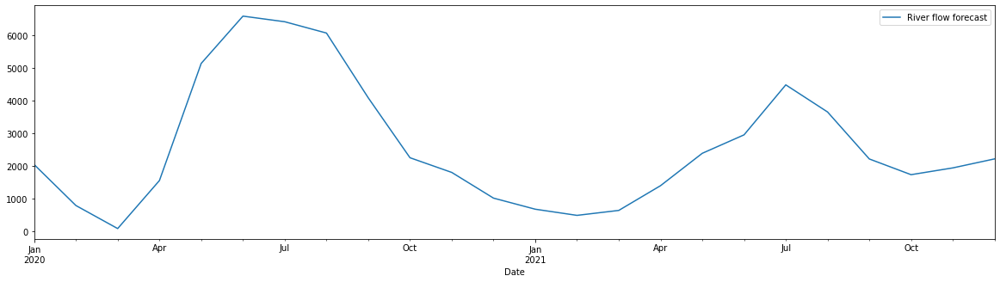

Def_100%
P_A1

 ################ Basin 1 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


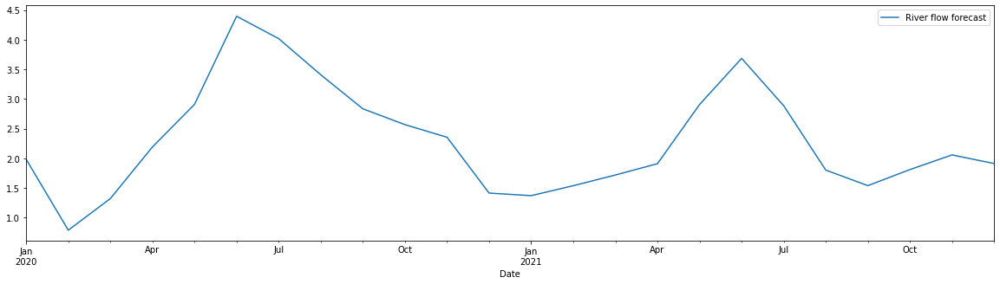


 ################ Basin 2 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


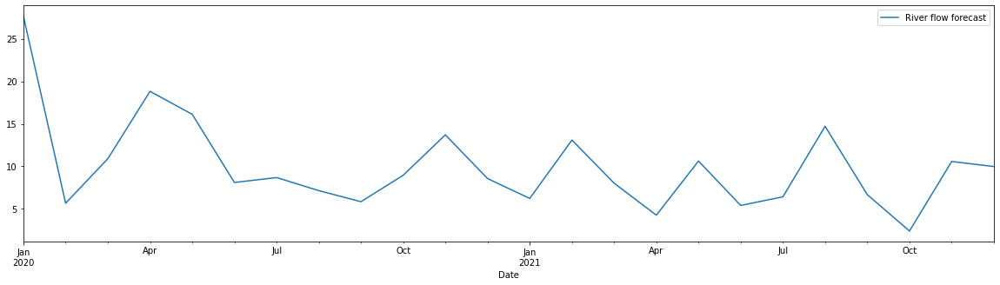


 ################ Basin 3 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


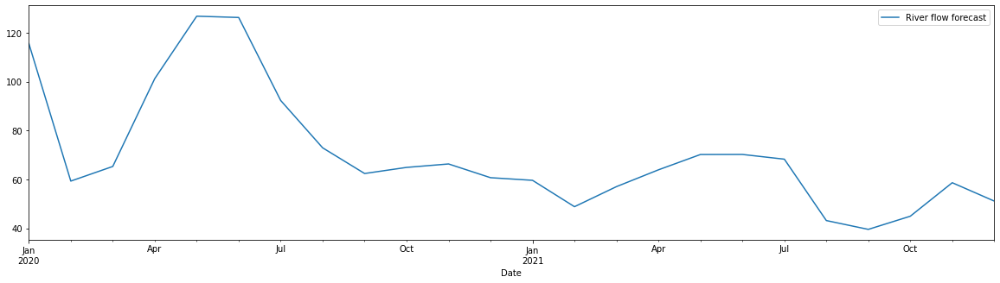


 ################ Basin 4 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


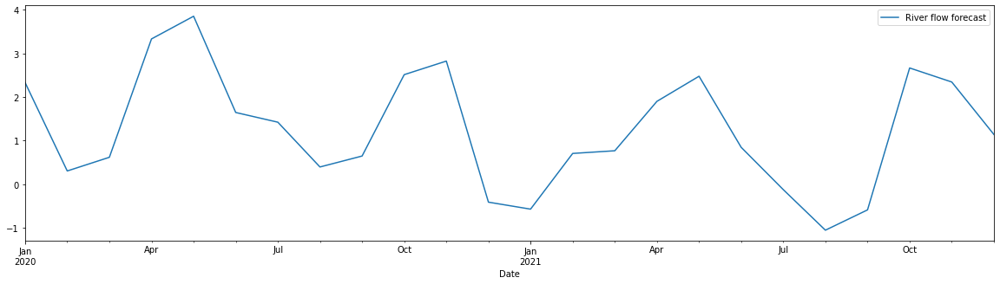


 ################ Basin 5 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


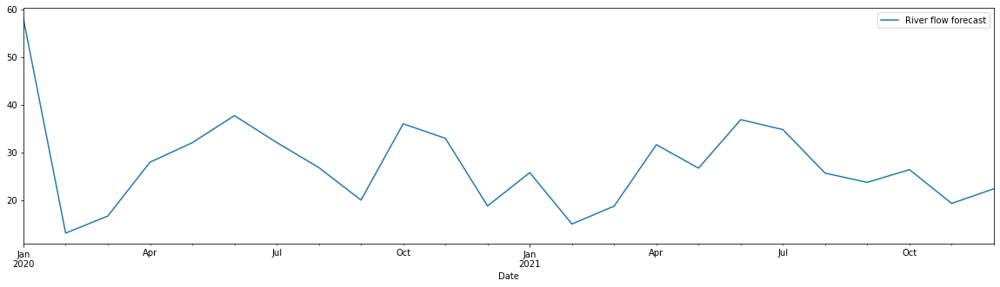


 ################ Basin 6 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


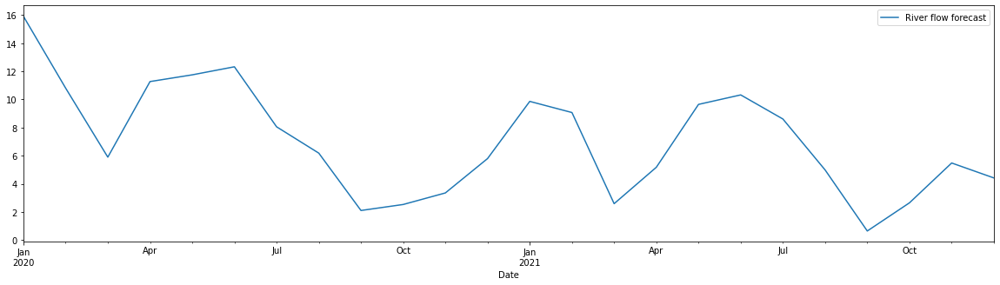


 ################ Basin 7 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


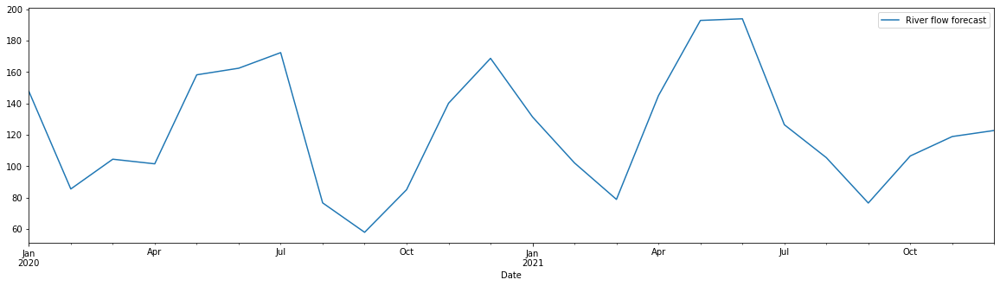


 ################ Basin 8 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


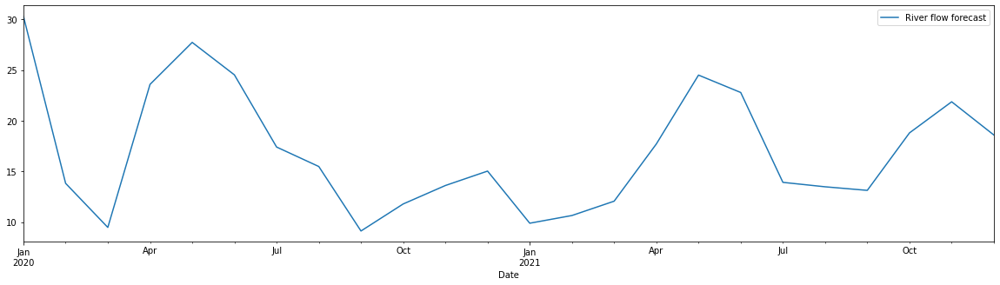


 ################ Basin 9 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


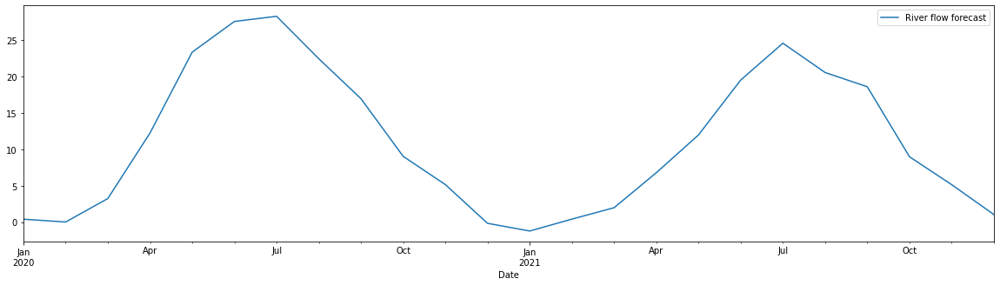


 ################ Basin 10 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


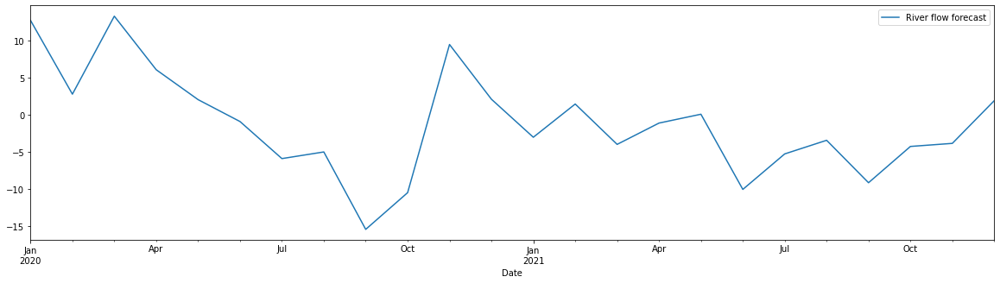


 ################ Basin 11 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


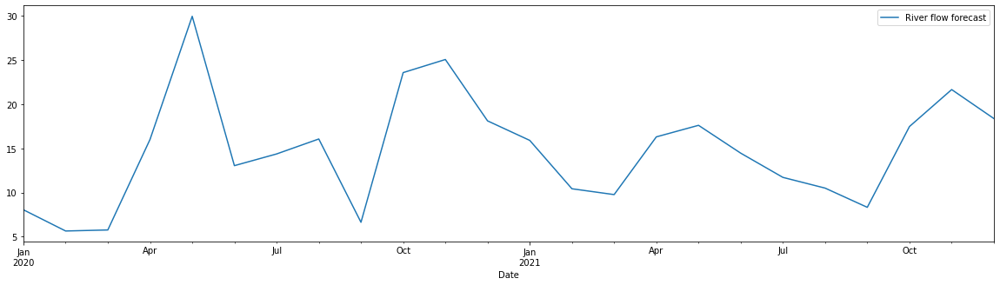


 ################ Basin 12 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


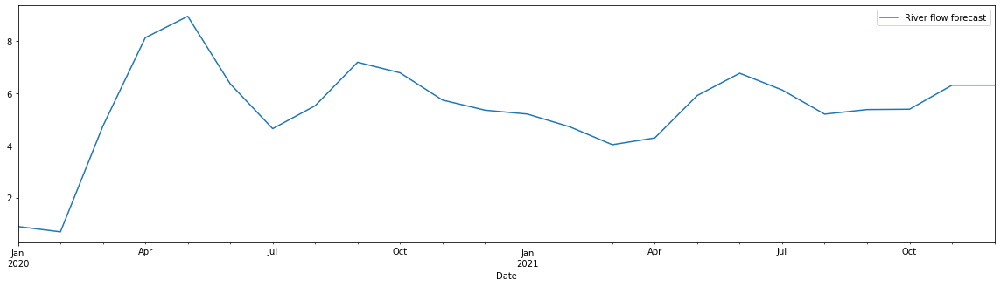


 ################ Basin 13 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


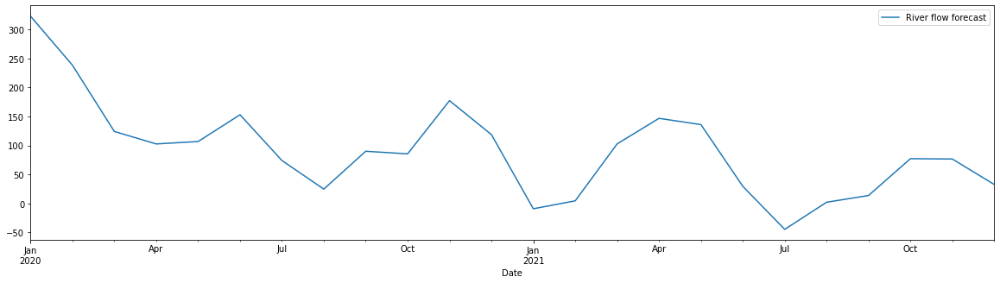


 ################ Basin 14 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


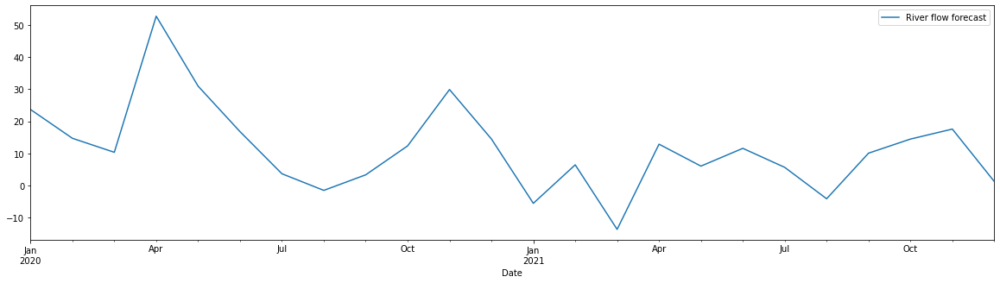


 ################ Basin 15 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


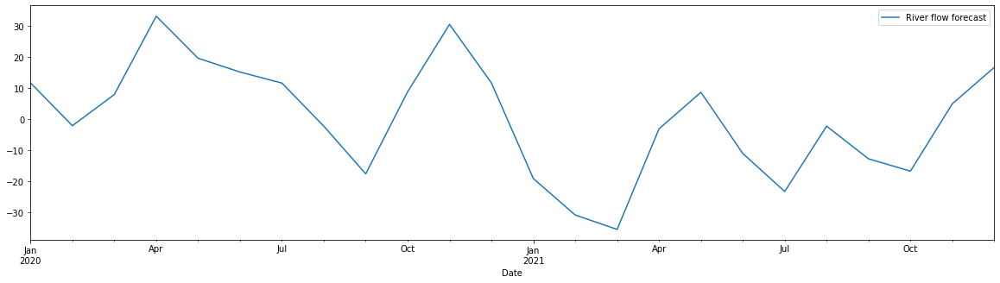


 ################ Basin 16 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


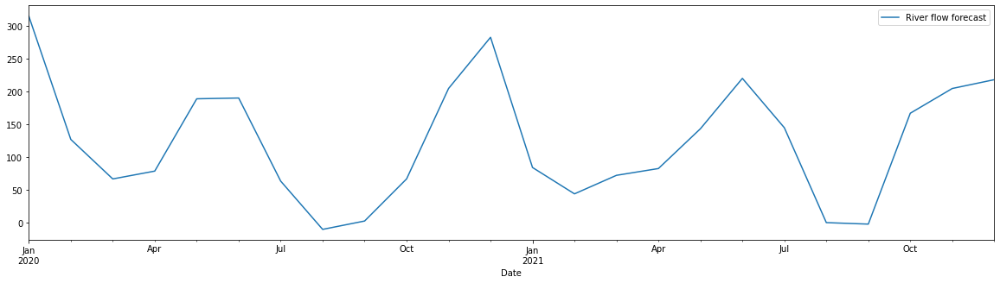


 ################ Basin 17 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


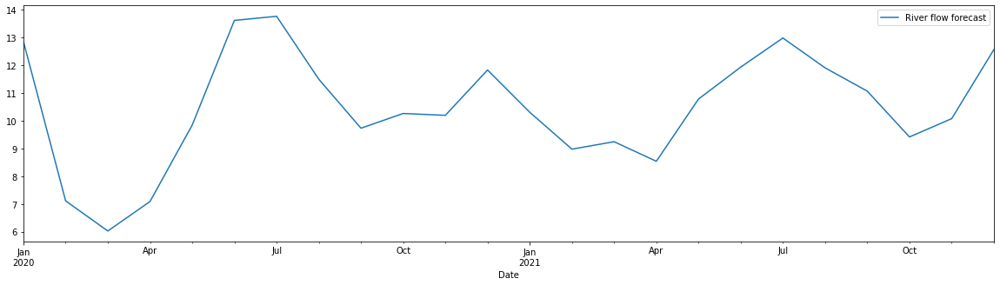


 ################ Basin 18 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


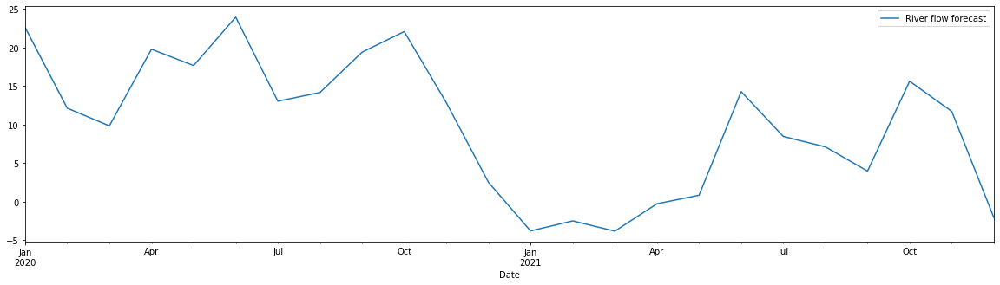


 ################ Basin 19 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


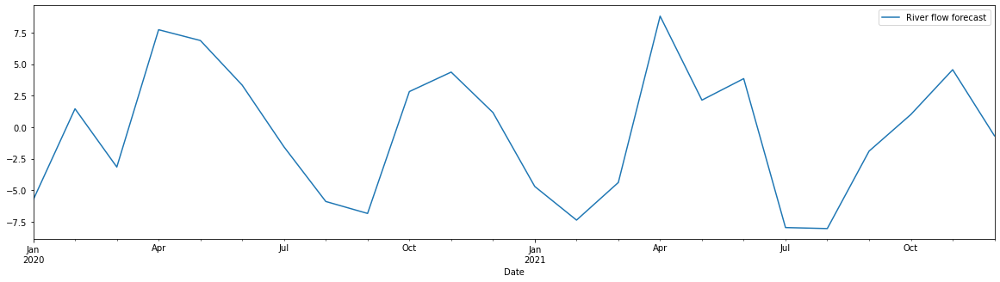


 ################ Basin 20 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


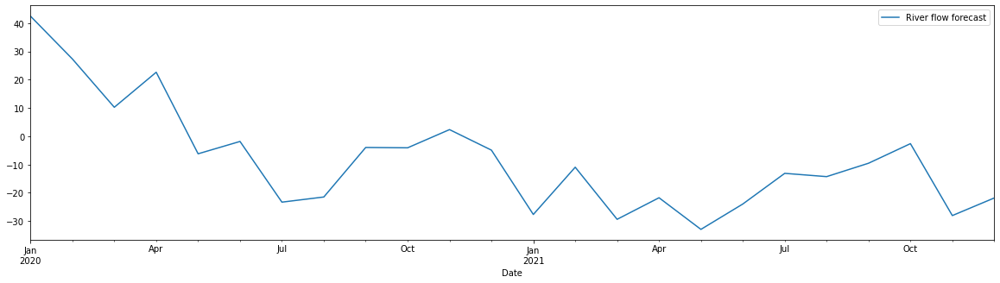


 ################ Basin 21 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


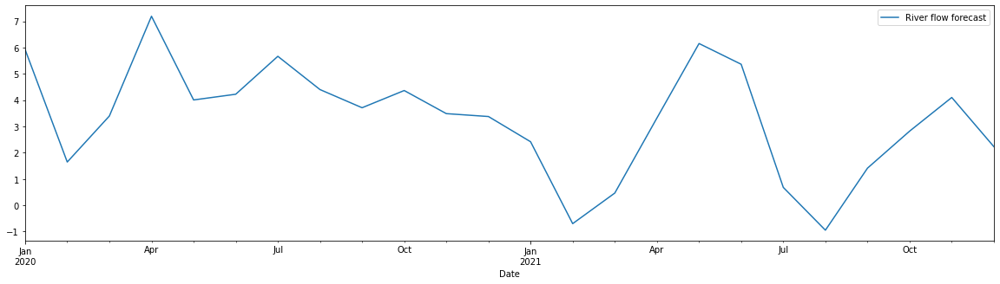


 ################ Basin 22 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


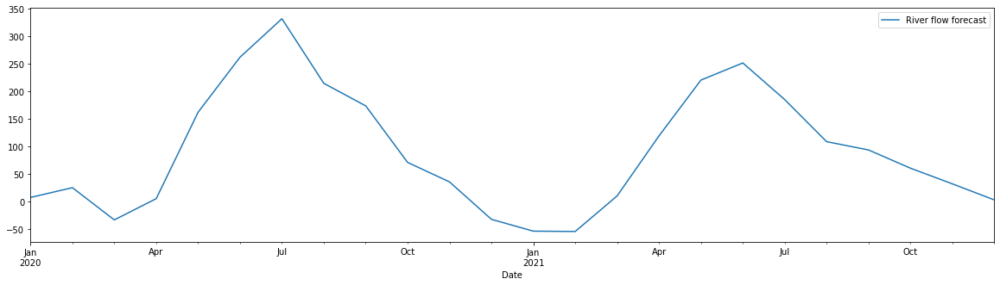


 ################ Basin 23 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


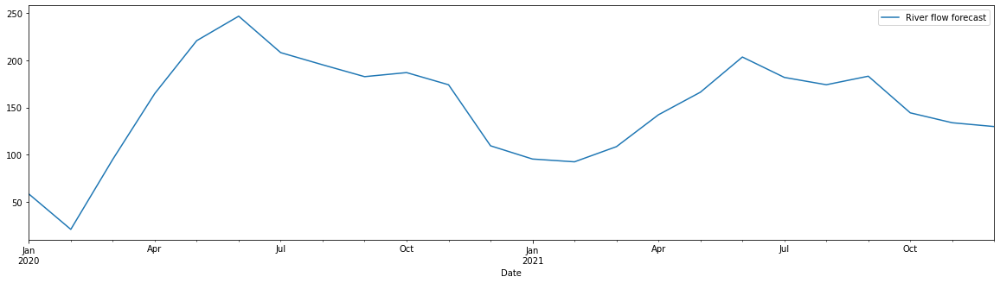


 ################ Basin 24 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


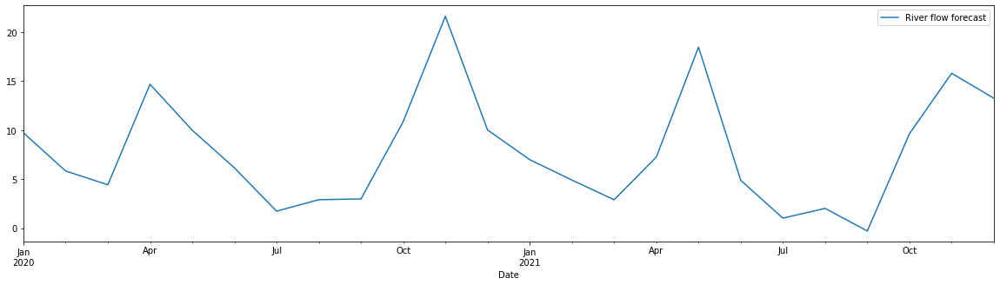


 ################ Basin 25 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


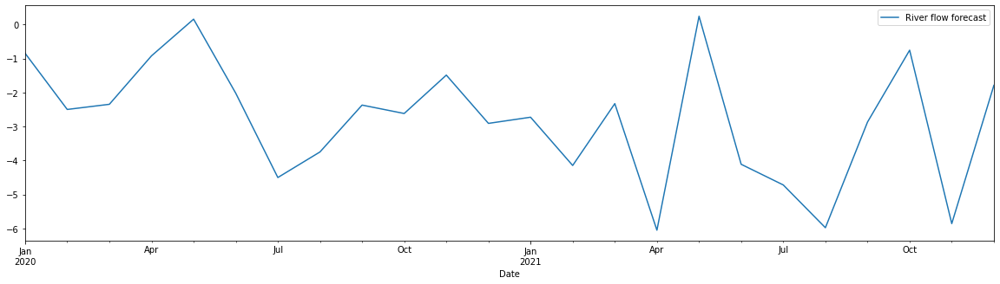


 ################ Basin 26 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


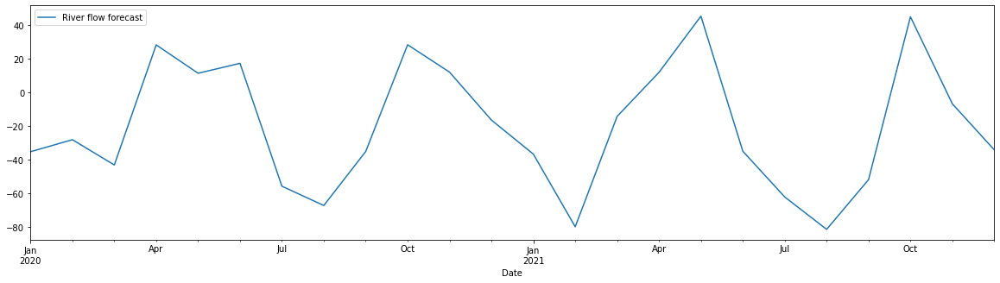


 ################ Basin 27 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


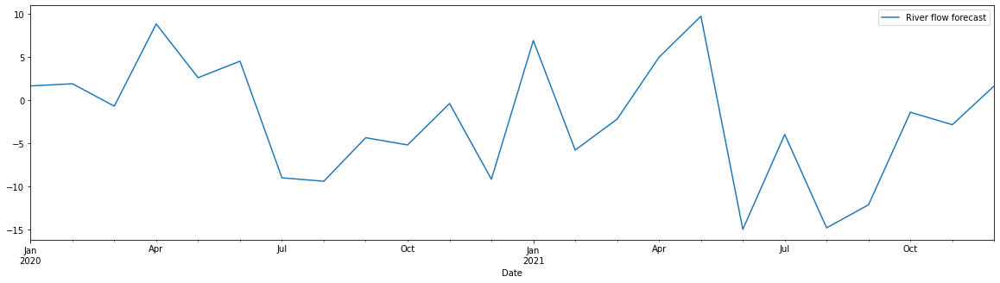


 ################ Basin 28 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


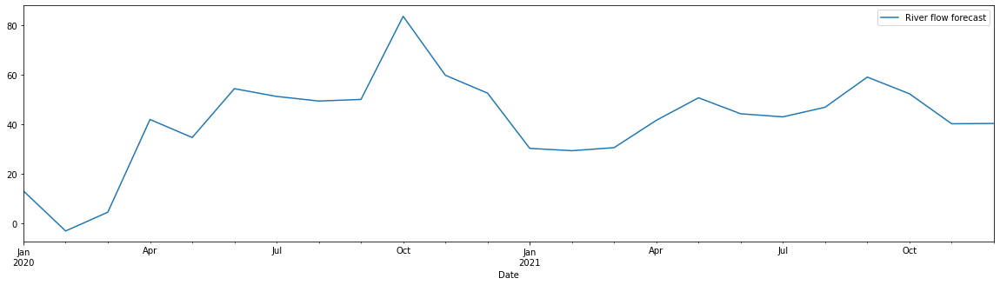


 ################ Basin 29 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


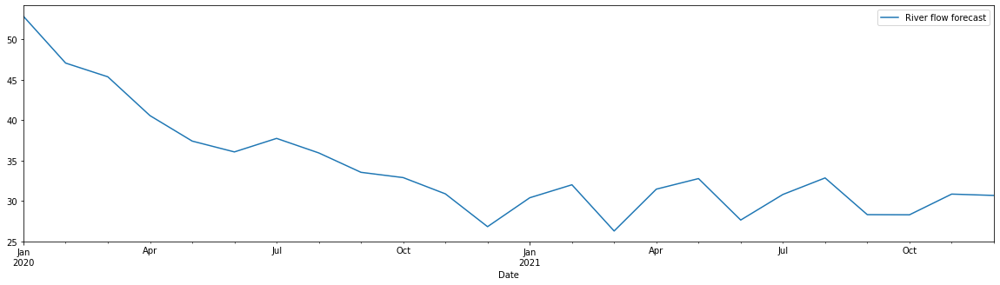


 ################ Basin 30 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


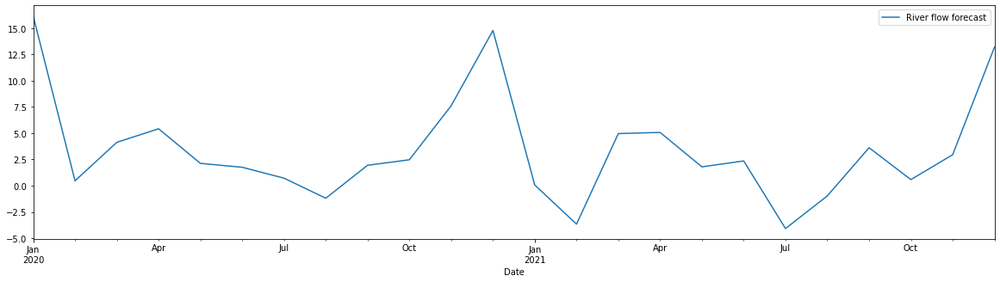


 ################ Basin 31 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


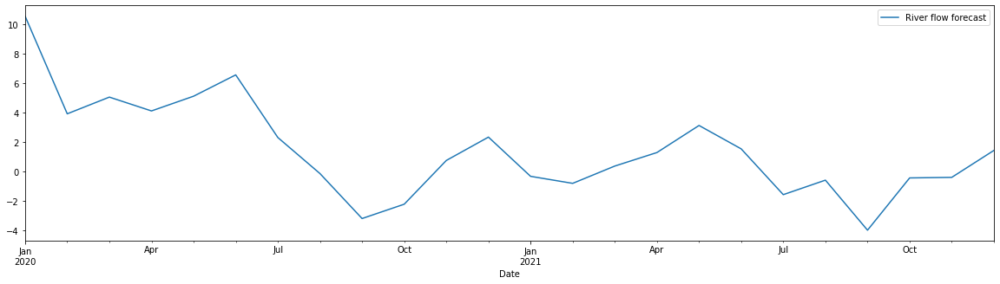


 ################ Basin 32 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


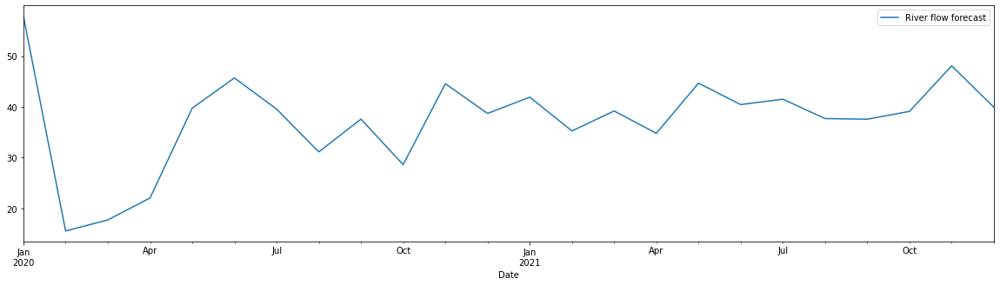


 ################ Basin 33 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


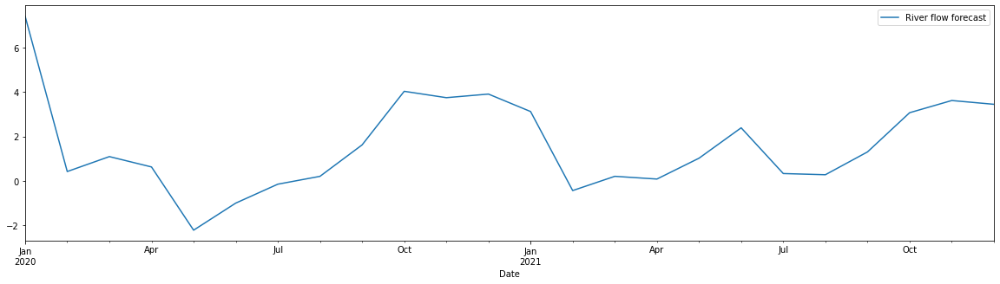


 ################ Basin 34 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


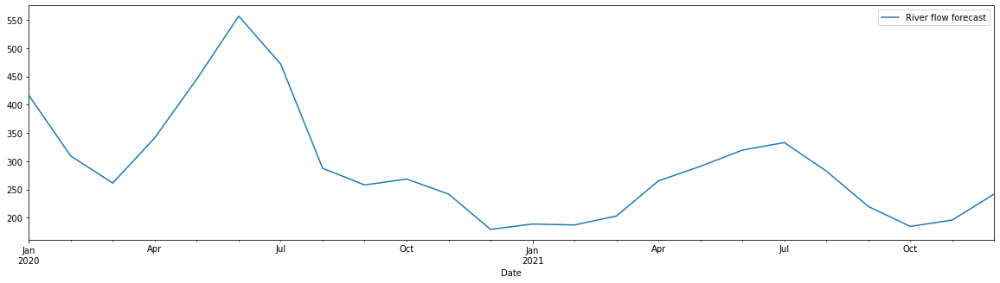


 ################ Basin 35 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


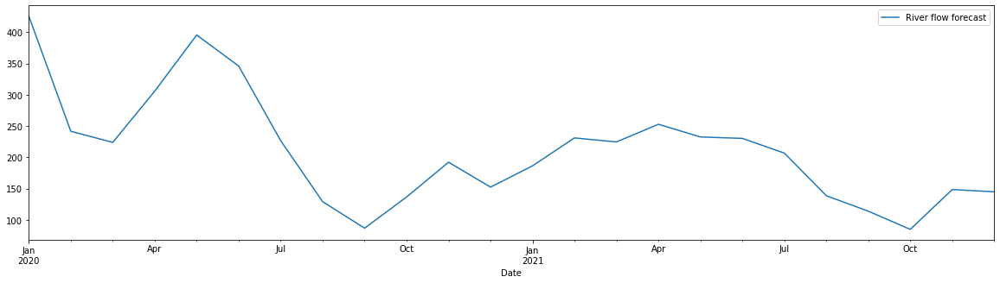


 ################ Basin 36 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


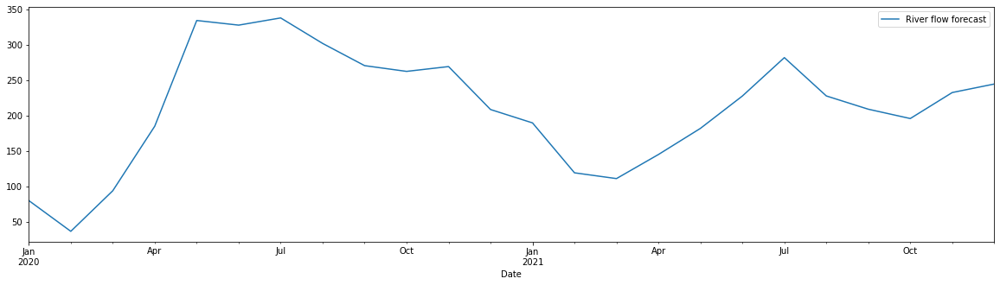


 ################ Basin 37 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


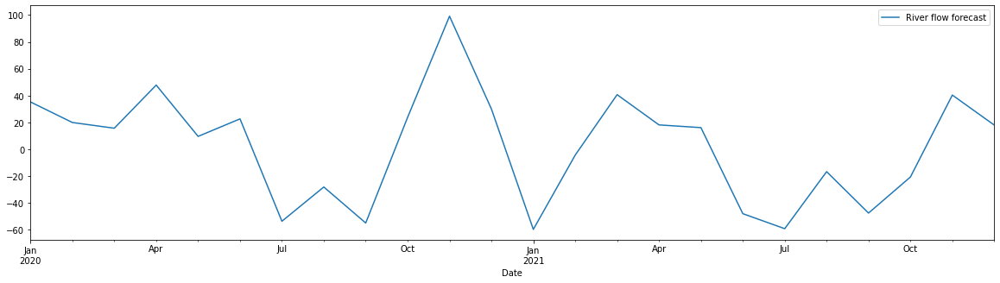


 ################ Basin 38 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


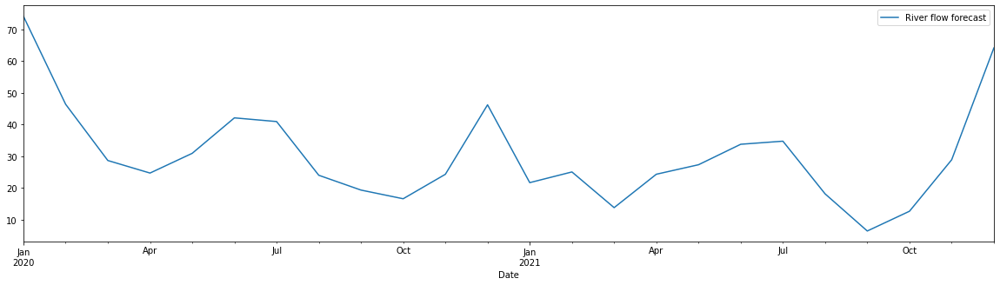


 ################ Basin 39 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


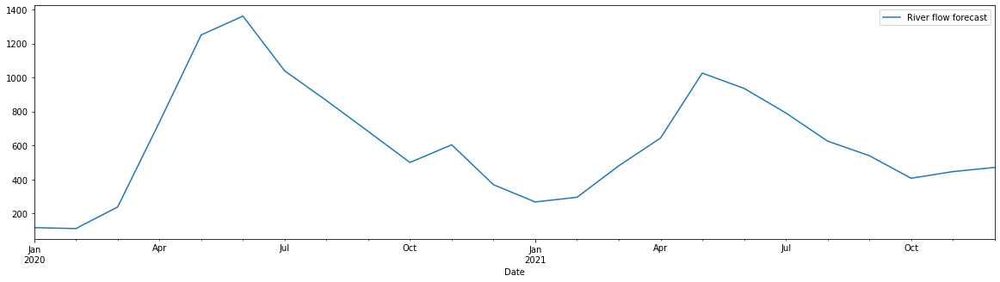


 ################ Basin 40 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


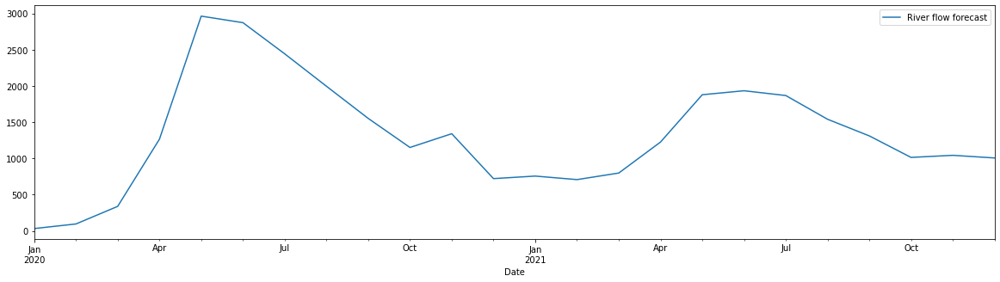


 ################ Basin 41 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


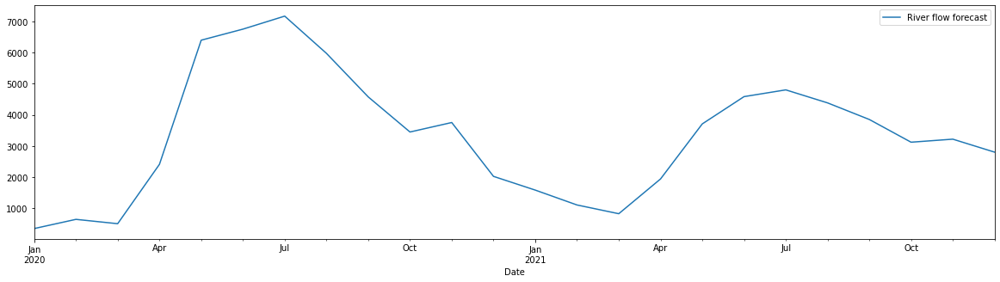


 ################ Basin 42 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


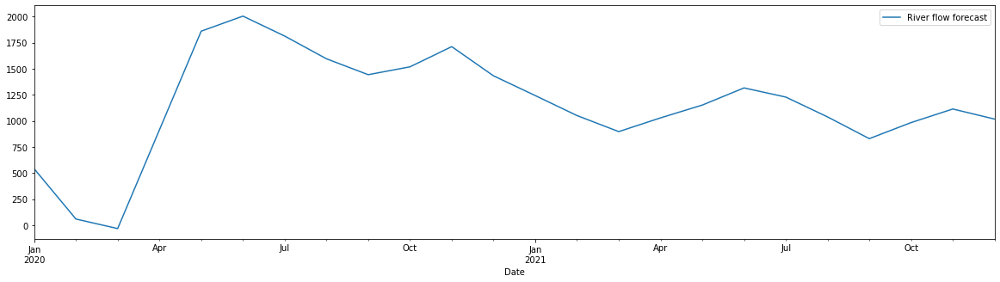


 ################ Basin 43 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


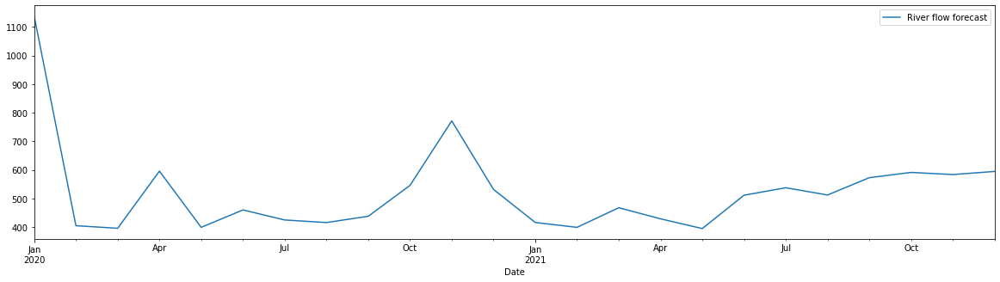


 ################ Basin 44 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


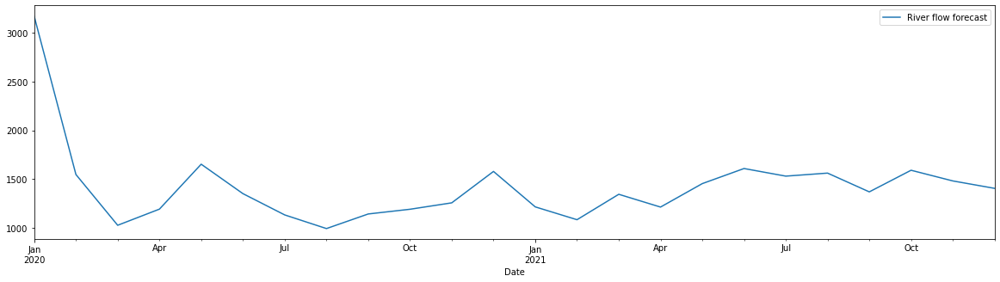


 ################ Basin 45 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


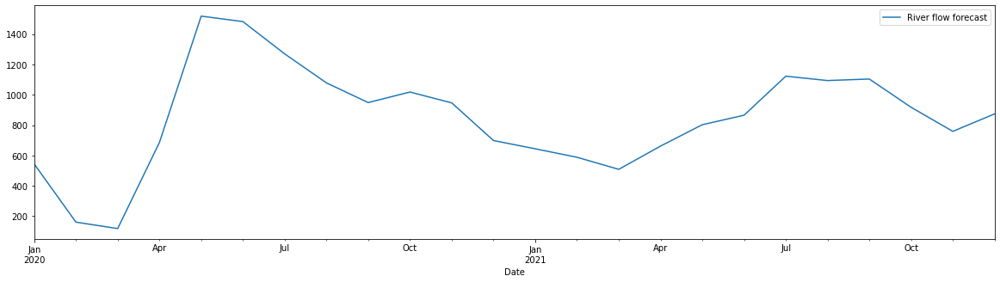


 ################ Basin 46 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


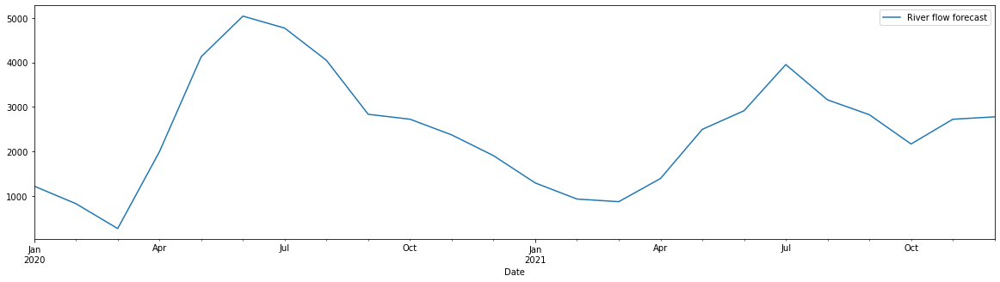


 ################ Basin 47 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


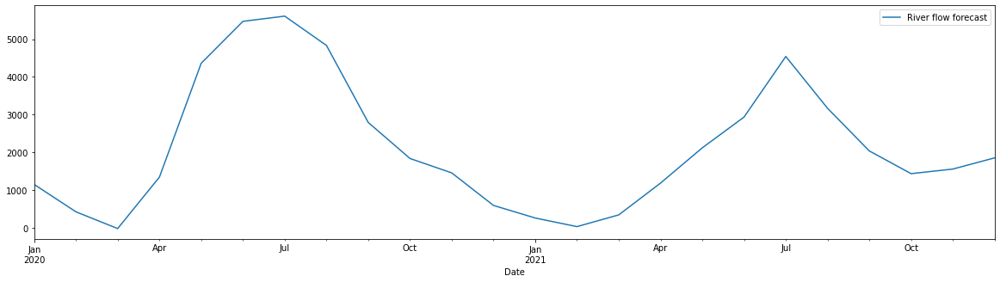


 ################ Basin 48 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


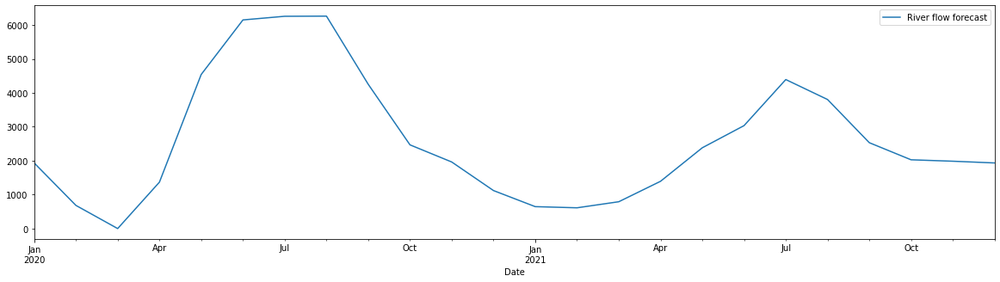

Def_100%
P_A2

 ################ Basin 1 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


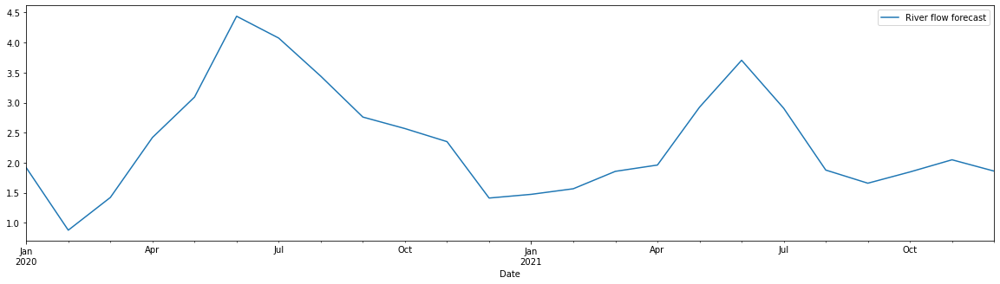


 ################ Basin 2 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


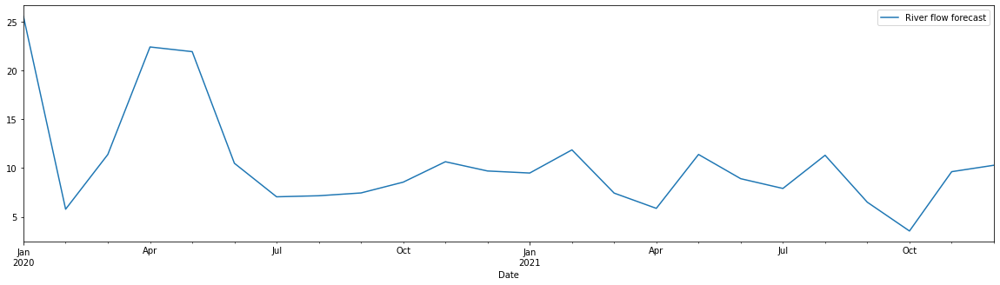


 ################ Basin 3 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


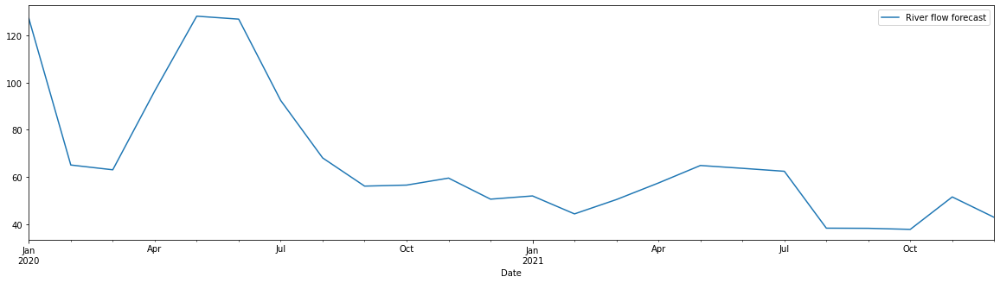


 ################ Basin 4 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


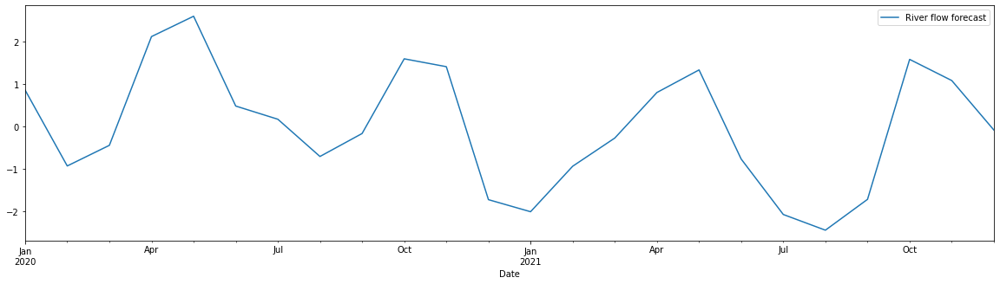


 ################ Basin 5 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


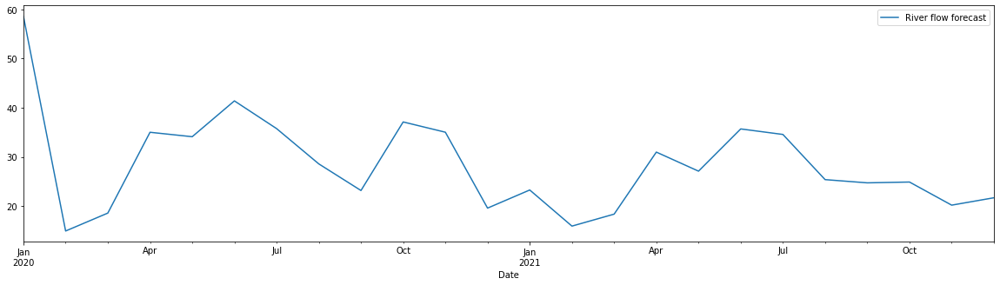


 ################ Basin 6 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


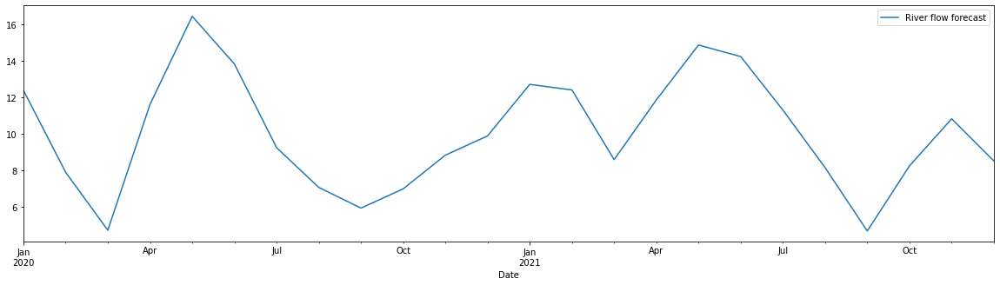


 ################ Basin 7 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


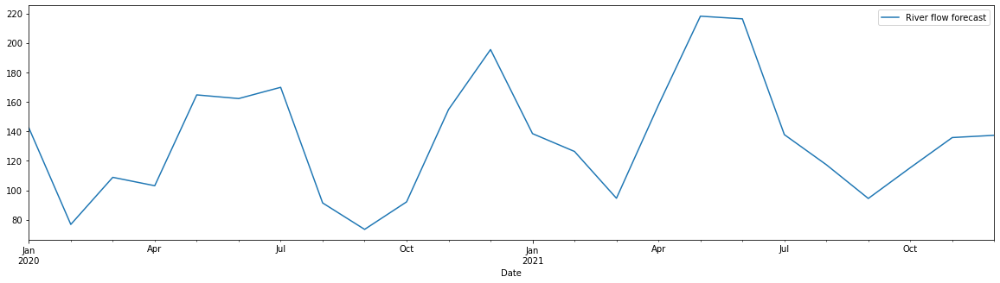


 ################ Basin 8 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


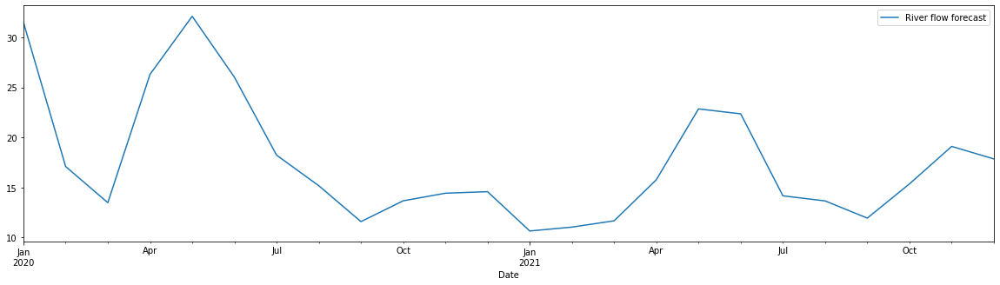


 ################ Basin 9 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


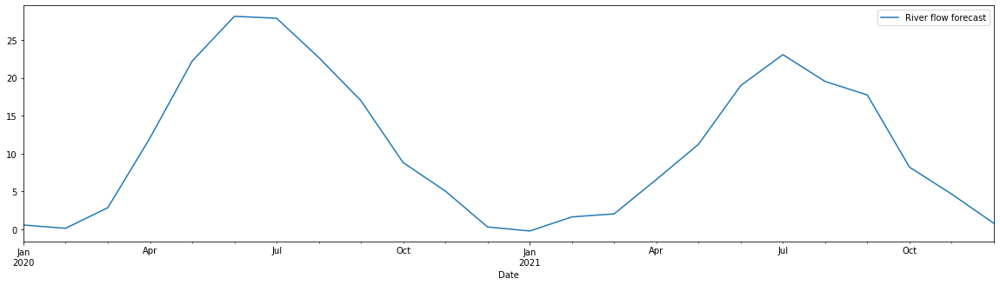


 ################ Basin 10 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


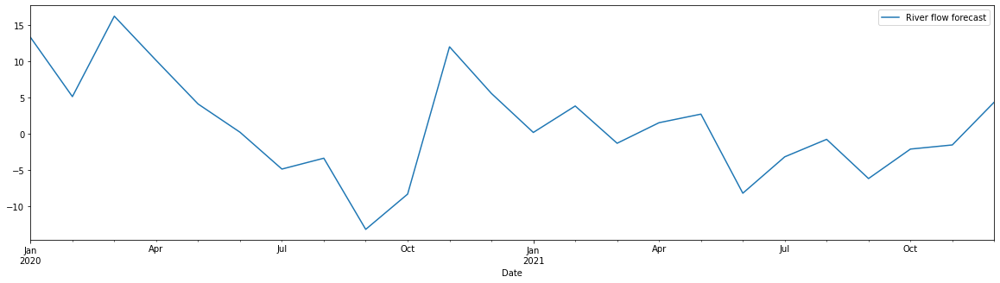


 ################ Basin 11 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


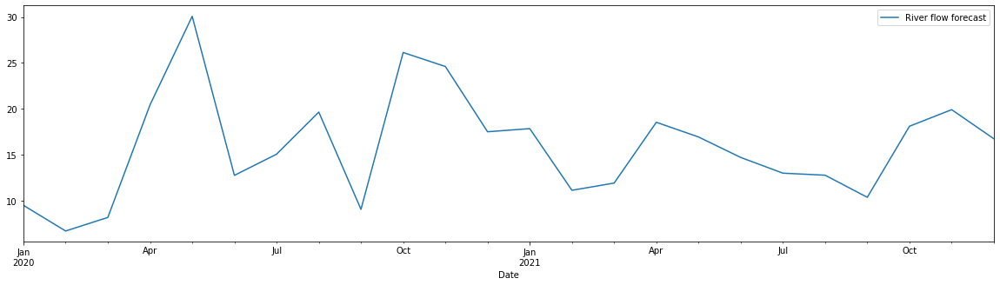


 ################ Basin 12 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


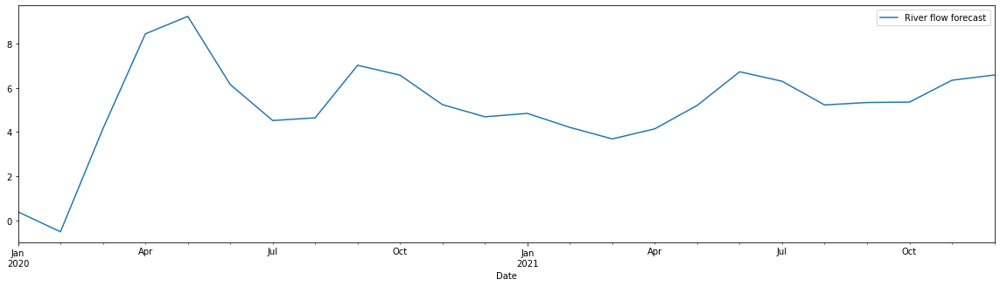


 ################ Basin 13 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


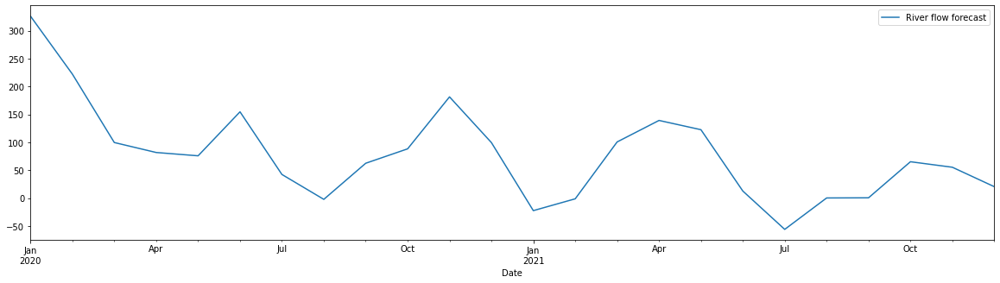


 ################ Basin 14 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


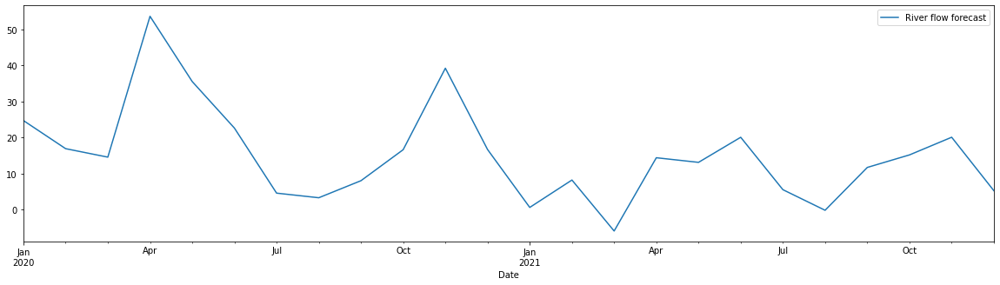


 ################ Basin 15 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


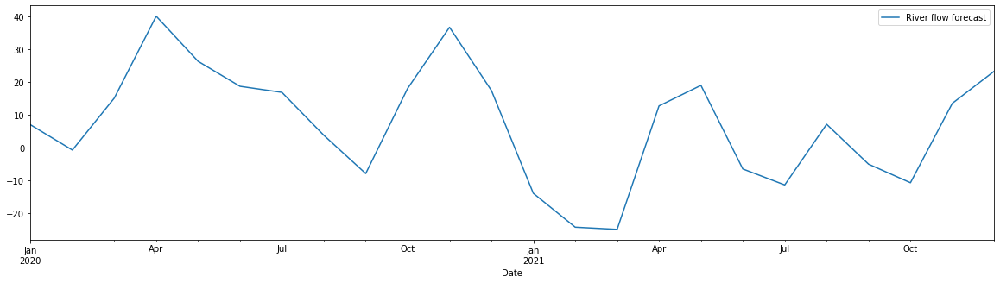


 ################ Basin 16 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


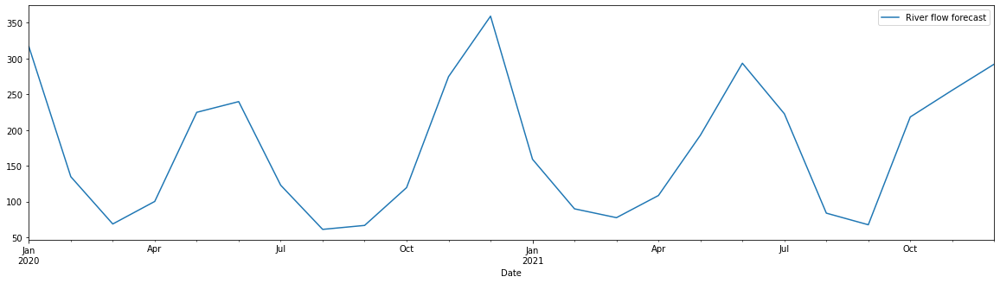


 ################ Basin 17 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


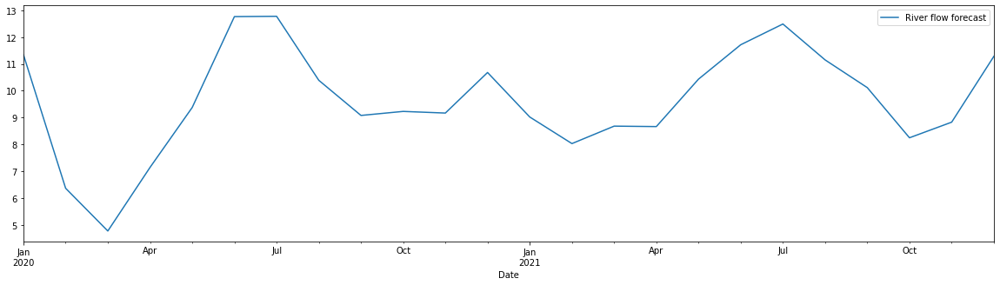


 ################ Basin 18 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


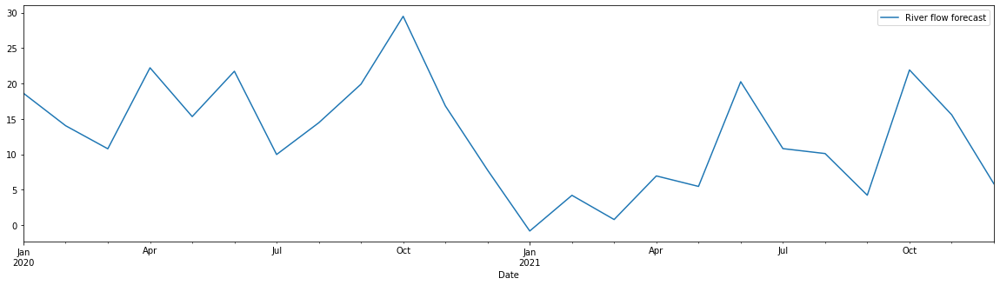


 ################ Basin 19 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


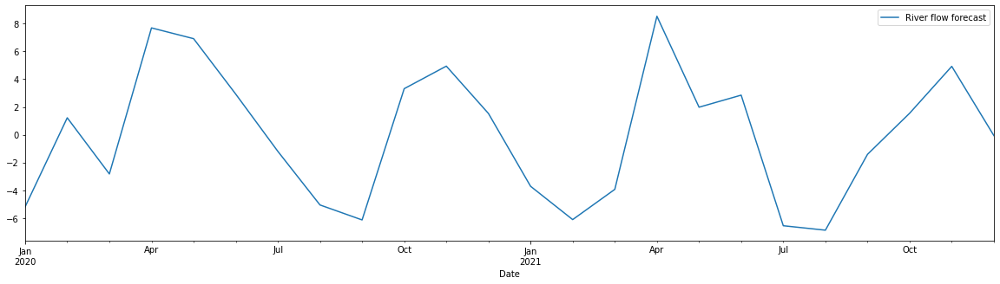


 ################ Basin 20 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


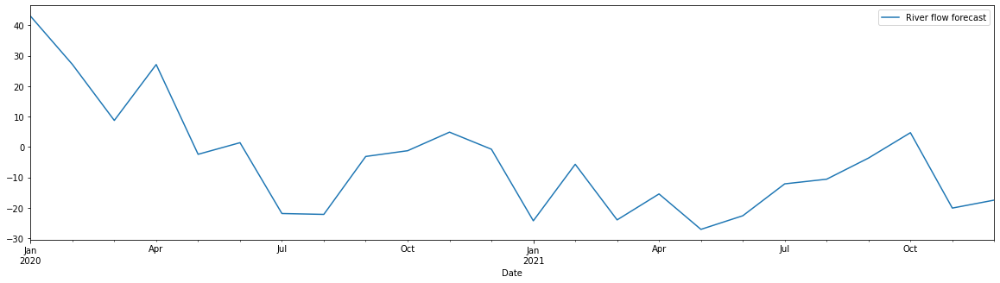


 ################ Basin 21 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


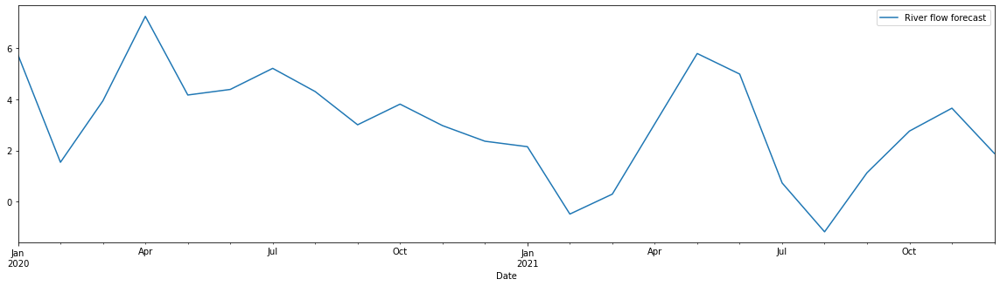


 ################ Basin 22 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


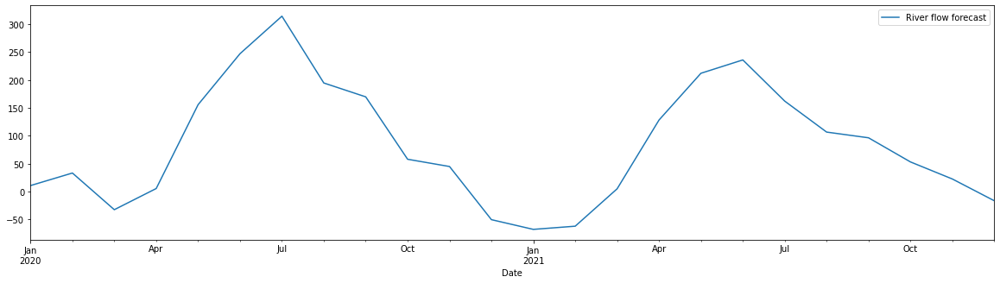


 ################ Basin 23 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


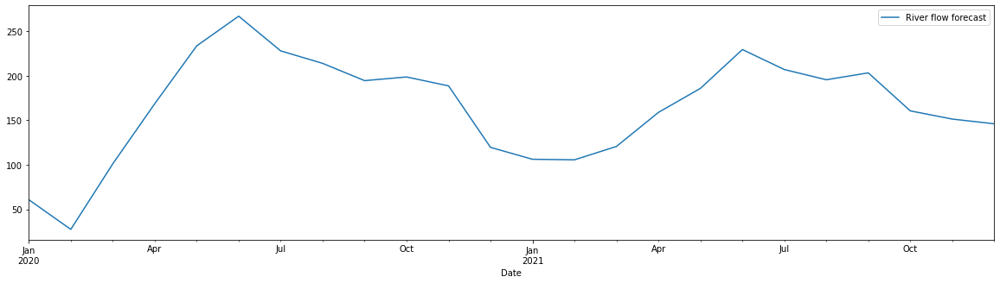


 ################ Basin 24 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


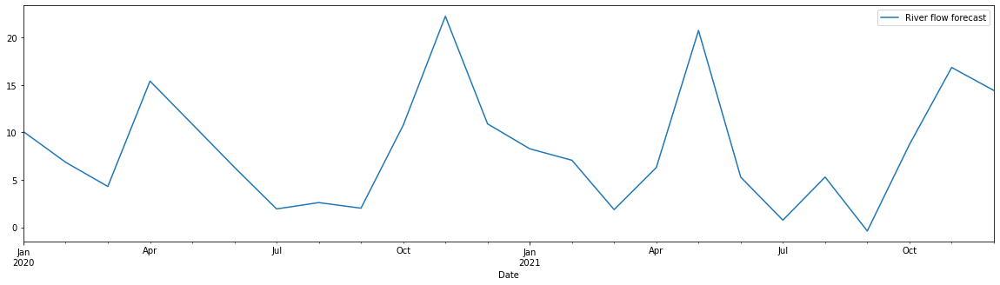


 ################ Basin 25 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


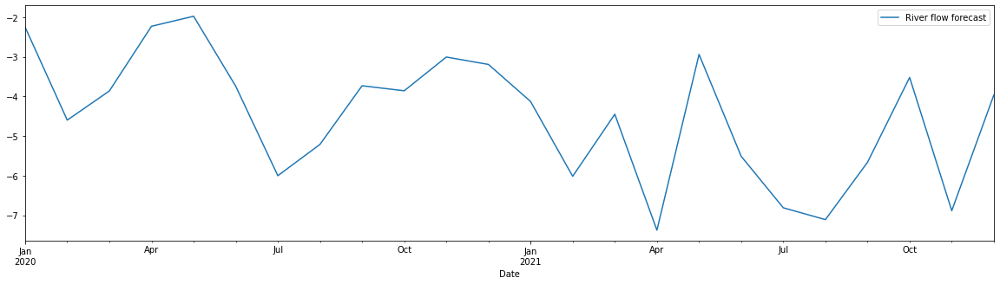


 ################ Basin 26 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


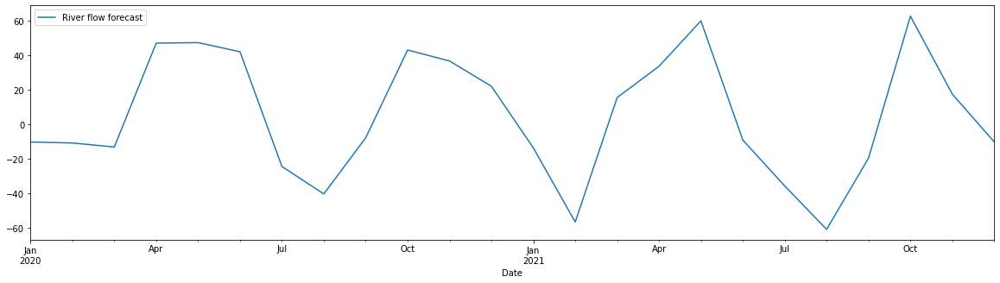


 ################ Basin 27 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


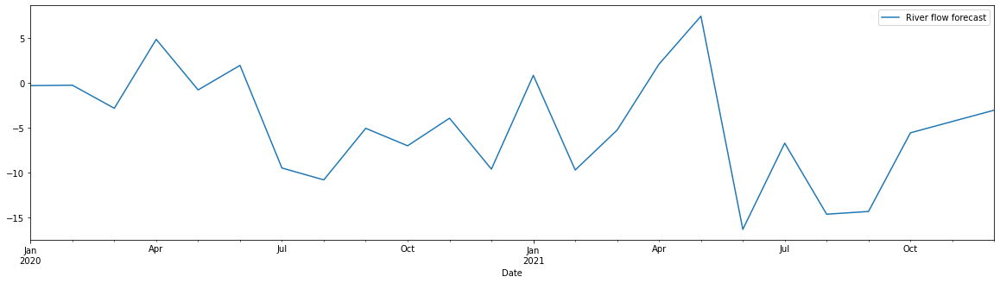


 ################ Basin 28 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


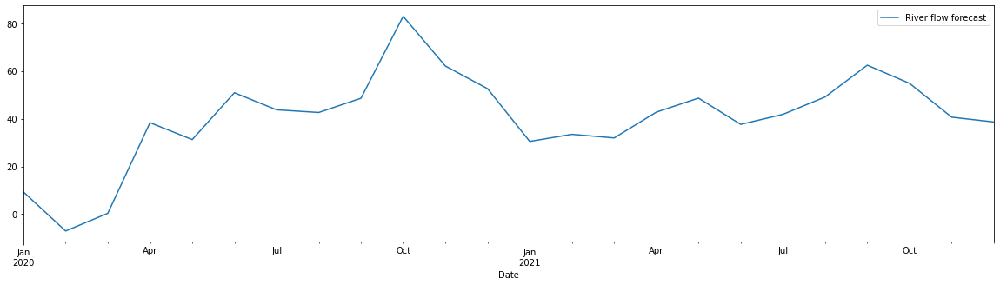


 ################ Basin 29 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


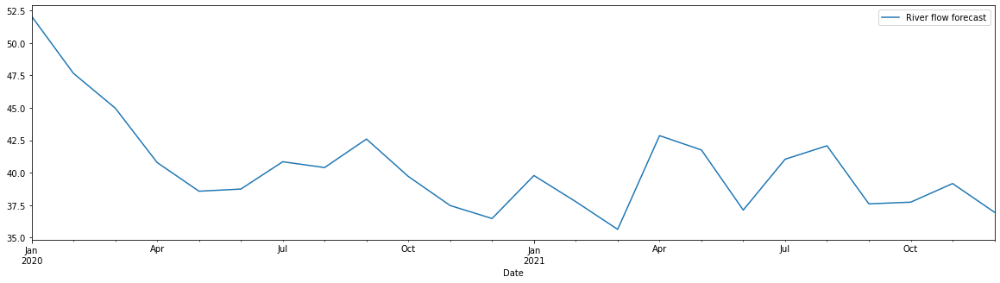


 ################ Basin 30 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


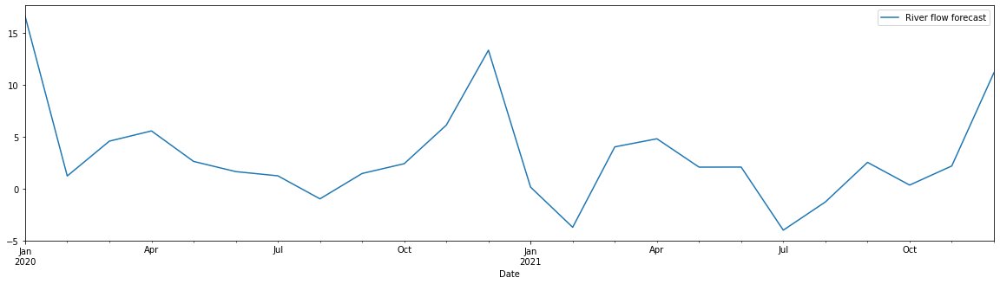


 ################ Basin 31 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


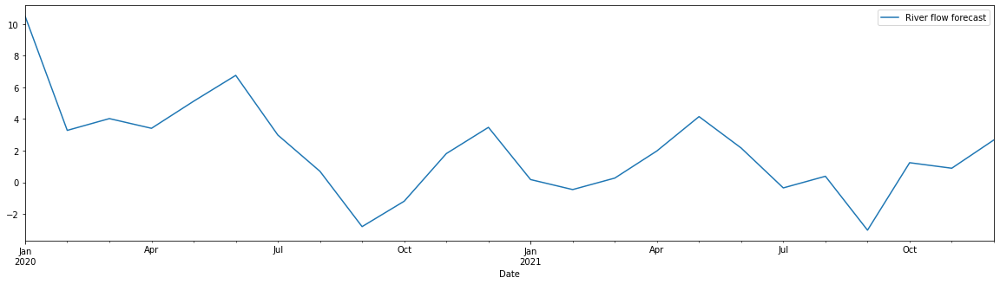


 ################ Basin 32 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


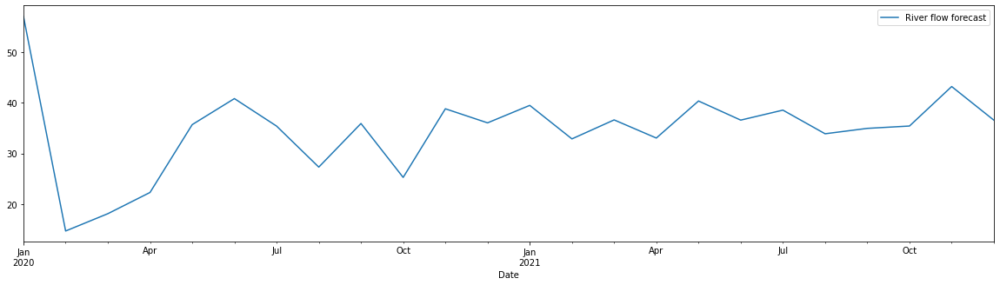


 ################ Basin 33 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


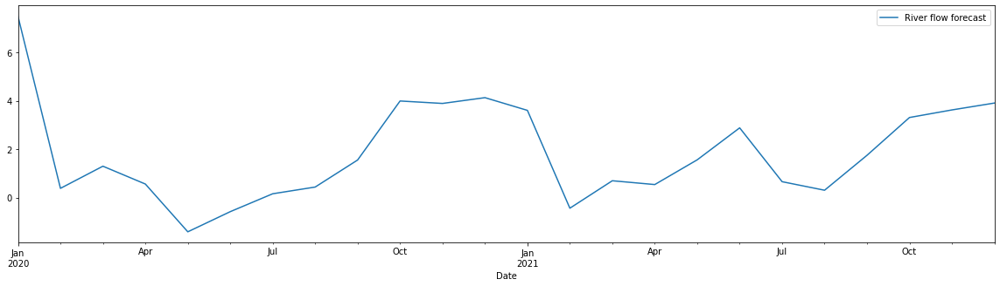


 ################ Basin 34 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


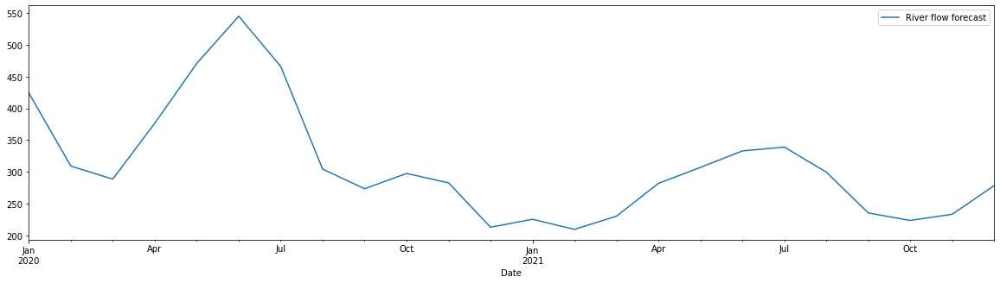


 ################ Basin 35 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


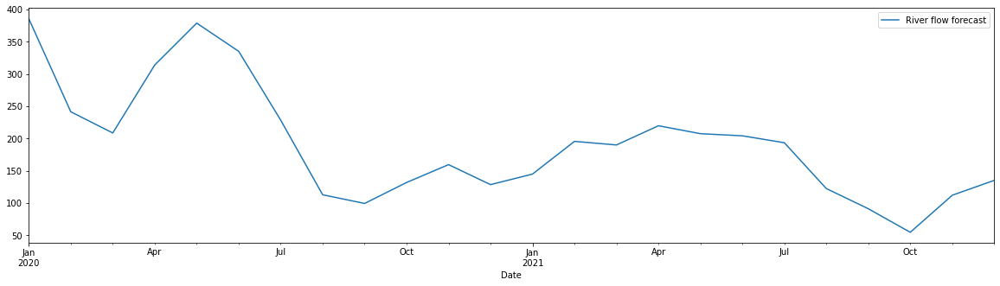


 ################ Basin 36 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


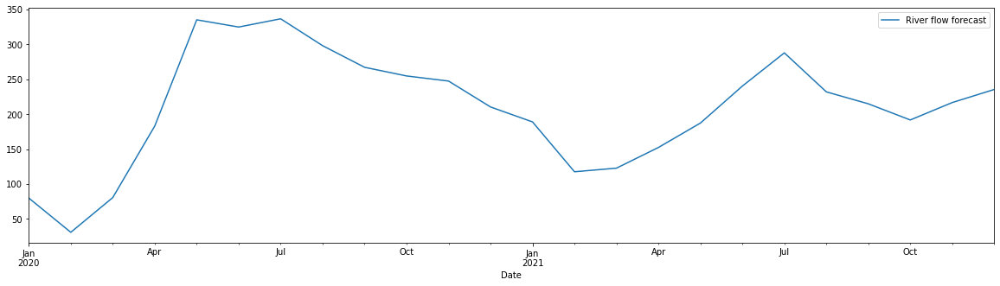


 ################ Basin 37 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


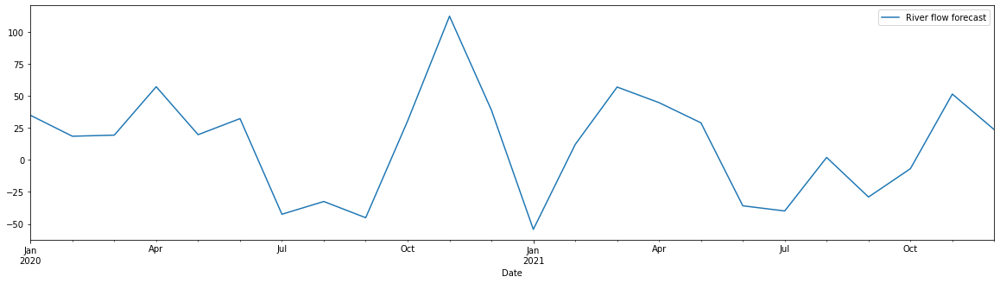


 ################ Basin 38 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


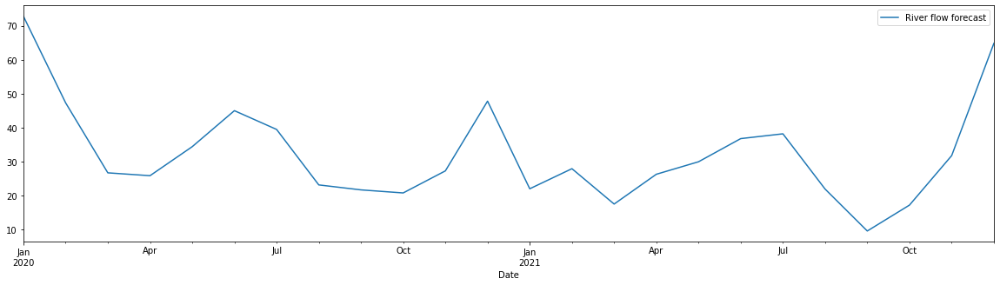


 ################ Basin 39 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


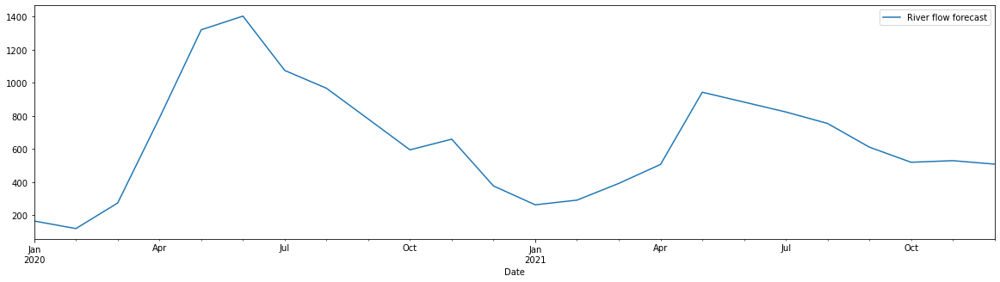


 ################ Basin 40 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


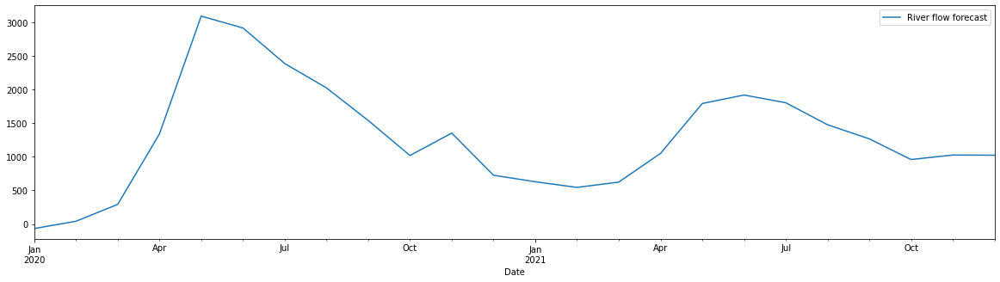


 ################ Basin 41 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


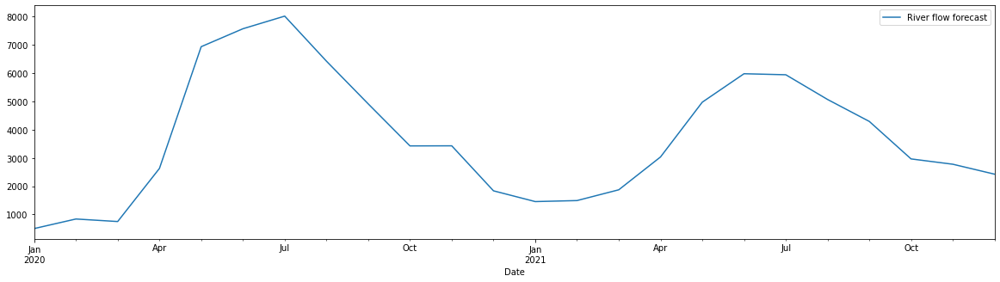


 ################ Basin 42 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


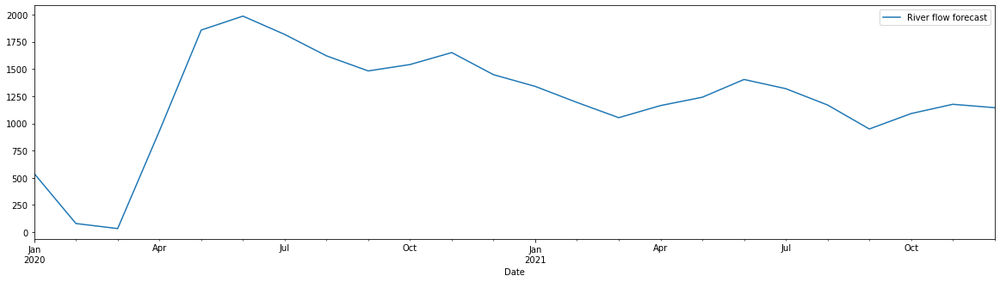


 ################ Basin 43 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


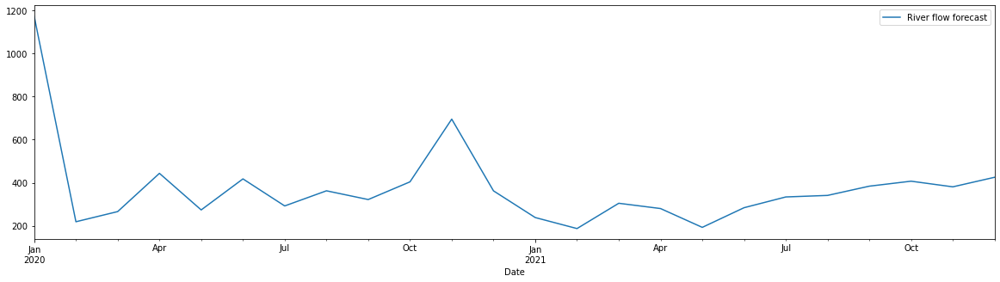


 ################ Basin 44 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


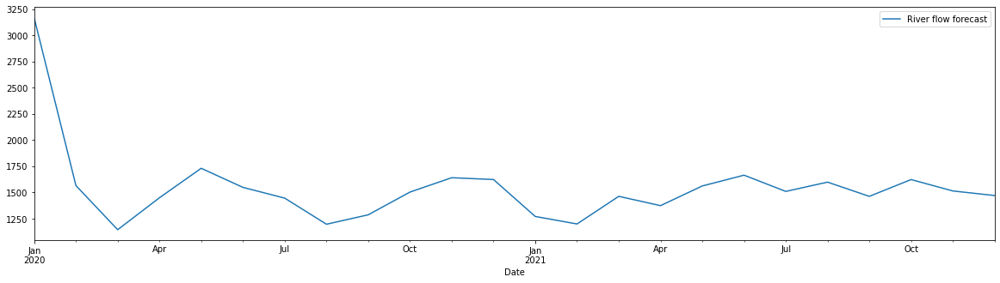


 ################ Basin 45 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


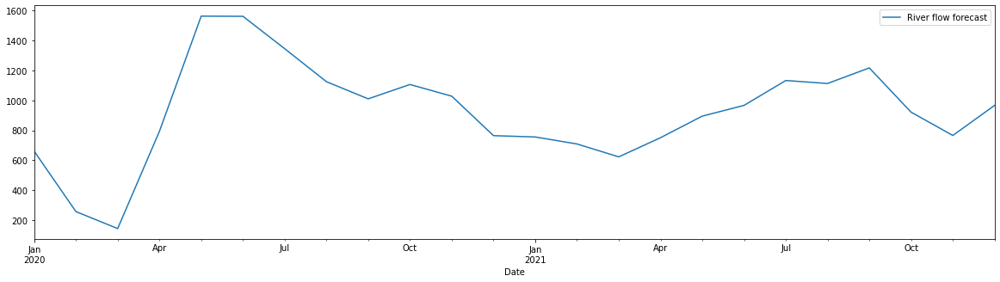


 ################ Basin 46 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


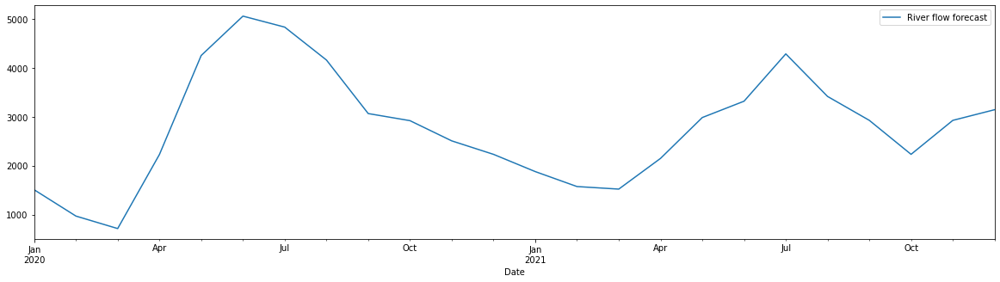


 ################ Basin 47 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


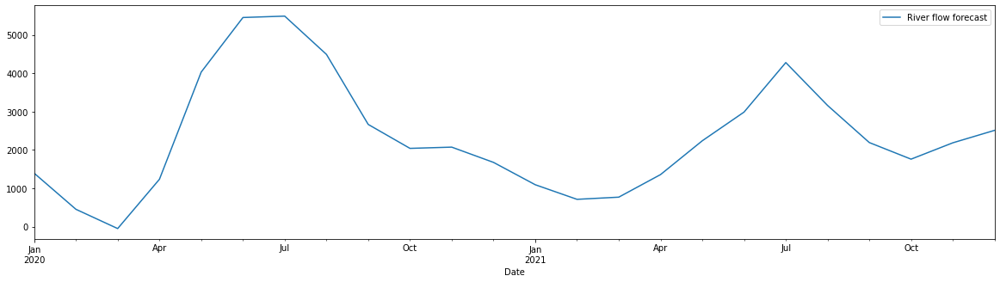


 ################ Basin 48 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


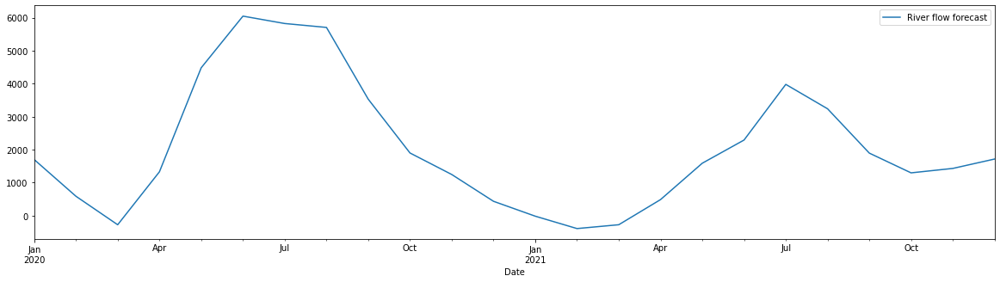

Def_100%
P_B1

 ################ Basin 1 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


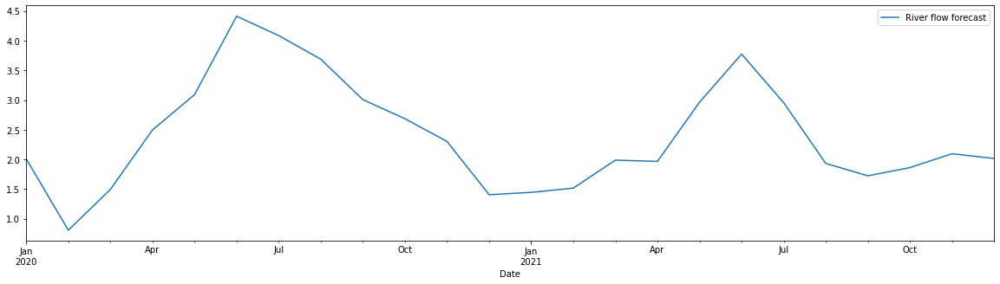


 ################ Basin 2 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


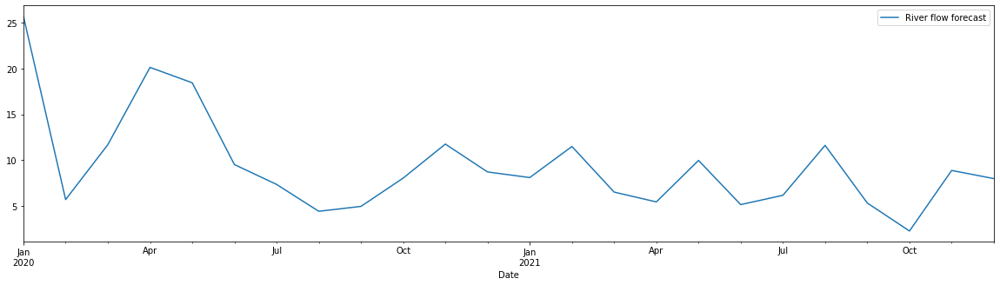


 ################ Basin 3 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


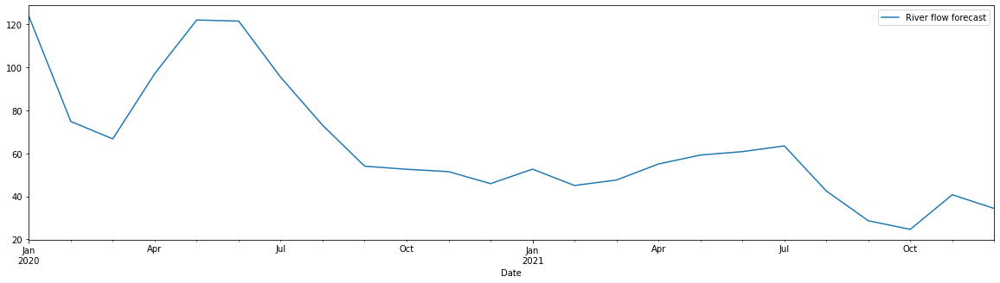


 ################ Basin 4 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


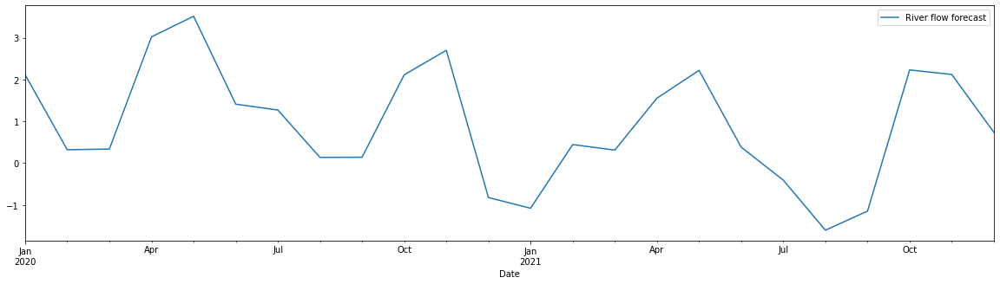


 ################ Basin 5 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


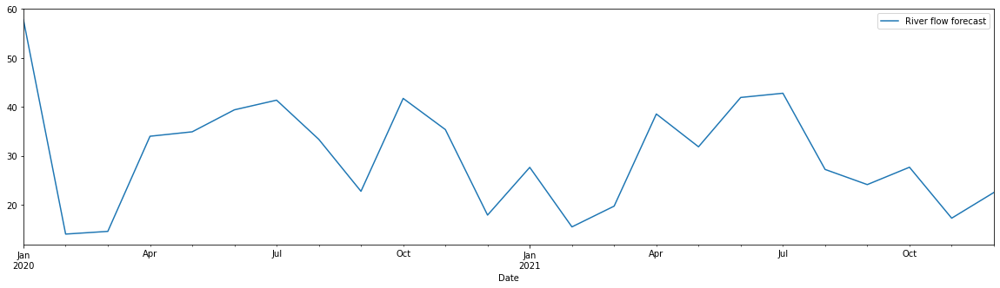


 ################ Basin 6 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


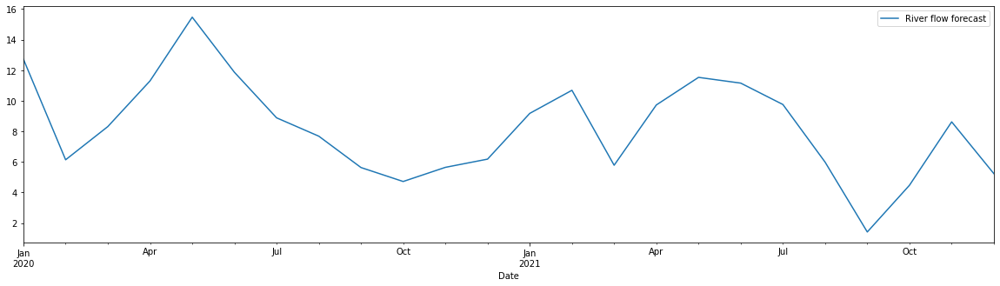


 ################ Basin 7 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


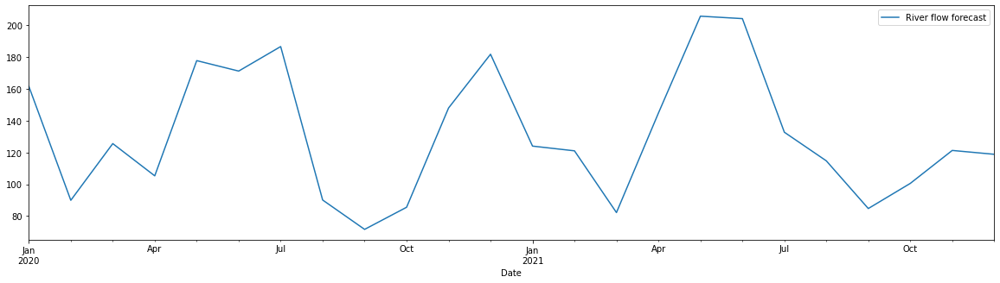


 ################ Basin 8 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


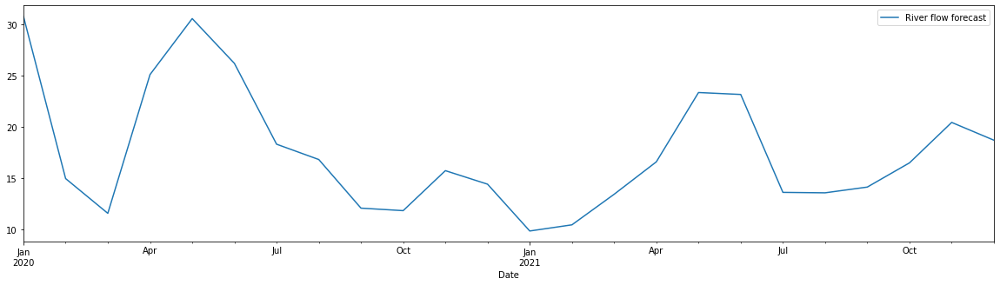


 ################ Basin 9 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


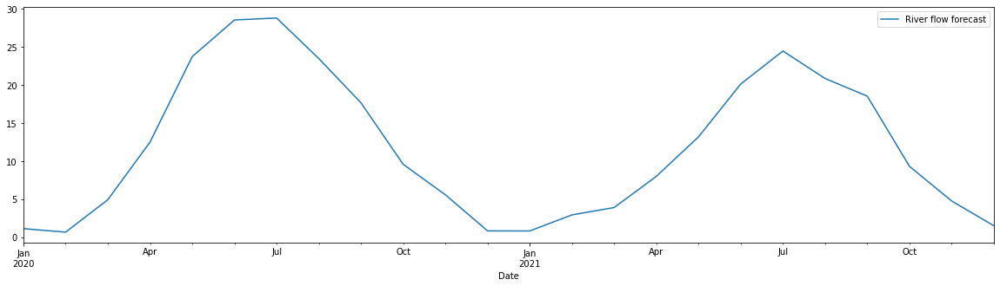


 ################ Basin 10 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


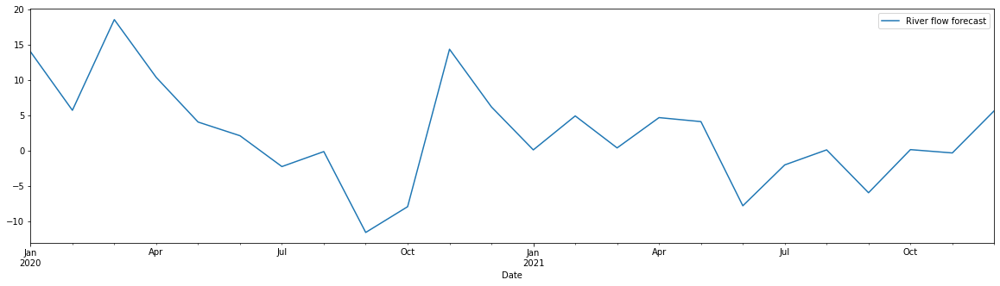


 ################ Basin 11 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


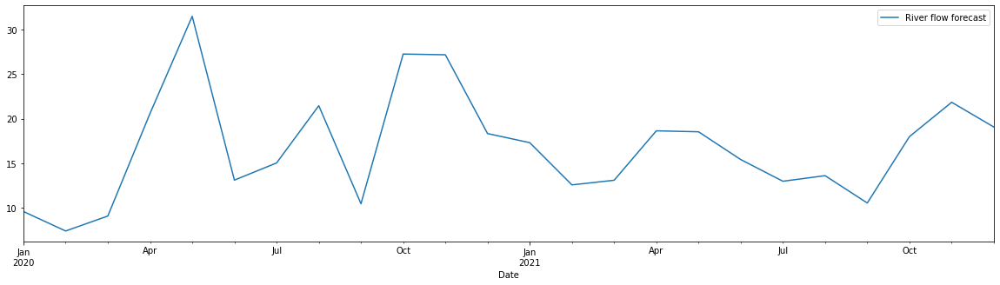


 ################ Basin 12 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


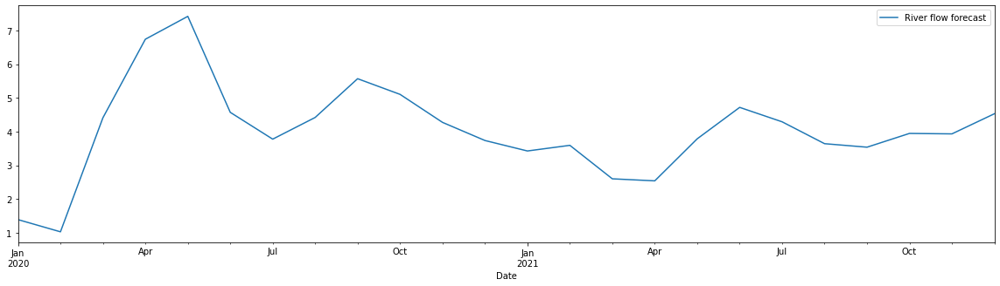


 ################ Basin 13 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


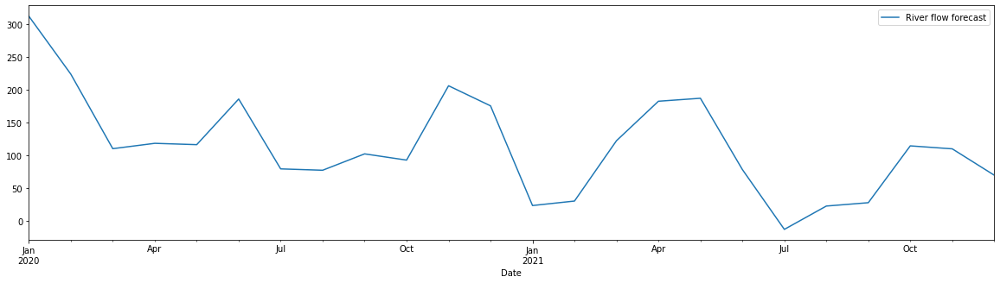


 ################ Basin 14 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


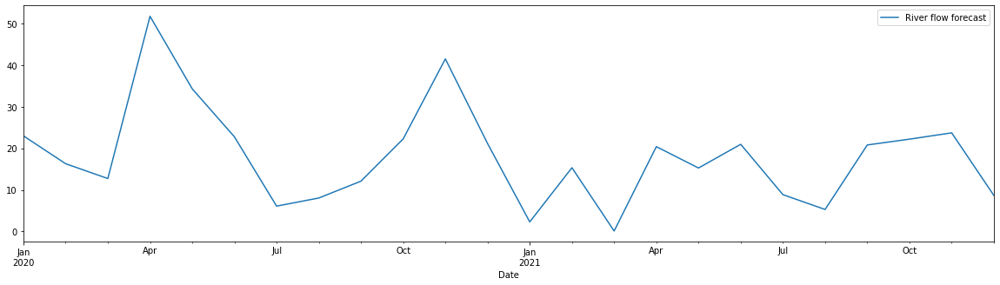


 ################ Basin 15 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


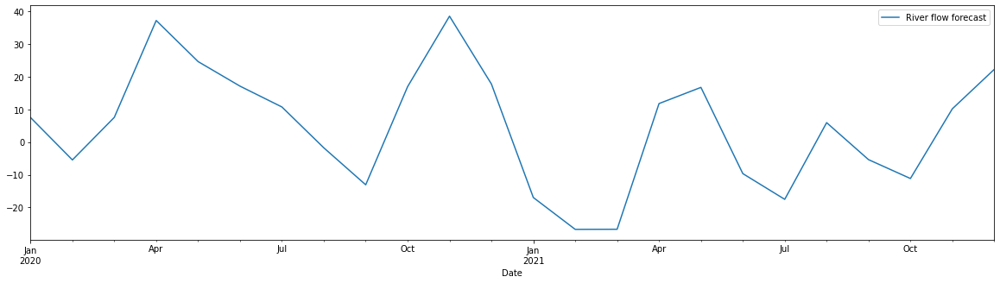


 ################ Basin 16 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


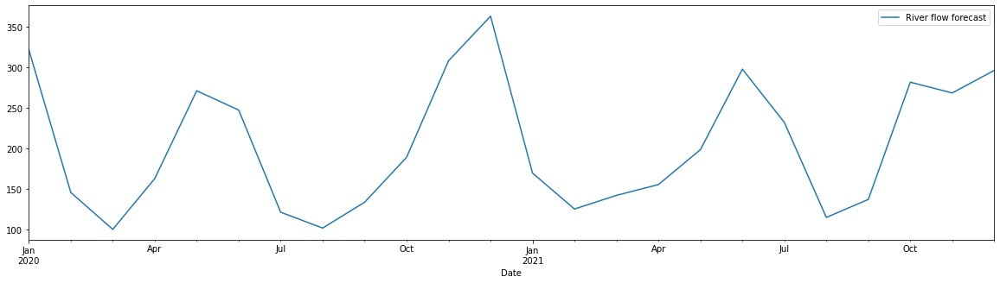


 ################ Basin 17 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


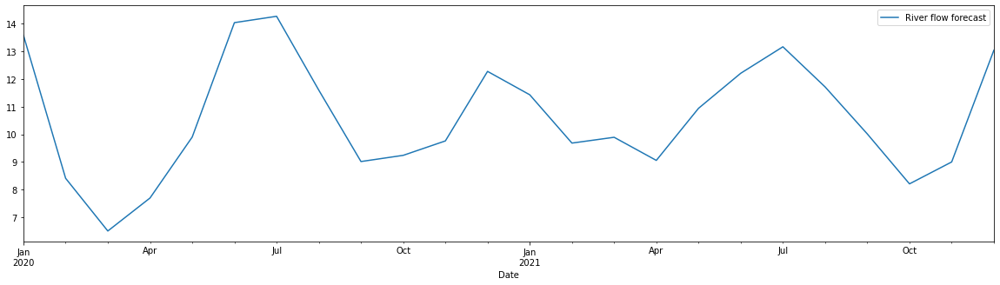


 ################ Basin 18 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


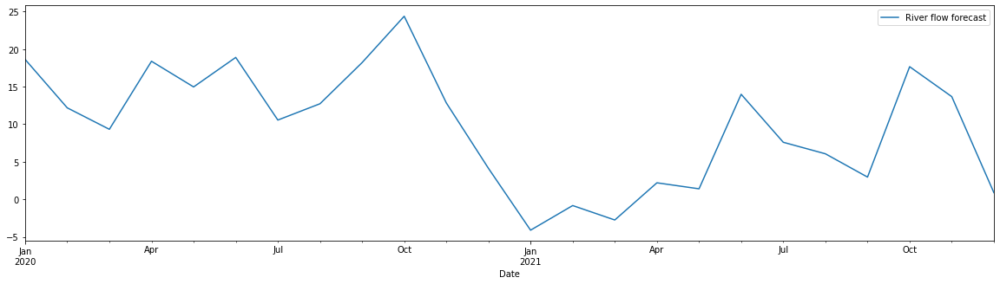


 ################ Basin 19 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


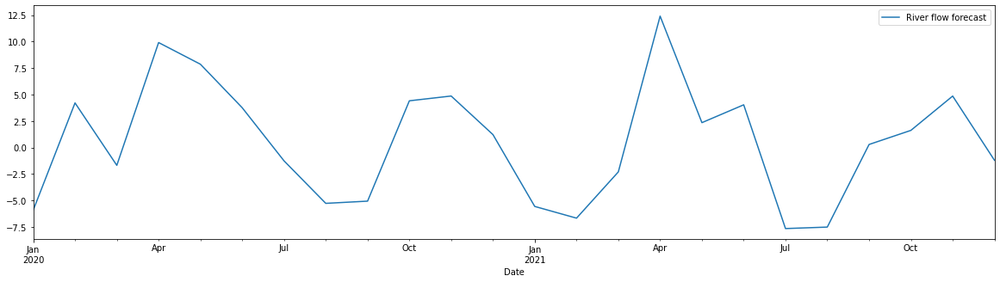


 ################ Basin 20 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


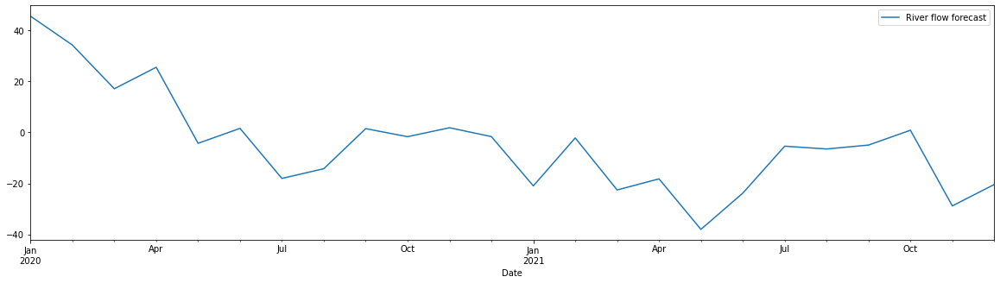


 ################ Basin 21 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


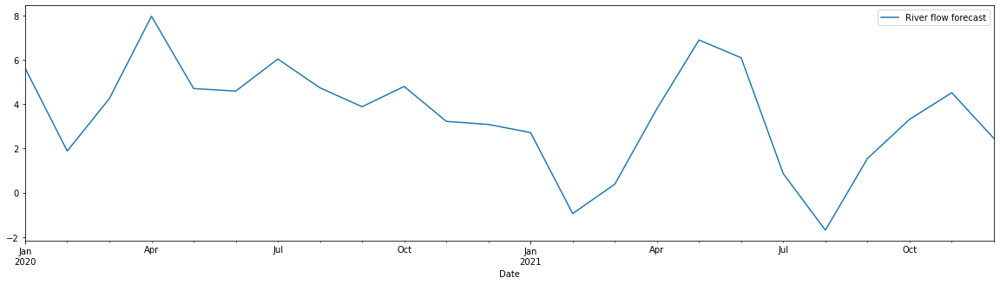


 ################ Basin 22 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


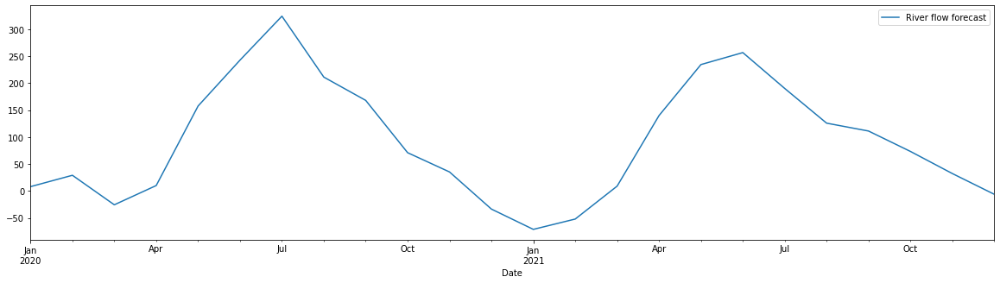


 ################ Basin 23 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


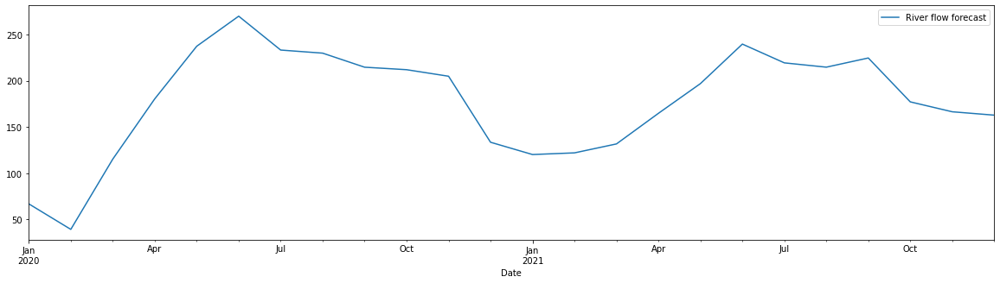


 ################ Basin 24 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


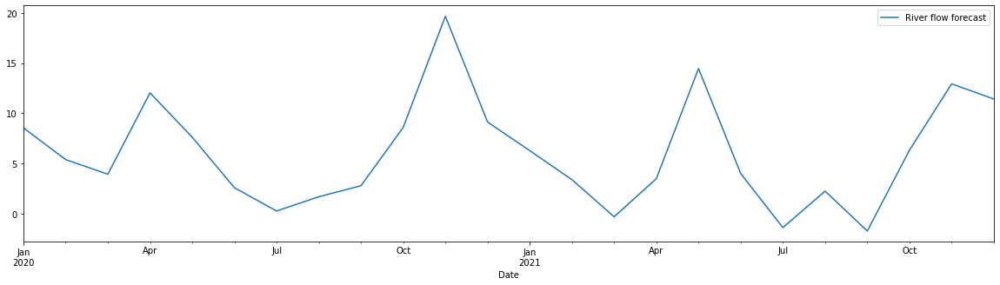


 ################ Basin 25 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


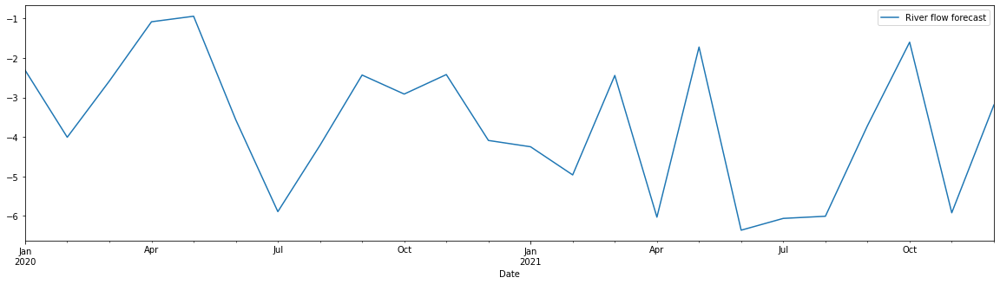


 ################ Basin 26 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


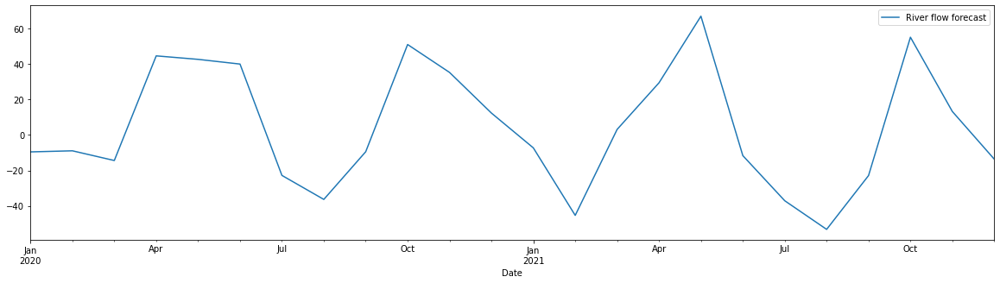


 ################ Basin 27 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


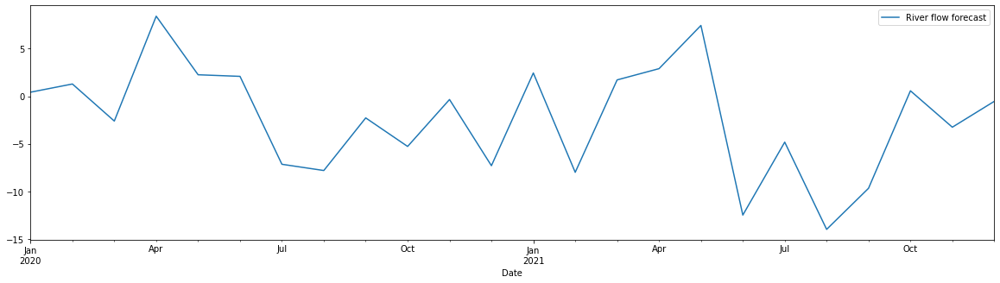


 ################ Basin 28 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


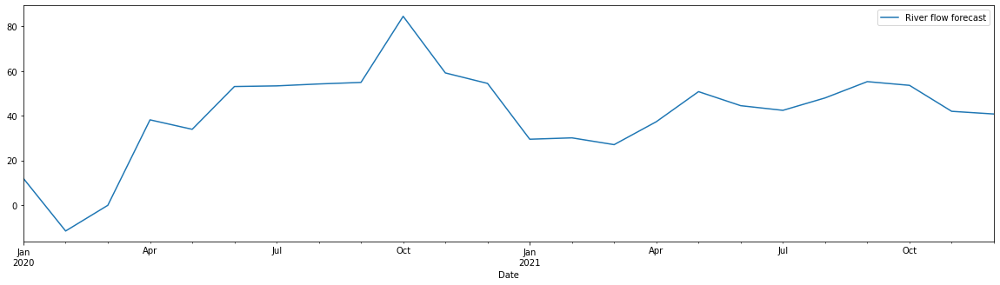


 ################ Basin 29 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


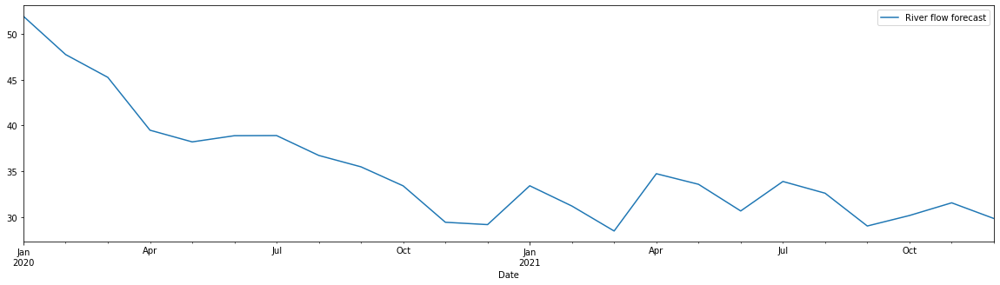


 ################ Basin 30 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


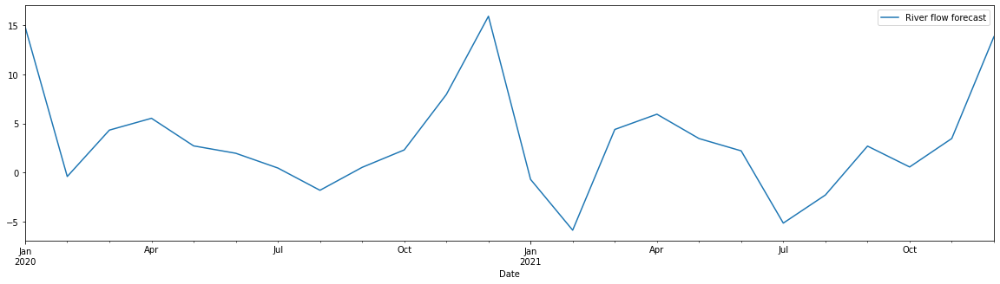


 ################ Basin 31 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


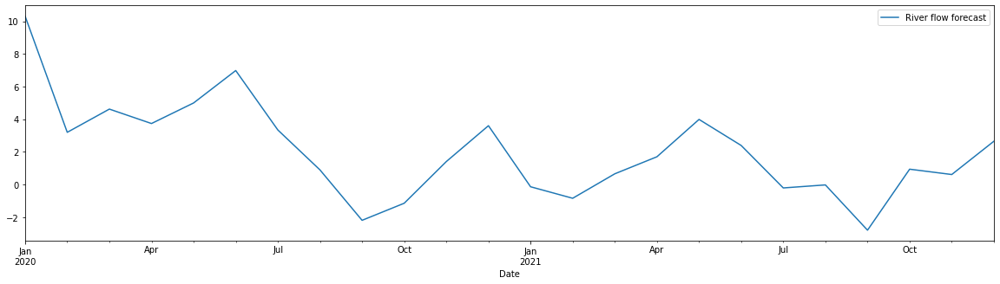


 ################ Basin 32 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


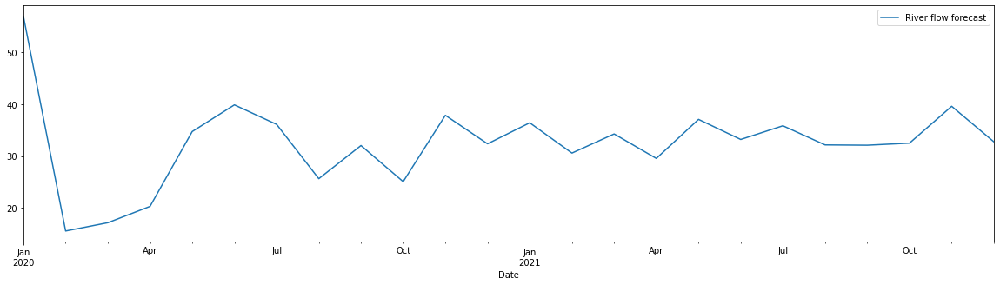


 ################ Basin 33 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


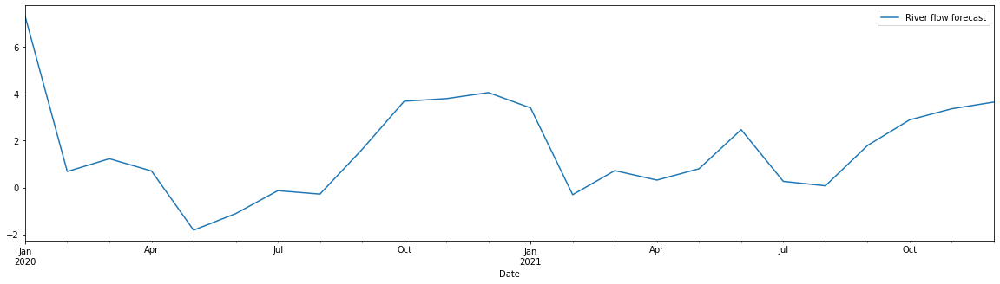


 ################ Basin 34 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


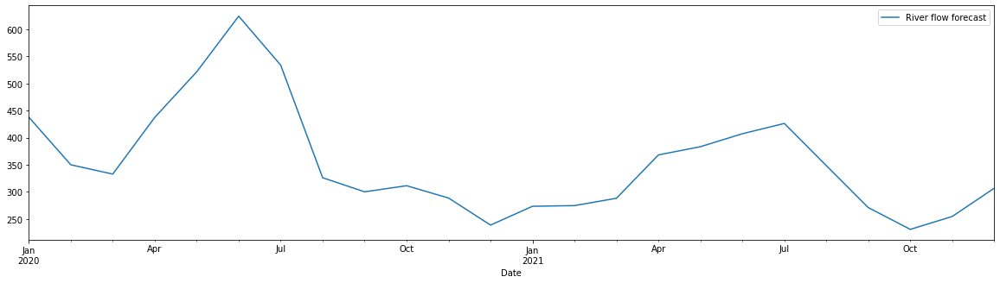


 ################ Basin 35 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


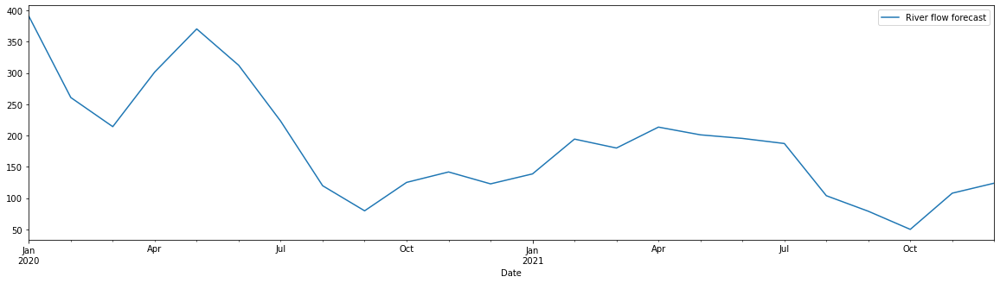


 ################ Basin 36 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


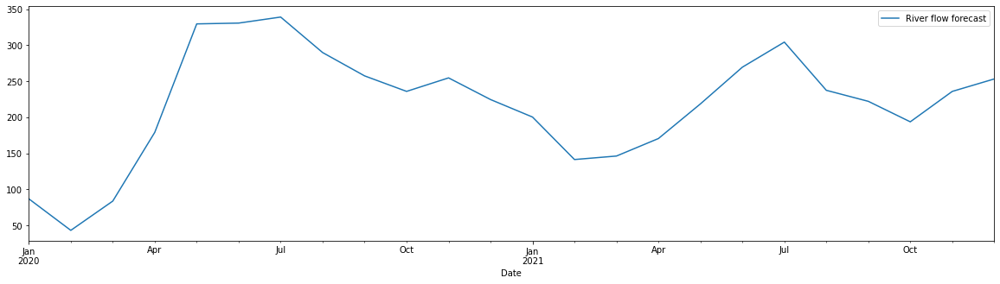


 ################ Basin 37 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


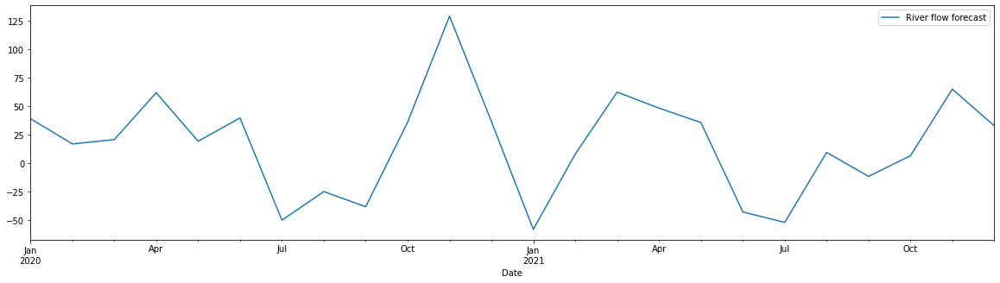


 ################ Basin 38 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


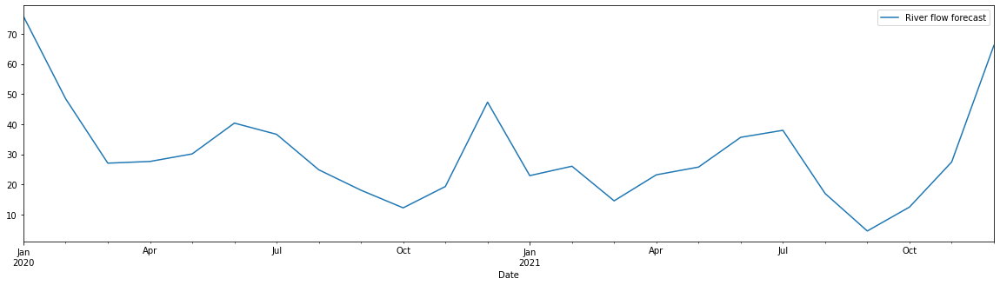


 ################ Basin 39 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


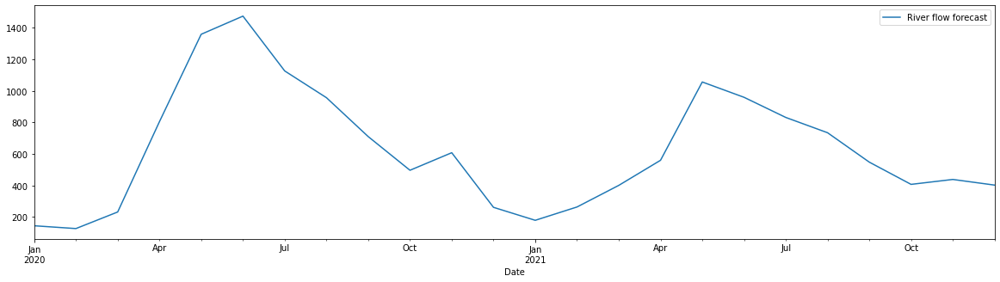


 ################ Basin 40 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


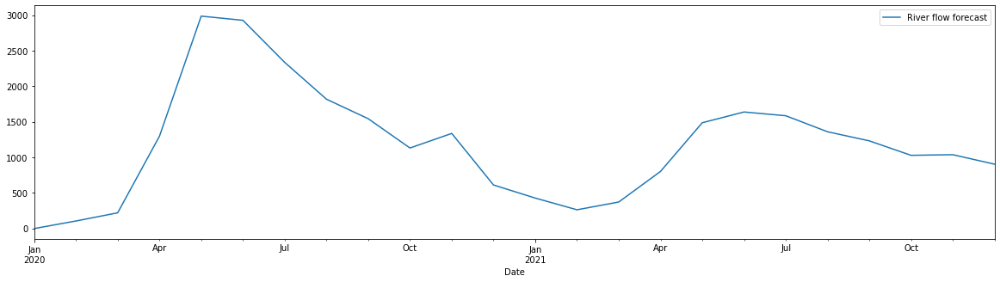


 ################ Basin 41 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


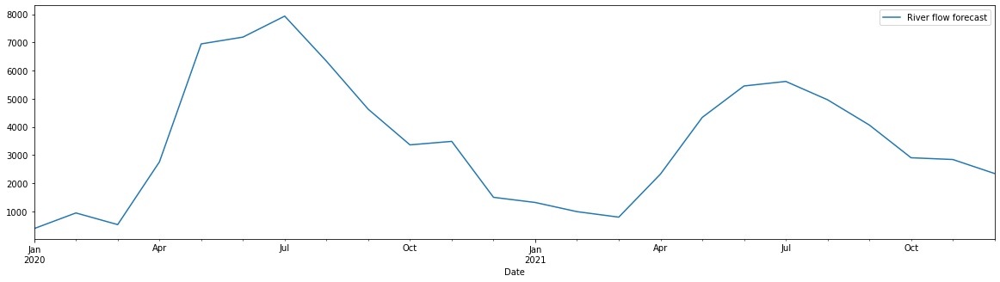


 ################ Basin 42 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


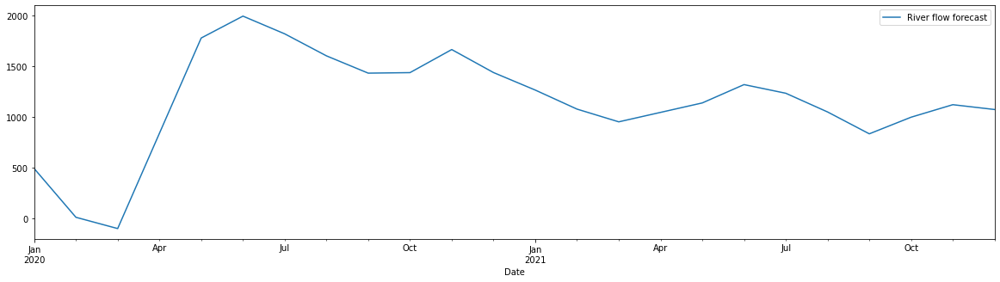


 ################ Basin 43 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


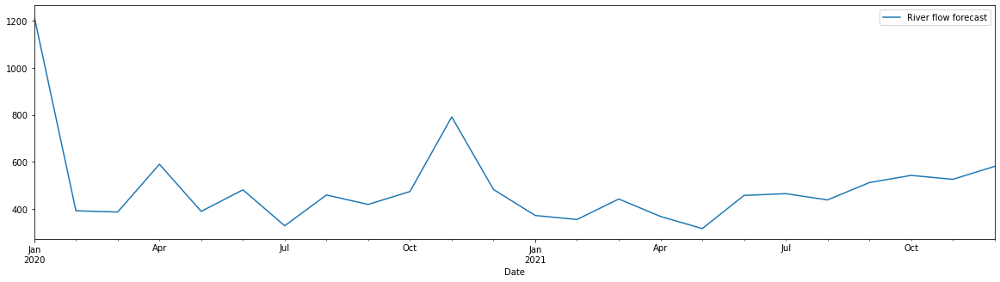


 ################ Basin 44 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


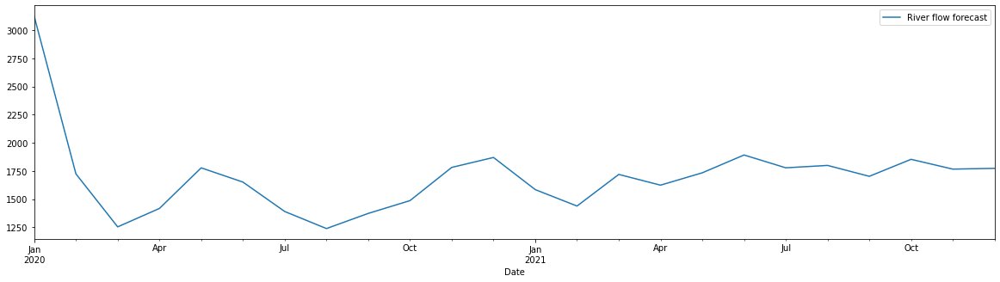


 ################ Basin 45 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


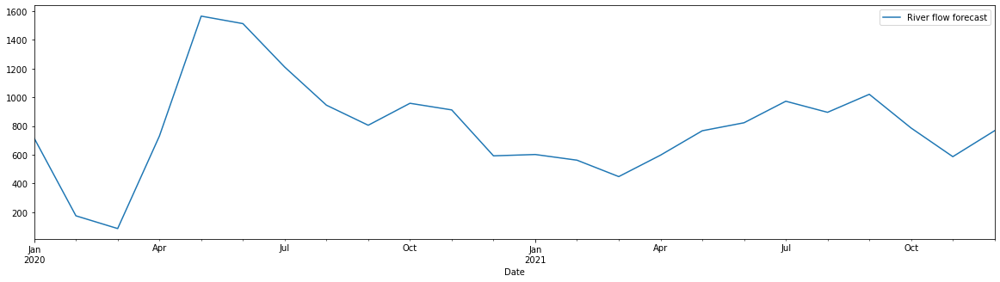


 ################ Basin 46 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


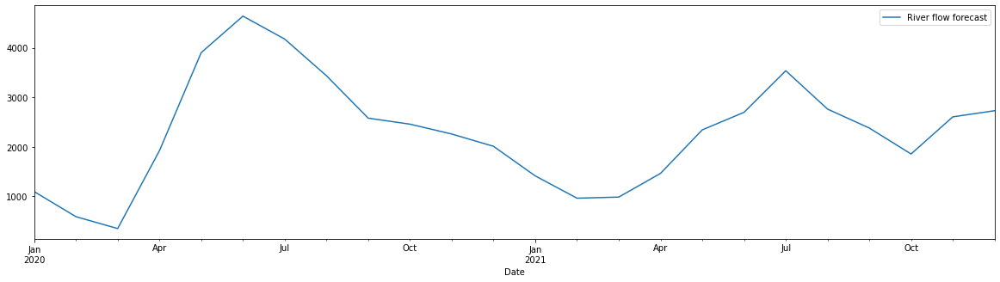


 ################ Basin 47 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


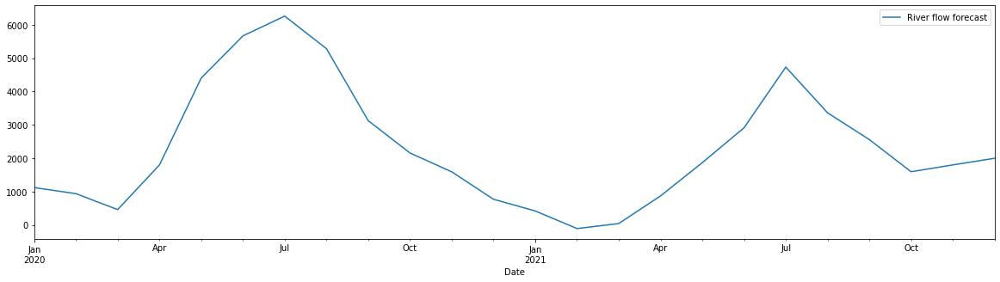


 ################ Basin 48 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


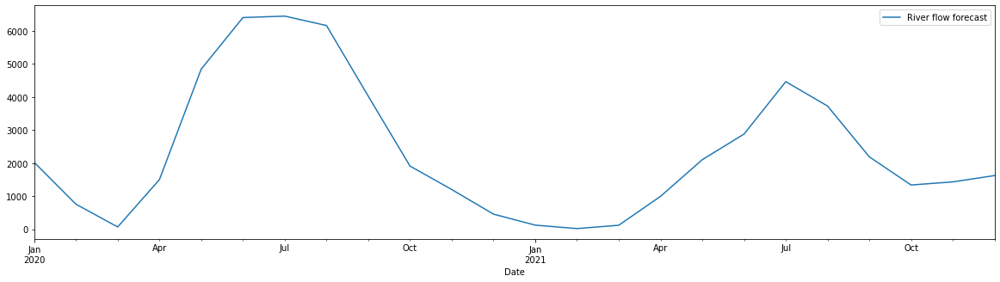

Def_100%
P_B2

 ################ Basin 1 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


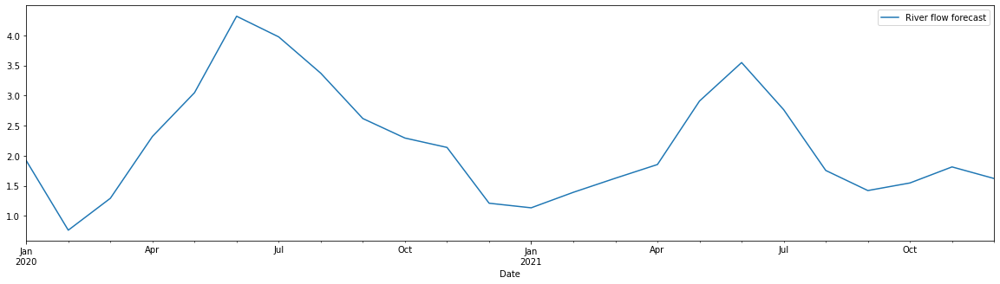


 ################ Basin 2 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


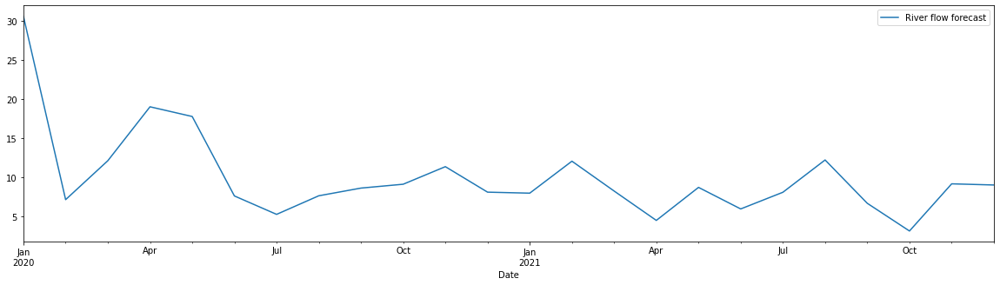


 ################ Basin 3 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


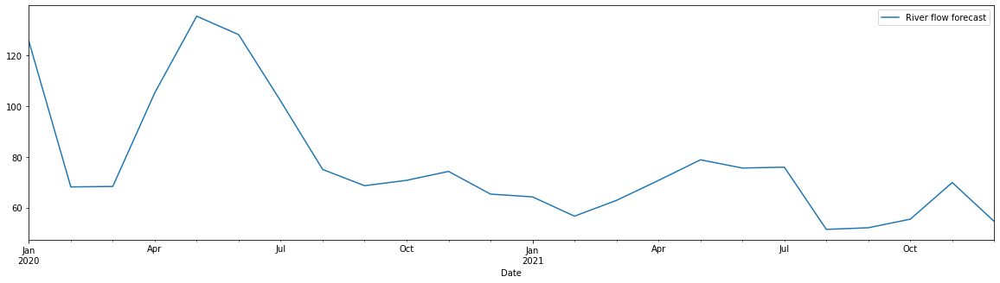


 ################ Basin 4 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


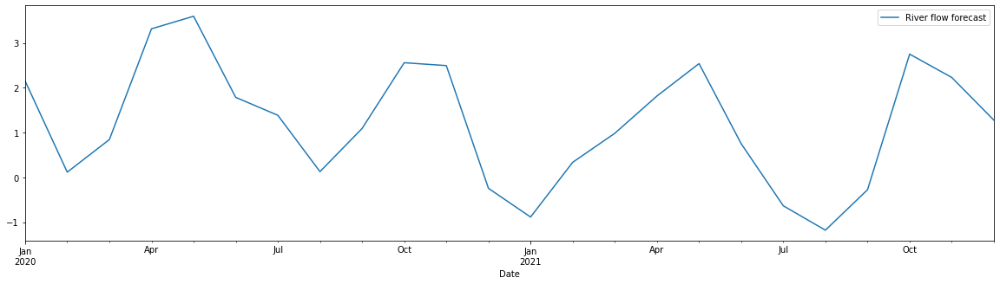


 ################ Basin 5 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


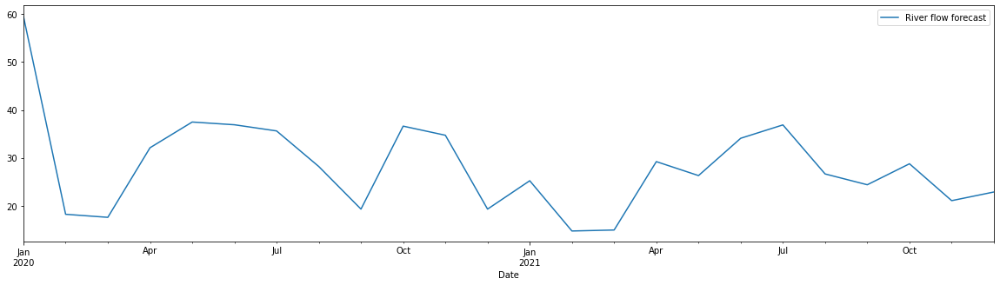


 ################ Basin 6 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


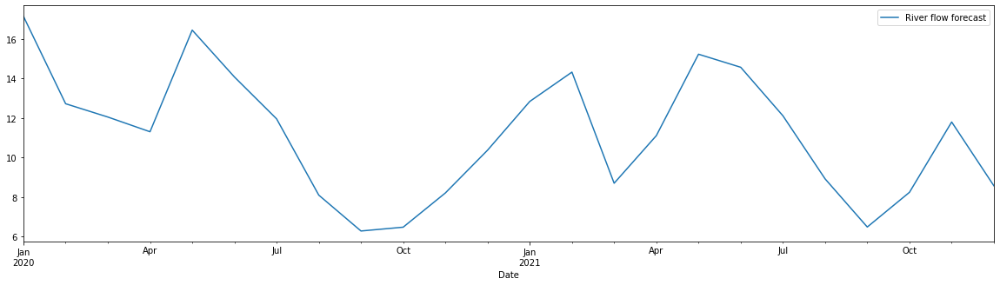


 ################ Basin 7 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


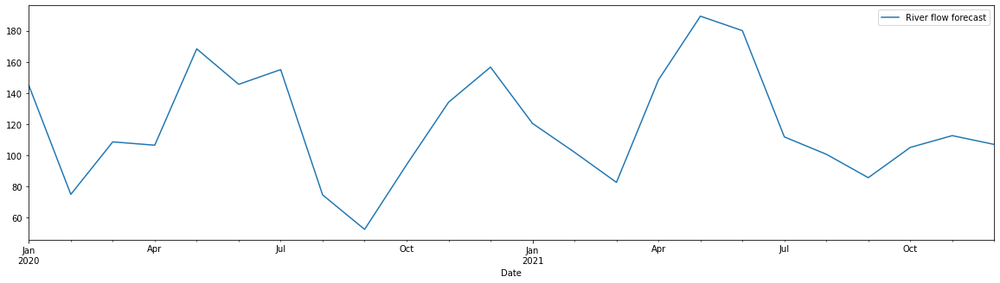


 ################ Basin 8 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


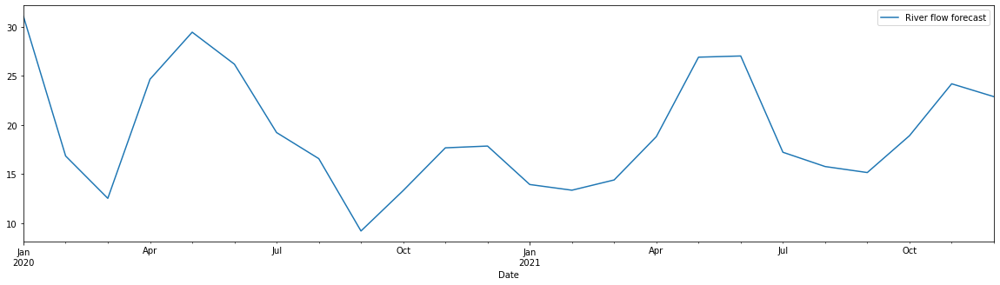


 ################ Basin 9 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


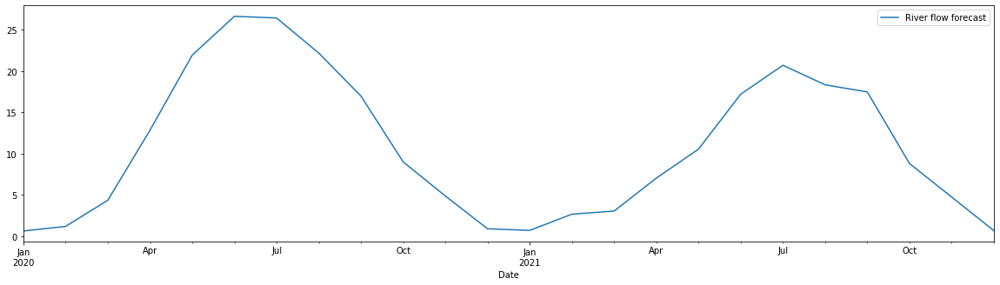


 ################ Basin 10 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


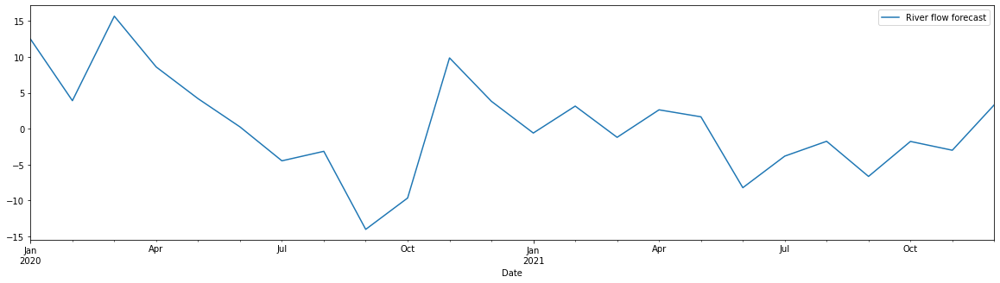


 ################ Basin 11 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


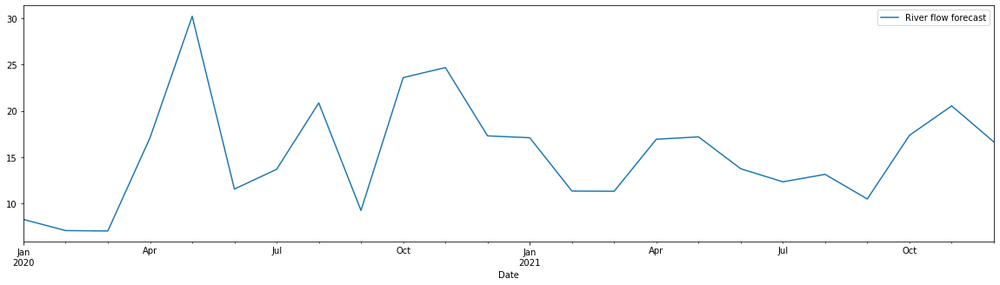


 ################ Basin 12 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


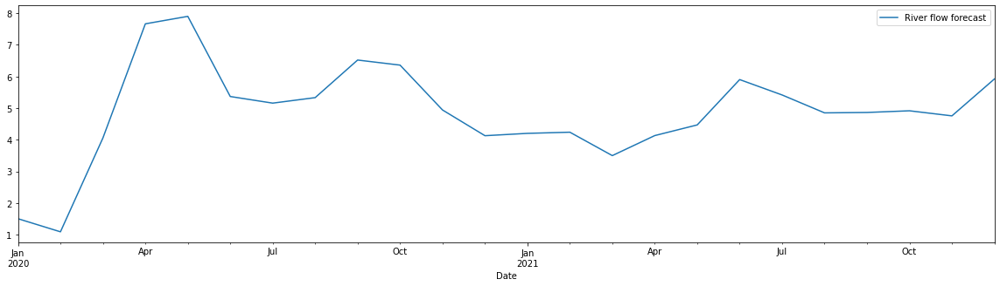


 ################ Basin 13 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


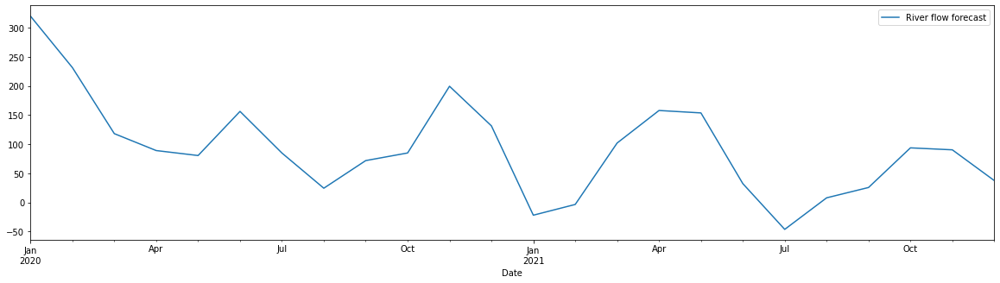


 ################ Basin 14 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


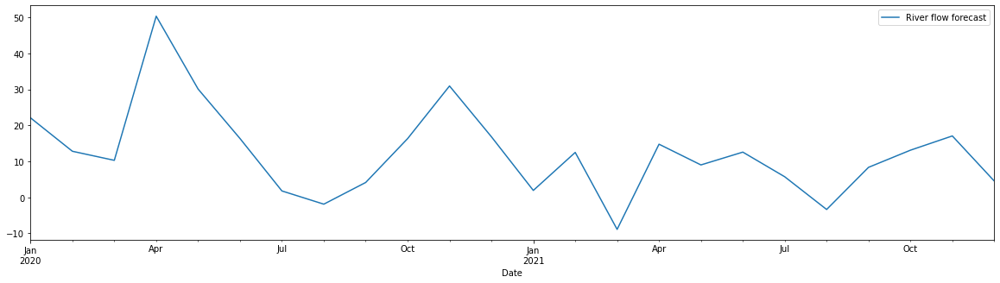


 ################ Basin 15 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


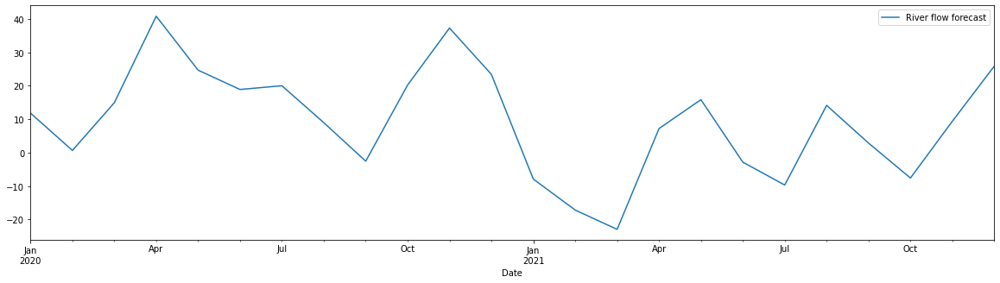


 ################ Basin 16 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


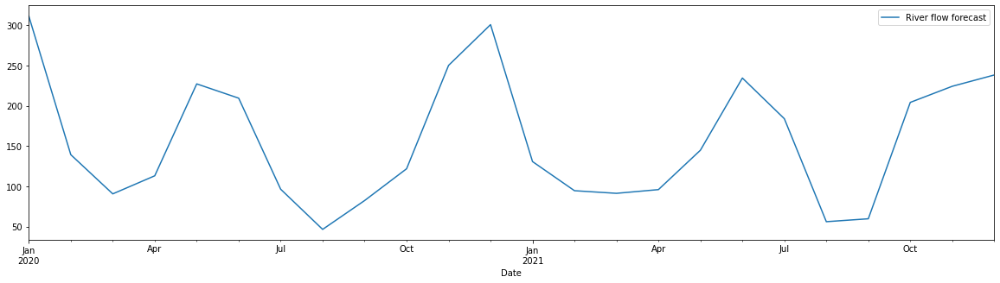


 ################ Basin 17 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


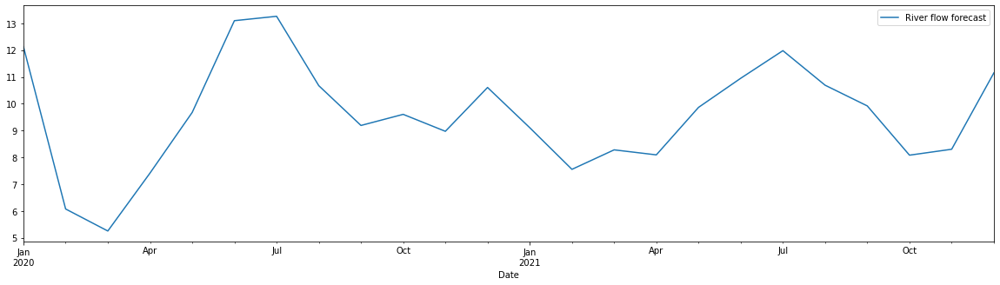


 ################ Basin 18 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


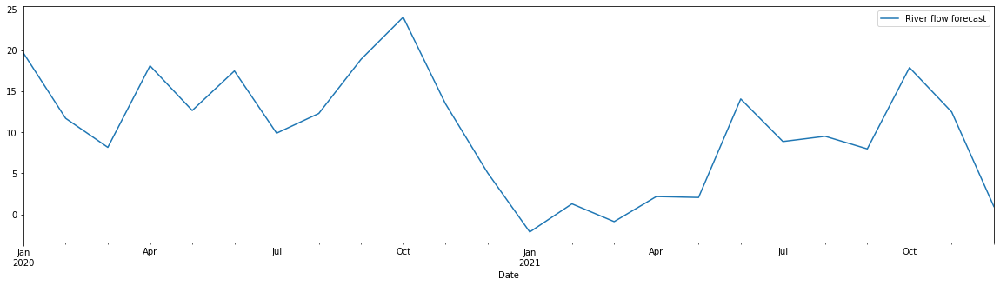


 ################ Basin 19 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


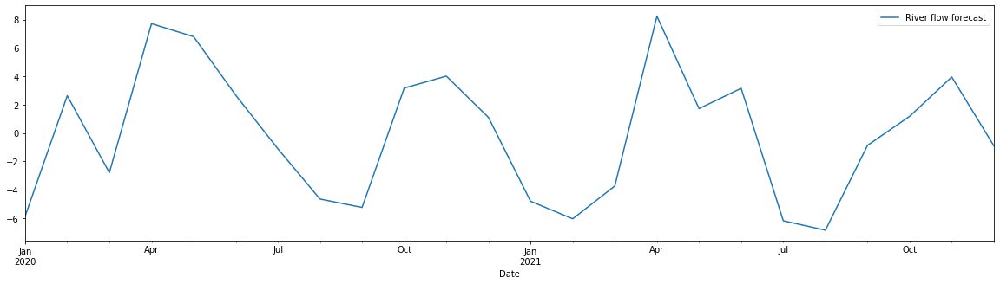


 ################ Basin 20 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


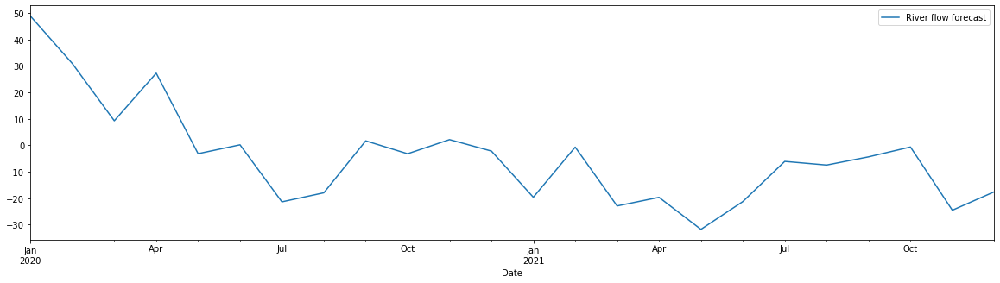


 ################ Basin 21 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


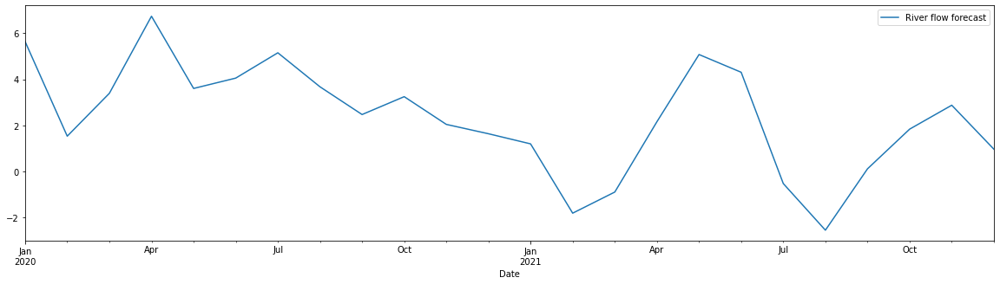


 ################ Basin 22 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


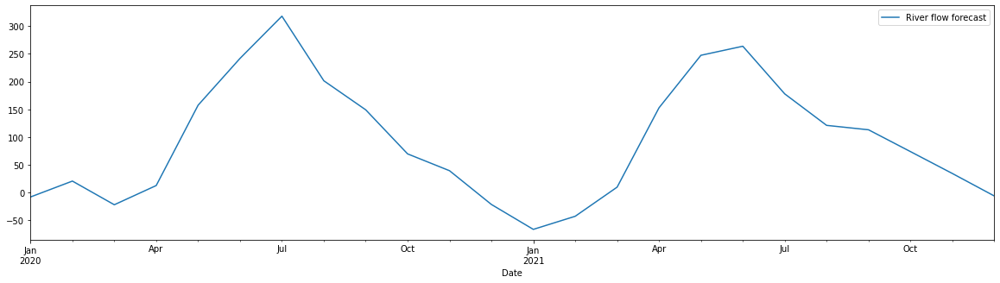


 ################ Basin 23 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


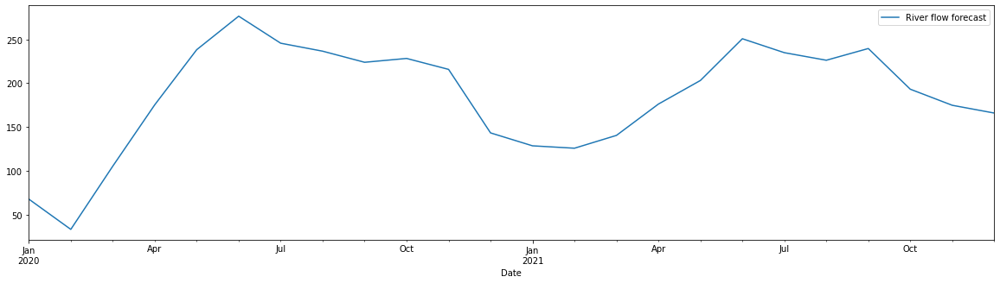


 ################ Basin 24 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


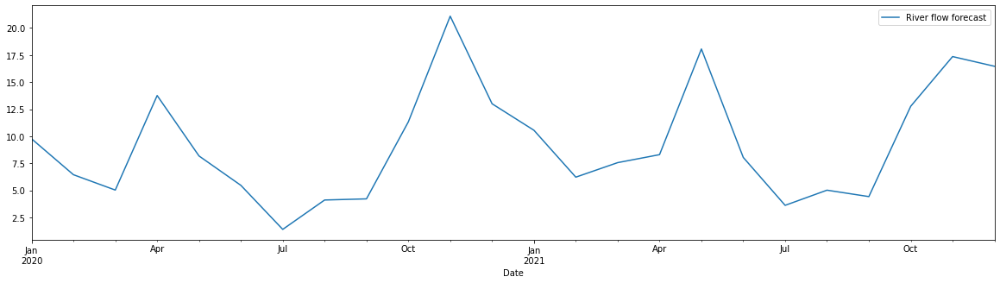


 ################ Basin 25 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


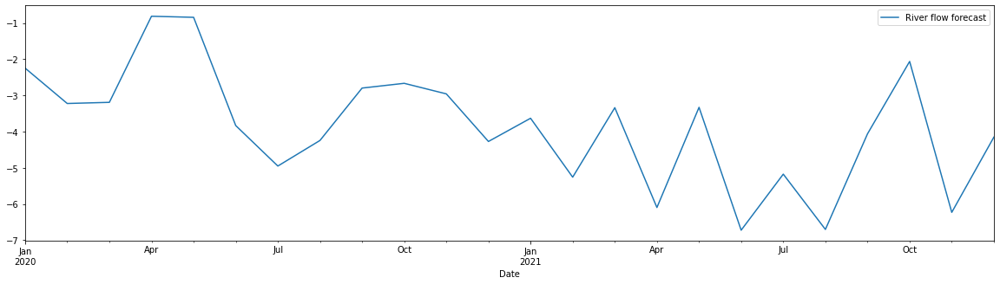


 ################ Basin 26 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


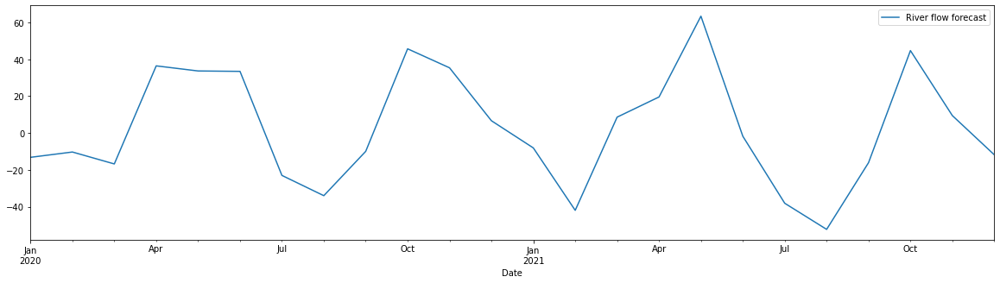


 ################ Basin 27 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


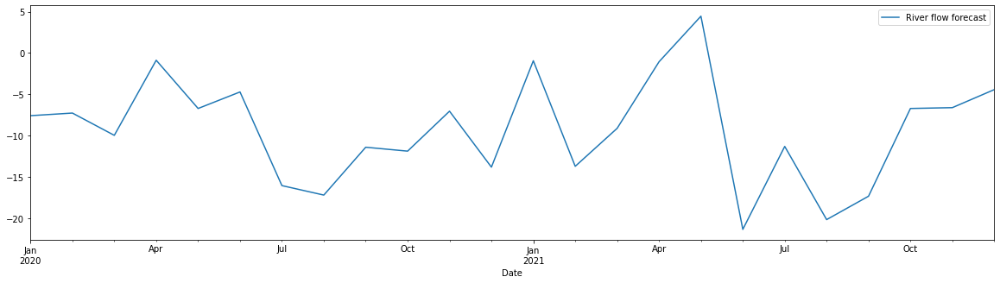


 ################ Basin 28 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


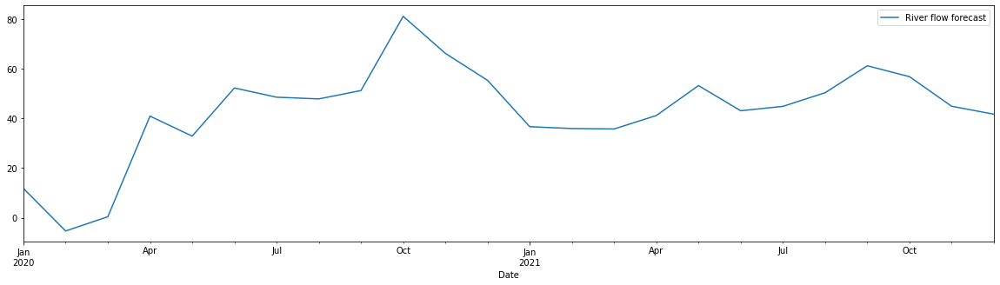


 ################ Basin 29 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


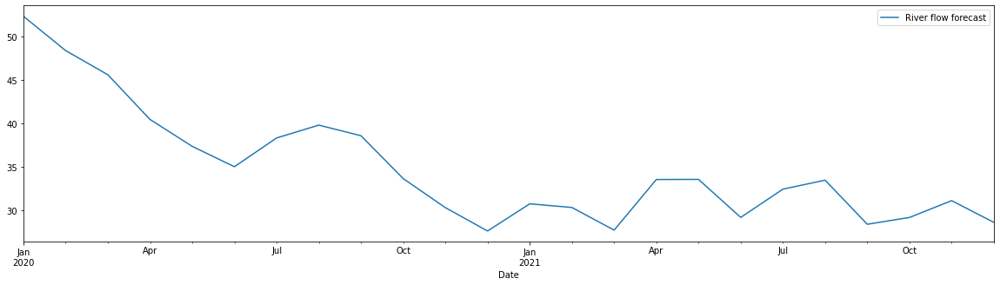


 ################ Basin 30 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


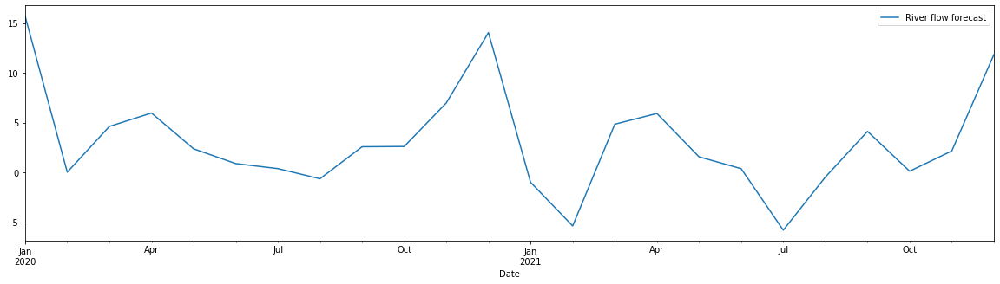


 ################ Basin 31 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


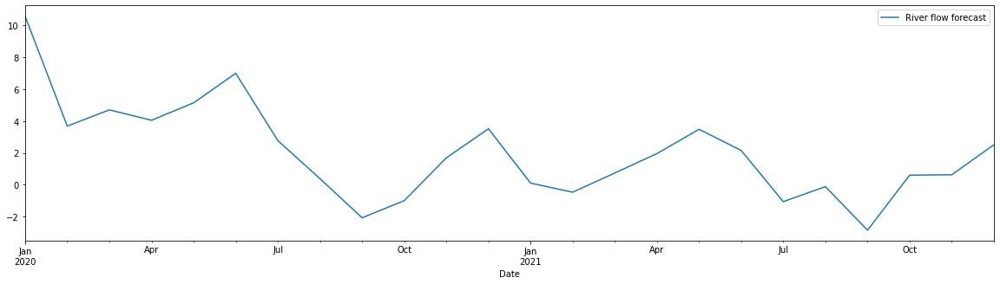


 ################ Basin 32 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


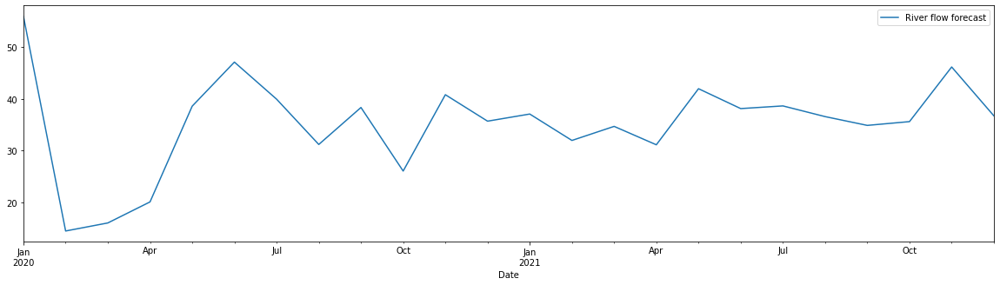


 ################ Basin 33 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


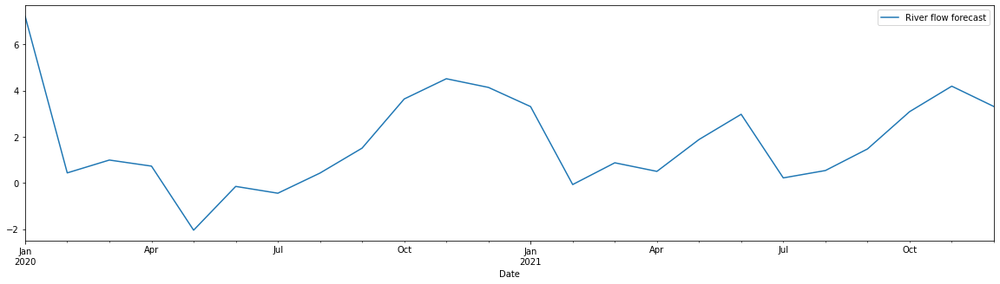


 ################ Basin 34 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


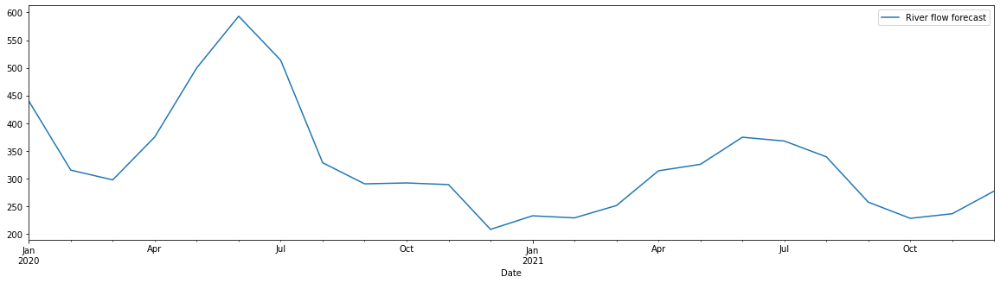


 ################ Basin 35 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


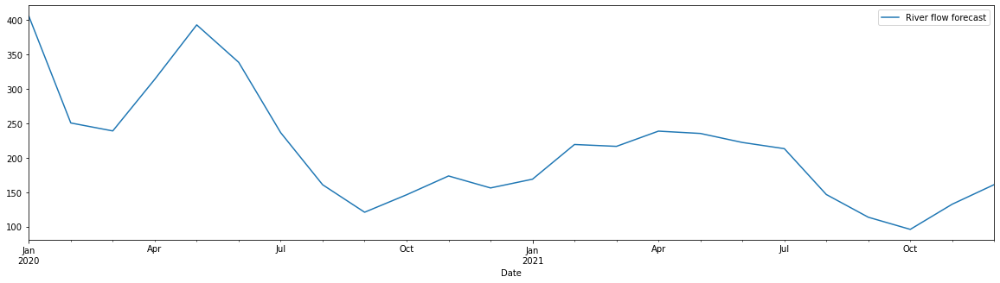


 ################ Basin 36 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


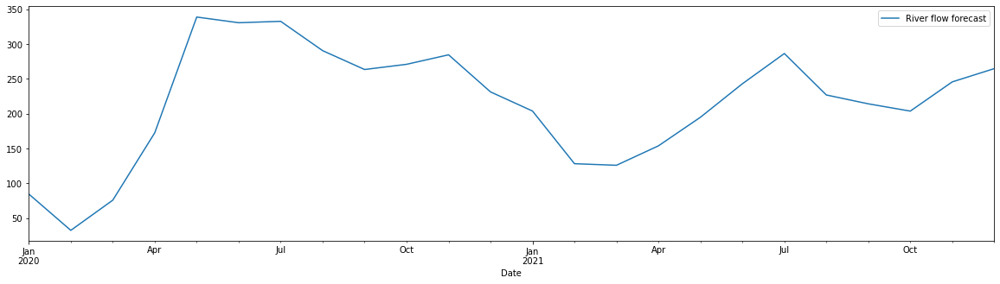


 ################ Basin 37 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


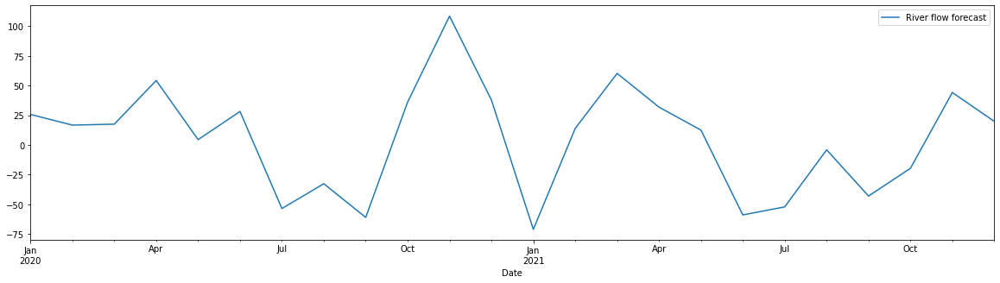


 ################ Basin 38 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


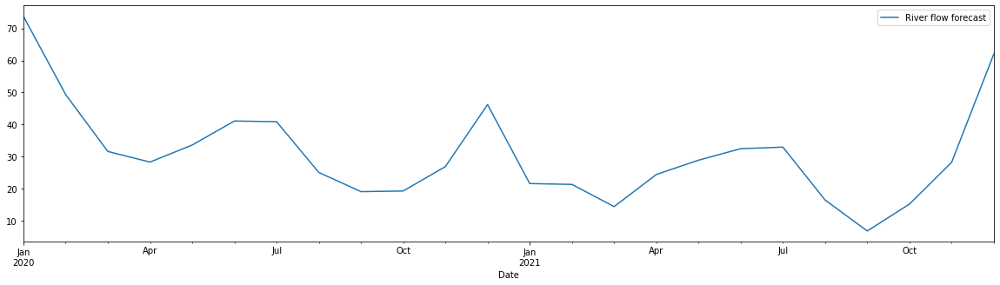


 ################ Basin 39 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


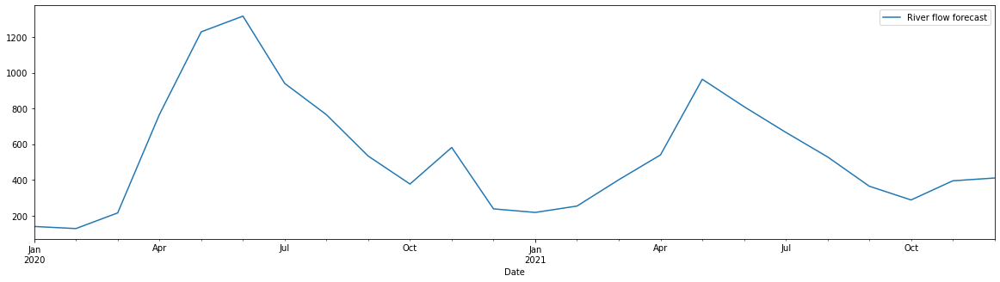


 ################ Basin 40 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


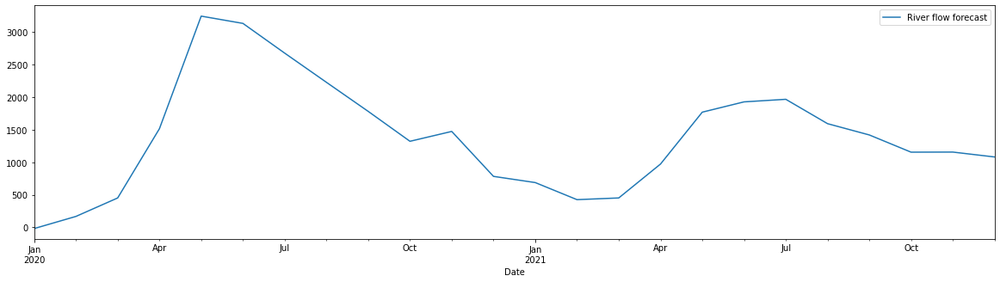


 ################ Basin 41 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


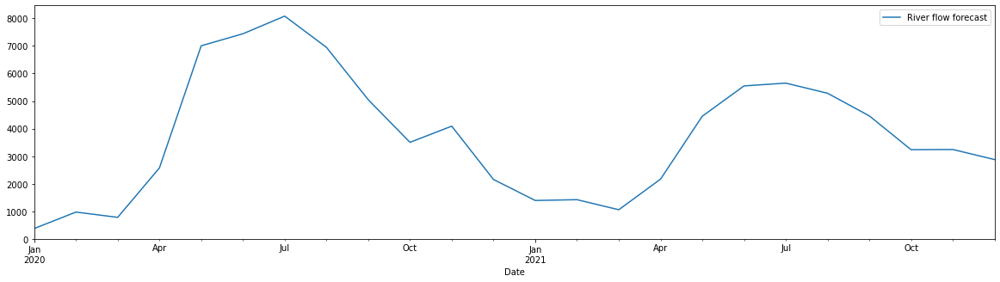


 ################ Basin 42 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


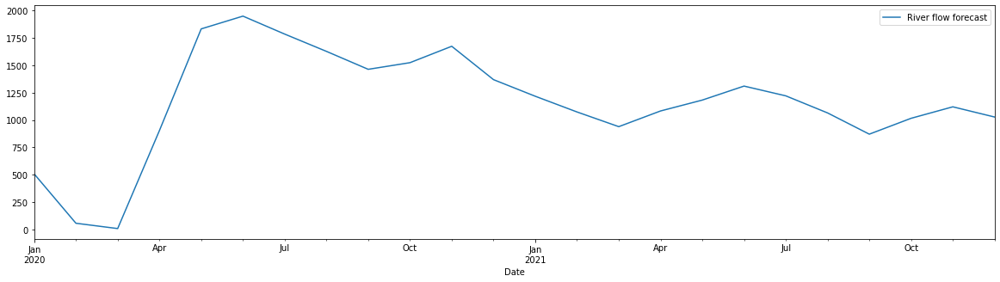


 ################ Basin 43 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


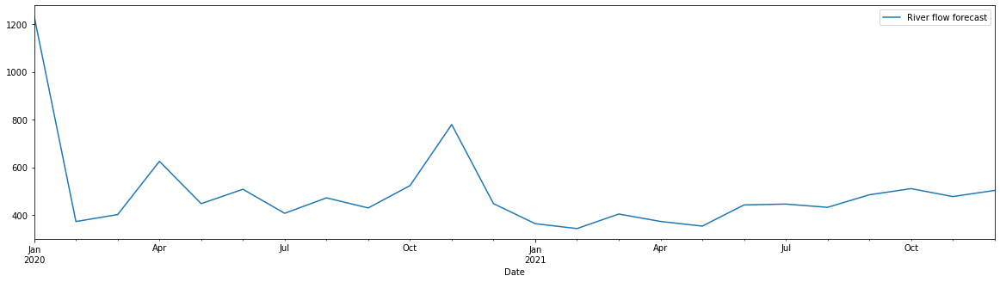


 ################ Basin 44 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


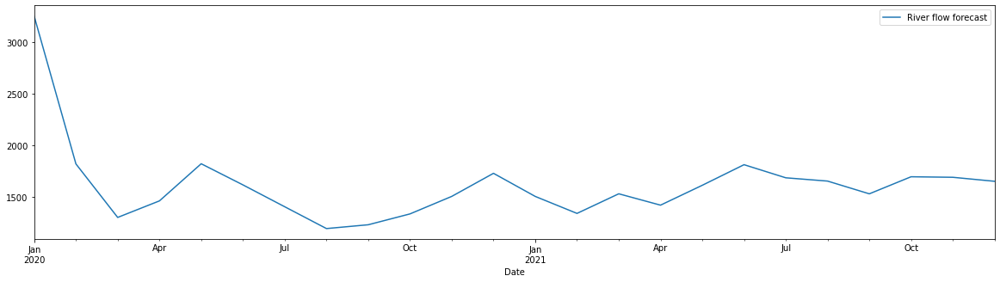


 ################ Basin 45 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


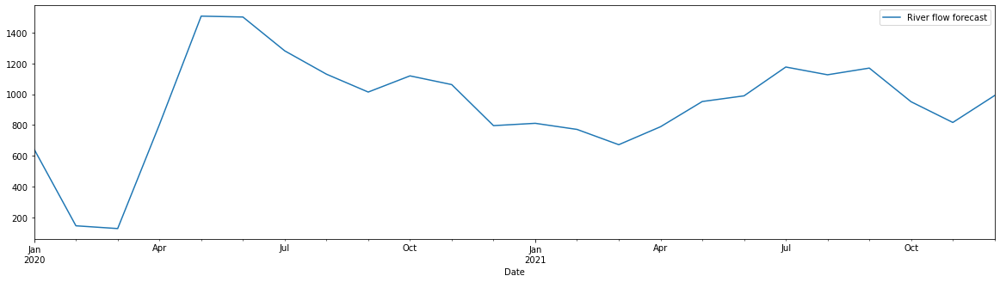


 ################ Basin 46 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


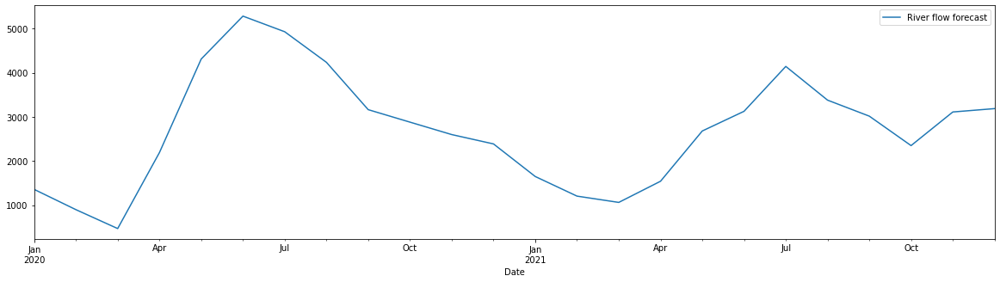


 ################ Basin 47 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


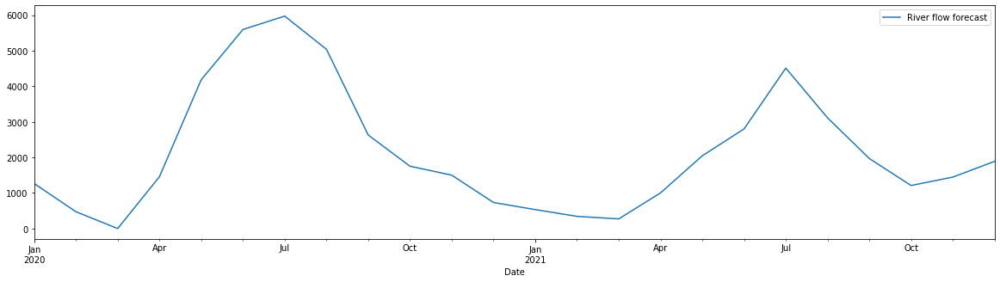


 ################ Basin 48 ############### 

(229, 1, 33) (229,) (24, 1, 33) (24,)


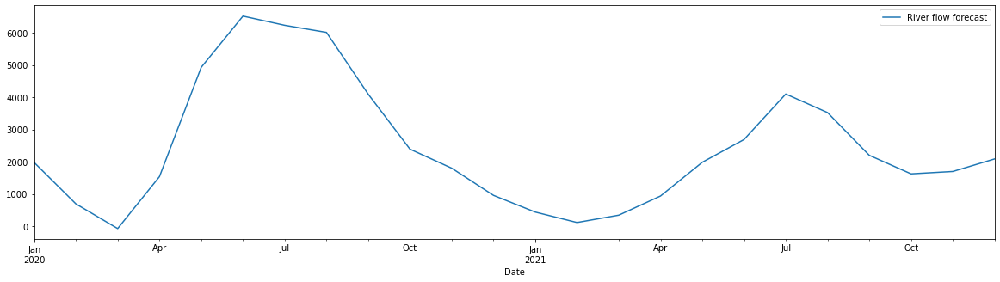

In [33]:
list_df_plot = []
for deforest in ['Def_25%', 'Def_50%', 'Def_75%', 'Def_100%']:
    for precip in ['P_A1','P_A2','P_B1','P_B2']:
        print(deforest)
        print(precip)


        for i in mcs:
            print("\n ################ Basin " + str(i) + " ############### \n")
            df_train = data[data['mc'] == i][['v_flow_mean', 'v_loss_cover', 
                                              'v_rainfall_total']].copy().reset_index(drop = True)
            df_test = df_2020_2021[df_2020_2021['MC']==i][[deforest, precip]]
            df_test = df_test.rename(columns={deforest: "v_loss_cover", precip: "v_rainfall_total"})
            df_test.insert(0,'v_flow_mean',0)

            #Scale variables between 0 and 1 (using min and max from validation data)
            scaler = MinMaxScaler(feature_range=(0, 1))
            train_scaled = scaler.fit_transform(df_train)
            test_scaled = scaler.transform(df_test)
            scaled = np.concatenate([train_scaled, test_scaled], axis=0)

            reframed = series_to_supervised(scaled, 11)
            reframed.drop(reframed.columns[[reframed.shape[1]-2, reframed.shape[1]-1]], axis=1, inplace=True)
            reframed

            #Transform to format required for LSTM 
            values = reframed.values
            n_train_months = reframed.shape[0]-(12*2)
            train = values[:n_train_months, :]
            test = values[n_train_months:, :]
            # split into input and outputs
            train_X, train_y = train[:, :-1], train[:, -1]
            test_X, test_y = test[:, :-1], test[:, -1]
            # reshape input to be 3D [samples, timesteps, features]
            train_X = train_X.reshape((train_X.shape[0], 1, train_X.shape[1]))
            test_X = test_X.reshape((test_X.shape[0], 1, test_X.shape[1]))
            print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

            #Define LSTM model
            # design network
            model = Sequential()
            model.add(LSTM(50, input_shape=(train_X.shape[1], train_X.shape[2])))
            model.add(Dense(1))
            model.compile(loss='mean_squared_error', optimizer='adam', metrics=[RootMeanSquaredError(name='rmse')])
            #earlystop = EarlyStopping(monitor='val_loss', min_delta=0.0001, patience=20,  verbose=1, mode='min')
            #callbacks_list = [earlystop]
            # hyperparameter tunning
            batch_size = int(df_models[df_models['basin']==1]['batch_size'])
            res = model.fit(train_X, train_y, epochs=int(df_models[df_models['basin']==1]['epochs']), 
                            batch_size=batch_size, verbose=0, shuffle=False, validation_split=0.15#, callbacks=callbacks_list
                            ).history['val_rmse'][-1]
            #best_batch = batch_size[np.argmin(res)]
            #print(str(best_batch)+ " batch size")

            #Evaluate model
            # make a prediction
            yhat = model.predict(test_X)
            test_X2 = test_X.reshape((test_X.shape[0], test_X.shape[2]))
            # invert scaling for forecast
            inv_yhat = concatenate((yhat, test_X2[:, 1:3]), axis=1)
            inv_yhat = scaler.inverse_transform(inv_yhat)
            inv_yhat = inv_yhat[:,0]

            #Plot original series + predictions
            inv_yhat_s = pd.Series(inv_yhat)
            inv_yhat_s.index = df_test.index#range((temp_df.shape[0]-24), temp_df.shape[0])
            dict1 = { 'River flow forecast' : inv_yhat_s}#'River flow' : temp_df['v_flow_mean'],
            df_plot = pd.DataFrame(dict1)
            #df_plot.index = macrodata[data['mc'] == i]['date'].reset_index().date
            df_plot.plot(figsize=(20,5))
            pyplot.show()

            df_results = df_plot.copy()
            df_results['basin'] = i
            df_results['scenario'] = deforest + '_' + precip
            df_test.index = df_results.index
            df_results = pd.merge(df_results, df_test, left_index=True, right_index=True)
            df_results = df_results.rename({deforest: 'v_loss_cover', precip: 'v_rainfall_total'}, axis=1) 


            #Export observed and predicted for plotting
            list_df_plot.append(df_results)

In [54]:
results1 = pd.concat(list_df_plot, axis=0)
#results1 = results1.drop(columns = ['v_flow_mean_1d','v_loss_cover_1d','v_rainfall_total_1d', 'v_loss_cover_forecast','v_rainfall_total_forecast'], axis=0)
results1 = results1.rename({'River flow forecast':'v_flow_mean_forecast'}, axis=1)
results1['Date'] = results1.index
results1['month_year'] = pd.to_datetime(results1['Date']).dt.to_period('M')
results1.index = results1['month_year']
results1 = results1.drop(columns=['v_flow_mean', 'Date', 'month_year'])
results1


,v_flow_mean_forecast,basin,scenario,v_loss_cover,v_rainfall_total
month_year,,,,,
2020-01,1.963057,1,Def_25%_P_A1,0.07693,210.44
2020-02,0.785126,1,Def_25%_P_A1,0.07702,135.49
2020-03,1.293324,1,Def_25%_P_A1,0.07710,259.40
2020-04,2.348375,1,Def_25%_P_A1,0.07718,61.71
2020-05,2.984716,1,Def_25%_P_A1,0.07726,202.86
...,...,...,...,...,...
2021-08,3521.953217,48,Def_100%_P_B2,0.07172,193.73
2021-09,2196.837270,48,Def_100%_P_B2,0.07199,180.40
2021-10,1621.924788,48,Def_100%_P_B2,0.07226,302.79


In [61]:
results1.to_csv(r'LSTM_forecast_2020_2021.csv')

In [56]:
16*48*24


18432

In [60]:
results1.loc[(results1.basin==1) & (results1.index=='2020-01')]

,v_flow_mean_forecast,basin,scenario,v_loss_cover,v_rainfall_total
month_year,,,,,
2020-01,1.963057,1,Def_25%_P_A1,0.07693,210.44
2020-01,1.893222,1,Def_25%_P_A2,0.07693,202.07
2020-01,1.933196,1,Def_25%_P_B1,0.07693,222.87
2020-01,1.902954,1,Def_25%_P_B2,0.07693,202.16
2020-01,1.954779,1,Def_50%_P_A1,0.07702,210.44
2020-01,2.023886,1,Def_50%_P_A2,0.07702,202.07
2020-01,2.008496,1,Def_50%_P_B1,0.07702,222.87
2020-01,1.965328,1,Def_50%_P_B2,0.07702,202.16
2020-01,2.075512,1,Def_75%_P_A1,0.07710,210.44
